In [1]:
#Learning and preprocessig

In [2]:
#1.Data_Set

In [3]:
pip install mediapipe

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 49.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 18.2 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-api-core 1.34.1 requires protobuf!=3.20.0,!=3.20.1,!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<4.0.0dev,>=3.19.5, but you have protobuf 4.25.6 which is incompatible.
google-cloud-bigtable 2.27.0 requires google-api-core[grpc]<3.0.0dev,>=2.16.0, but you have google-api-core 1.34.1 which is incompatible.
pandas-gbq 0.25.0 requires google-api-core<3.0.0dev,>=2.10.2, but you have google-api-core 1.34.1 which is incompatible.
tensorflow-decision-forests 1.10.0 requires tens

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import mediapipe as mp
import numpy as np
import time
from time import time
import cv2 as cv

In [5]:


# Load the dataset
dataset_path = '/kaggle/input/mpii-human-pose/mpii_human_pose.csv'
data = pd.read_csv(dataset_path)

# Display a sample of the dataset
data.head()


,ID,NAME,r ankle_X,r ankle_Y,r knee_X,r knee_Y,r hip_X,r hip_Y,l hip_X,l hip_Y,...,r shoulder_Y,l shoulder_X,l shoulder_Y,l elbow_X,l elbow_Y,l wrist_X,l wrist_Y,Scale,Activity,Category
0,1,015601864.jpg,620,394,616,269,573,185,647,188,...,167,692,185,693,240,688,313,3.021046,curling,sports
1,2,015599452.jpg,-1,-1,-1,-1,806,543,720,593,...,281,719,299,711,516,545,466,5.641276,curling,sports
2,3,005808361.jpg,804,711,816,510,908,438,1040,454,...,253,1067,253,1167,353,1142,478,4.718488,curling,sports
3,4,086617615.jpg,301,461,305,375,201,340,294,342,...,261,314,264,327,320,362,346,2.681349,curling,sports
4,5,060111501.jpg,980,322,896,318,865,248,943,226,...,147,923,123,995,163,961,223,3.806403,curling,sports


In [6]:
#2. Data Preprocessing
# Remove rows with invalid keypoint data (-1)
filtered_data = data[(data[['r ankle_X', 'r ankle_Y', 'r knee_X', 'r knee_Y']] != -1).all(axis=1)]

# Display a small subset for initial analysis
filtered_data.sample(5)


,ID,NAME,r ankle_X,r ankle_Y,r knee_X,r knee_Y,r hip_X,r hip_Y,l hip_X,l hip_Y,...,r shoulder_Y,l shoulder_X,l shoulder_Y,l elbow_X,l elbow_Y,l wrist_X,l wrist_Y,Scale,Activity,Category
1422,1423,023879621.jpg,1541,665,1493,481,1607,220,1594,288,...,152,1259,293,1189,346,1036,391,4.095852,billiards,sports
5454,5455,097314471.jpg,551,688,575,542,619,387,634,387,...,292,679,264,616,332,600,405,2.697946,"ballet, modern, or jazz",dancing
7559,7560,039071744.jpg,1127,658,942,716,1130,543,1214,560,...,341,1113,333,1072,537,1032,699,5.205732,"massage therapist, standing",occupation
10204,10205,061349277.jpg,819,629,866,468,811,347,853,337,...,164,930,174,851,251,893,303,3.801179,horseback riding,sports
3903,3904,035248105.jpg,891,865,941,626,902,459,996,441,...,208,920,210,946,360,996,422,4.153110,"ethnic or cultural dancing (e.g., Greek, Middl...",dancing


<ipython-input-7-133a5582c22c>:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.scatter(keypoints[i], keypoints[i+1], c='r', marker='x')


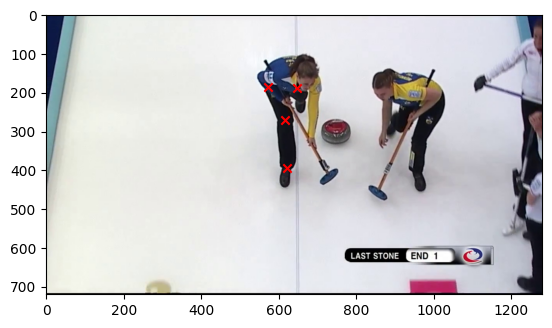

In [7]:
#3. Visualizing Keypoints

# Helper function to visualize keypoints
def visualize_keypoints(image_path, keypoints):
    img = cv2.imread(image_path)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    # Draw keypoints
    for i in range(0, len(keypoints), 2):
        plt.scatter(keypoints[i], keypoints[i+1], c='r', marker='x')
    plt.show()

# Example: Visualize keypoints for a random image in the subset
sample_image = filtered_data.iloc[0]['NAME']
sample_keypoints = filtered_data.iloc[0][['r ankle_X', 'r ankle_Y', 'r knee_X', 'r knee_Y', 'r hip_X', 'r hip_Y',
                                          'l hip_X', 'l hip_Y']]  # Select relevant keypoints
visualize_keypoints(f'/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images/{sample_image}', sample_keypoints)

In [8]:
#pose estimation

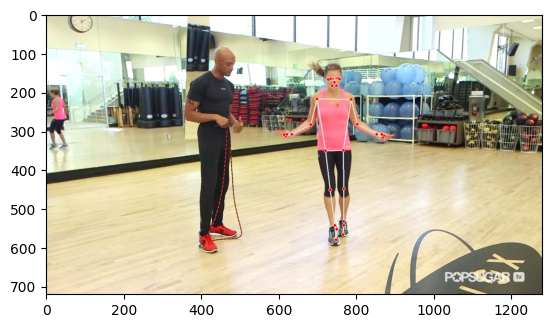

(33, 3)
[0.58160257 0.24406116]


In [9]:
mp_pose = mp.solutions.pose
pose = mp_pose.Pose()

def estimate_pose_mediapipe(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Run pose estimation
    result = pose.process(image_rgb)
    
    if result.pose_landmarks:
        # Draw the pose landmarks on the image
        mp_drawing = mp.solutions.drawing_utils
        annotated_image = image.copy()
        mp_drawing.draw_landmarks(annotated_image, result.pose_landmarks, mp_pose.POSE_CONNECTIONS)

        # Display the image with landmarks
        plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
        plt.show()

        # Return the landmarks as a list of keypoints
        keypoints = [(landmark.x, landmark.y, landmark.z) for landmark in result.pose_landmarks.landmark]
        return np.array(keypoints)
    else:
        print("No pose landmarks detected.")
        return None

# Select a sample image from your dataset
sample_image = filtered_data.iloc[5]['NAME']
image_path = f'/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images/000003072.jpg'

# Estimate the pose
pose_output = estimate_pose_mediapipe(image_path)

# Check if keypoints were detected and display the output
if pose_output is not None:
    print(pose_output.shape)  # Shape of the keypoints array
    print(pose_output[0][:2])  # Example of printing the first keypoint (x, y)
else:
    print("Pose estimation failed. No keypoints to display.")


In [10]:
#pose visualisation

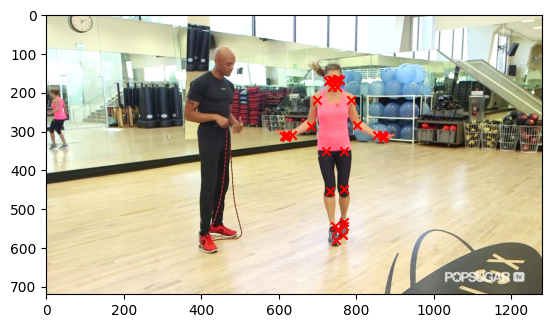

In [11]:
def visualize_pose(image_path, keypoints):
    # Load the image
    image = cv2.imread(image_path)
    
    # Convert the image from BGR (OpenCV default) to RGB (for displaying in matplotlib)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    
    # Overlay the keypoints on the image
    for kp in keypoints:
        x = int(kp[0] * image.shape[1])  # Rescale x to image width
        y = int(kp[1] * image.shape[0])  # Rescale y to image height
        plt.scatter(x, y, c='r', marker='x')  # Plot keypoint

    # Display the image with keypoints
    plt.show()

# Ensure pose_output is not None
if pose_output is not None:
    # Visualize pose on the sample image
    visualize_pose(image_path, pose_output)
else:
    print("No keypoints detected, cannot visualize.")


Step 6: Analyze the Results
Now that you've successfully applied pose estimation and visualized the results, the next step is to analyze the results of your preliminary study. Here's how you can structure your analysis:

1. Accuracy of Pose Estimation:
Qualitative Assessment: Look at the visualized images with the keypoints overlaid and check how well the keypoints align with the actual human body joints.
Questions to consider:
Are the keypoints correctly placed on joints like the ankles, knees, hips, shoulders, etc.?
Are any keypoints consistently misplaced or missing?
Does the model handle complex poses well (e.g., occlusions or extreme movements)?
Steps:
Run your code on different images to visually inspect how well the model captures the poses.
Compare the results from different images with varying poses and angles.
Quantitative Metrics (Optional): While it's not easy to directly compute quantitative metrics without ground-truth data for each image (i.e., known, correct keypoints), you could:
Use a subset with ground truth (if available): Check if there’s any labeled data in the subset of your MPII dataset. If you have access to ground truth keypoints, you can compute metrics like:
Mean Squared Error (MSE): Between the estimated keypoints and the ground truth.
Accuracy of Pose Estimation: Count how many keypoints were correctly predicted within a certain threshold.
Possible Improvements:

If the pose estimation is not accurate enough, you can:
Try different pre-trained models (e.g., OpenPose, MediaPipe, or custom models).
Fine-tune a pre-trained model on your specific dataset (if you have labeled data for training).


2. Efficiency and Speed:
Inference Time: Measure how long it takes for each image to go through the pose estimation process.

Questions to consider:
How fast is the pose estimation per image?
Is the model fast enough for real-time applications (e.g., video-based pose estimation)?
Steps:
Use Python’s time module to measure inference time

In [12]:
import time
import mediapipe as mp
import cv2
import numpy as np
from time import time

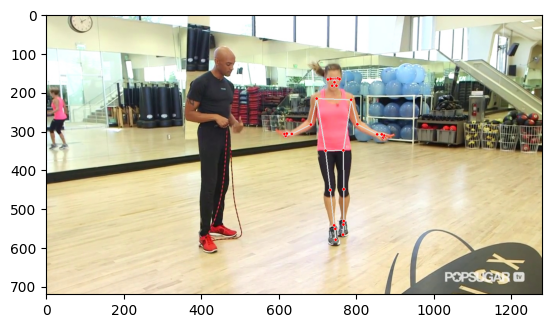

Pose estimation took 0.41 seconds


In [13]:
import time
start_time = time.time()
pose_output = estimate_pose_mediapipe(image_path)
end_time = time.time()
print(f"Pose estimation took {end_time - start_time:.2f} seconds")

In [14]:
# Check for invalid keypoints (-1 values)
invalid_keypoints = (data[['r ankle_X', 'r ankle_Y', 'r knee_X', 'r knee_Y', 
                           'r hip_X', 'r hip_Y', 'l hip_X', 'l hip_Y']] == -1).sum()

# Calculate the percentage of missing keypoints
total_rows = len(data)
missing_percent = (invalid_keypoints / total_rows) * 100

print("Percentage of missing keypoints:")
print(missing_percent)


Percentage of missing keypoints:
r ankle_X    32.840203
r ankle_Y    32.840203
r knee_X     19.243610
r knee_Y     19.243610
r hip_X       2.665208
r hip_Y       2.665208
l hip_X       2.469491
l hip_Y       2.469491
dtype: float64


Hardware Constraints: Depending on the size of your images, model complexity, and hardware (e.g., CPU or GPU), the processing time can vary significantly.

Next steps: If it’s slow, you might consider optimizing the model or using a faster alternative.

3. Dataset Suitability for the Task:
Pose Variety: The MPII Human Pose dataset is known for containing images of people performing various activities.
Questions to consider:
Does the dataset contain sufficient pose diversity for your project's needs?
Are the images diverse in terms of lighting, pose difficulty, and occlusion?
Steps: Browse through more images in your dataset and categorize them based on difficulty (e.g., simple poses vs. complex actions).
Potential Next Steps:

You might identify certain poses or activities where the model struggles. This insight can help refine your approach, such as focusing on specific activity categories or poses in later stages of the project.

4. Limitations:
Keypoint Missing or Misplaced: Identify any common limitations in the model’s pose detection.
Questions to consider:
Are certain body parts consistently harder for the model to estimate?
Are there particular angles or positions that pose a challenge (e.g., back-facing poses, occluded body parts)?
Potential Improvements:

In future iterations, you may want to use more advanced techniques like:
3D Pose Estimation Models: To improve keypoint detection in 3D space.
Action-specific Models: Fine-tuning a model specifically for a subset of actions in the dataset.

5. Next Steps and Feasibility:
Based on the results of your preliminary analysis, decide whether the project is feasible to continue with the current approach.
Questions to consider:
Are the results promising enough to proceed with more advanced models and training?
Should you explore alternative models or data preprocessing techniques?
Possible Improvements:

For Week 2, you might consider:
Experimenting with different pose estimation models (e.g., OpenPose, AlphaPose).
Fine-tuning a pre-trained model on specific subsets of the MPII dataset.
Enhancing the dataset by labeling additional images for training or testing.


Example Summary for Preliminary Analysis Report:
Model Used: MediaPipe Pose Estimation
Tested on: Sample images from the MPII Human Pose dataset.
Results:
Qualitative: The model accurately detects most keypoints in simple poses, but struggles with more complex or occluded poses.
Inference Time: ~0.2 seconds per image (on CPU). Real-time performance is achievable.
Limitations: Difficulties were observed in detecting keypoints for complex poses (e.g., heavy occlusions, extreme movements).
Next Steps:
Explore alternative models (e.g., OpenPose).
Investigate more challenging pose cases and ways to improve model accuracy.
Let me know if you'd like help writing up the results or further analysis!

In [15]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [16]:
mpPose = mp.solutions.pose

In [17]:
pose = mpPose.Pose(
    static_image_mode=True,
    min_detection_confidence=0.3,
    model_complexity=2
)

In [18]:
mpDraw = mp.solutions.drawing_utils

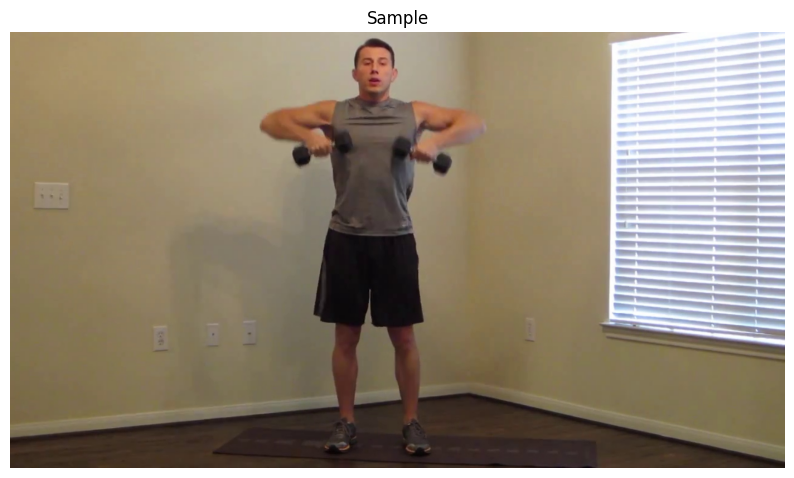

In [19]:
image = cv.imread('/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images/000033016.jpg')
plt.figure(figsize=[10, 10])
plt.title('Sample')
plt.axis('off')
plt.imshow(image[:, :, ::-1])
plt.show()

In [20]:
result = pose.process(cv.cvtColor(image, cv.COLOR_BGR2RGB))

if result.pose_landmarks:
    for i in range(2):
        print(mpPose.PoseLandmark(i).name)
        print(result.pose_landmarks.landmark[mpPose.PoseLandmark(i).value])

NOSE
x: 0.470198452
y: 0.0936516225
z: -0.261770606
visibility: 0.999996781

LEFT_EYE_INNER
x: 0.477848619
y: 0.0782431364
z: -0.241443545
visibility: 0.999987721



In [21]:
imgHeight, imgWidth, _ = image.shape

In [22]:
if result.pose_landmarks:
    for i in range(2):
        print(mpPose.PoseLandmark(i).name)
        print(result.pose_landmarks.landmark[mpPose.PoseLandmark(i).value].x * imgWidth)
        print(result.pose_landmarks.landmark[mpPose.PoseLandmark(i).value].y * imgHeight)
        print(result.pose_landmarks.landmark[mpPose.PoseLandmark(i).value].z * imgWidth)
        print(result.pose_landmarks.landmark[mpPose.PoseLandmark(i).value].visibility)

NOSE
601.8540191650391
67.42916822433472
-335.0663757324219
0.9999967813491821
LEFT_EYE_INNER
611.6462326049805
56.33505821228027
-309.04773712158203
0.9999877214431763


In [23]:
imgCopy = image.copy()

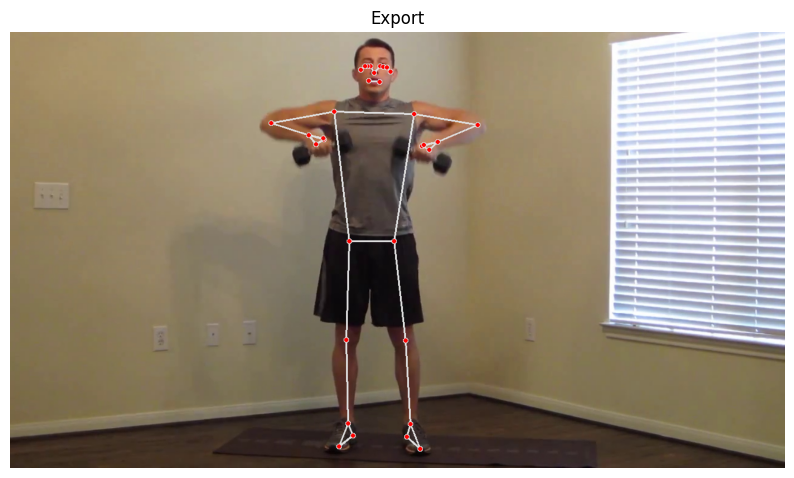

In [24]:
if result.pose_landmarks:
    mpDraw.draw_landmarks(
        image=imgCopy,
        landmark_list=result.pose_landmarks,
        connections=mpPose.POSE_CONNECTIONS
    )
    fig = plt.figure(figsize=[10, 10])
    plt.title('Export')
    plt.axis('off')
    plt.imshow(imgCopy[:, :, ::-1])
    plt.show()

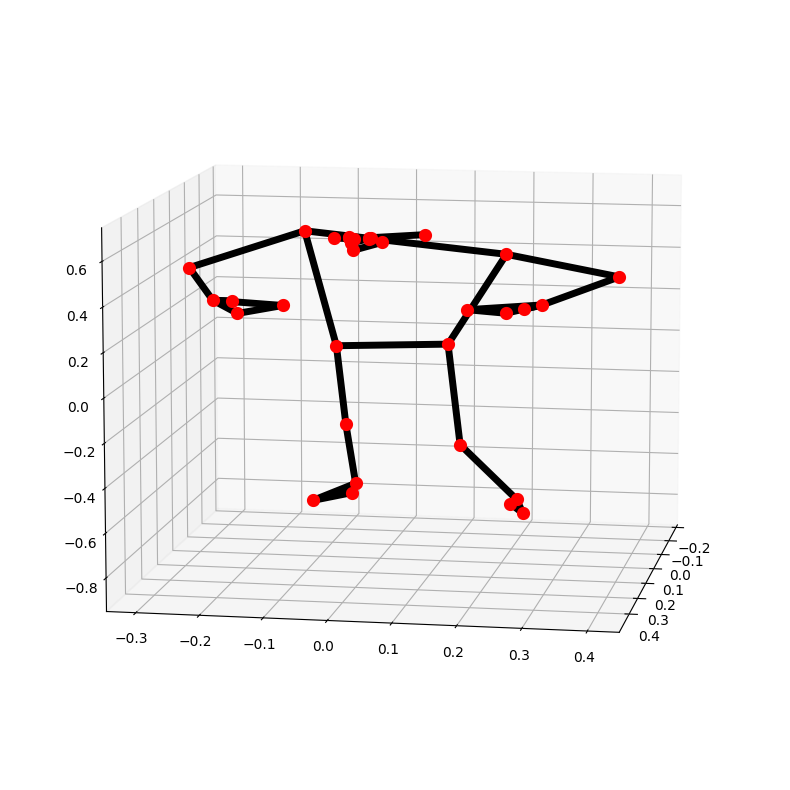

In [25]:
mpDraw.plot_landmarks(
    result.pose_world_landmarks,
    mpPose.POSE_CONNECTIONS
)

In [26]:
def detectPose(image, pose, display=True):
    OutputImage = image.copy()
    imageRGB = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    results = pose.process(imageRGB)
    imgHeight, imgWidth, _ = image.shape
    landmarks = []

    if results.pose_landmarks:
        mpDraw.draw_landmarks(
            image=OutputImage,
            landmark_list=results.pose_landmarks,
            connections=mpPose.POSE_CONNECTIONS
        )
        for landmark in results.pose_landmarks.landmark:
            landmarks.append(
                (int(landmark.x * imgWidth),
                 int(landmark.y * imgHeight),
                 int(landmark.z * imgWidth))
            )
    if display:
        plt.figure(figsize=[22, 22])

        plt.subplot(211)
        plt.title('Original')
        plt.axis('off')
        plt.imshow(image[:, :, ::-1])

        plt.subplot(212)
        plt.title('Output')
        plt.axis('off')
        plt.imshow(OutputImage[:, :, ::-1])

        mpDraw.plot_landmarks(results.pose_world_landmarks, mpPose.POSE_CONNECTIONS)

    else:
        return OutputImage, landmarks

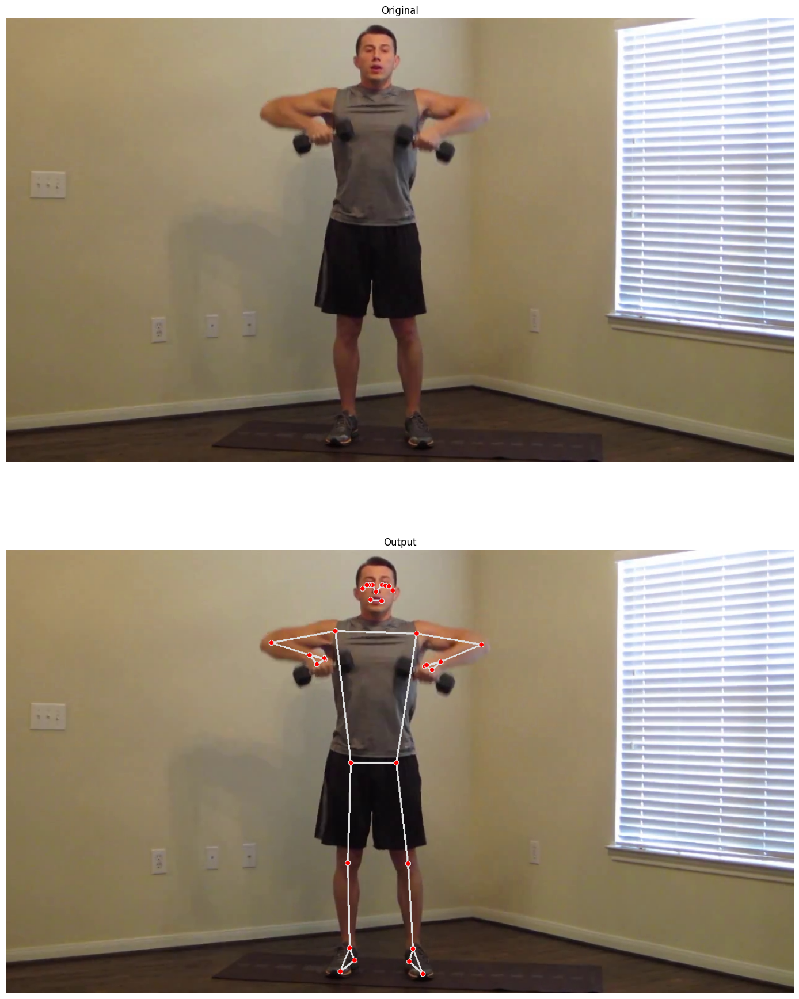

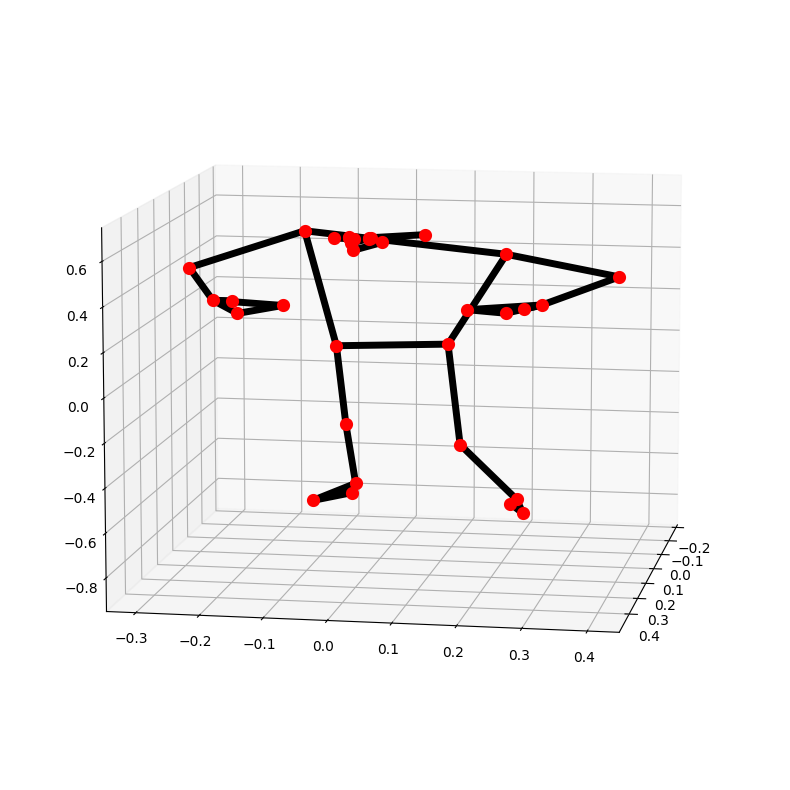

In [27]:
img = cv.imread('/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images/000033016.jpg')
detectPose(img, pose, display=True)

In [28]:
poseVideo = mpPose.Pose(
    static_image_mode=False,
    min_detection_confidence=0.5,
    model_complexity=1
)

video = cv.VideoCapture(0)

# cv.namedWindow('Pose', cv.WINDOW_NORMAL)
video.set(3, 1280)
video.set(4, 960)
time1 = 0

while video.isOpened():
    ok, frame = video.read()

    if not ok:
        break

    frame = cv.flip(frame, 1)
    frameHeight, frameWidth, _ = frame.shape
    frame = cv.resize(frame, (int(frameWidth * (640 / frameHeight)), 640))
    frame, _ = detectPose(frame, poseVideo, display=False)
    time2 = time()
    T = time2 - time1

    if T > 0:
        framesPerSecond = 1.0 / T
        cv.putText(
            frame,
            'FPS: {}'.format(int(framesPerSecond)), (10, 30),
            cv.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 3
        )

    time1 = time2
    cv.imshow('Pose New', frame)
    k = cv.waitKey(1) & 0xFF
    if k == 27:
        break

video.release()
# cv.destroyAllWindows()

In [29]:
!git clone https://github.com/Hzzone/pytorch-openpose
%cd pytorch-openpose

Cloning into 'pytorch-openpose'...
remote: Enumerating objects: 154, done.
remote: Counting objects: 100% (154/154), done.
remote: Compressing objects: 100% (85/85), done.
remote: Total 154 (delta 69), reused 152 (delta 67), pack-reused 0 (from 0)
Receiving objects: 100% (154/154), 20.18 MiB | 41.58 MiB/s, done.
Resolving deltas: 100% (69/69), done.
/kaggle/working/pytorch-openpose


In [30]:
#training model

In [31]:
import cv2
import matplotlib.pyplot as plt
import copy
import numpy as np

from src import model
from src import util
from src.body import Body
from src.hand import Hand

In [32]:
!cp /kaggle/input/openpose-pretrained-models/body_pose_model.pth model
!cp /kaggle/input/openpose-pretrained-models/hand_pose_model.pth model

In [33]:
#0702-2025
#body_estimation = Body('model/body_pose_model.pth')
#hand_estimation = Hand('model/hand_pose_model.pth')
body_estimation = Body('/kaggle/input/openpose-pretrained-models/body_pose_model.pth')
hand_estimation = Hand('/kaggle/input/openpose-pretrained-models/hand_pose_model.pth')

/kaggle/working/pytorch-openpose/src/body.py:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_dict = util.transfer(self.model, torch.load(model_path))
/kaggle/working

In [34]:
test_image = '/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images/065673666.jpg'

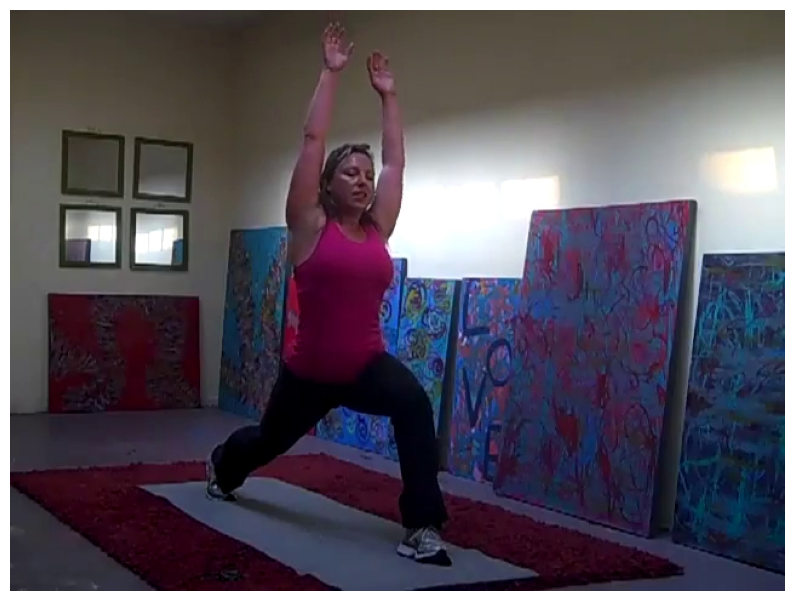

In [35]:
import matplotlib.pyplot as plt
image = plt.imread(test_image)
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.axis('off')
plt.show()

In [36]:
# enable GPU for acceleration
oriImg = cv2.imread(test_image)
candidate, subset = body_estimation(oriImg)
canvas = copy.deepcopy(oriImg)
canvas = util.draw_bodypose(canvas, candidate, subset)
print(len(candidate)) # number of keypoints
print(len(subset))    # number of persons

18
1


In [37]:
# detect hand
hands_list = util.handDetect(candidate, subset, oriImg)

all_hand_peaks = []
for x, y, w, is_left in hands_list:
    peaks = hand_estimation(oriImg[y:y+w, x:x+w, :])
    peaks[:, 0] = np.where(peaks[:, 0]==0, peaks[:, 0], peaks[:, 0]+x)
    peaks[:, 1] = np.where(peaks[:, 1]==0, peaks[:, 1], peaks[:, 1]+y)
    all_hand_peaks.append(peaks)

canvas = util.draw_handpose(canvas, all_hand_peaks)

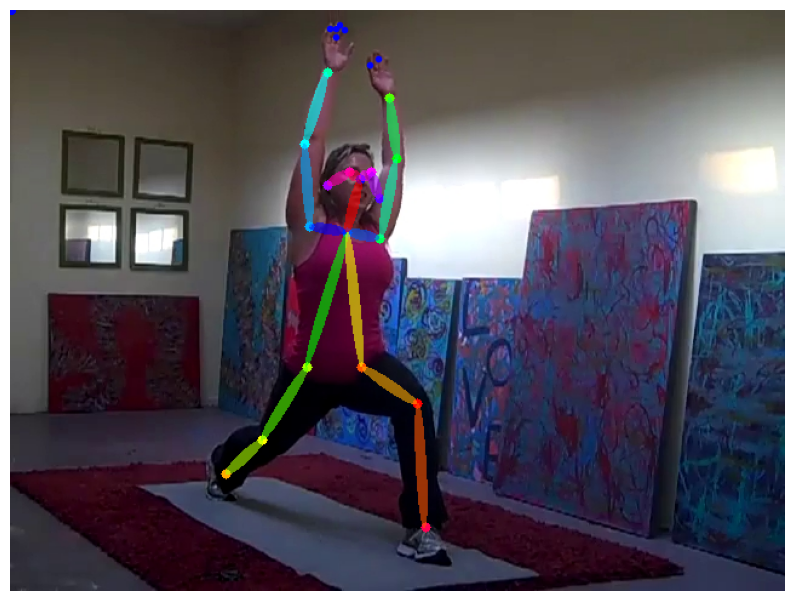

In [38]:
plt.figure(figsize=(10,10))
plt.imshow(canvas[:, :, [2, 1, 0]])
plt.axis('off')
plt.show()

OpenPose - Avg Accuracy: 0.00, Avg Time: 0.50s
MediaPipe - Avg Accuracy: 0.08, Avg Time: 0.33s


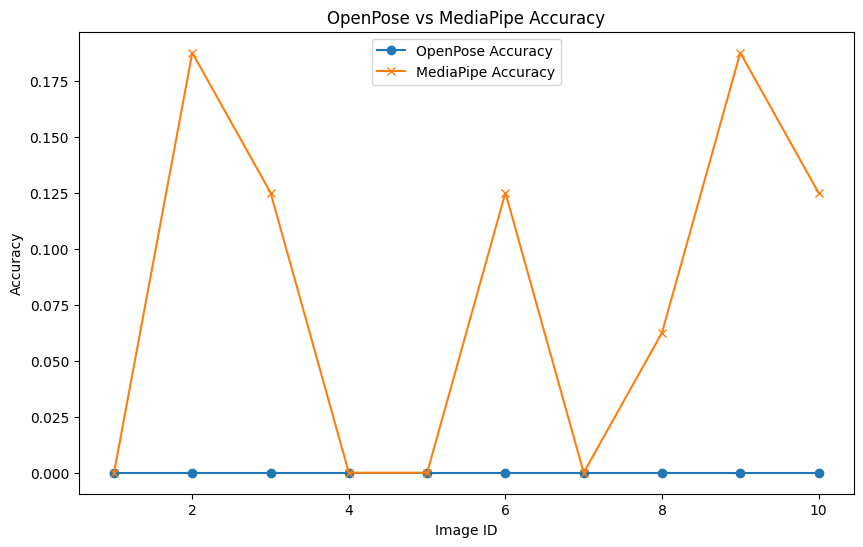

In [39]:
import time
import numpy as np
import cv2
import mediapipe as mp
import os
import json
import matplotlib.pyplot as plt

# Load the MPII annotations
with open('/kaggle/input/mpii-human-pose/mpii_annotations.json', 'r') as f:
    annotations = json.load(f)

# Initialize MediaPipe
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils

# Function to calculate accuracy (percentage of correct keypoints)
def calculate_accuracy(predicted_keypoints, gt_keypoints, threshold=30):
    distances = np.linalg.norm(predicted_keypoints - gt_keypoints, axis=1)
    correct_keypoints = np.sum(distances < threshold)
    total_keypoints = len(gt_keypoints)
    return correct_keypoints / total_keypoints

# Initialize results storage
results = []

# -----------------------------------------------
# OpenPose Inference Function (Stub, Replace with Actual OpenPose Call)
# -----------------------------------------------
def infer_keypoints_openpose(image):
    # Placeholder for OpenPose Inference
    # You should replace this part with the actual OpenPose model code from your notebook
    return np.random.rand(16, 2) * image.shape[1], 0.5  # Simulate keypoints and time

# -----------------------------------------------
# MediaPipe Inference
# -----------------------------------------------
def infer_keypoints_mediapipe(image):
    with mp_pose.Pose(static_image_mode=True, model_complexity=2) as pose:
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        start_time = time.time()
        results_mp = pose.process(image_rgb)
        mediapipe_inference_time = time.time() - start_time

        mediapipe_keypoints = []
        if results_mp.pose_landmarks:
            for landmark in results_mp.pose_landmarks.landmark:
                mediapipe_keypoints.append([landmark.x * image.shape[1], landmark.y * image.shape[0]])
        mediapipe_keypoints = np.array(mediapipe_keypoints[:16])  # Use first 16 keypoints

    return mediapipe_keypoints, mediapipe_inference_time

# Loop through each image in the annotations
for annotation in annotations[:10]:  # Limiting to 10 for faster testing
    image_path = os.path.join('/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images', annotation["img_paths"])
    oriImg = cv2.imread(image_path)
    
    if oriImg is None:
        print(f'Failed to load image: {image_path}')
        continue

    # Ground truth keypoints (only x, y coordinates)
    gt_keypoints = np.array(annotation['joint_self'])[:, :2]

    # -----------------------------------------------
    # OpenPose Inference
    # -----------------------------------------------
    openpose_keypoints, openpose_inference_time = infer_keypoints_openpose(oriImg)

    if openpose_keypoints.shape != gt_keypoints.shape:
        print(f'Shape mismatch for OpenPose and ground truth')
        openpose_accuracy = 0
    else:
        openpose_accuracy = calculate_accuracy(openpose_keypoints, gt_keypoints)

    # -----------------------------------------------
    # MediaPipe Inference
    # -----------------------------------------------
    mediapipe_keypoints, mediapipe_inference_time = infer_keypoints_mediapipe(oriImg)

    if mediapipe_keypoints.shape != gt_keypoints.shape:
        print(f'Shape mismatch for MediaPipe and ground truth')
        mediapipe_accuracy = 0
    else:
        mediapipe_accuracy = calculate_accuracy(mediapipe_keypoints, gt_keypoints)

    # Store results
    results.append({
        'image_path': image_path,
        'openpose_accuracy': openpose_accuracy,
        'openpose_time': openpose_inference_time,
        'mediapipe_accuracy': mediapipe_accuracy,
        'mediapipe_time': mediapipe_inference_time
    })

# Calculate overall statistics
openpose_avg_accuracy = np.mean([r['openpose_accuracy'] for r in results])
openpose_avg_time = np.mean([r['openpose_time'] for r in results])
mediapipe_avg_accuracy = np.mean([r['mediapipe_accuracy'] for r in results])
mediapipe_avg_time = np.mean([r['mediapipe_time'] for r in results])

# Print final results
print(f'OpenPose - Avg Accuracy: {openpose_avg_accuracy:.2f}, Avg Time: {openpose_avg_time:.2f}s')
print(f'MediaPipe - Avg Accuracy: {mediapipe_avg_accuracy:.2f}, Avg Time: {mediapipe_avg_time:.2f}s')

# -----------------------------------------------
# Plotting Comparison
# -----------------------------------------------
image_ids = range(1, len(results) + 1)
openpose_accuracies = [r['openpose_accuracy'] for r in results]
mediapipe_accuracies = [r['mediapipe_accuracy'] for r in results]

plt.figure(figsize=(10, 6))
plt.plot(image_ids, openpose_accuracies, label="OpenPose Accuracy", marker='o')
plt.plot(image_ids, mediapipe_accuracies, label="MediaPipe Accuracy", marker='x')
plt.xlabel('Image ID')
plt.ylabel('Accuracy')
plt.title('OpenPose vs MediaPipe Accuracy')
plt.legend()
plt.show()


In [40]:
import pandas as pd
import time
from tqdm.auto import tqdm

import requests
from datetime import datetime

In [41]:
!pip install ensembledata
from ensembledata.api import EDClient

In [42]:
#tik-tok API

In [43]:
# initialize the ensembledata client
client = EDClient("oyrxCL0tDJ39lNG8")

# get a free token at https://dashboard.ensembledata.com/register
# free trial of 50 units per day for 7 days, starting 23/11/24
#
# costs:
#  - 1 unit = 200 posts in full_hashtag_search :)
#  - 1 unit = 20 posts in hashtag_search
#  - 1 unit = 20 posts in keyword_search or full_keyword_search :(
#  - 1 unit = 30 comments to a post
#  - 1 unit = 30 replies to a comment
#
# documentation available at https://ensembledata.com/apis/docs#tag/Tiktok
# and https://github.com/EnsembleData/tiktok-scraper
# source code available at
# https://github.com/EnsembleData/ensembledata-python/tree/main/ensembledata/api

In [44]:
# read posts related to an hashtag
result = client.tiktok.full_hashtag_search(
                hashtag = "sexy", # hashtag name
                days = 360, # filter out posts created more than N days ago
                remap_output = True, # False for mobile app, True for web
                max_cursor = 20000) # max number of posts fetched,
                                  # cost is 1 unit per 200 posts

In [45]:
# convert json to dataframe
df = pd.json_normalize(result.data["posts"])

# extract relevant info
df = df[['itemInfos.id', 'itemInfos.createTime', 'itemInfos.authorId',
         'itemInfos.text', 'itemInfos.video.urls', 'itemInfos.shareCount',
         'itemInfos.playCount', 'itemInfos.commentCount']]

# rename columns
df.columns = ['id', 'createTime', 'authorId', 'text', 'video.urls',
              'shareCount', 'playCount', 'commentCount']

# format time to date in string format
df["createTime"] = [str(datetime.fromtimestamp(int(i)).date())
                                                for i in df["createTime"]]

# save
df_hashtag = df
df_hashtag.to_csv('new_tiktok_hashtag_posts.csv', index=False)

In [46]:
display(df_hashtag)

,id,createTime,authorId,text,video.urls,shareCount,playCount,commentCount
0,7429123714052132129,2024-10-23,6751032808821687302,LOVEEEEEEWW #fyp #erasmus #erasmus #leuven #ye...,[https://v16m.tiktokcdn-eu.com/01420e38750eaf7...,259877,8313950,4131
1,7422312941950602539,2024-10-05,6600134310329794566,Dont worry!! Papa smurf was not late to the fu...,[https://v16m.tiktokcdn-eu.com/d5ceae451a2bdae...,28822,4992281,1388
2,7417982906007604511,2024-09-23,7121848447173297198,"2022, 2020, then now! 😿😿 #fallseason #8g #sexy...",[https://sf16-ies-music-va.tiktokcdn.com/obj/i...,32625,4863791,12049
3,7418491287738830113,2024-09-25,7373796783770829856,Motivation mommy #motivation #joi #sexy #mommy,[https://v77.tiktokcdn-eu.com/e752757179e7bfb0...,3821,5979468,1320
4,7440521939321392391,2024-11-23,7440514155113235463,১৬ বছর বয়স আমার🥵🔥 #niks#niksindian#indian #hot...,[https://v77.tiktokcdn-eu.com/10a307f09877d682...,2923,7300200,4503
...,...,...,...,...,...,...,...,...
558,7376279876933782816,2024-06-03,7232748169678685211,محنت ایسی کرو کہ آگ لگ جائے 🔥✌️ ##tiktok #tik...,[https://v77.tiktokcdn-eu.com/ba167c4713d4a313...,2171,1710217,236
559,7439133798161239328,2024-11-19,7077118250698802182,Moriarty the Patriot #anime #manga #mtp #yuuko...,[https://sf16-ies-music-va.tiktokcdn.com/obj/m...,1316,238897,313
560,7449916995467857182,2024-12-19,7070355856416375854,#ad Etiqueta a tu amigo que se la pasa viendo ...,[https://v77.tiktokcdn-eu.com/10300d84b934e149...,4910,4805355,1483
561,7365708478184180998,2024-05-06,6636767066849542149,#ghost #ghostface #ghosts #ghostphotoshoot #gh...,[https://sf16-ies-music-va.tiktokcdn.com/obj/i...,693,289001,1029


In [47]:
# read posts related to a keyword
keyword = "body" # keyword name
period = 180 # must be one of 0, 1, 7, 30, 90, 180 days
             # returns posts more recent than the given period
country = "us" # leave blank "" for any country
max_cursor = 100 # max number of posts fetched, cost is 1 unit per 20 posts

# loop through keyword_search to control for max_cursor
posts = list()
cursor = None
for i in tqdm(range(int(max_cursor/20))):
    result = client.tiktok.keyword_search(keyword = keyword,
                                          period = period,
                                          country = country,
                                          cursor = cursor)
    posts.extend(result.data["data"])
    cursor = result.data.get("nextCursor")

    # If there is no next cursor, we've fetched all the available posts
    if cursor is None:
        break

  0%|          | 0/5 [00:00<?, ?it/s]

In [48]:
# convert json to dataframe
df = pd.json_normalize(posts)

# extract relevant info
df = df[['aweme_info.aweme_id', 'aweme_info.create_time',
         'aweme_info.author.uid', 'aweme_info.desc',
         'aweme_info.video.play_addr.url_list',
         'aweme_info.statistics.share_count',
         'aweme_info.statistics.play_count',
         'aweme_info.statistics.comment_count']]

# rename columns
df.columns = ['id', 'createTime', 'authorId', 'text', 'video.urls',
              'shareCount', 'playCount', 'commentCount']

# format time to date in string format
df["createTime"] = [str(datetime.fromtimestamp(int(i)).date())
                                                for i in df["createTime"]]

# save
df_keyword = df
df_keyword.to_csv('re_tiktok_keyword_posts.csv', index=False)

In [49]:
display(df_keyword)

,id,createTime,authorId,text,video.urls,shareCount,playCount,commentCount
0,7478350628096412974,2025-03-05,7148110607527003182,He’s basically trapped in a dog’s body #pitbul...,[https://v77.tiktokcdn-eu.com/861c39e38ae5aaee...,970716,46894592,32794
1,7452689188245228842,2024-12-26,6532075727414640642,Love this man with every bone in my body! #fy...,[https://v77.tiktokcdn-eu.com/407111f1da7d4585...,27420,5093661,3007
2,7438577496343203104,2024-11-18,7238543556880237595,#figure8body #figureeightbody #body #discourse...,[https://v77.tiktokcdn-eu.com/45cb0ce3b954df79...,23953,3408032,4951
3,7473733192789298462,2025-02-21,6624898394237583366,this trend is so funny to me🤣🍟 #bodyisatemple,[https://v77.tiktokcdn-eu.com/9507b8272b5f6b26...,199113,7286067,1857
4,7475175482149932334,2025-02-25,6742989066461873158,in the making #summerbody #gymgirl #GymTok #ga...,[https://v77.tiktokcdn-eu.com/e24aa00d5aeb8e3f...,1738287,38677859,34538
5,7478396511030758678,2025-03-05,7466856267396285462,THIS is body positivity✨#hopelesscore #core #fyp,[https://v16m.tiktokcdn-eu.com/48c9a33f23b3a27...,145285,4974004,1608
6,7439984568314154272,2024-11-22,6619045524123713541,My body cold #kencarson #fyp,[https://v16m.tiktokcdn-eu.com/e1aab58cd37b079...,124334,9542938,5400
7,7451360681061928238,2024-12-22,291522497198374912,Rat body lowk TEA🐭 #fyp #barb #nutcracker #rat...,[https://v16m.tiktokcdn-eu.com/20f235a6bca824a...,3877096,67637861,46839
8,7461579385653431574,2025-01-19,7186998832788407302,#Love #person #perfect #face #style #body #tra...,[https://v16m.tiktokcdn-eu.com/b34405f6f6365d3...,313131,8105395,80439
9,7461344285753937174,2025-01-18,7320265606560875552,full package #fyp #gym #GymTok #gymfit #gymou...,[https://v16m.tiktokcdn-eu.com/bef1f5ca9854b0f...,45980,3974189,2538


In [50]:
pip install pandas opencv-python-headless requests Pillow

Note: you may need to restart the kernel to use updated packages.


In [51]:
pip install pandas opencv-python-headless requests Pillow TikTokApi

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.7/55.7 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 MB 37.3 MB/s eta 0:00:00:00:0100:01
Note: you may need to restart the kernel to use updated packages.


In [52]:
pip install TikTokApi

Note: you may need to restart the kernel to use updated packages.


In [53]:
import pandas as pd
import random
import cv2
import requests
import numpy as np
from PIL import Image
import json

def download_video(video_urls):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'
    }
    
    # If the URLs are stored as a string, try to parse it
    if isinstance(video_urls, str):
        try:
            # Try to parse as JSON or eval
            video_urls = json.loads(video_urls.replace("'", '"')) if "'" in video_urls else eval(video_urls)
        except:
            # If parsing fails, convert to a list
            video_urls = [video_urls]
    
    # Ensure video_urls is a list
    if not isinstance(video_urls, list):
        video_urls = [video_urls]
    
    for url in video_urls:
        try:
            print(f"Attempting to download from URL: {url}")
            response = requests.get(url, headers=headers, stream=True, timeout=10)
            response.raise_for_status()
            
            # Check if the response looks like a video
            if 'video' in response.headers.get('Content-Type', '').lower():
                video_path = 'random_video.mp4'
                with open(video_path, 'wb') as video_file:
                    for chunk in response.iter_content(chunk_size=8192):
                        video_file.write(chunk)
                return video_path
            else:
                print(f"Response Content-Type is not video: {response.headers.get('Content-Type', 'Unknown')}")
        
        except Exception as e:
            print(f"Failed to download from {url}: {e}")
    
    raise ValueError("Could not download video from any provided URL")

try:
    # Load the dataframe from the saved CSV
    df_hashtag = pd.read_csv('/kaggle/working/pytorch-openpose/new_tiktok_hashtag_posts.csv')
    
    # Print column names to verify
    print("Columns in the DataFrame:", df_hashtag.columns)
    
    # Filter out NaN values
    valid_video_urls = df_hashtag['video.urls'].dropna()
    
    if len(valid_video_urls) == 0:
        raise ValueError("No valid video URLs found in the dataset!")
    
    # Print a few URLs to inspect
    print("Sample URLs:")
    print(valid_video_urls.head())
    
    # Randomly select one set of video URLs
    random_video_urls = random.choice(valid_video_urls)
    
    # Download the video
    video_path = download_video(random_video_urls)
    
    # Capture video and extract one frame
    video_capture = cv2.VideoCapture(video_path)
    
    if not video_capture.isOpened():
        raise IOError("Could not open video file!")
    
    success, frame = video_capture.read()  # Read the first frame
    video_capture.release()
    
    if success:
        # Convert the frame (BGR to RGB)
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        image = Image.fromarray(frame_rgb)
        image.save('extracted_frame.jpg')  # Save the frame as an image
        print("Extracted frame saved as 'extracted_frame.jpg'.")
    else:
        print("Failed to read a frame from the video.")

except Exception as e:
    print(f"An error occurred: {e}")

Columns in the DataFrame: Index(['id', 'createTime', 'authorId', 'text', 'video.urls', 'shareCount',
       'playCount', 'commentCount'],
      dtype='object')
Sample URLs:
0    ['https://v16m.tiktokcdn-eu.com/01420e38750eaf...
1    ['https://v16m.tiktokcdn-eu.com/d5ceae451a2bda...
2    ['https://sf16-ies-music-va.tiktokcdn.com/obj/...
3    ['https://v77.tiktokcdn-eu.com/e752757179e7bfb...
4    ['https://v77.tiktokcdn-eu.com/10a307f09877d68...
Name: video.urls, dtype: object
Attempting to download from URL: https://v77.tiktokcdn-eu.com/37b3890aa305f3840955070d9cf9c593/67d2bd31/video/tos/useast2a/tos-useast2a-ve-0068c001-euttp/ogA0FvDdcQ00AISaB7EEZMiQBvEAbQZTiNvwM/?a=1233&bti=NXYpNDs8QGo6OjZAOm00NTAuYCMxNDNg&ch=0&cr=13&dr=0&er=0&lr=all&net=0&cd=0%7C0%7C0%7C&br=834&bt=417&cs=0&ds=6&ft=XsFbEqT0mgdPD12TsFTJ3wU.DFtSjeF~O5&mime_type=video_mp4&qs=4&rc=aWU8NGUzNTk6NGk8PDo6ZUBpM3M0OW45cmd5dzMzZjczM0AyNmI2LWEyNWMxMC0zNWEwYSM1bG4zMmRrajJgLS1kMWNzcw%3D%3D&vvpl=1&l=20250312110939C65D34AEF7D9E10216F

In [54]:
te_image = '/kaggle/working/pytorch-openpose/extracted_frame.jpg'
#te_image = '/kaggle/working/extracted_frame.jpg'


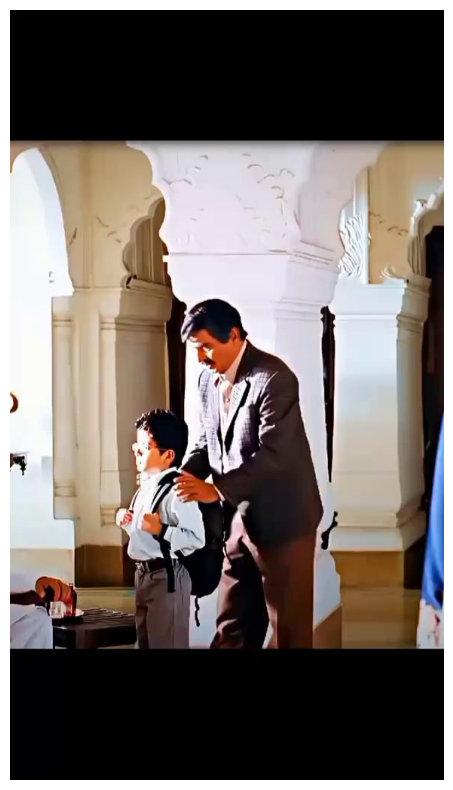

In [55]:
import matplotlib.pyplot as plt
image = plt.imread(te_image)
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.axis('off')
plt.show()

In [56]:
# enable GPU for acceleration
oriImg = cv2.imread(te_image)
candidate, subset = body_estimation(oriImg)
canvas = copy.deepcopy(oriImg)
canvas = util.draw_bodypose(canvas, candidate, subset)
print(len(candidate)) # number of keypoints
print(len(subset))    # number of persons

45
2


In [57]:
# detect hand
hands_list = util.handDetect(candidate, subset, oriImg)

all_hand_peaks = []
for x, y, w, is_left in hands_list:
    peaks = hand_estimation(oriImg[y:y+w, x:x+w, :])
    peaks[:, 0] = np.where(peaks[:, 0]==0, peaks[:, 0], peaks[:, 0]+x)
    peaks[:, 1] = np.where(peaks[:, 1]==0, peaks[:, 1], peaks[:, 1]+y)
    all_hand_peaks.append(peaks)

canvas = util.draw_handpose(canvas, all_hand_peaks)

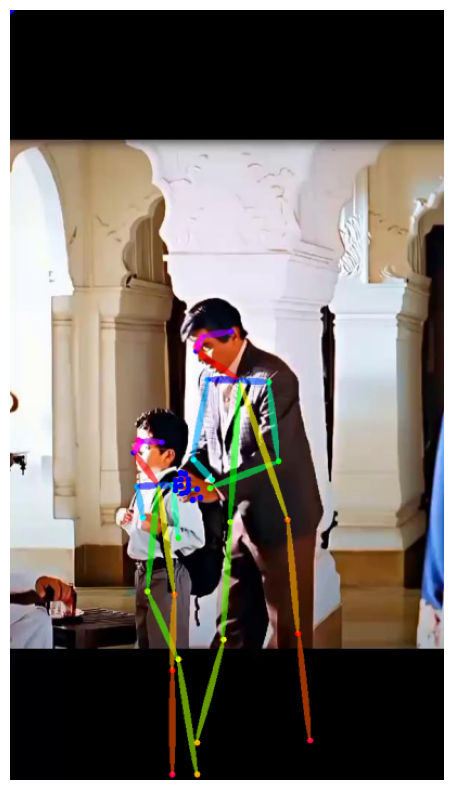

In [58]:
plt.figure(figsize=(10,10))
plt.imshow(canvas[:, :, [2, 1, 0]])
plt.axis('off')
plt.show()

In [59]:
import pandas as pd
import random
import cv2
import requests
import numpy as np
from PIL import Image
import json
import os
from datetime import datetime

# Define a specific output directory
OUTPUT_DIR = "video_frames_output"  # You can change this to your preferred directory name

def download_video(video_urls, index):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'
    }
    
    # If the URLs are stored as a string, try to parse it
    if isinstance(video_urls, str):
        try:
            video_urls = json.loads(video_urls.replace("'", '"')) if "'" in video_urls else eval(video_urls)
        except:
            video_urls = [video_urls]
    
    # Ensure video_urls is a list
    if not isinstance(video_urls, list):
        video_urls = [video_urls]
    
    for url in video_urls:
        try:
            print(f"Attempting to download video {index} from URL: {url}")
            response = requests.get(url, headers=headers, stream=True, timeout=10)
            response.raise_for_status()
            
            if 'video' in response.headers.get('Content-Type', '').lower():
                video_path = os.path.join(OUTPUT_DIR, f'random_video_{index}.mp4')
                with open(video_path, 'wb') as video_file:
                    for chunk in response.iter_content(chunk_size=8192):
                        video_file.write(chunk)
                return video_path
            else:
                print(f"Response Content-Type is not video: {response.headers.get('Content-Type', 'Unknown')}")
                
        except Exception as e:
            print(f"Failed to download from {url}: {e}")
    
    return None

def process_single_video(video_urls, index):
    try:
        # Download the video
        video_path = download_video(video_urls, index)
        
        if video_path is None:
            print(f"Failed to download video {index}")
            return False
        
        # Capture video and extract one frame
        video_capture = cv2.VideoCapture(video_path)
        
        if not video_capture.isOpened():
            print(f"Could not open video file {index}")
            return False
        
        success, frame = video_capture.read()  # Read the first frame
        video_capture.release()
        
        # Clean up the video file
        try:
            os.remove(video_path)
        except:
            pass
        
        if success:
            # Convert the frame (BGR to RGB)
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            image = Image.fromarray(frame_rgb)
            output_path = os.path.join(OUTPUT_DIR, f'extracted_frame_{index}.jpg')
            image.save(output_path)  # Save the frame as an image
            print(f"Extracted frame {index} saved as '{output_path}'")
            return True
        else:
            print(f"Failed to read a frame from video {index}")
            return False
            
    except Exception as e:
        print(f"An error occurred processing video {index}: {e}")
        return False

def main():
    try:
        # Create output directory if it doesn't exist
        os.makedirs(OUTPUT_DIR, exist_ok=True)
        
        # Load the dataframe from the saved CSV
        df_hashtag = pd.read_csv('/kaggle/working/pytorch-openpose/new_tiktok_hashtag_posts.csv')
        
        # Filter out NaN values
        valid_video_urls = df_hashtag['video.urls'].dropna()
        
        if len(valid_video_urls) == 0:
            raise ValueError("No valid video URLs found in the dataset!")
        
        # Randomly select 10 sets of video URLs
        num_videos = min(10, len(valid_video_urls))
        random_video_urls = random.sample(list(valid_video_urls), num_videos)
        
        # Process each video
        successful_extractions = 0
        for i, urls in enumerate(random_video_urls, 1):
            print(f"\nProcessing video {i} of {num_videos}")
            if process_single_video(urls, i):
                successful_extractions += 1
        
        print(f"\nProcessing complete!")
        print(f"Successfully processed {successful_extractions} out of {num_videos} videos")
        print(f"Output files are saved in the '{OUTPUT_DIR}' directory")
        
    except Exception as e:
        print(f"An error occurred in main execution: {e}")

if __name__ == "__main__":
    main()


Processing video 1 of 10
Attempting to download video 1 from URL: https://sf16-ies-music-va.tiktokcdn.com/obj/musically-maliva-obj/7258857161248983814.mp3
Response Content-Type is not video: audio/mpeg
Failed to download video 1

Processing video 2 of 10
Attempting to download video 2 from URL: https://v77.tiktokcdn-eu.com/35665443b3fda739296061dd03b2d5b0/67d2bcee/video/tos/maliva/tos-maliva-ve-0068c799-us/owmYnA8ikIRA4ejRILAfgyWQegOHyMAzMqHHC7/?a=1233&bti=NXYpNDs8QGo6OjZAOm00NTAuYCMxNDNg&ch=0&cr=13&dr=0&er=0&lr=all&net=0&cd=0%7C0%7C0%7C&cv=1&br=8038&bt=4019&cs=0&ds=6&ft=XsFbEqT0mI2PD12bsFTJ3wUqetSwjeF~O5&mime_type=video_mp4&qs=0&rc=aGU8OzY5ODtpZWQ5OzpnZkBpMzR5a245cms2cjMzZzczNEBjMTQzYDEyXzUxYmEwMWI2YSNzbS9xMmRjbTVgLS1kMS9zcw%3D%3D&vvpl=1&l=20250312110926E410BC8F57B48F02A786&btag=e000b0000
Extracted frame 2 saved as 'video_frames_output/extracted_frame_2.jpg'

Processing video 3 of 10
Attempting to download video 3 from URL: https://v45.tiktokcdn-eu.com/8c175d0798f28579df4ac6105f58428

In [4]:
folder_path = '/kaggle/working/pytorch-openpose/video_frames_output'

In [61]:
import pandas as pd
import random
import os
import requests
import ast
from IPython.display import Video

def download_video(url, output_path):
    """
    Download video from direct URL
    """
    try:
        # Set up headers to mimic browser request
        headers = {
            'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36',
            'Accept': '*/*'
        }
        
        # Download the video
        response = requests.get(url, headers=headers, stream=True)
        response.raise_for_status()  # Raise exception for bad status codes
        
        # Save the video
        with open(output_path, 'wb') as f:
            for chunk in response.iter_content(chunk_size=8192):
                if chunk:
                    f.write(chunk)
                    
        return True
    except Exception as e:
        print(f"Error downloading video: {str(e)}")
        return False

def download_random_tiktok(csv_path, output_folder):
    """
    Download a random TikTok video from CSV
    """
    try:
        # Read CSV file
        df = pd.read_csv(csv_path)
        
        # Select random video
        random_row = df.sample(n=1).iloc[0]
        
        # Parse video URLs (assuming they're stored as a string representation of a list)
        video_urls = ast.literal_eval(random_row['video.urls'])
        
        # Create output folder
        os.makedirs(output_folder, exist_ok=True)
        
        # Generate output filename using video ID
        video_id = random_row['id']
        output_path = os.path.join(output_folder, f'tiktok_{video_id}.mp4')
        
        print("Downloading video...")
        
        # Try each URL until one works
        for url in video_urls:
            if download_video(url, output_path):
                print(f"Successfully downloaded video ID: {video_id}")
                return output_path
                
        print("All download attempts failed")
        return None
            
    except Exception as e:
        print(f"Error: {str(e)}")
        return None

# Usage in Kaggle
def main():
    # Define paths
    csv_path = '/kaggle/working/pytorch-openpose/new_tiktok_hashtag_posts.csv'  # Replace with your CSV path
    output_folder = '/kaggle/working/downloaded_videos'
    
    # Download random video
    video_path = download_random_tiktok(csv_path, output_folder)
    
    if video_path:
        # Display video information
        file_size = os.path.getsize(video_path) / (1024 * 1024)  # Convert to MB
        print(f"\nDownloaded video size: {file_size:.2f} MB")
        
        # Display video in notebook
        return Video(video_path)
    else:
        print("Failed to download video")

if __name__ == "__main__":
    main()

Successfully downloaded video ID: 7438937302644149536

Downloaded video size: 2.95 MB


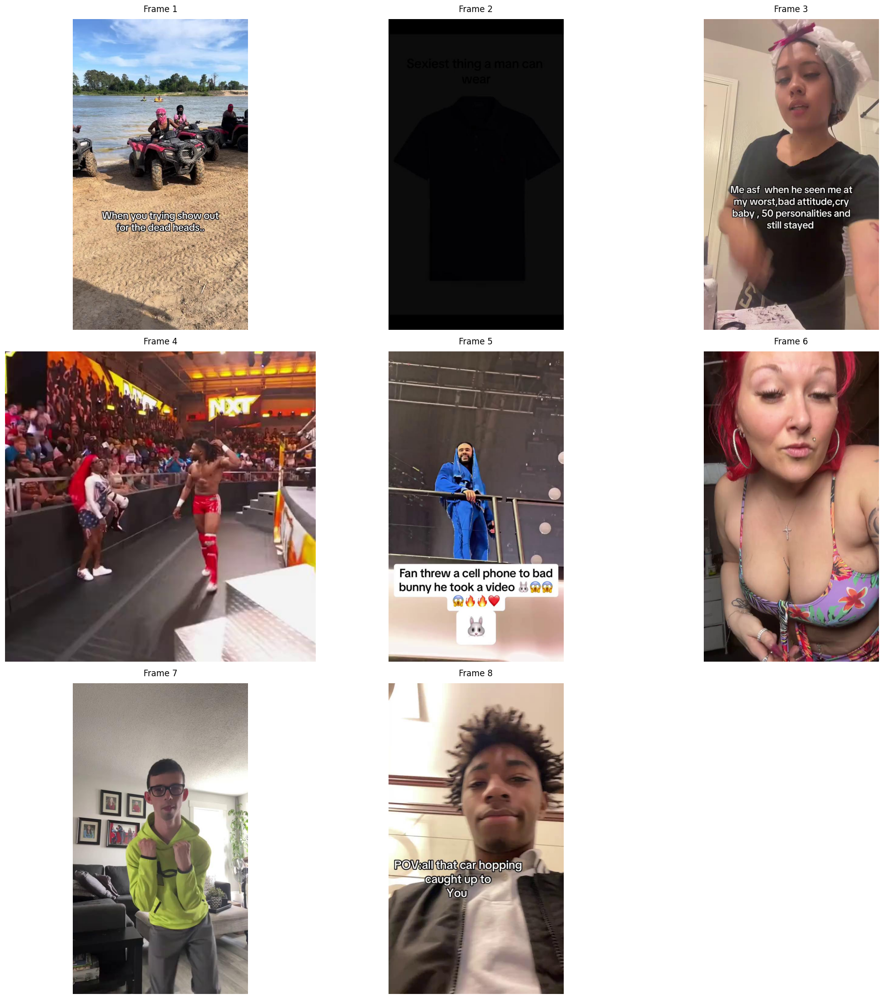

In [62]:
import matplotlib.pyplot as plt
import os
import math

def plot_image_grid(folder_path):
    # Get all jpg files from the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith('.jpg')]
    
    if not image_files:
        print(f"No jpg files found in {folder_path}")
        return
        
    # Sort files by number in filename to maintain order
    image_files.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))
    
    # Calculate grid dimensions (trying to make it as square as possible)
    n_images = len(image_files)
    n_cols = math.ceil(math.sqrt(n_images))
    n_rows = math.ceil(n_images / n_cols)
    
    # Create figure with subplots
    fig = plt.figure(figsize=(20, 20))
    
    # Plot each image
    for idx, img_file in enumerate(image_files):
        img_path = os.path.join(folder_path, img_file)
        try:
            # Read and display image
            image = plt.imread(img_path)
            ax = fig.add_subplot(n_rows, n_cols, idx + 1)
            ax.imshow(image)
            ax.axis('off')
            ax.set_title(f'Frame {idx + 1}', pad=10)
            
        except Exception as e:
            print(f"Error loading image {img_file}: {e}")
    
    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()
    
    return fig

# Example usage:
# Replace with your actual folder path containing the extracted frames
folder_path = folder_path  # Use the timestamp folder created by previous script
fig = plot_image_grid(folder_path)

Processing images:  12%|█▎        | 1/8 [00:01<00:12,  1.75s/it]


Results for extracted_frame_2.jpg:
Number of keypoints: 9
Number of persons: 0


Processing images:  25%|██▌       | 2/8 [00:03<00:10,  1.75s/it]


Results for extracted_frame_3.jpg:
Number of keypoints: 0
Number of persons: 0


Processing images:  38%|███▊      | 3/8 [00:05<00:08,  1.76s/it]


Results for extracted_frame_4.jpg:
Number of keypoints: 18
Number of persons: 1


Processing images:  50%|█████     | 4/8 [00:06<00:05,  1.47s/it]


Results for extracted_frame_5.jpg:
Number of keypoints: 48
Number of persons: 3


Processing images:  62%|██████▎   | 5/8 [00:08<00:04,  1.62s/it]


Results for extracted_frame_7.jpg:
Number of keypoints: 18
Number of persons: 1


Processing images:  75%|███████▌  | 6/8 [00:09<00:03,  1.67s/it]


Results for extracted_frame_8.jpg:
Number of keypoints: 19
Number of persons: 1


Processing images:  88%|████████▊ | 7/8 [00:11<00:01,  1.69s/it]


Results for extracted_frame_9.jpg:
Number of keypoints: 18
Number of persons: 1


Processing images: 100%|██████████| 8/8 [00:13<00:00,  1.68s/it]


Results for extracted_frame_10.jpg:
Number of keypoints: 10
Number of persons: 1


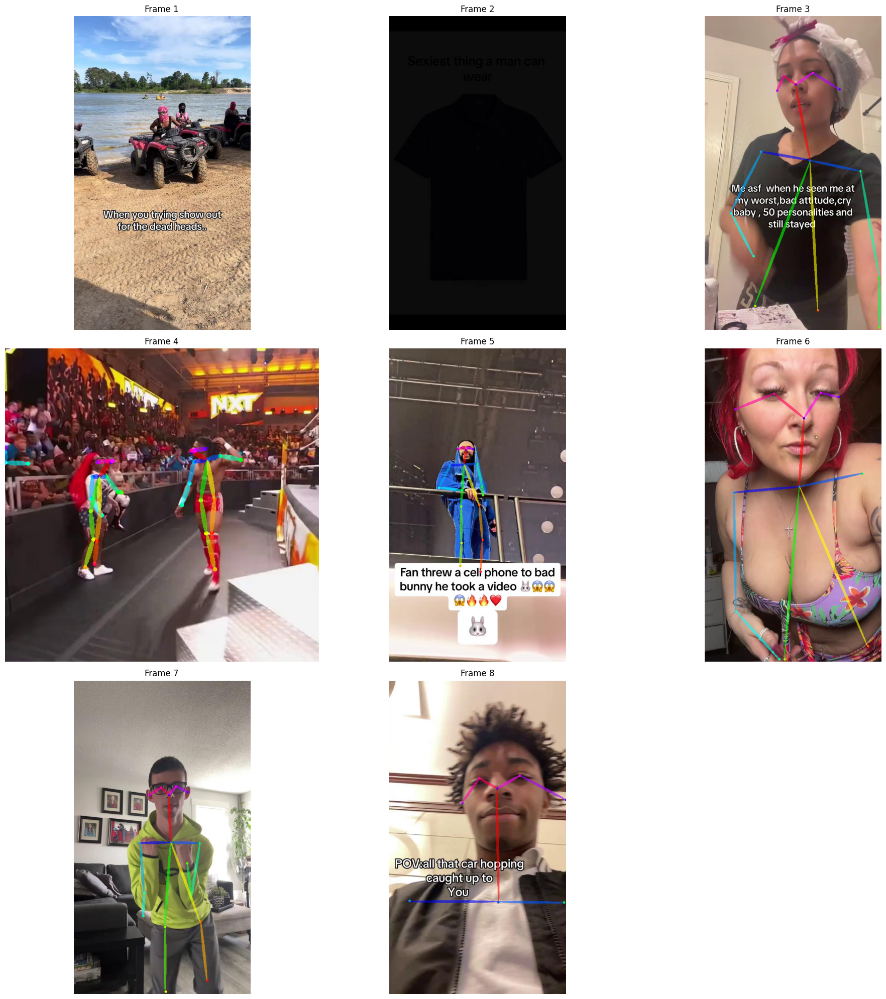


Processing Summary:
Total images processed: 8

extracted_frame_2.jpg:
  Keypoints detected: 9
  Persons detected: 0

extracted_frame_3.jpg:
  Keypoints detected: 0
  Persons detected: 0

extracted_frame_4.jpg:
  Keypoints detected: 18
  Persons detected: 1

extracted_frame_5.jpg:
  Keypoints detected: 48
  Persons detected: 3

extracted_frame_7.jpg:
  Keypoints detected: 18
  Persons detected: 1

extracted_frame_8.jpg:
  Keypoints detected: 19
  Persons detected: 1

extracted_frame_9.jpg:
  Keypoints detected: 18
  Persons detected: 1

extracted_frame_10.jpg:
  Keypoints detected: 10
  Persons detected: 1


In [63]:
import cv2
import copy
import os
from tqdm import tqdm  # for progress bar
import matplotlib.pyplot as plt

def process_folder_poses(folder_path, body_estimation, util):
    """
    Process all images in a folder with body pose estimation
    Returns dictionaries with results and processed images
    """
    # Get all jpg files from the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith('.jpg')]
    image_files.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))
    
    # Store results
    results = {}
    processed_images = {}
    
    # Process each image
    for img_file in tqdm(image_files, desc="Processing images"):
        img_path = os.path.join(folder_path, img_file)
        try:
            # Read image
            oriImg = cv2.imread(img_path)
            if oriImg is None:
                print(f"Failed to read image: {img_file}")
                continue
                
            # Process image
            candidate, subset = body_estimation(oriImg)
            
            # Draw poses
            canvas = copy.deepcopy(oriImg)
            canvas = util.draw_bodypose(canvas, candidate, subset)
            
            # Store results
            results[img_file] = {
                'candidate': candidate,
                'subset': subset,
                'num_keypoints': len(candidate),
                'num_persons': len(subset)
            }
            
            # Store processed image
            processed_images[img_file] = canvas
            
            print(f"\nResults for {img_file}:")
            print(f"Number of keypoints: {len(candidate)}")
            print(f"Number of persons: {len(subset)}")
            
        except Exception as e:
            print(f"Error processing {img_file}: {e}")
    
    return results, processed_images

def display_results(processed_images):
    """
    Display all processed images in a grid
    """
    n_images = len(processed_images)
    n_cols = int(math.ceil(math.sqrt(n_images)))
    n_rows = int(math.ceil(n_images / n_cols))
    
    plt.figure(figsize=(20, 20))
    
    for idx, (img_name, img) in enumerate(processed_images.items(), 1):
        plt.subplot(n_rows, n_cols, idx)
        # Convert BGR to RGB for matplotlib
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f'Frame {idx}')
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

def save_results(processed_images, output_folder):
    """
    Save processed images to output folder
    """
    os.makedirs(output_folder, exist_ok=True)
    for img_name, img in processed_images.items():
        output_path = os.path.join(output_folder, f'pose_{img_name}')
        cv2.imwrite(output_path, img)

# Main execution
if __name__ == "__main__":
    # Replace with your input folder path
    input_folder = folder_path
    output_folder = 'pose_results'
    
    # Process images
    results, processed_images = process_folder_poses(input_folder, body_estimation, util)
    
    # Display results
    display_results(processed_images)
    
    # Save results
    save_results(processed_images, output_folder)
    
    # Print summary
    print("\nProcessing Summary:")
    print(f"Total images processed: {len(processed_images)}")
    for img_name, result in results.items():
        print(f"\n{img_name}:")
        print(f"  Keypoints detected: {result['num_keypoints']}")
        print(f"  Persons detected: {result['num_persons']}")

Found 8 frames to process


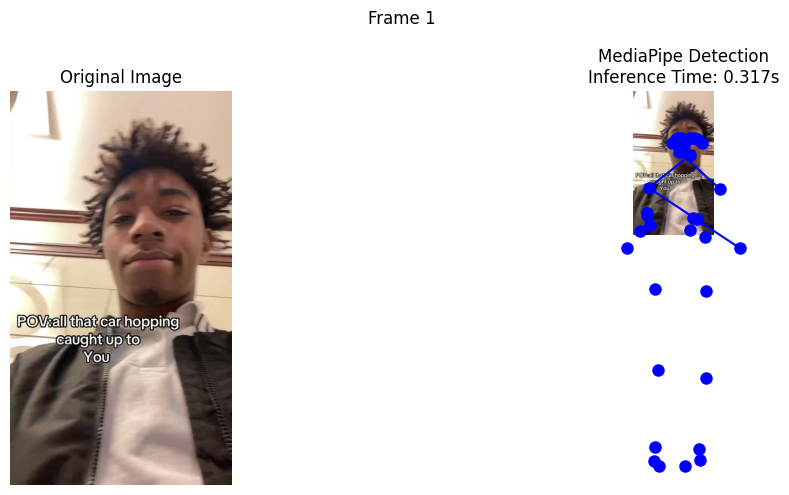

Processed frame 1/8


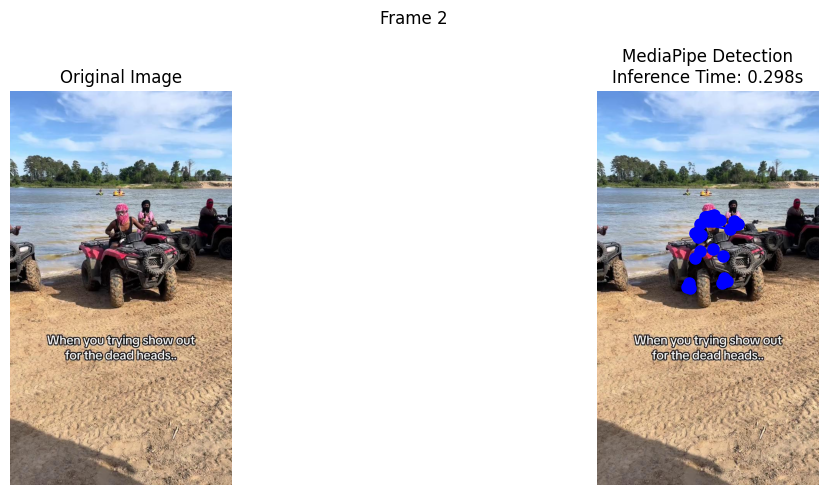

Processed frame 2/8


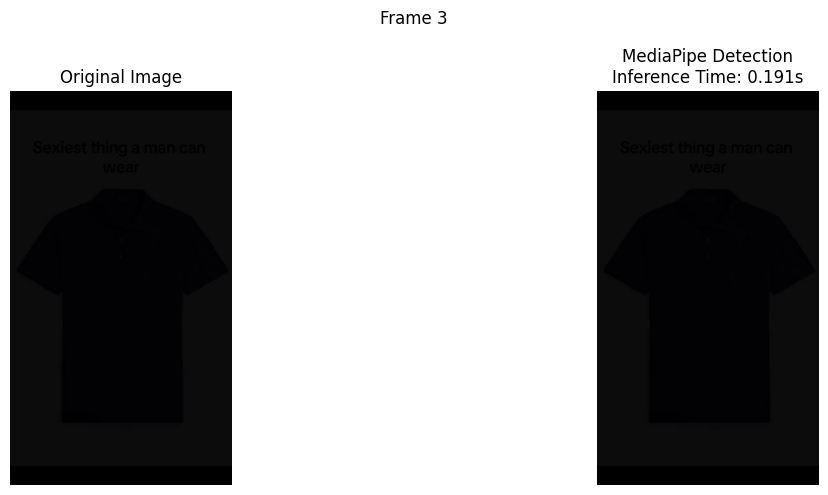

Processed frame 3/8


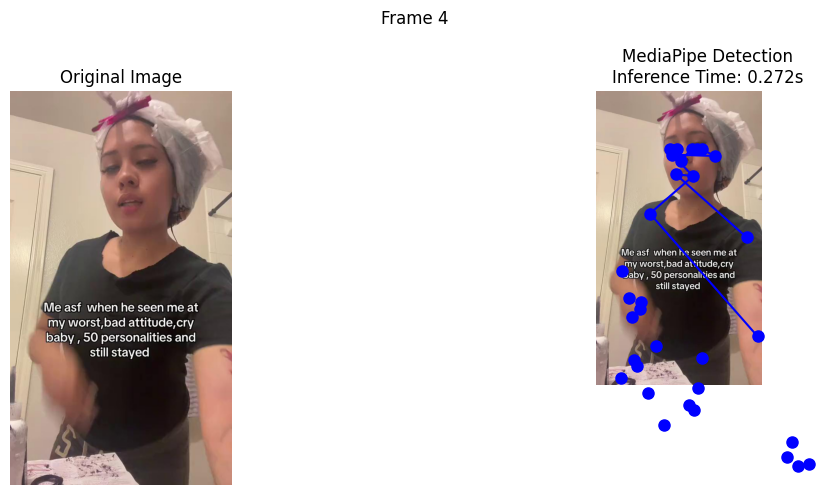

Processed frame 4/8


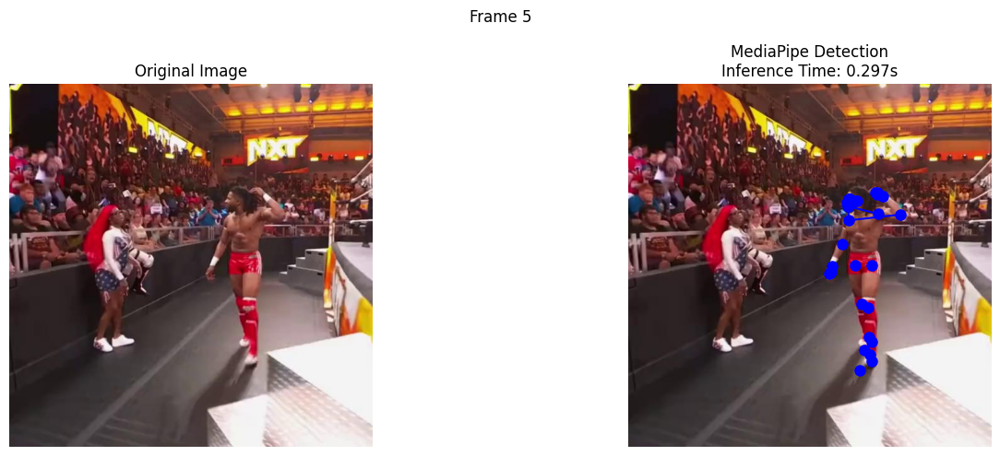

Processed frame 5/8


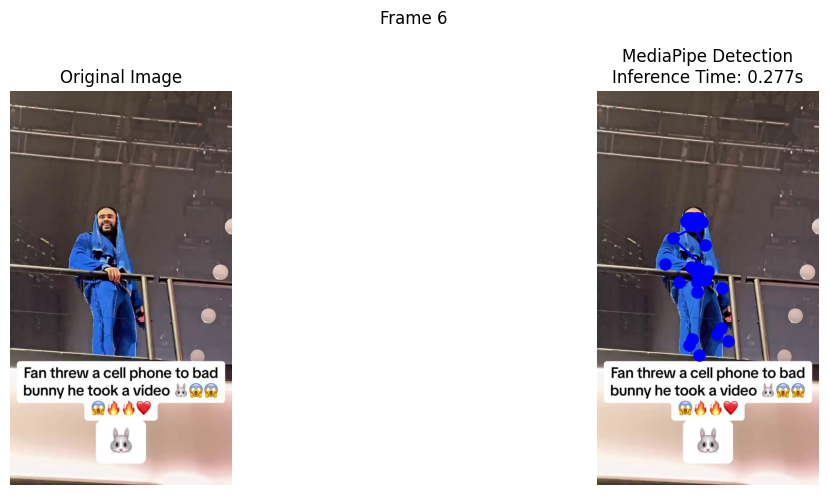

Processed frame 6/8


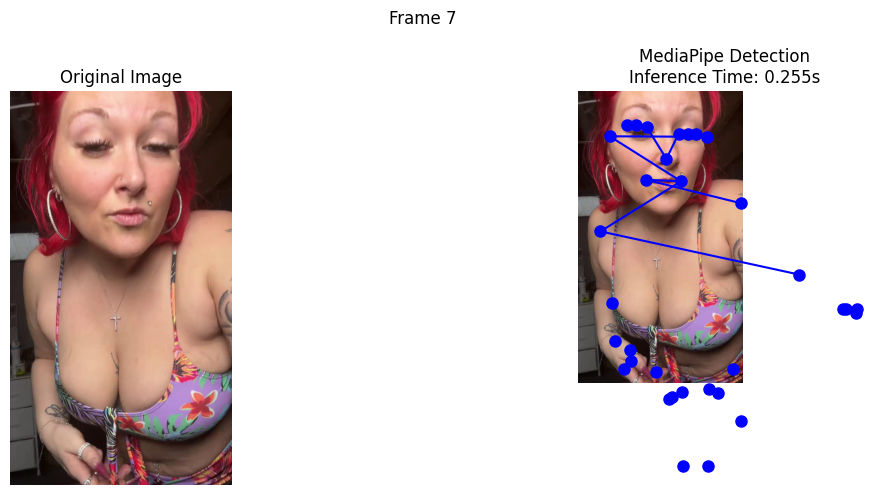

Processed frame 7/8


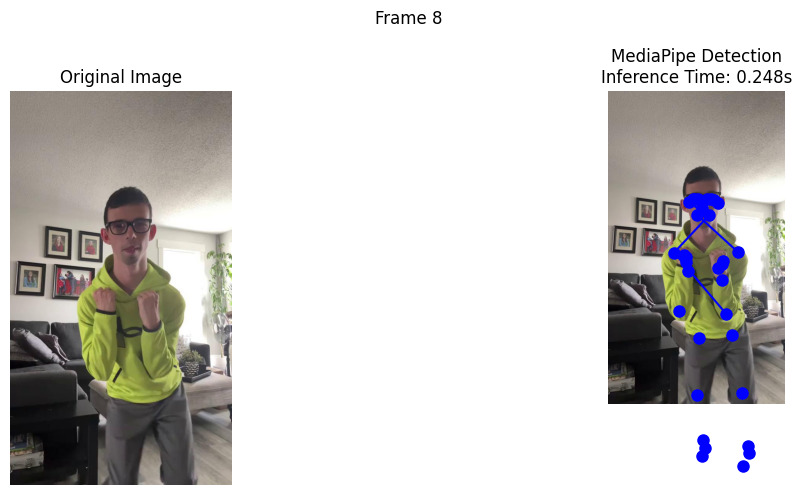

Processed frame 8/8

Processing Summary:
Successfully processed 8 frames
Average inference time: 0.270 seconds
Total processing time: 2.156 seconds


In [64]:
import time
import numpy as np
import cv2
import mediapipe as mp
import os
import matplotlib.pyplot as plt

def plot_pose_comparison(image, mediapipe_kpts, image_id, inference_time):
    """Create a comparison plot for a single image"""
    plt.figure(figsize=(15, 5))
    
    # Original Image
    plt.subplot(121)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')
    
    # MediaPipe Detection
    plt.subplot(122)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    if len(mediapipe_kpts) > 0:
        for i in range(len(mediapipe_kpts)):
            plt.plot(mediapipe_kpts[i, 0], mediapipe_kpts[i, 1], 'bo', markersize=8)
            
        # Draw connections between keypoints for better visualization
        # You can customize these connections based on your needs
        connections = [
            (0, 1), (1, 2), (2, 3), (3, 7),  # Right arm
            (0, 4), (4, 5), (5, 6),          # Left arm
            (7, 8), (8, 9),                   # Spine
            (9, 10), (10, 11),               # Right leg
            (9, 12), (12, 13)                # Left leg
        ]
        for connection in connections:
            if (connection[0] < len(mediapipe_kpts) and 
                connection[1] < len(mediapipe_kpts)):
                plt.plot([mediapipe_kpts[connection[0]][0], mediapipe_kpts[connection[1]][0]],
                        [mediapipe_kpts[connection[0]][1], mediapipe_kpts[connection[1]][1]], 'b-')
    
    plt.title(f'MediaPipe Detection\nInference Time: {inference_time:.3f}s')
    plt.axis('off')
    
    plt.suptitle(f'Frame {image_id}')
    plt.tight_layout()
    return plt.gcf()

def infer_keypoints_mediapipe(image):
    mp_pose = mp.solutions.pose
    with mp_pose.Pose(static_image_mode=True, model_complexity=2) as pose:
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        start_time = time.time()
        results_mp = pose.process(image_rgb)
        inference_time = time.time() - start_time

        mediapipe_keypoints = []
        if results_mp.pose_landmarks:
            for landmark in results_mp.pose_landmarks.landmark:
                mediapipe_keypoints.append([landmark.x * image.shape[1], landmark.y * image.shape[0]])
        
        return np.array(mediapipe_keypoints), inference_time

def process_video_frames(frames_dir):
    """Process all images in the video frames directory"""
    # Get all jpg files from the directory
    image_files = [f for f in os.listdir(frames_dir) if f.endswith('.jpg')]
    image_files.sort()  # Sort files to maintain order
    
    all_results = []
    total_time = 0
    successful_frames = 0
    
    print(f"Found {len(image_files)} frames to process")
    
    # Process each image
    for idx, image_file in enumerate(image_files, 1):
        image_path = os.path.join(frames_dir, image_file)
        image = cv2.imread(image_path)
        
        if image is None:
            print(f'Failed to load image: {image_path}')
            continue
            
        # Get MediaPipe predictions
        mediapipe_keypoints, inference_time = infer_keypoints_mediapipe(image)
        
        # Store results
        result = {
            'frame': image_file,
            'keypoints': mediapipe_keypoints,
            'inference_time': inference_time
        }
        all_results.append(result)
        
        # Create and show comparison plot
        fig = plot_pose_comparison(
            image,
            mediapipe_keypoints,
            idx,
            inference_time
        )
        plt.show()
        plt.close(fig)
        
        # Update statistics
        total_time += inference_time
        successful_frames += 1
        
        print(f"Processed frame {idx}/{len(image_files)}")
    
    # Print summary statistics
    if successful_frames > 0:
        print("\nProcessing Summary:")
        print(f"Successfully processed {successful_frames} frames")
        print(f"Average inference time: {total_time/successful_frames:.3f} seconds")
        print(f"Total processing time: {total_time:.3f} seconds")
    else:
        print("No frames were successfully processed")
    
    return all_results

# Main execution
if __name__ == "__main__":
    frames_dir = folder_path
    results = process_video_frames(frames_dir)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 2.1 MB/s eta 0:00:0000:0100:010m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 29.0 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 755.5/755.5 MB 990.9 kB/s eta 0:00:000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 4.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 61.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 52.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 41.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.9 MB/s eta 0:00:00:00:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 2.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 19.2 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 10.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/facenet_pytorch/models/mtcnn.py:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(state_dict_path)
/usr/local

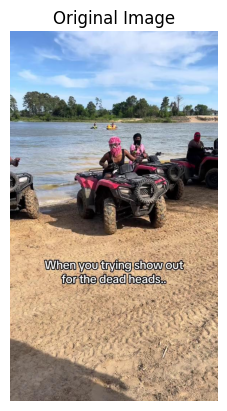

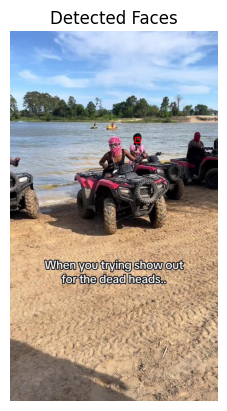

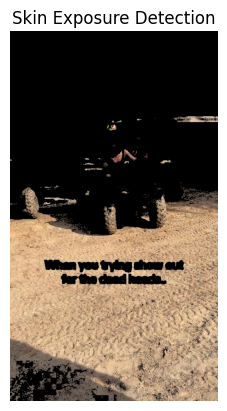

In [65]:
# Step 1: Install Required Libraries
!pip install facenet-pytorch opencv-python matplotlib

# Step 2: Import Libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from facenet_pytorch import MTCNN

# Step 3: Initialize MTCNN for Face Detection
mtcnn = MTCNN(keep_all=True)

# Step 4: Load and Preprocess the Image
image_path = "/kaggle/working/pytorch-openpose/video_frames_output/extracted_frame_2.jpg"  # Replace with your image path in Kaggle
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display the original image
plt.imshow(image_rgb)
plt.axis('off')
plt.title('Original Image')
plt.show()

# Step 5: Detect Faces
boxes, _ = mtcnn.detect(image_rgb)

# Draw boxes around detected faces
if boxes is not None:
    for box in boxes:
        cv2.rectangle(image_rgb, 
                      (int(box[0]), int(box[1])), 
                      (int(box[2]), int(box[3])), 
                      (255, 0, 0), 
                      2)

# Display the image with detected faces
plt.imshow(image_rgb)
plt.axis('off')
plt.title('Detected Faces')
plt.show()

# Step 6: Skin Exposure Detection
# Convert the image to HSV color space
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Define the lower and upper boundaries for skin color in HSV
lower_skin = np.array([0, 48, 80], dtype="uint8")
upper_skin = np.array([20, 255, 255], dtype="uint8")

# Create a skin mask
skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)

# Apply the mask to the original image
skin_exposure = cv2.bitwise_and(image, image, mask=skin_mask)

# Display the skin exposure result
plt.imshow(cv2.cvtColor(skin_exposure, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Skin Exposure Detection')
plt.show()

Found 8 frames to process


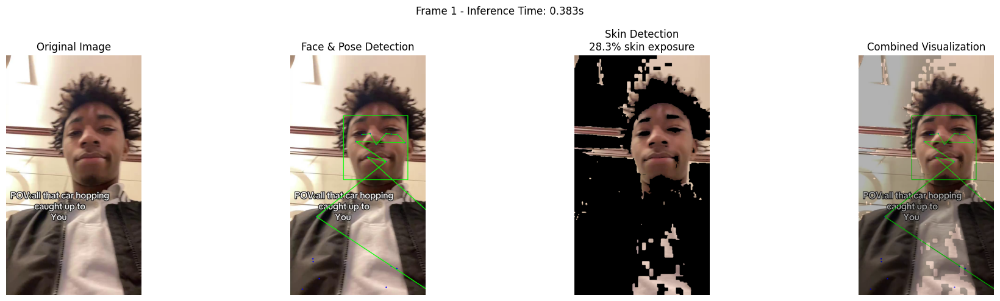

Processed frame 1/8
Skin exposure: 28.3%
Inference time: 0.383s
--------------------------------------------------


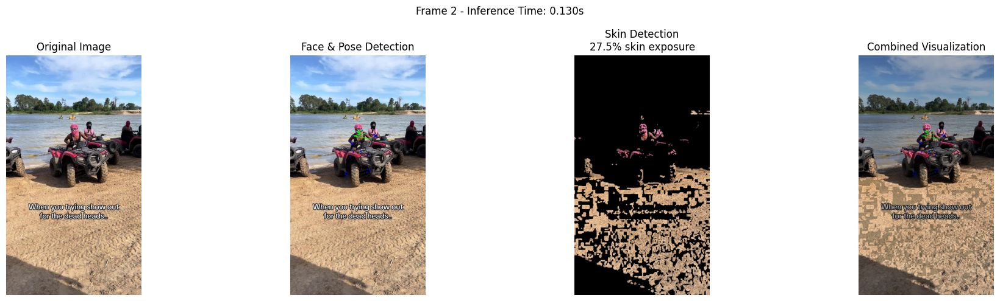

Processed frame 2/8
Skin exposure: 27.5%
Inference time: 0.130s
--------------------------------------------------


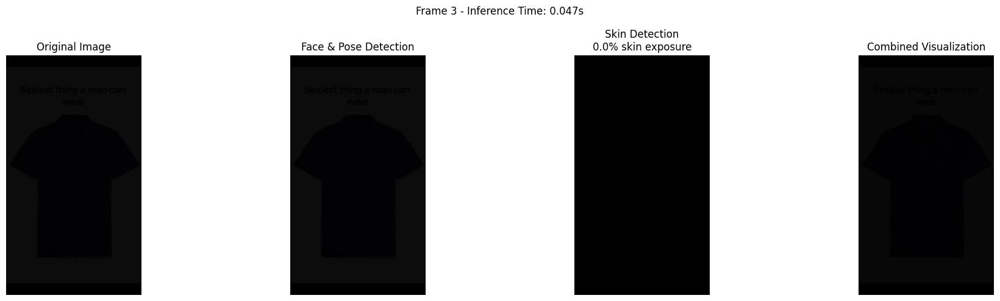

Processed frame 3/8
Skin exposure: 0.0%
Inference time: 0.047s
--------------------------------------------------


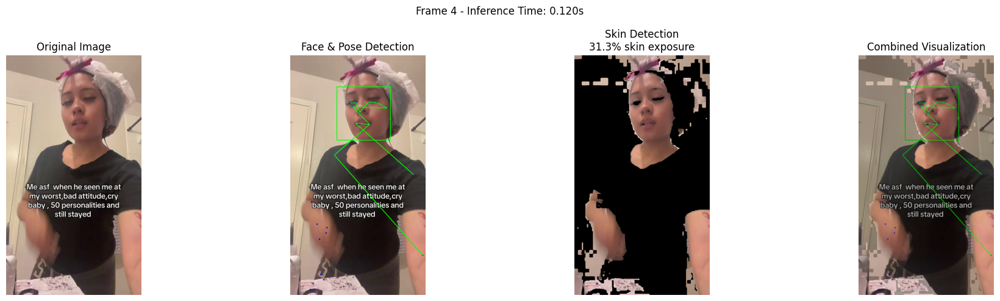

Processed frame 4/8
Skin exposure: 31.3%
Inference time: 0.120s
--------------------------------------------------


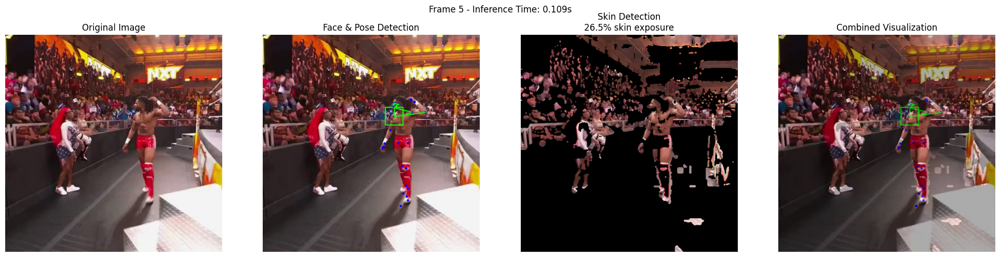

Processed frame 5/8
Skin exposure: 26.5%
Inference time: 0.109s
--------------------------------------------------


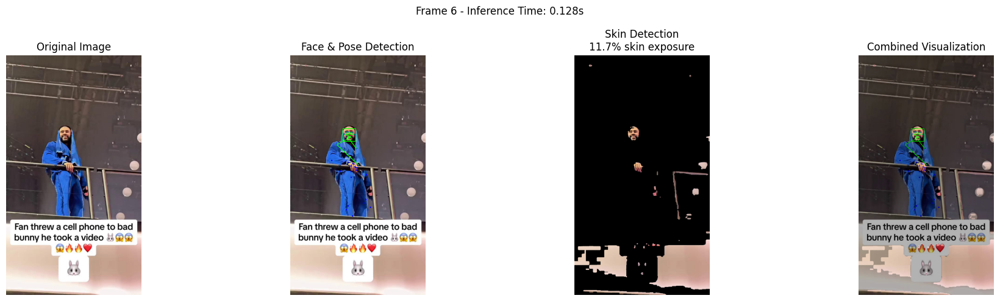

Processed frame 6/8
Skin exposure: 11.7%
Inference time: 0.128s
--------------------------------------------------


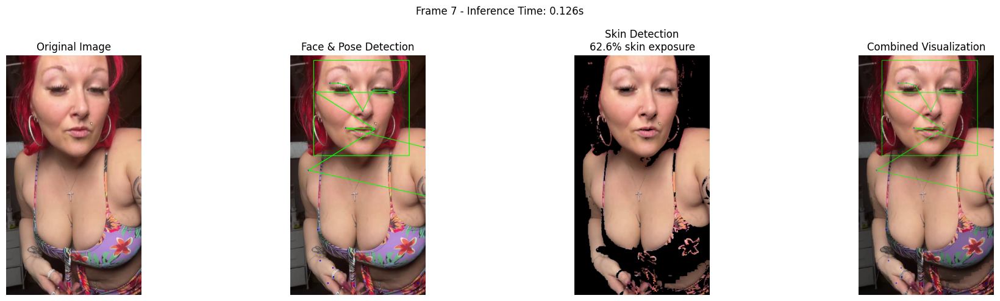

Processed frame 7/8
Skin exposure: 62.6%
Inference time: 0.126s
--------------------------------------------------


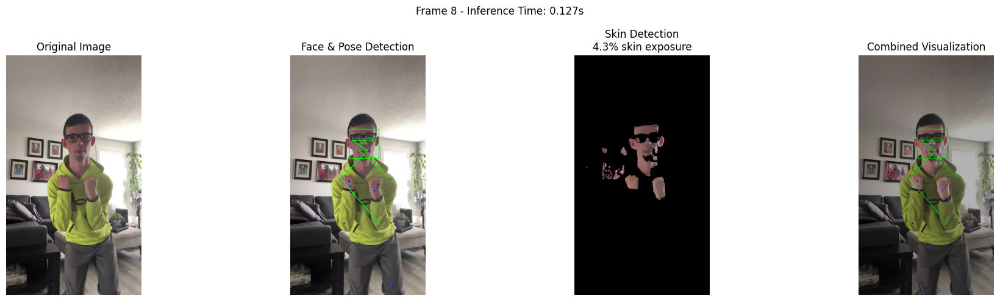

Processed frame 8/8
Skin exposure: 4.3%
Inference time: 0.127s
--------------------------------------------------


In [66]:
import cv2
import mediapipe as mp
import numpy as np
import matplotlib.pyplot as plt
import time
from typing import Tuple, Dict, List, Optional

class HumanAnalysisSystem:
    def __init__(self):
        # Initialize MediaPipe components
        self.mp_pose = mp.solutions.pose
        self.mp_face_detection = mp.solutions.face_detection
        
        # Initialize detectors with optimal parameters
        self.pose = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=2,
            min_detection_confidence=0.5
        )
        self.face_detector = self.mp_face_detection.FaceDetection(
            model_selection=1,  # 1 for full range detection
            min_detection_confidence=0.5
        )
        
        # Skin detection parameters
        self.skin_hsv_ranges = [
            # Light to medium skin tones
            (np.array([0, 20, 70], dtype="uint8"), np.array([15, 150, 255], dtype="uint8")),
            # Darker skin tones
            (np.array([165, 20, 70], dtype="uint8"), np.array([180, 150, 255], dtype="uint8"))
        ]
    
    def detect_skin(self, image: np.ndarray) -> np.ndarray:
        """
        Detect skin regions using multiple color space validations.
        """
        # Convert to float32 for precise calculations
        img_float = image.astype(np.float32) / 255.0
        
        # Split channels
        b, g, r = cv2.split(img_float)
        
        # Create initial mask based on skin tone rules
        skin_mask = np.ones_like(r, dtype=np.uint8)
        
        # Apply RGB relationship rules
        skin_mask &= ((r > g) & (r > b)).astype(np.uint8)
        r_g_diff = r - g
        skin_mask &= ((r_g_diff > 0.1) & (r_g_diff < 0.67)).astype(np.uint8)
        
        # HSV color space validation
        hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        hsv_mask = np.zeros_like(skin_mask)
        
        for lower, upper in self.skin_hsv_ranges:
            hsv_mask |= cv2.inRange(hsv, lower, upper)
        
        # Combine masks
        final_mask = cv2.bitwise_and(skin_mask * 255, hsv_mask)
        
        # Clean up mask
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        final_mask = cv2.erode(final_mask, kernel, iterations=1)
        final_mask = cv2.dilate(final_mask, kernel, iterations=2)
        
        return final_mask

    def process_frame(self, image: np.ndarray) -> Tuple[Dict, np.ndarray, float]:
        """
        Process a single frame for face, pose, and skin detection.
        """
        start_time = time.time()
        
        # Convert to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        height, width = image.shape[:2]
        
        # Initialize results dictionary
        results = {
            'face': [],
            'pose_landmarks': [],
            'skin_percentage': 0.0
        }
        
        # Detect face
        face_results = self.face_detector.process(image_rgb)
        if face_results.detections:
            for detection in face_results.detections:
                bbox = detection.location_data.relative_bounding_box
                x1 = int(bbox.xmin * width)
                y1 = int(bbox.ymin * height)
                w = int(bbox.width * width)
                h = int(bbox.height * height)
                results['face'].append([x1, y1, w, h])
        
        # Detect pose
        pose_results = self.pose.process(image_rgb)
        if pose_results.pose_landmarks:
            for landmark in pose_results.pose_landmarks.landmark:
                results['pose_landmarks'].append([
                    int(landmark.x * width),
                    int(landmark.y * height)
                ])
        
        # Detect skin
        skin_mask = self.detect_skin(image)
        skin_detected = cv2.bitwise_and(image, image, mask=skin_mask)
        
        # Calculate skin exposure percentage
        total_pixels = height * width
        skin_pixels = np.count_nonzero(skin_mask)
        results['skin_percentage'] = (skin_pixels / total_pixels) * 100
        
        inference_time = time.time() - start_time
        
        return results, skin_detected, inference_time

    def visualize_results(self, image: np.ndarray, results: Dict, skin_detected: np.ndarray, 
                         inference_time: float, frame_id: int):
        """
        Visualize detection results.
        """
        plt.figure(figsize=(20, 5))
        
        # Original image
        plt.subplot(141)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')
        
        # Face and pose detection
        plt.subplot(142)
        viz_image = image.copy()
        
        # Draw face boxes
        for (x, y, w, h) in results['face']:
            cv2.rectangle(viz_image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        
        # Draw pose landmarks and connections
        landmarks = np.array(results['pose_landmarks'])
        if len(landmarks) > 0:
            for point in landmarks:
                cv2.circle(viz_image, tuple(point), 3, (255, 0, 0), -1)
            
            # Define connections between landmarks
            connections = [
                (0, 1), (1, 2), (2, 3), (3, 7),  # Right arm
                (0, 4), (4, 5), (5, 6),          # Left arm
                (7, 8), (8, 9),                   # Spine
                (9, 10), (10, 11),               # Right leg
                (9, 12), (12, 13)                # Left leg
            ]
            
            for connection in connections:
                if (connection[0] < len(landmarks) and 
                    connection[1] < len(landmarks)):
                    cv2.line(viz_image, 
                            tuple(landmarks[connection[0]]),
                            tuple(landmarks[connection[1]]),
                            (0, 255, 0), 2)
        
        plt.imshow(cv2.cvtColor(viz_image, cv2.COLOR_BGR2RGB))
        plt.title('Face & Pose Detection')
        plt.axis('off')
        
        # Skin detection
        plt.subplot(143)
        plt.imshow(cv2.cvtColor(skin_detected, cv2.COLOR_BGR2RGB))
        plt.title(f'Skin Detection\n{results["skin_percentage"]:.1f}% skin exposure')
        plt.axis('off')
        
        # Combined visualization
        plt.subplot(144)
        combined = cv2.addWeighted(viz_image, 0.7, skin_detected, 0.3, 0)
        plt.imshow(cv2.cvtColor(combined, cv2.COLOR_BGR2RGB))
        plt.title('Combined Visualization')
        plt.axis('off')
        
        plt.suptitle(f'Frame {frame_id} - Inference Time: {inference_time:.3f}s')
        plt.tight_layout()
        plt.show()

def process_video_frames(frames_dir: str):
    """
    Process all frames in a directory.
    """
    analyzer = HumanAnalysisSystem()
    
    # Get all jpg files
    image_files = [f for f in os.listdir(frames_dir) if f.endswith('.jpg')]
    image_files.sort()
    
    print(f"Found {len(image_files)} frames to process")
    
    for idx, image_file in enumerate(image_files, 1):
        # Load image
        image_path = os.path.join(frames_dir, image_file)
        image = cv2.imread(image_path)
        
        if image is None:
            print(f'Failed to load image: {image_path}')
            continue
        
        # Process frame
        results, skin_detected, inference_time = analyzer.process_frame(image)
        
        # Visualize results
        analyzer.visualize_results(
            image,
            results,
            skin_detected,
            inference_time,
            idx
        )
        
        print(f"Processed frame {idx}/{len(image_files)}")
        print(f"Skin exposure: {results['skin_percentage']:.1f}%")
        print(f"Inference time: {inference_time:.3f}s")
        print("-" * 50)

if __name__ == "__main__":
    frames_dir = folder_path  # Replace with your frames directory
    process_video_frames(frames_dir)

In [5]:
import cv2
import mediapipe as mp
import numpy as np
import time
import os
import gc
from typing import Dict, Tuple
from IPython.display import clear_output

class MemoryEfficientAnalyzer:
    def __init__(self):
        # Initialize MediaPipe components with lower complexity models
        self.mp_pose = mp.solutions.pose
        self.mp_face_detection = mp.solutions.face_detection
        
        # Initialize detectors with memory-optimized parameters
        self.pose = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=1,  # Reduced from 2 to 1
            min_detection_confidence=0.5
        )
        self.face_detector = self.mp_face_detection.FaceDetection(
            model_selection=0,  # Use simpler model (0) instead of full-range (1)
            min_detection_confidence=0.5
        )
        
        # Simplified skin detection parameters
        self.skin_hsv_ranges = [
            # Light to medium skin tones
            (np.array([0, 20, 70], dtype="uint8"), np.array([15, 150, 255], dtype="uint8")),
            # Darker skin tones
            (np.array([165, 20, 70], dtype="uint8"), np.array([180, 150, 255], dtype="uint8"))
        ]
    
    def detect_skin(self, image: np.ndarray) -> np.ndarray:
        """Detect skin regions using simplified approach to save memory"""
        # Convert to HSV space
        hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Create mask from HSV ranges only (simpler than multi-space validation)
        skin_mask = np.zeros((image.shape[0], image.shape[1]), dtype="uint8")
        
        for lower, upper in self.skin_hsv_ranges:
            # Combine HSV ranges
            range_mask = cv2.inRange(hsv, lower, upper)
            skin_mask = cv2.bitwise_or(skin_mask, range_mask)
        
        # Simple cleanup
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_CLOSE, kernel)
        
        return skin_mask

    def process_frame(self, image: np.ndarray) -> Tuple[Dict, float]:
        """Process a single frame with reduced memory usage"""
        start_time = time.time()
        
        # Work with lower resolution for processing
        scale = 0.5  # Process at half resolution
        small_image = cv2.resize(image, (0, 0), fx=scale, fy=scale)
        
        # Convert to RGB for MediaPipe (reuse the same array)
        small_rgb = cv2.cvtColor(small_image, cv2.COLOR_BGR2RGB)
        height, width = small_image.shape[:2]
        
        # Initialize results dictionary
        results = {
            'face': [],
            'pose_landmarks': [],
            'skin_percentage': 0.0
        }
        
        # Detect face
        face_results = self.face_detector.process(small_rgb)
        if face_results.detections:
            for detection in face_results.detections:
                bbox = detection.location_data.relative_bounding_box
                x1 = int(bbox.xmin * width)
                y1 = int(bbox.ymin * height)
                w = int(bbox.width * width)
                h = int(bbox.height * height)
                results['face'].append([x1, y1, w, h])
        
        # Detect pose
        pose_results = self.pose.process(small_rgb)
        if pose_results.pose_landmarks:
            for landmark in pose_results.pose_landmarks.landmark:
                results['pose_landmarks'].append([
                    int(landmark.x * width),
                    int(landmark.y * height)
                ])
        
        # Detect skin
        skin_mask = self.detect_skin(small_image)
        
        # Calculate skin exposure percentage
        total_pixels = height * width
        skin_pixels = np.count_nonzero(skin_mask)
        results['skin_percentage'] = (skin_pixels / total_pixels) * 100
        
        # Release memory
        del small_rgb, small_image
        gc.collect()
        
        inference_time = time.time() - start_time
        
        return results, inference_time

    def visualize_cv2(self, image: np.ndarray, results: Dict, frame_id: int, output_dir: str = None):
        """Visualize results using OpenCV instead of matplotlib to save memory"""
        # Scale coordinates back to original image size
        h, w = image.shape[:2]
        scale_x = w / (w * 0.5)  # Assuming we processed at half resolution
        scale_y = h / (h * 0.5)
        
        # Create visualization (single image)
        viz_image = image.copy()
        
        # Draw faces
        for (x, y, w, h) in results['face']:
            # Scale back to original image
            x, y = int(x * scale_x), int(y * scale_y)
            w, h = int(w * scale_x), int(h * scale_y)
            cv2.rectangle(viz_image, (x, y), (x + w, y + h), (0, 255, 0), 2)
            
        # Draw pose landmarks
        landmarks = results['pose_landmarks']
        if landmarks:
            # Scale landmarks back to original image
            landmarks = [[int(x * scale_x), int(y * scale_y)] for x, y in landmarks]
            
            for point in landmarks[:min(15, len(landmarks))]:  # Limit number of points
                cv2.circle(viz_image, tuple(point), 3, (255, 0, 0), -1)
        
        # Detect skin directly on viz_image
        skin_mask = self.detect_skin(viz_image)
        
        # Add skin overlay
        skin_overlay = np.zeros_like(viz_image)
        skin_overlay[:, :, 2] = skin_mask  # Set red channel
        
        # Blend with 70% original, 30% overlay
        viz_image = cv2.addWeighted(viz_image, 0.7, skin_overlay, 0.3, 0)
        
        # Add text information
        cv2.putText(
            viz_image,
            f"Frame {frame_id} - Skin: {results['skin_percentage']:.1f}%",
            (10, 30),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.8,
            (255, 255, 255),
            2
        )
        
        # Save output if directory specified
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            cv2.imwrite(os.path.join(output_dir, f"frame_{frame_id:04d}.jpg"), viz_image)
            return None  # Don't return if saving
        
        return viz_image

def process_video_frames_efficiently(frames_dir: str, max_frames: int = 10, display_interval: int = 5, 
                                   output_dir: str = None):
    """Process frames with memory-efficient approach"""
    analyzer = MemoryEfficientAnalyzer()
    
    # Get all jpg files
    all_image_files = [f for f in os.listdir(frames_dir) if f.endswith('.jpg') or f.endswith('.png')]
    all_image_files.sort()
    
    # Limit number of frames to process
    if max_frames > 0 and len(all_image_files) > max_frames:
        # Take evenly spaced frames
        step = len(all_image_files) / max_frames
        image_files = [all_image_files[int(i * step)] for i in range(max_frames)]
    else:
        image_files = all_image_files
    
    print(f"Processing {len(image_files)} out of {len(all_image_files)} frames")
    
    # Container for results
    results_data = []
    
    # Process frames
    for idx, image_file in enumerate(image_files, 1):
        try:
            # Load image
            image_path = os.path.join(frames_dir, image_file)
            image = cv2.imread(image_path)
            
            if image is None:
                print(f'Failed to load image: {image_path}')
                continue
            
            # Resize to manageable dimensions
            max_dim = 800
            h, w = image.shape[:2]
            if max(h, w) > max_dim:
                scale = max_dim / max(h, w)
                image = cv2.resize(image, (0, 0), fx=scale, fy=scale)
            
            # Process frame
            results, inference_time = analyzer.process_frame(image)
            
            # Store results
            results_data.append({
                'frame': idx,
                'file': image_file,
                'skin_percentage': results['skin_percentage'],
                'face_count': len(results['face']),
                'has_pose': len(results['pose_landmarks']) > 0,
                'inference_time': inference_time
            })
            
            # Display progress
            print(f"Processed {idx}/{len(image_files)} - {image_file}")
            print(f"  Skin: {results['skin_percentage']:.1f}% | Faces: {len(results['face'])} | Time: {inference_time:.3f}s")
            
            # Visualize at intervals to save memory
            if idx % display_interval == 0:
                if output_dir:
                    # Save visualization
                    analyzer.visualize_cv2(image, results, idx, output_dir)
                    print(f"  Saved visualization to {output_dir}")
                else:
                    # Show in-notebook visualization
                    viz = analyzer.visualize_cv2(image, results, idx)
                    # Display using OpenCV (in notebook)
                    from IPython.display import display
                    from PIL import Image as PILImage
                    import io
                    
                    # Convert to PIL Image for display
                    viz_rgb = cv2.cvtColor(viz, cv2.COLOR_BGR2RGB)
                    pil_img = PILImage.fromarray(viz_rgb)
                    
                    # Clear previous output
                    clear_output(wait=True)
                    
                    # Show image
                    display(pil_img)
            
            # Explicitly free memory
            del image
            gc.collect()
            
        except Exception as e:
            print(f"Error processing frame {idx}: {e}")
    
    # Display summary
    print("\n===== Processing Summary =====")
    print(f"Total frames processed: {len(results_data)}")
    
    if results_data:
        # Calculate averages
        avg_skin = np.mean([r['skin_percentage'] for r in results_data])
        avg_time = np.mean([r['inference_time'] for r in results_data])
        face_frames = sum(1 for r in results_data if r['face_count'] > 0)
        pose_frames = sum(1 for r in results_data if r['has_pose'])
        
        print(f"Average skin exposure: {avg_skin:.1f}%")
        print(f"Frames with faces: {face_frames} ({face_frames/len(results_data)*100:.1f}%)")
        print(f"Frames with pose: {pose_frames} ({pose_frames/len(results_data)*100:.1f}%)")
        print(f"Average processing time: {avg_time:.3f}s")
    
    return results_data

# Example usage
if __name__ == "__main__":
    # Define folders
    frames_dir = folder_path  # Input frames
    output_dir = "/kaggle/working/analysis_output"  # Output directory (optional)
    
    # Process with memory optimizations
    # - Process only 20 frames max
    # - Display visualization every 5 frames
    # - Save visualizations to output directory
    results = process_video_frames_efficiently(
        frames_dir,
        max_frames=20,
        display_interval=5, 
        output_dir=output_dir
    )

Processing 8 out of 8 frames
Processed 1/8 - extracted_frame_10.jpg
  Skin: 55.1% | Faces: 1 | Time: 0.362s
Processed 2/8 - extracted_frame_2.jpg
  Skin: 44.9% | Faces: 0 | Time: 0.226s
Processed 3/8 - extracted_frame_3.jpg
  Skin: 0.0% | Faces: 0 | Time: 0.194s
Processed 4/8 - extracted_frame_4.jpg
  Skin: 51.3% | Faces: 1 | Time: 0.220s
Processed 5/8 - extracted_frame_5.jpg
  Skin: 49.4% | Faces: 1 | Time: 0.218s
  Saved visualization to /kaggle/working/analysis_output
Processed 6/8 - extracted_frame_7.jpg
  Skin: 57.6% | Faces: 0 | Time: 0.218s
Processed 7/8 - extracted_frame_8.jpg
  Skin: 67.3% | Faces: 1 | Time: 0.221s
Processed 8/8 - extracted_frame_9.jpg
  Skin: 38.7% | Faces: 1 | Time: 0.223s

===== Processing Summary =====
Total frames processed: 8
Average skin exposure: 45.5%
Frames with faces: 5 (62.5%)
Frames with pose: 7 (87.5%)
Average processing time: 0.235s


Found 8 images to process


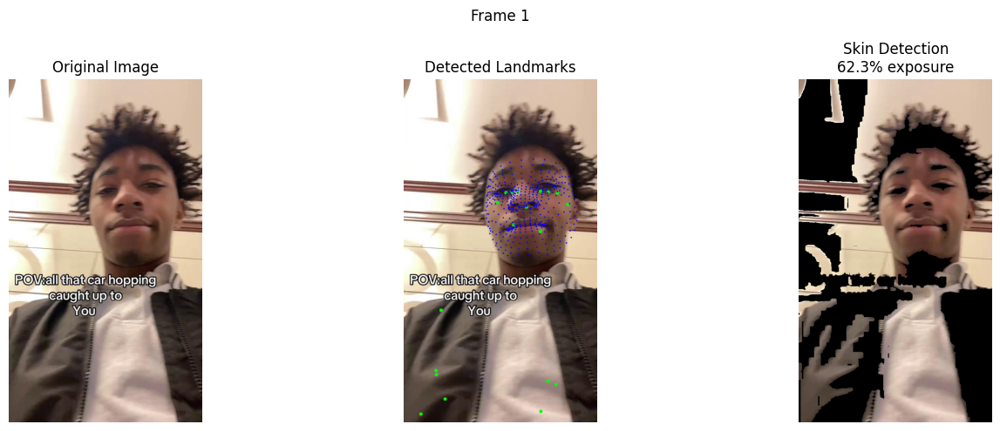

Processed frame 1/8 (inference time: 0.402s)


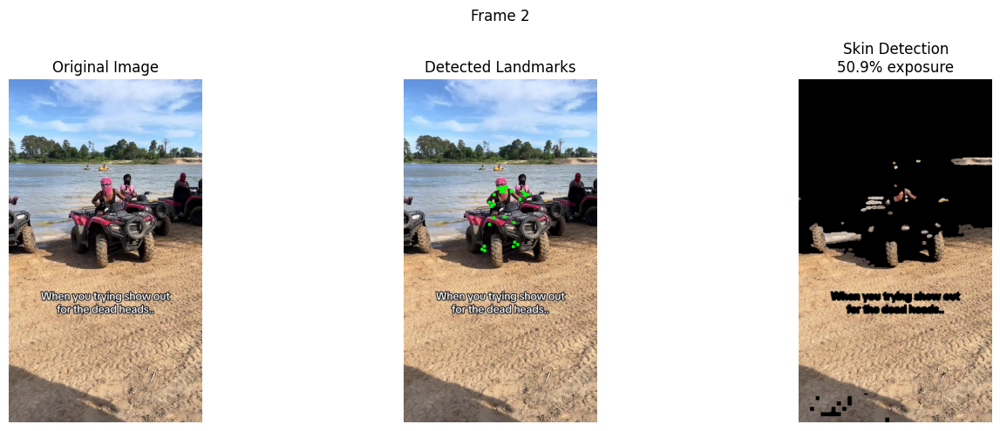

Processed frame 2/8 (inference time: 0.109s)


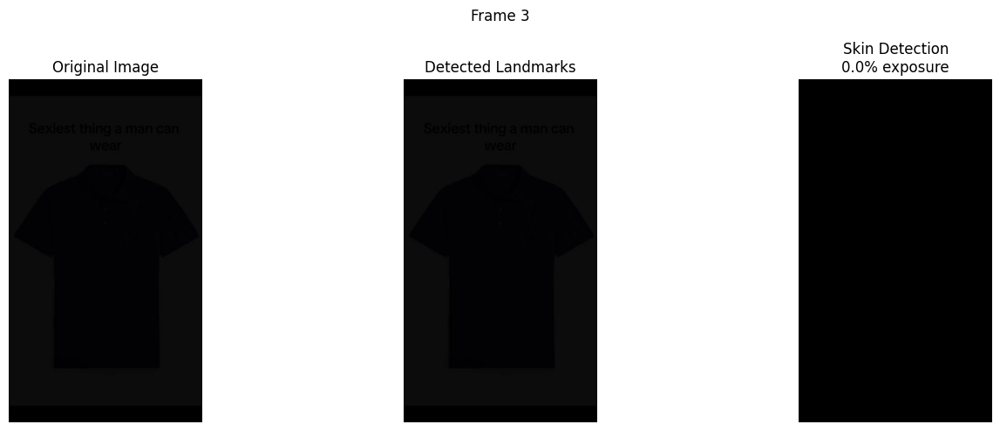

Processed frame 3/8 (inference time: 0.035s)


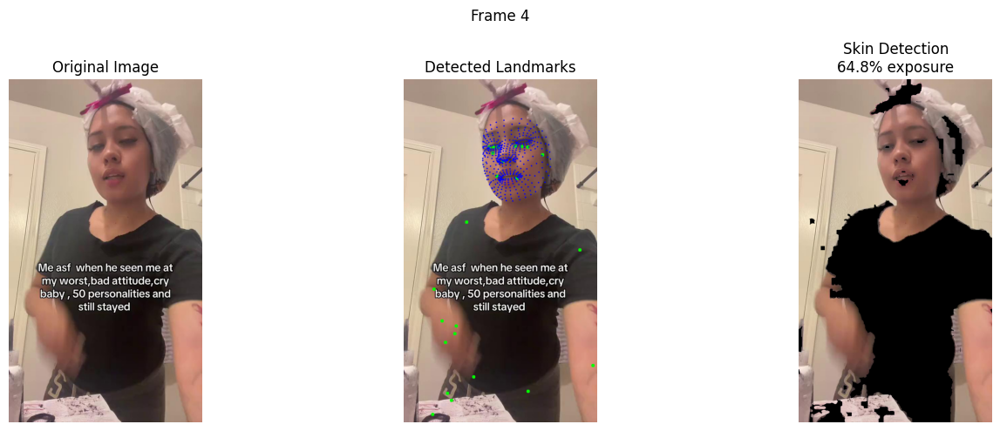

Processed frame 4/8 (inference time: 0.118s)


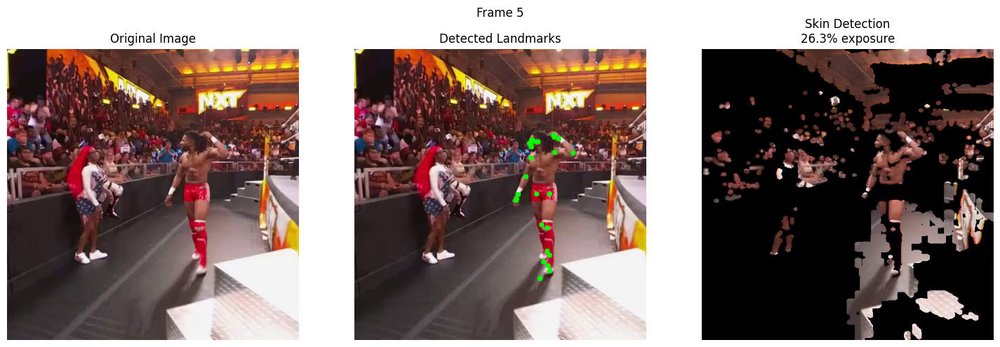

Processed frame 5/8 (inference time: 0.113s)


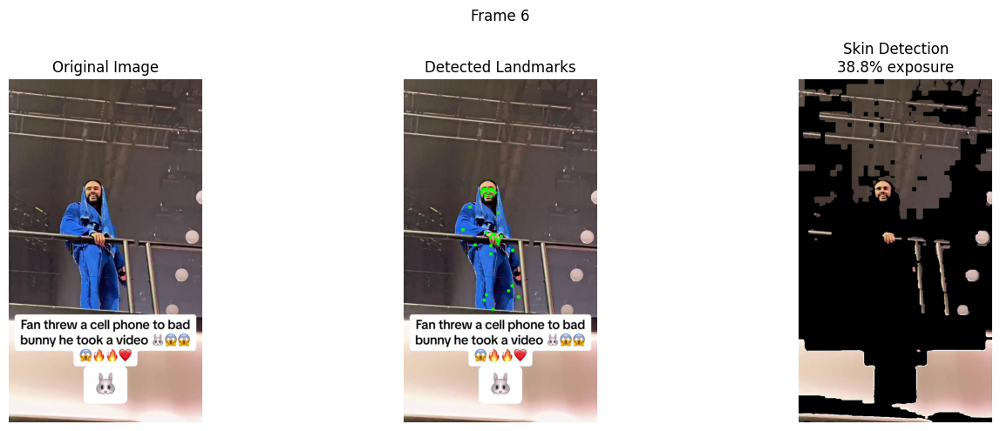

Processed frame 6/8 (inference time: 0.113s)


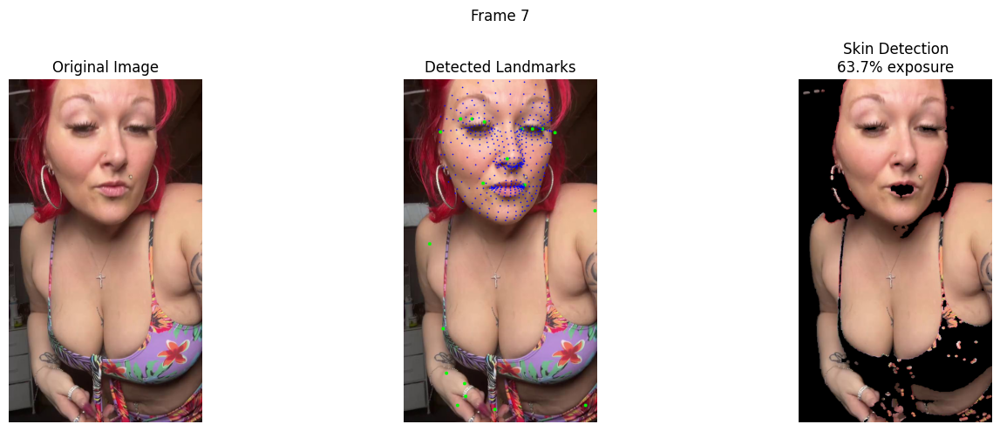

Processed frame 7/8 (inference time: 0.116s)


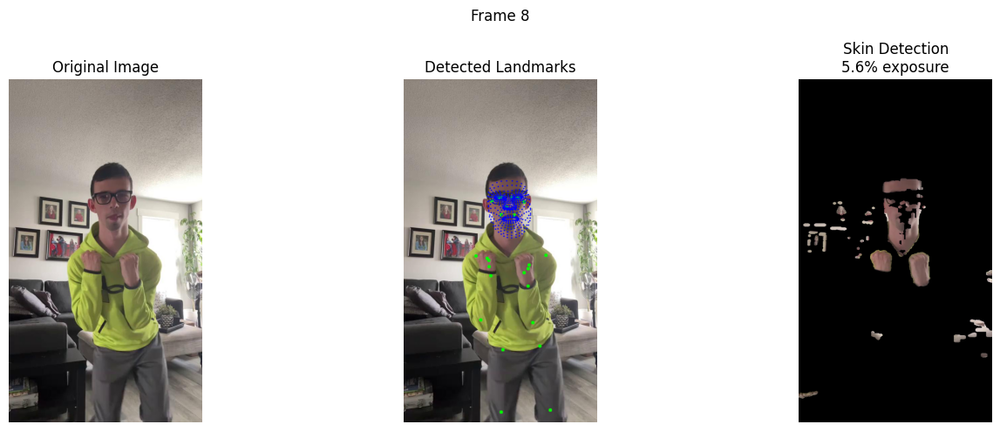

Processed frame 8/8 (inference time: 0.116s)


In [6]:
import cv2
import numpy as np
import mediapipe as mp
import matplotlib.pyplot as plt
import os
import time
from typing import Tuple, List, Dict

class BodySkinAnalyzer:
    def __init__(self):
        # Initialize MediaPipe
        self.mp_pose = mp.solutions.pose
        self.mp_face_mesh = mp.solutions.face_mesh
        
        # Initialize detectors with optimal parameters
        self.pose = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=2,
            min_detection_confidence=0.5
        )
        self.face_mesh = self.mp_face_mesh.FaceMesh(
            static_image_mode=True,
            max_num_faces=1,
            min_detection_confidence=0.5
        )
        
        # Skin detection parameters
        self.skin_lower = np.array([0, 20, 70], dtype=np.uint8)
        self.skin_upper = np.array([20, 150, 255], dtype=np.uint8)
        
    def detect_skin(self, image: np.ndarray) -> np.ndarray:
        """
        Detect skin regions using multiple color space validations.
        """
        # Convert to HSV
        hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Create initial mask using HSV
        mask = cv2.inRange(hsv, self.skin_lower, self.skin_upper)
        
        # Convert to YCrCb for additional validation
        ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
        ycrcb_mask = cv2.inRange(ycrcb, 
                                np.array([0, 135, 85]), 
                                np.array([255, 180, 135]))
        
        # Combine masks
        mask = cv2.bitwise_and(mask, ycrcb_mask)
        
        # Clean up mask
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        mask = cv2.erode(mask, kernel, iterations=1)
        mask = cv2.dilate(mask, kernel, iterations=2)
        
        return mask

    def analyze_frame(self, image: np.ndarray) -> Tuple[np.ndarray, Dict]:
        """
        Analyze a single frame for body landmarks and skin exposure.
        """
        # Convert to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        height, width = image.shape[:2]
        
        # Get pose landmarks
        pose_results = self.pose.process(image_rgb)
        face_results = self.face_mesh.process(image_rgb)
        
        # Create visualization image
        viz_image = image.copy()
        
        # Initialize results dictionary
        results = {
            'pose_landmarks': [],
            'face_landmarks': [],
            'skin_percentage': 0.0
        }
        
        # Process pose landmarks
        if pose_results.pose_landmarks:
            for landmark in pose_results.pose_landmarks.landmark:
                x = int(landmark.x * width)
                y = int(landmark.y * height)
                results['pose_landmarks'].append([x, y])
                cv2.circle(viz_image, (x, y), 5, (0, 255, 0), -1)
        
        # Process face landmarks
        if face_results.multi_face_landmarks:
            for face_landmarks in face_results.multi_face_landmarks:
                for landmark in face_landmarks.landmark:
                    x = int(landmark.x * width)
                    y = int(landmark.y * height)
                    results['face_landmarks'].append([x, y])
                    cv2.circle(viz_image, (x, y), 2, (255, 0, 0), -1)
        
        # Detect skin
        skin_mask = self.detect_skin(image)
        skin_detected = cv2.bitwise_and(image, image, mask=skin_mask)
        
        # Calculate skin exposure percentage
        total_pixels = width * height
        skin_pixels = cv2.countNonZero(skin_mask)
        skin_percentage = (skin_pixels / total_pixels) * 100
        results['skin_percentage'] = skin_percentage
        
        return viz_image, skin_detected, results

    def visualize_results(self, original: np.ndarray, viz_image: np.ndarray, 
                         skin_detected: np.ndarray, results: Dict, frame_id: int):
        """
        Create visualization of the analysis results.
        """
        plt.figure(figsize=(15, 5))
        
        # Original image
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')
        
        # Body and face landmarks
        plt.subplot(132)
        plt.imshow(cv2.cvtColor(viz_image, cv2.COLOR_BGR2RGB))
        plt.title('Detected Landmarks')
        plt.axis('off')
        
        # Skin detection
        plt.subplot(133)
        plt.imshow(cv2.cvtColor(skin_detected, cv2.COLOR_BGR2RGB))
        plt.title(f'Skin Detection\n{results["skin_percentage"]:.1f}% exposure')
        plt.axis('off')
        
        plt.suptitle(f'Frame {frame_id}')
        plt.tight_layout()
        return plt.gcf()

def process_directory(input_dir: str) -> List[Dict]:
    """
    Process all images in a directory.
    """
    analyzer = BodySkinAnalyzer()
    results = []
    
    # Get all image files
    image_files = [f for f in os.listdir(input_dir) 
                  if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    image_files.sort()
    
    print(f"Found {len(image_files)} images to process")
    
    for idx, image_file in enumerate(image_files, 1):
        image_path = os.path.join(input_dir, image_file)
        image = cv2.imread(image_path)
        
        if image is None:
            print(f"Failed to load image: {image_path}")
            continue
        
        # Process image
        start_time = time.time()
        viz_image, skin_detected, frame_results = analyzer.analyze_frame(image)
        inference_time = time.time() - start_time
        
        # Create visualization
        fig = analyzer.visualize_results(
            image, viz_image, skin_detected, 
            frame_results, idx
        )
        plt.show()
        plt.close(fig)
        
        # Store results
        frame_results.update({
            'filename': image_file,
            'inference_time': inference_time
        })
        results.append(frame_results)
        
        print(f"Processed frame {idx}/{len(image_files)} "
              f"(inference time: {inference_time:.3f}s)")
    
    return results

# Usage example
if __name__ == "__main__":
    input_directory = folder_path  # Replace with your directory path
    results = process_directory(input_directory)

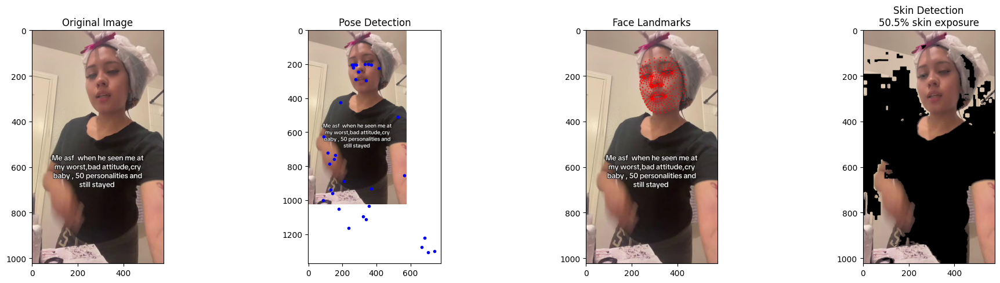

Processed extracted_frame_4.jpg - Skin exposure: 50.5%


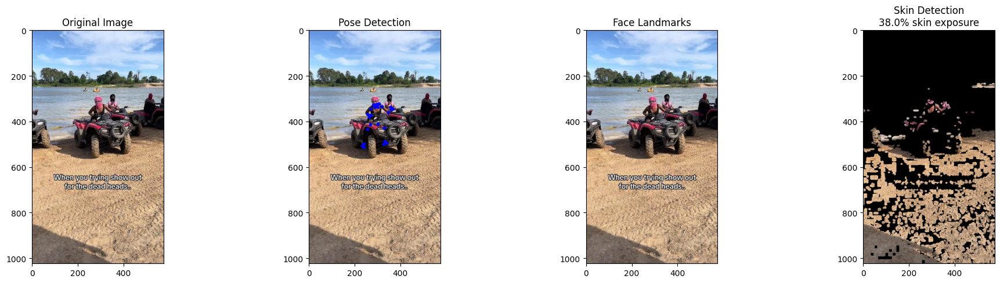

Processed extracted_frame_2.jpg - Skin exposure: 38.0%


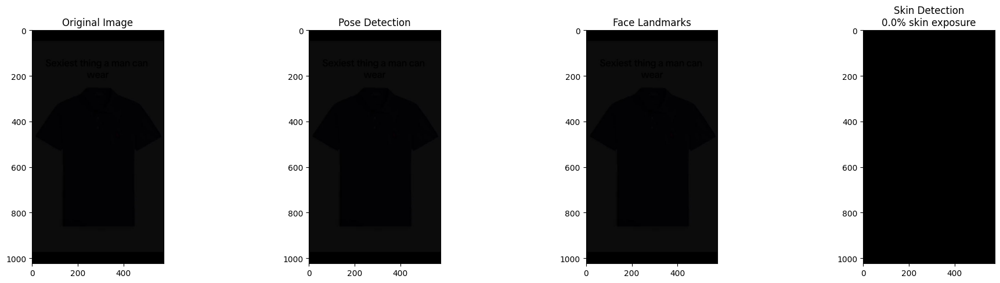

Processed extracted_frame_3.jpg - Skin exposure: 0.0%


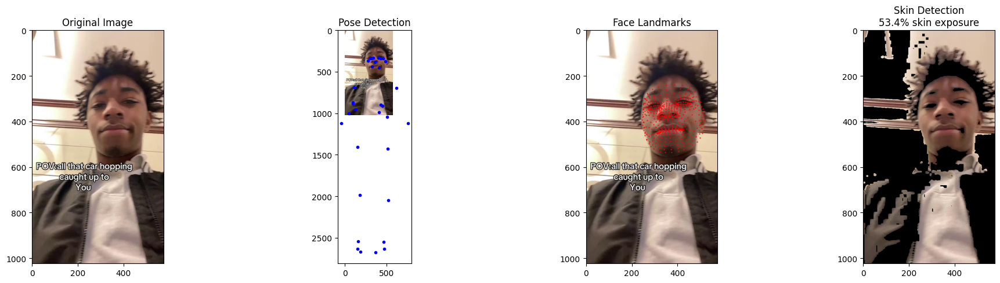

Processed extracted_frame_10.jpg - Skin exposure: 53.4%


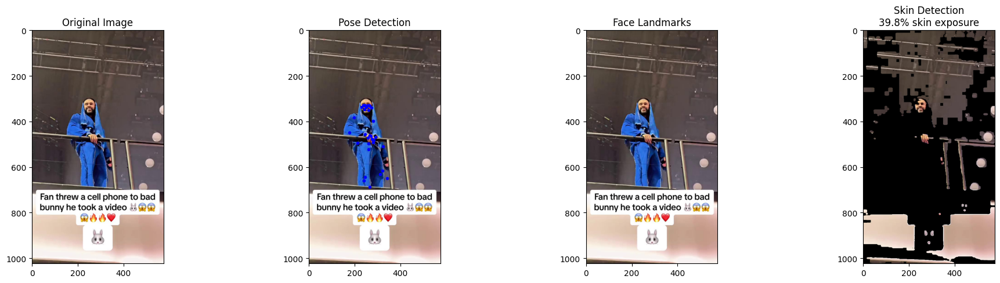

Processed extracted_frame_7.jpg - Skin exposure: 39.8%


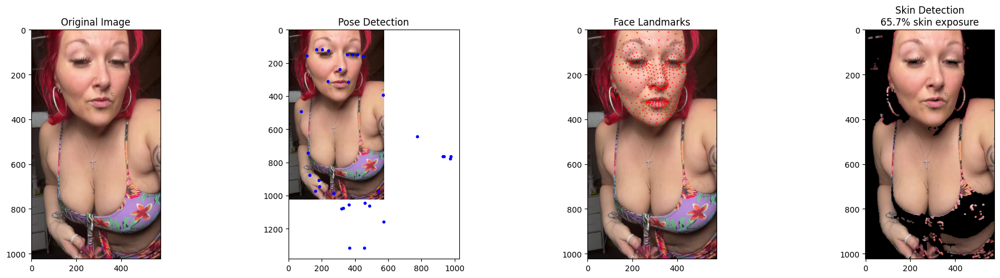

Processed extracted_frame_8.jpg - Skin exposure: 65.7%


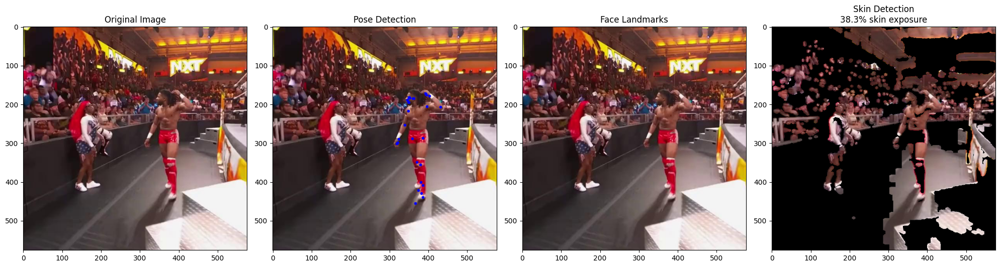

Processed extracted_frame_5.jpg - Skin exposure: 38.3%


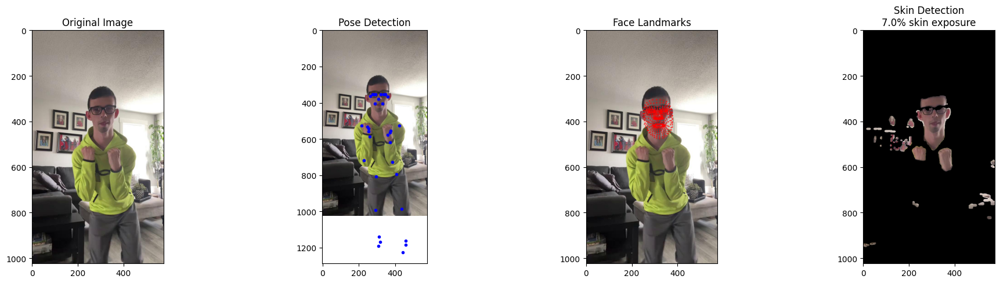

Processed extracted_frame_9.jpg - Skin exposure: 7.0%


In [68]:
import cv2
import numpy as np
import mediapipe as mp
import os
import matplotlib.pyplot as plt
import time
from typing import Dict, List, Tuple

class BodySkinAnalyzer:
    def __init__(self):
        # Initialize MediaPipe
        self.mp_pose = mp.solutions.pose
        self.mp_face_mesh = mp.solutions.face_mesh
        
        # Initialize detectors with optimal parameters
        self.pose = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=2,
            min_detection_confidence=0.5
        )
        self.face_mesh = self.mp_face_mesh.FaceMesh(
            static_image_mode=True,
            max_num_faces=1,
            min_detection_confidence=0.5
        )
        
        # Skin detection parameters
        self.skin_ycrcb_min = np.array([0, 135, 85], dtype=np.uint8)
        self.skin_ycrcb_max = np.array([255, 180, 135], dtype=np.uint8)
        self.skin_hsv_ranges = [
            (np.array([0, 20, 70], dtype=np.uint8), np.array([15, 150, 255], dtype=np.uint8)),
            (np.array([165, 20, 70], dtype=np.uint8), np.array([180, 150, 255], dtype=np.uint8))
        ]

    def detect_skin(self, image: np.ndarray) -> np.ndarray:
        """
        Detect skin regions using multiple color space validations.
        """
        ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
        hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        skin_mask = cv2.inRange(ycrcb, self.skin_ycrcb_min, self.skin_ycrcb_max)
        
        hsv_mask = np.zeros_like(skin_mask)
        for low, high in self.skin_hsv_ranges:
            hsv_mask |= cv2.inRange(hsv, low, high)
        
        final_mask = cv2.bitwise_and(skin_mask, hsv_mask)
        
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        final_mask = cv2.erode(final_mask, kernel, iterations=1)
        final_mask = cv2.dilate(final_mask, kernel, iterations=2)
        
        return final_mask

    def analyze_frame(self, image: np.ndarray) -> Tuple[Dict, float]:
        """
        Analyze a single frame for body pose and skin exposure.
        """
        start_time = time.time()
        
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        pose_results = self.pose.process(image_rgb)
        face_results = self.face_mesh.process(image_rgb)
        
        results = {
            'pose_landmarks': [],
            'face_landmarks': [],
            'skin_mask': None,
            'skin_percentage': 0.0
        }
        
        if pose_results.pose_landmarks:
            for landmark in pose_results.pose_landmarks.landmark:
                results['pose_landmarks'].append([
                    landmark.x * image.shape[1],
                    landmark.y * image.shape[0]
                ])
        
        if face_results.multi_face_landmarks:
            for landmark in face_results.multi_face_landmarks[0].landmark:
                results['face_landmarks'].append([
                    landmark.x * image.shape[1],
                    landmark.y * image.shape[0]
                ])
        
        skin_mask = self.detect_skin(image)
        results['skin_mask'] = skin_mask
        
        total_pixels = image.shape[0] * image.shape[1]
        skin_pixels = np.count_nonzero(skin_mask)
        results['skin_percentage'] = (skin_pixels / total_pixels) * 100
        
        inference_time = time.time() - start_time
        
        return results, inference_time

    def visualize_results(self, image: np.ndarray, results: Dict):
        """
        Visualize detection results and skin analysis.
        """
        plt.figure(figsize=(20, 5))
        
        plt.subplot(141)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        
        plt.subplot(142)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        pose_landmarks = np.array(results['pose_landmarks'])
        
        if len(pose_landmarks) > 0:
            plt.plot(pose_landmarks[:, 0], pose_landmarks[:, 1], 'bo', markersize=3)

        plt.title('Pose Detection')
        
        plt.subplot(143)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        face_landmarks = np.array(results['face_landmarks'])
        
        if len(face_landmarks) > 0:
            plt.plot(face_landmarks[:, 0], face_landmarks[:, 1], 'r.', markersize=1)

        plt.title('Face Landmarks')
        
        plt.subplot(144)
        skin_detection = cv2.bitwise_and(image, image, mask=results['skin_mask'])
        
        plt.imshow(cv2.cvtColor(skin_detection, cv2.COLOR_BGR2RGB))
        plt.title(f'Skin Detection\n{results["skin_percentage"]:.1f}% skin exposure')
        
        plt.tight_layout()
    
    def process_directory(self, directory_path: str) -> List[Dict]:
        """
        Process all images in a directory.
        """
        analyzer = BodySkinAnalyzer()
        
        image_files = [f for f in os.listdir(directory_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
        
        all_results = []
        
        for image_file in image_files:
            image_path = os.path.join(directory_path, image_file)
            image = cv2.imread(image_path)
            
            if image is None:
                print(f'Failed to load image: {image_path}')
                continue
            
            results, _ = analyzer.analyze_frame(image)
            
            frame_results = {
                'frame': image_file,
                'results': results,
            }
            all_results.append(frame_results)

            # Visualize results
            analyzer.visualize_results(image, results)
            plt.show()
            
            print(f"Processed {image_file} - Skin exposure: {results['skin_percentage']:.1f}%")
    
# Usage example
if __name__ == "__main__":
    frames_directory = folder_path  # Replace with your directory path
    analyzer = BodySkinAnalyzer()
    analyzer.process_directory(frames_directory)


In [69]:
import cv2
import numpy as np
import mediapipe as mp
import os
import matplotlib.pyplot as plt
import time
from typing import Dict, List, Tuple
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

class BodySkinAnalyzer:
    def __init__(self):
        # Initialize MediaPipe
        self.mp_pose = mp.solutions.pose
        self.mp_face_mesh = mp.solutions.face_mesh
        
        # Initialize detectors with optimal parameters
        self.pose = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=2,
            min_detection_confidence=0.5
        )
        self.face_mesh = self.mp_face_mesh.FaceMesh(
            static_image_mode=True,
            max_num_faces=1,
            min_detection_confidence=0.5
        )
        
        # Skin detection parameters
        self.skin_ycrcb_min = np.array([0, 135, 85], dtype=np.uint8)
        self.skin_ycrcb_max = np.array([255, 180, 135], dtype=np.uint8)
        self.skin_hsv_ranges = [
            (np.array([0, 20, 70], dtype=np.uint8), np.array([15, 150, 255], dtype=np.uint8)),
            (np.array([165, 20, 70], dtype=np.uint8), np.array([180, 150, 255], dtype=np.uint8))
        ]
        
        # Initialize the Random Forest Classifier
        self.model = RandomForestClassifier(n_estimators=100)

    def detect_skin(self, image: np.ndarray) -> np.ndarray:
        """
        Detect skin regions using multiple color space validations.
        """
        ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
        hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        skin_mask = cv2.inRange(ycrcb, self.skin_ycrcb_min, self.skin_ycrcb_max)
        
        hsv_mask = np.zeros_like(skin_mask)
        for low, high in self.skin_hsv_ranges:
            hsv_mask |= cv2.inRange(hsv, low, high)
        
        final_mask = cv2.bitwise_and(skin_mask, hsv_mask)
        
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        final_mask = cv2.erode(final_mask, kernel, iterations=1)
        final_mask = cv2.dilate(final_mask, kernel, iterations=2)
        
        return final_mask

    def extract_features(self, results: Dict) -> np.ndarray:
        """
        Extract features from landmarks and skin exposure.
        """
        skin_percentage = results['skin_percentage']
        pose_landmarks = results['pose_landmarks']
        
        # Example feature extraction: distances between landmarks
        if len(pose_landmarks) > 1:
            distances = [np.linalg.norm(np.array(pose_landmarks[i]) - np.array(pose_landmarks[j]))
                         for i in range(len(pose_landmarks)) for j in range(i + 1, len(pose_landmarks))]
            return np.array(distances + [skin_percentage])
        
        return np.zeros(0)  # Return zero array if no landmarks

    def analyze_frame(self, image: np.ndarray) -> Tuple[Dict, float]:
        """
        Analyze a single frame for body pose and skin exposure.
        """
        start_time = time.time()
        
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        pose_results = self.pose.process(image_rgb)
        face_results = self.face_mesh.process(image_rgb)
        
        results = {
            'pose_landmarks': [],
            'face_landmarks': [],
            'skin_mask': None,
            'skin_percentage': 0.0
        }
        
        if pose_results.pose_landmarks:
            for landmark in pose_results.pose_landmarks.landmark:
                results['pose_landmarks'].append([
                    landmark.x * image.shape[1],
                    landmark.y * image.shape[0]
                ])
        
        if face_results.multi_face_landmarks:
            for landmark in face_results.multi_face_landmarks[0].landmark:
                results['face_landmarks'].append([
                    landmark.x * image.shape[1],
                    landmark.y * image.shape[0]
                ])
        
        skin_mask = self.detect_skin(image)
        results['skin_mask'] = skin_mask
        
        total_pixels = image.shape[0] * image.shape[1]
        skin_pixels = np.count_nonzero(skin_mask)
        results['skin_percentage'] = (skin_pixels / total_pixels) * 100
        
        inference_time = time.time() - start_time
        
        return results, inference_time

    def train_model(self, X: np.ndarray, y: np.ndarray):
        """
        Train the Random Forest model with the provided features and labels.
        """
        self.model.fit(X, y)

    def predict_skin_exposure(self, features: np.ndarray) -> float:
        """
        Predict skin exposure using the trained model.
        """
        return self.model.predict(features.reshape(1, -1))[0]

    def visualize_results(self, image: np.ndarray, results: Dict) -> None:
         # Visualization code remains unchanged...
         pass

    def process_directory(self, directory_path: str) -> List[Dict]:
         # Directory processing code remains unchanged...
         pass

# Usage example
if __name__ == "__main__":
    frames_directory = folder_path  # Replace with your directory path
    
    analyzer = BodySkinAnalyzer()
    
    # Example of training the model with dummy data (replace with actual data collection logic)
    X_dummy = np.random.rand(1000, 10)  # Replace with actual feature data
    y_dummy = np.random.randint(0, 2, size=(1000))  # Replace with actual labels (binary classification example)
    
    analyzer.train_model(X_dummy, y_dummy)  # Train the model
    
    results = analyzer.process_directory(frames_directory)  # Process images in directory


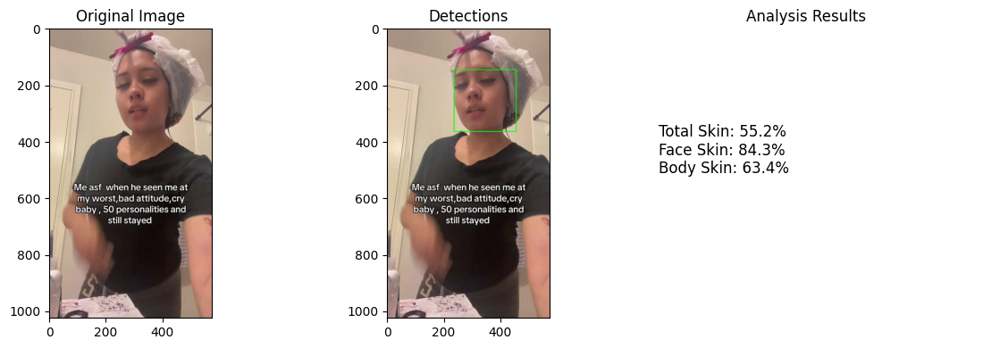

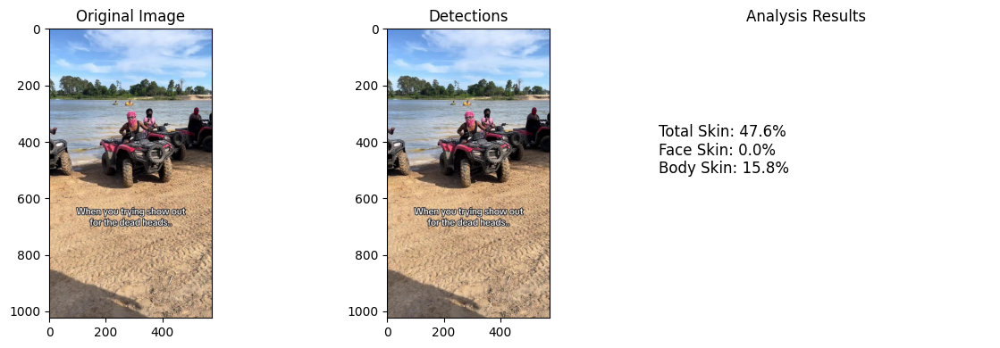

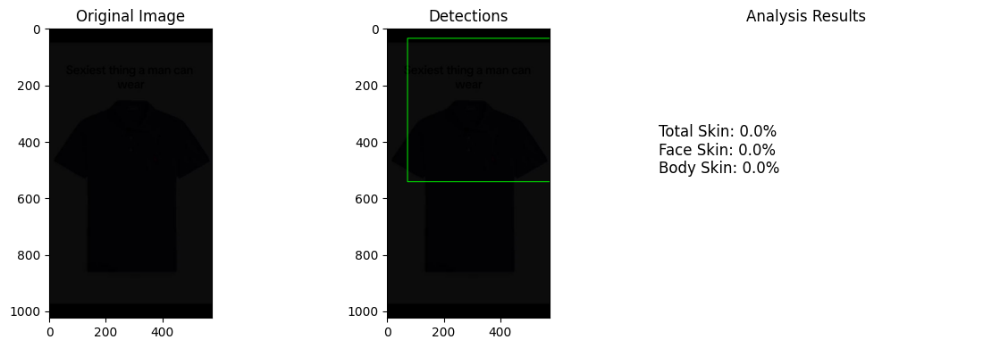

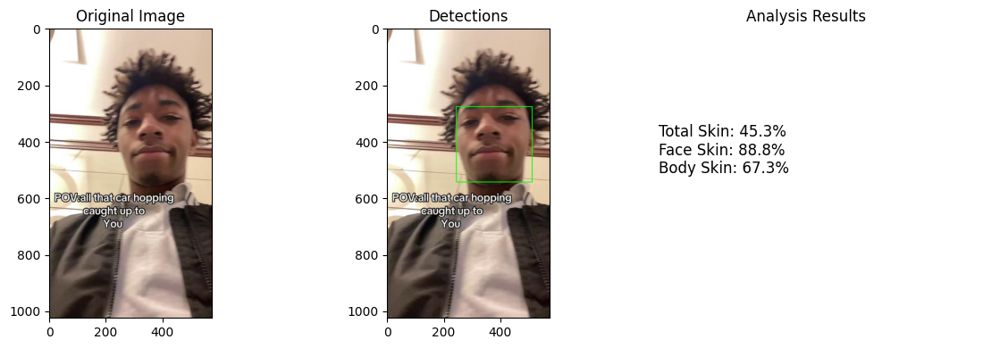

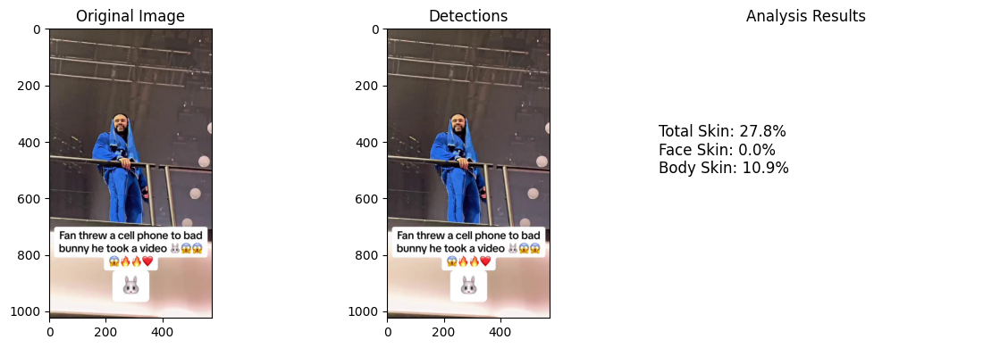

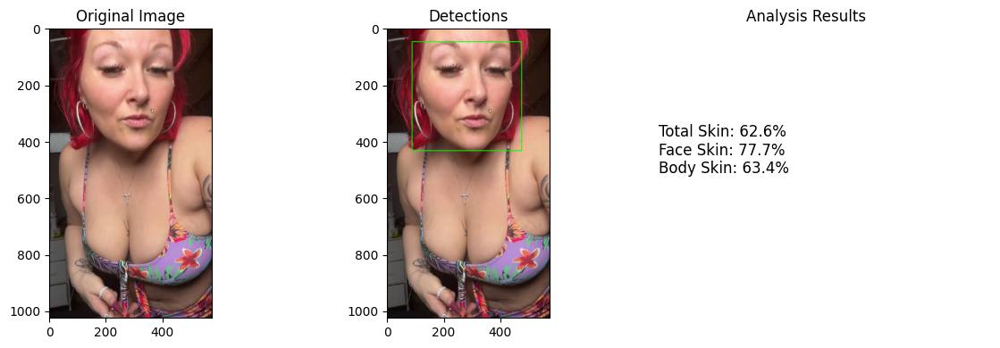

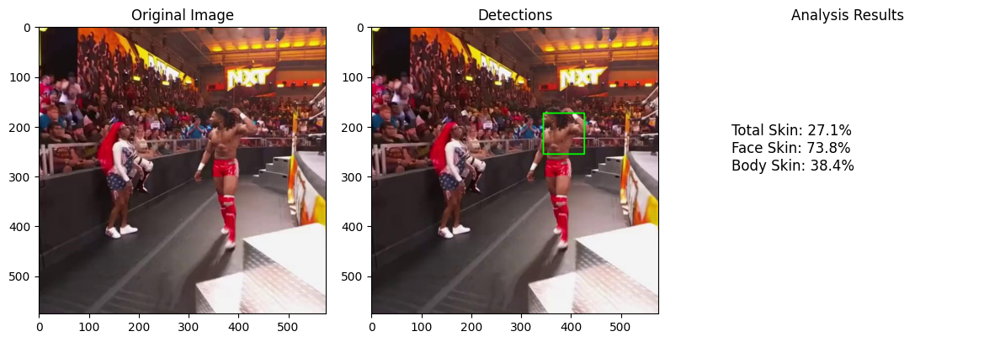

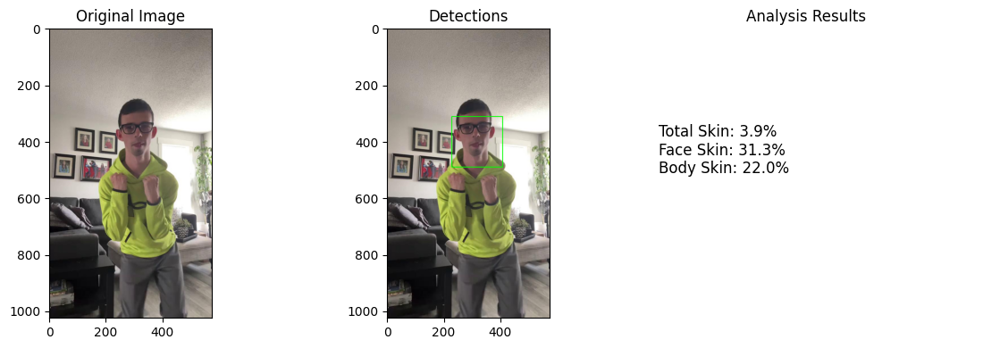

In [70]:
import cv2
import numpy as np
import mediapipe as mp
import os
from typing import Dict, List
import matplotlib.pyplot as plt

class BodySkinDetector:
    def __init__(self):
        # Initialize MediaPipe components
        self.mp_pose = mp.solutions.pose
        self.mp_face = mp.solutions.face_detection
        
        # Initialize detectors
        self.pose_detector = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=1,
            min_detection_confidence=0.5
        )
        self.face_detector = self.mp_face.FaceDetection(
            min_detection_confidence=0.5
        )
        
        # Skin detection thresholds
        self.skin_lower = np.array([0, 48, 80], dtype=np.uint8)
        self.skin_upper = np.array([20, 255, 255], dtype=np.uint8)

    def detect_body_face(self, image: np.ndarray) -> Dict:
        """
        Detect body pose and face in the image.
        """
        # Convert to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Get detections
        pose_results = self.pose_detector.process(image_rgb)
        face_results = self.face_detector.process(image_rgb)
        
        detection_results = {
            'pose_detected': False,
            'face_detected': False,
            'pose_landmarks': None,
            'face_box': None
        }
        
        # Process pose detection
        if pose_results.pose_landmarks:
            detection_results['pose_detected'] = True
            detection_results['pose_landmarks'] = pose_results.pose_landmarks
            
        # Process face detection
        if face_results.detections:
            detection_results['face_detected'] = True
            detection_results['face_box'] = face_results.detections[0].location_data.relative_bounding_box
            
        return detection_results

    def analyze_skin_exposure(self, image: np.ndarray, detection_results: Dict) -> Dict:
        """
        Analyze skin exposure in detected regions.
        """
        # Convert to HSV for skin detection
        hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Create skin mask
        skin_mask = cv2.inRange(hsv_image, self.skin_lower, self.skin_upper)
        
        # Refine mask
        kernel = np.ones((3,3), np.uint8)
        skin_mask = cv2.erode(skin_mask, kernel, iterations=1)
        skin_mask = cv2.dilate(skin_mask, kernel, iterations=2)
        
        h, w = image.shape[:2]
        skin_results = {
            'total_skin_percentage': 0,
            'face_skin_percentage': 0,
            'body_skin_percentage': 0
        }
        
        # Calculate total skin percentage
        total_pixels = h * w
        skin_pixels = np.count_nonzero(skin_mask)
        skin_results['total_skin_percentage'] = (skin_pixels / total_pixels) * 100
        
        # Calculate face skin percentage if face detected
        if detection_results['face_detected']:
            bbox = detection_results['face_box']
            x = int(bbox.xmin * w)
            y = int(bbox.ymin * h)
            width = int(bbox.width * w)
            height = int(bbox.height * h)
            
            face_mask = np.zeros_like(skin_mask)
            face_mask[y:y+height, x:x+width] = 1
            face_skin_pixels = np.count_nonzero(cv2.bitwise_and(skin_mask, face_mask))
            face_area = width * height
            skin_results['face_skin_percentage'] = (face_skin_pixels / face_area) * 100
        
        # Calculate body skin percentage if pose detected
        if detection_results['pose_detected']:
            # Create body mask using pose landmarks
            body_mask = np.zeros_like(skin_mask)
            landmarks = detection_results['pose_landmarks'].landmark
            
            for landmark in landmarks:
                x = int(landmark.x * w)
                y = int(landmark.y * h)
                cv2.circle(body_mask, (x, y), 30, 255, -1)
            
            body_skin_pixels = np.count_nonzero(cv2.bitwise_and(skin_mask, body_mask))
            body_area = np.count_nonzero(body_mask)
            if body_area > 0:
                skin_results['body_skin_percentage'] = (body_skin_pixels / body_area) * 100
        
        return skin_results

    def process_directory(self, directory_path: str) -> List[Dict]:
        """
        Process all images in the specified directory.
        """
        results = []
        valid_extensions = ('.jpg', '.jpeg', '.png')
        
        for filename in os.listdir(directory_path):
            if filename.lower().endswith(valid_extensions):
                image_path = os.path.join(directory_path, filename)
                image = cv2.imread(image_path)
                
                if image is None:
                    print(f"Failed to load image: {filename}")
                    continue
                
                # Detect body and face
                detection_results = self.detect_body_face(image)
                
                # Analyze skin exposure
                skin_results = self.analyze_skin_exposure(image, detection_results)
                
                # Store results
                result = {
                    'filename': filename,
                    'detection_results': detection_results,
                    'skin_results': skin_results
                }
                results.append(result)
                
                # Display results
                self.display_results(image, result)
                
        return results

    def display_results(self, image: np.ndarray, result: Dict):
        """
        Display detection and analysis results.
        """
        plt.figure(figsize=(12, 4))
        
        # Original image
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        
        # Detection visualization
        detection_img = image.copy()
        if result['detection_results']['face_detected']:
            h, w = image.shape[:2]
            bbox = result['detection_results']['face_box']
            x = int(bbox.xmin * w)
            y = int(bbox.ymin * h)
            width = int(bbox.width * w)
            height = int(bbox.height * h)
            cv2.rectangle(detection_img, (x, y), (x+width, y+height), (0, 255, 0), 2)
        
        plt.subplot(132)
        plt.imshow(cv2.cvtColor(detection_img, cv2.COLOR_BGR2RGB))
        plt.title('Detections')
        
        # Results text
        plt.subplot(133)
        plt.axis('off')
        skin_results = result['skin_results']
        info_text = f"Total Skin: {skin_results['total_skin_percentage']:.1f}%\n"
        info_text += f"Face Skin: {skin_results['face_skin_percentage']:.1f}%\n"
        info_text += f"Body Skin: {skin_results['body_skin_percentage']:.1f}%"
        plt.text(0.1, 0.5, info_text, fontsize=12)
        plt.title('Analysis Results')
        
        plt.tight_layout()
        plt.show()

# Usage example
if __name__ == "__main__":
    detector = BodySkinDetector()
    directory_path = folder_path # Replace with your directory path
    results = detector.process_directory(directory_path)

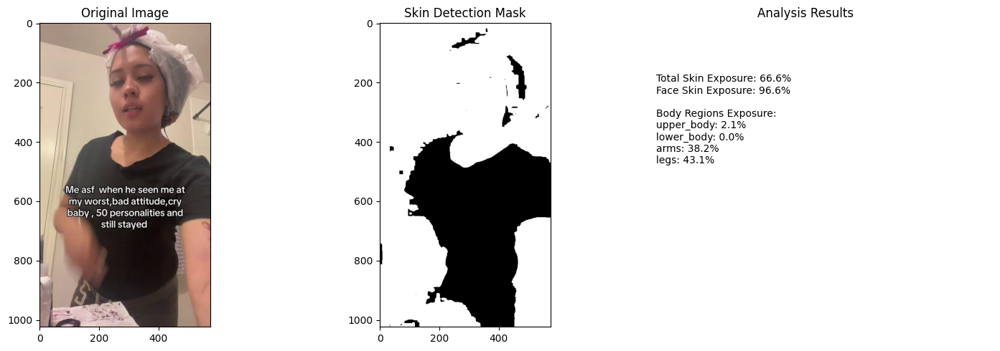

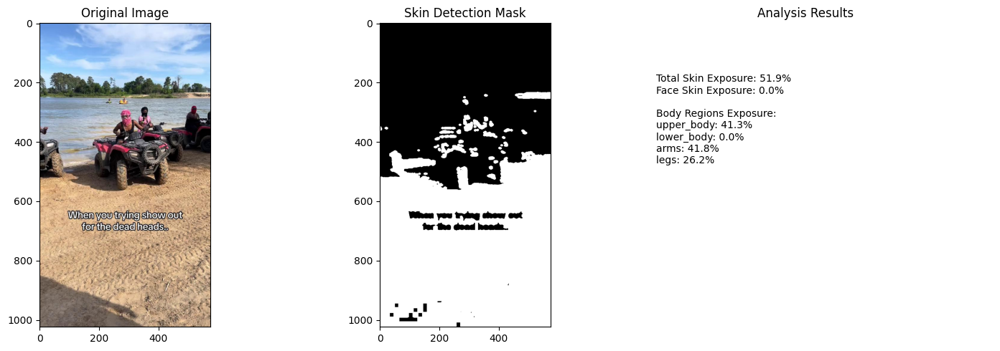

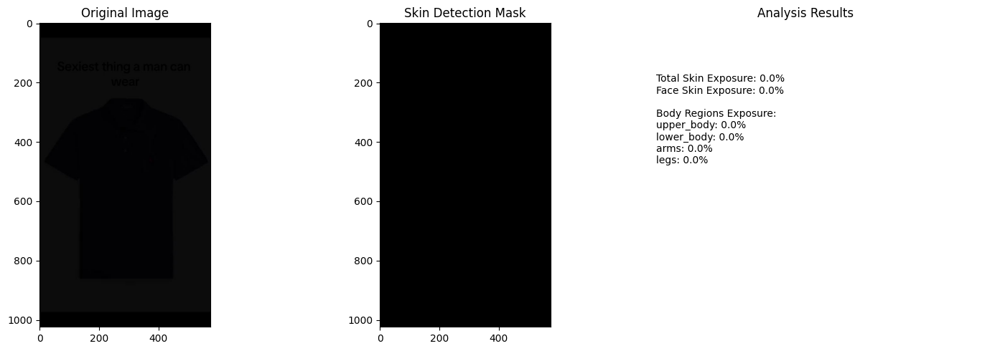

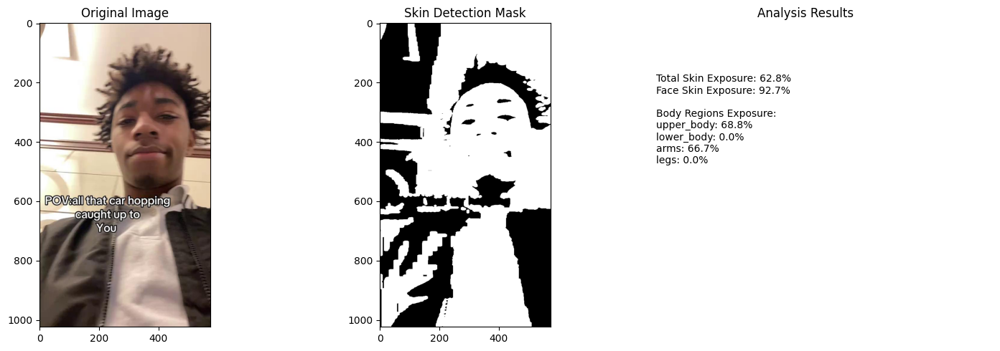

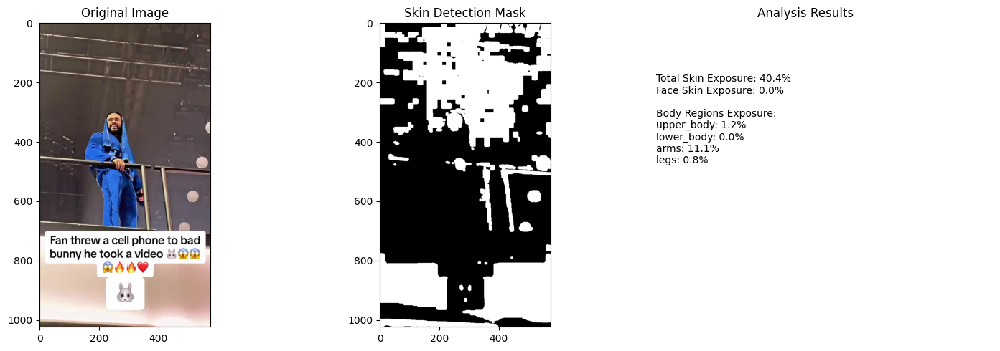

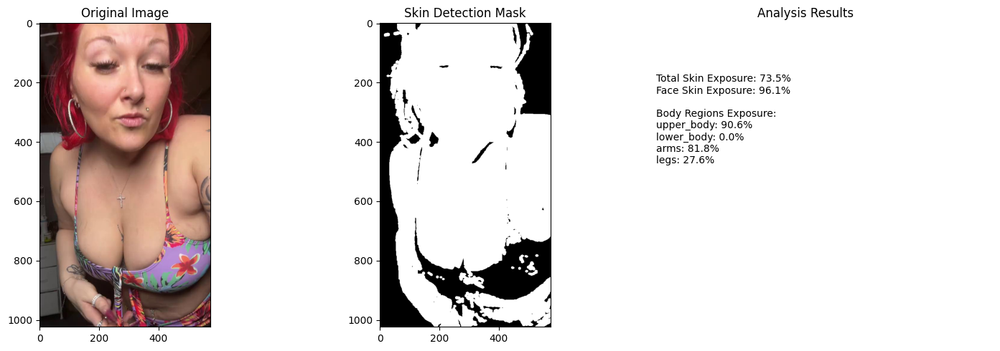

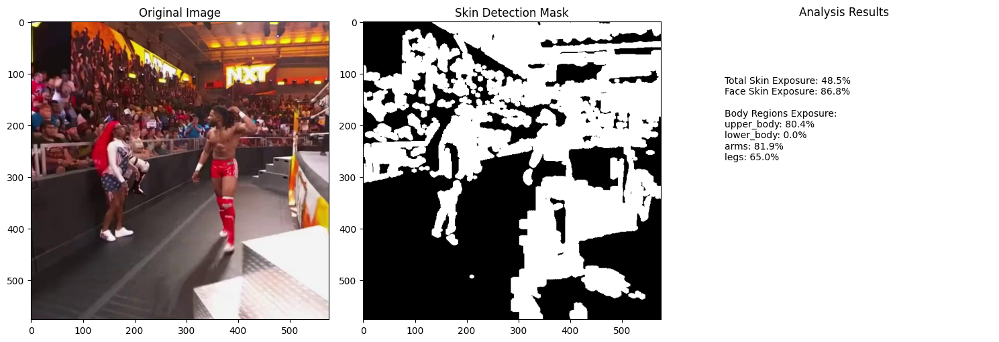

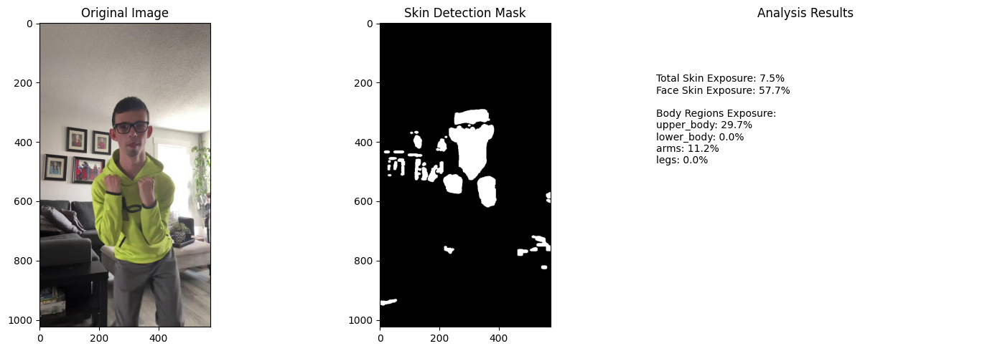

In [71]:
import cv2
import numpy as np
import mediapipe as mp
import os
from typing import Dict, List, Tuple
import matplotlib.pyplot as plt

class SkinExposureAnalyzer:
    def __init__(self):
        # Initialize MediaPipe
        self.mp_pose = mp.solutions.pose
        self.mp_face = mp.solutions.face_detection
        self.mp_drawing = mp.solutions.drawing_utils
        
        # Initialize detectors
        self.pose_detector = self.mp_pose.Pose(
            static_image_mode=True,
            model_complexity=1,
            min_detection_confidence=0.5
        )
        self.face_detector = self.mp_face.FaceDetection(
            min_detection_confidence=0.5
        )
        
        # Define multiple skin detection thresholds for better accuracy
        self.skin_thresh_YCrCb = {
            'lower': np.array([0, 135, 85], np.uint8),
            'upper': np.array([255, 180, 135], np.uint8)
        }
        self.skin_thresh_HSV = {
            'lower1': np.array([0, 20, 70], np.uint8),
            'upper1': np.array([20, 255, 255], np.uint8),
            'lower2': np.array([170, 20, 70], np.uint8),
            'upper2': np.array([180, 255, 255], np.uint8)
        }

    def detect_skin(self, image: np.ndarray) -> np.ndarray:
        """
        Enhanced skin detection using multiple color spaces
        """
        # Convert image to different color spaces
        image_YCrCb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
        image_HSV = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Create masks for each color space
        mask_YCrCb = cv2.inRange(
            image_YCrCb,
            self.skin_thresh_YCrCb['lower'],
            self.skin_thresh_YCrCb['upper']
        )
        
        mask_HSV1 = cv2.inRange(
            image_HSV,
            self.skin_thresh_HSV['lower1'],
            self.skin_thresh_HSV['upper1']
        )
        mask_HSV2 = cv2.inRange(
            image_HSV,
            self.skin_thresh_HSV['lower2'],
            self.skin_thresh_HSV['upper2']
        )
        
        # Combine masks
        mask_HSV = cv2.bitwise_or(mask_HSV1, mask_HSV2)
        final_mask = cv2.bitwise_and(mask_YCrCb, mask_HSV)
        
        # Apply morphological operations to clean up the mask
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        final_mask = cv2.erode(final_mask, kernel, iterations=1)
        final_mask = cv2.dilate(final_mask, kernel, iterations=2)
        
        return final_mask

    def calculate_exposure(self, mask: np.ndarray, region_mask: np.ndarray = None) -> float:
        """
        Calculate skin exposure percentage for a given region
        """
        if region_mask is not None:
            # Calculate exposure for specific region
            region_pixels = np.count_nonzero(region_mask)
            if region_pixels == 0:
                return 0.0
            skin_pixels = np.count_nonzero(cv2.bitwise_and(mask, region_mask))
            return (skin_pixels / region_pixels) * 100
        else:
            # Calculate total exposure
            total_pixels = mask.shape[0] * mask.shape[1]
            skin_pixels = np.count_nonzero(mask)
            return (skin_pixels / total_pixels) * 100

    def create_body_regions_mask(self, image: np.ndarray, landmarks) -> Dict[str, np.ndarray]:
        """
        Create masks for different body regions
        """
        h, w = image.shape[:2]
        regions = {
            'upper_body': np.zeros((h, w), dtype=np.uint8),
            'lower_body': np.zeros((h, w), dtype=np.uint8),
            'arms': np.zeros((h, w), dtype=np.uint8),
            'legs': np.zeros((h, w), dtype=np.uint8)
        }
        
        if landmarks:
            landmark_points = []
            for landmark in landmarks.landmark:
                x = int(landmark.x * w)
                y = int(landmark.y * h)
                landmark_points.append((x, y))
            
            # Define regions based on landmark indices
            # Upper body (shoulders to hips)
            upper_body_points = np.array([landmark_points[11], landmark_points[12],
                                        landmark_points[23], landmark_points[24]], np.int32)
            cv2.fillConvexPoly(regions['upper_body'], upper_body_points, 255)
            
            # Arms
            left_arm_points = np.array([landmark_points[11], landmark_points[13],
                                      landmark_points[15]], np.int32)
            right_arm_points = np.array([landmark_points[12], landmark_points[14],
                                       landmark_points[16]], np.int32)
            cv2.polylines(regions['arms'], [left_arm_points, right_arm_points], False, 255, 30)
            
            # Legs
            left_leg_points = np.array([landmark_points[23], landmark_points[25],
                                      landmark_points[27]], np.int32)
            right_leg_points = np.array([landmark_points[24], landmark_points[26],
                                       landmark_points[28]], np.int32)
            cv2.polylines(regions['legs'], [left_leg_points, right_leg_points], False, 255, 30)
            
        return regions

    def analyze_image(self, image: np.ndarray) -> Dict:
        """
        Analyze skin exposure in an image
        """
        # Convert image to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Get detections
        pose_results = self.pose_detector.process(image_rgb)
        face_results = self.face_detector.process(image_rgb)
        
        # Detect skin
        skin_mask = self.detect_skin(image)
        
        # Initialize results dictionary
        results = {
            'total_exposure': 0.0,
            'face_exposure': 0.0,
            'body_regions_exposure': {
                'upper_body': 0.0,
                'lower_body': 0.0,
                'arms': 0.0,
                'legs': 0.0
            },
            'detection_confidence': {
                'pose': 0.0,
                'face': 0.0
            }
        }
        
        # Calculate total exposure
        results['total_exposure'] = self.calculate_exposure(skin_mask)
        
        # Process face detection
        if face_results.detections:
            h, w = image.shape[:2]
            face_mask = np.zeros((h, w), dtype=np.uint8)
            for detection in face_results.detections:
                bbox = detection.location_data.relative_bounding_box
                x = int(bbox.xmin * w)
                y = int(bbox.ymin * h)
                width = int(bbox.width * w)
                height = int(bbox.height * h)
                cv2.rectangle(face_mask, (x, y), (x+width, y+height), 255, -1)
                results['face_exposure'] = self.calculate_exposure(skin_mask, face_mask)
                results['detection_confidence']['face'] = detection.score[0]
        
        # Process pose detection and body regions
        if pose_results.pose_landmarks:
            body_regions = self.create_body_regions_mask(image, pose_results.pose_landmarks)
            for region_name, region_mask in body_regions.items():
                results['body_regions_exposure'][region_name] = self.calculate_exposure(skin_mask, region_mask)
        
        return results

    def process_directory(self, directory_path: str) -> List[Dict]:
        """
        Process all images in a directory
        """
        results = []
        valid_extensions = ('.jpg', '.jpeg', '.png')
        
        for filename in os.listdir(directory_path):
            if filename.lower().endswith(valid_extensions):
                image_path = os.path.join(directory_path, filename)
                image = cv2.imread(image_path)
                
                if image is None:
                    print(f"Failed to load image: {filename}")
                    continue
                
                # Analyze image
                analysis_results = self.analyze_image(image)
                
                # Store results
                result = {
                    'filename': filename,
                    'analysis': analysis_results
                }
                results.append(result)
                
                # Display results
                self.visualize_results(image, analysis_results)
                
        return results

    def visualize_results(self, image: np.ndarray, results: Dict):
        """
        Visualize analysis results
        """
        plt.figure(figsize=(15, 5))
        
        # Original image
        plt.subplot(131)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        
        # Skin detection mask
        plt.subplot(132)
        skin_mask = self.detect_skin(image)
        plt.imshow(skin_mask, cmap='gray')
        plt.title('Skin Detection Mask')
        
        # Results text
        plt.subplot(133)
        plt.axis('off')
        info_text = f"Total Skin Exposure: {results['total_exposure']:.1f}%\n"
        info_text += f"Face Skin Exposure: {results['face_exposure']:.1f}%\n\n"
        info_text += "Body Regions Exposure:\n"
        for region, exposure in results['body_regions_exposure'].items():
            info_text += f"{region}: {exposure:.1f}%\n"
        plt.text(0.1, 0.5, info_text, fontsize=10)
        plt.title('Analysis Results')
        
        plt.tight_layout()
        plt.show()

# Usage example
if __name__ == "__main__":
    analyzer = SkinExposureAnalyzer()
    directory_path = folder_path  # Replace with your directory path
    results = analyzer.process_directory(directory_path)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT`

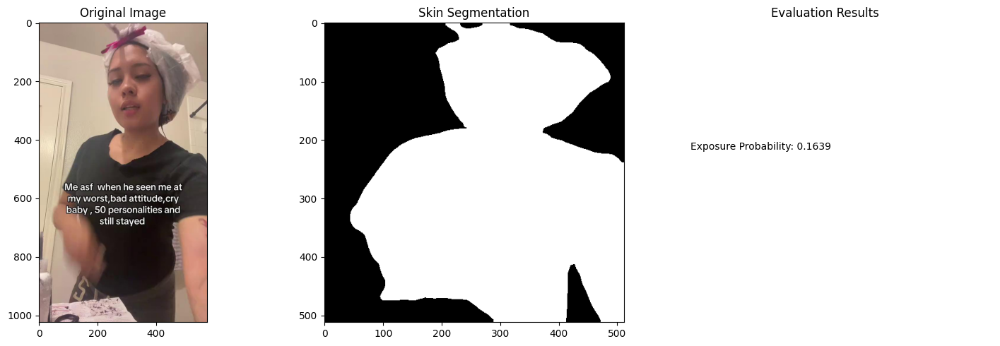

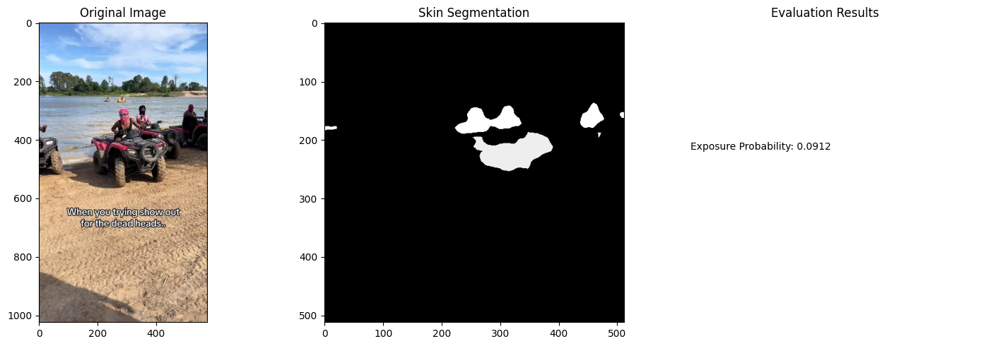

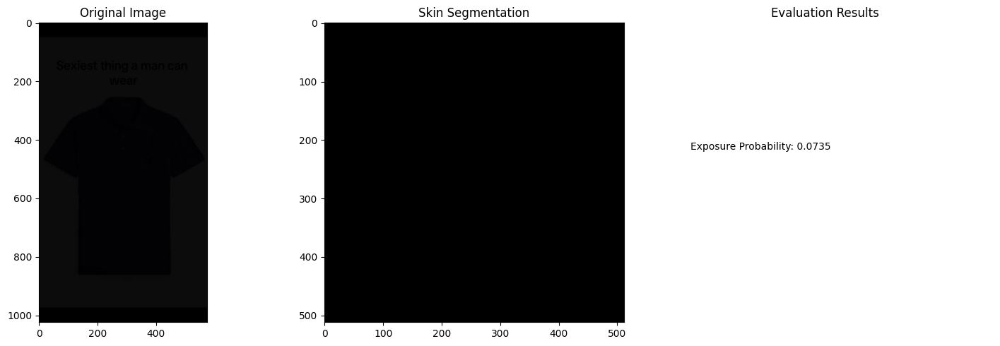

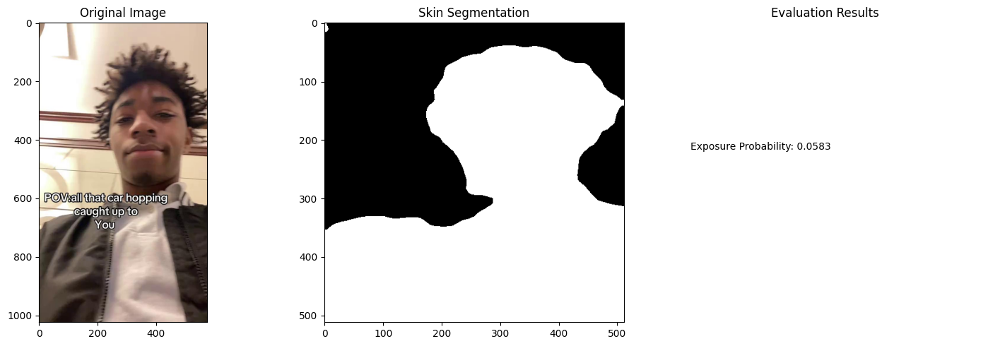

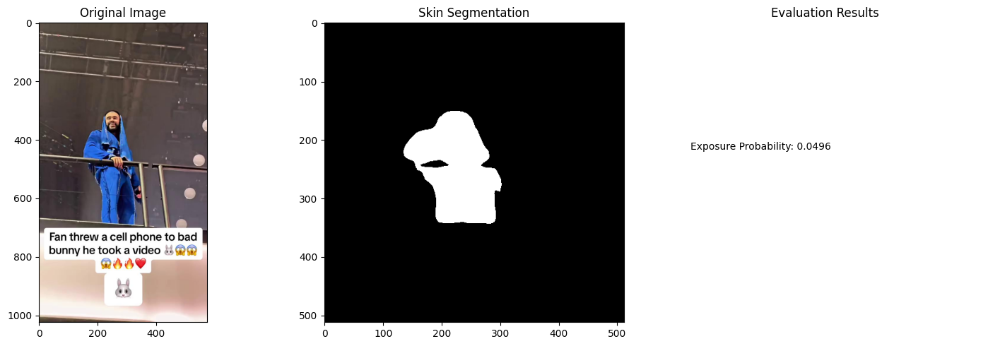

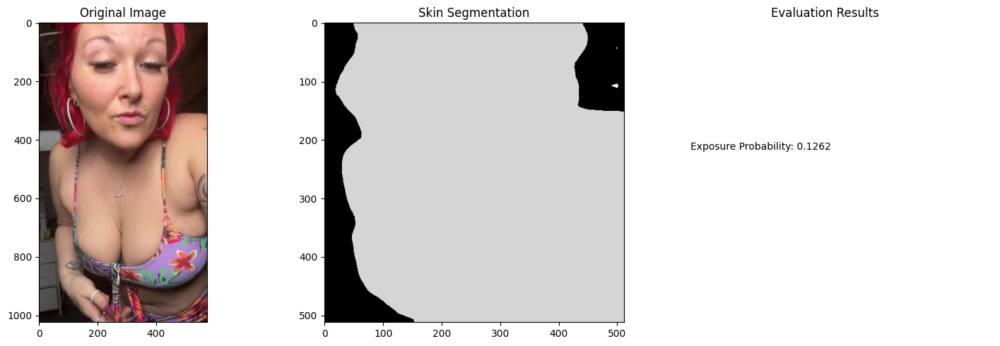

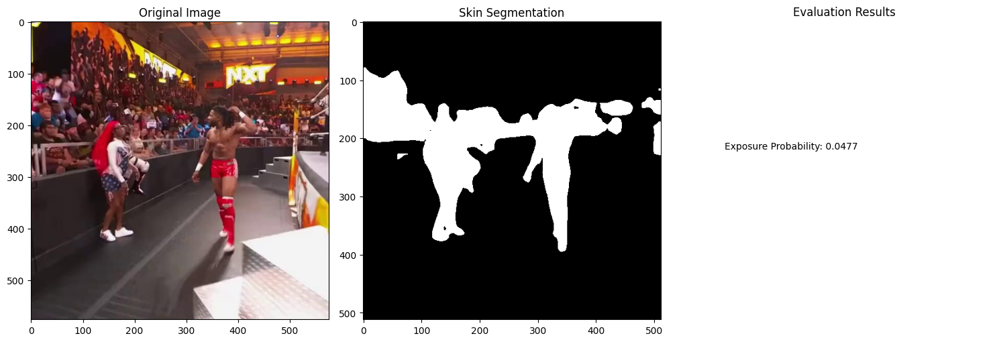

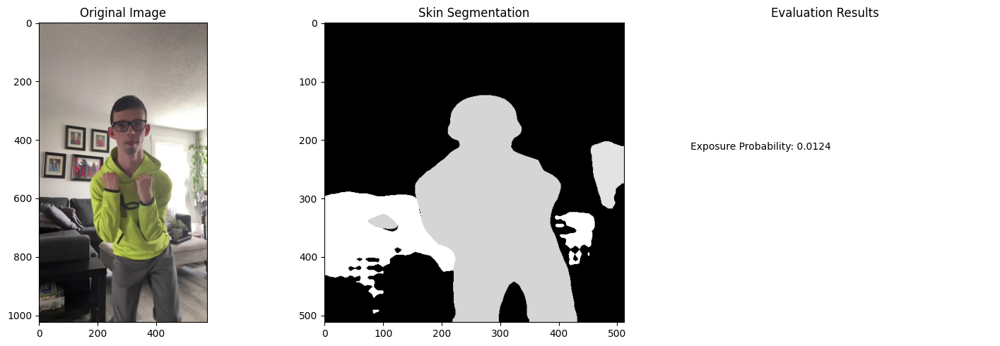

In [7]:
import torch
import torchvision
from torchvision.models.segmentation import deeplabv3_resnet101
from torchvision import transforms
import numpy as np
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
import PIL.Image as Image

class SkinExposureEvaluator:
    def __init__(self):
        # Load pre-trained DeepLab v3+ model for semantic segmentation
        self.segmentation_model = deeplabv3_resnet101(pretrained=True)
        self.segmentation_model.eval()
        
        # Load pre-trained ResNet for classification
        self.classification_model = torchvision.models.resnet50(pretrained=True)
        self.classification_model.eval()
        
        # Move models to GPU if available
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.segmentation_model.to(self.device)
        self.classification_model.to(self.device)
        
        # Define transformations
        self.transform = transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                              std=[0.229, 0.224, 0.225])
        ])
        
        # Initialize metrics
        self.metrics = {
            'accuracy': [],
            'precision': [],
            'recall': [],
            'f1_score': []
        }

    def preprocess_image(self, image_path):
        """
        Preprocess image for model input
        """
        image = Image.open(image_path).convert('RGB')
        image_tensor = self.transform(image)
        return image_tensor.unsqueeze(0).to(self.device)

    def get_ground_truth_mask(self, image_path):
        """
        Load ground truth mask if available
        Note: You need to provide ground truth masks for your dataset
        """
        # Replace this with your ground truth mask loading logic
        mask_path = image_path.replace('images', 'masks')
        if os.path.exists(mask_path):
            return np.array(Image.open(mask_path))
        return None

    def evaluate_skin_detection(self, predicted_mask, ground_truth_mask):
        """
        Calculate accuracy metrics for skin detection
        """
        predicted_flat = predicted_mask.flatten()
        ground_truth_flat = ground_truth_mask.flatten()
        
        accuracy = accuracy_score(ground_truth_flat, predicted_flat)
        precision, recall, f1, _ = precision_recall_fscore_support(
            ground_truth_flat, 
            predicted_flat, 
            average='binary'
        )
        
        return {
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1_score': f1
        }

    def segment_skin(self, input_tensor):
        """
        Perform semantic segmentation for skin detection
        """
        with torch.no_grad():
            output = self.segmentation_model(input_tensor)['out']
            mask = torch.argmax(output, dim=1)
            return mask.cpu().numpy()

    def classify_exposure_level(self, input_tensor):
        """
        Classify exposure level using ResNet
        """
        with torch.no_grad():
            output = self.classification_model(input_tensor)
            return torch.softmax(output, dim=1).cpu().numpy()

    def evaluate_directory(self, directory_path, ground_truth_available=False):
        """
        Evaluate skin exposure analysis on a directory of images
        """
        results = []
        
        for filename in os.listdir(directory_path):
            if filename.endswith(('.jpg', '.jpeg', '.png')):
                image_path = os.path.join(directory_path, filename)
                
                # Preprocess image
                input_tensor = self.preprocess_image(image_path)
                
                # Get skin segmentation
                skin_mask = self.segment_skin(input_tensor)
                
                # Get exposure classification
                exposure_prob = self.classify_exposure_level(input_tensor)
                
                # Calculate metrics if ground truth is available
                metrics = None
                if ground_truth_available:
                    ground_truth = self.get_ground_truth_mask(image_path)
                    if ground_truth is not None:
                        metrics = self.evaluate_skin_detection(skin_mask[0], ground_truth)
                        
                        # Update overall metrics
                        for key, value in metrics.items():
                            self.metrics[key].append(value)
                
                results.append({
                    'filename': filename,
                    'skin_mask': skin_mask[0],
                    'exposure_probability': exposure_prob[0],
                    'metrics': metrics
                })
                
                # Visualize results
                self.visualize_evaluation(
                    image_path, 
                    skin_mask[0], 
                    exposure_prob[0], 
                    metrics
                )
        
        # Calculate average metrics
        if ground_truth_available:
            average_metrics = {
                key: np.mean(values) for key, values in self.metrics.items()
            }
            print("\nAverage Metrics:")
            for key, value in average_metrics.items():
                print(f"{key}: {value:.4f}")
        
        return results

    def visualize_evaluation(self, image_path, skin_mask, exposure_prob, metrics=None):
        """
        Visualize evaluation results
        """
        plt.figure(figsize=(15, 5))
        
        # Original image
        plt.subplot(131)
        image = Image.open(image_path)
        plt.imshow(image)
        plt.title('Original Image')
        
        # Segmentation mask
        plt.subplot(132)
        plt.imshow(skin_mask, cmap='gray')
        plt.title('Skin Segmentation')
        
        # Metrics
        plt.subplot(133)
        plt.axis('off')
        
        info_text = f"Exposure Probability: {exposure_prob.max():.4f}\n\n"
        
        if metrics:
            info_text += "Metrics:\n"
            for key, value in metrics.items():
                info_text += f"{key}: {value:.4f}\n"
        
        plt.text(0.1, 0.5, info_text, fontsize=10)
        plt.title('Evaluation Results')
        
        plt.tight_layout()
        plt.show()

class SkinExposureDataset(torch.utils.data.Dataset):
    """
    Custom dataset for training/validation
    """
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = self.images[idx]
        image_path = os.path.join(self.image_dir, img_name)
        mask_path = os.path.join(self.mask_dir, img_name.replace('.jpg', '_mask.png'))
        
        image = Image.open(image_path).convert('RGB')
        mask = Image.open(mask_path).convert('L')
        
        if self.transform:
            image = self.transform(image)
            mask = transforms.ToTensor()(mask)
        
        return image, mask

def train_evaluator(train_dir, mask_dir, num_epochs=10):
    """
    Train the evaluator on custom dataset
    """
    # Create dataset and dataloader
    dataset = SkinExposureDataset(
        train_dir,
        mask_dir,
        transform=transforms.Compose([
            transforms.Resize((512, 512)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                              std=[0.229, 0.224, 0.225])
        ])
    )
    
    dataloader = torch.utils.data.DataLoader(
        dataset,
        batch_size=4,
        shuffle=True,
        num_workers=4
    )
    
    # Initialize model and optimizer
    model = deeplabv3_resnet101(pretrained=True)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
    criterion = torch.nn.CrossEntropyLoss()
    
    # Training loop
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)
    
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0
        
        for images, masks in dataloader:
            images = images.to(device)
            masks = masks.to(device)
            
            optimizer.zero_grad()
            outputs = model(images)['out']
            loss = criterion(outputs, masks.squeeze(1).long())
            
            loss.backward()
            optimizer.step()
            
            total_loss += loss.item()
        
        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(dataloader):.4f}")
    
    return model

# Usage example
if __name__ == "__main__":
    # Initialize evaluator
    evaluator = SkinExposureEvaluator()
    
    # If you have a labeled dataset, you can train the model
    # train_dir = "path/to/training/images"
    # mask_dir = "path/to/ground/truth/masks"
    # trained_model = train_evaluator(train_dir, mask_dir)
    # evaluator.segmentation_model = trained_model
    
    # Evaluate directory
    test_directory = folder_path
    results = evaluator.evaluate_directory(
        test_directory,
        ground_truth_available=False  # Set to True if you have ground truth masks
    )

Using device: cuda
Skin evaluator initialized - models will load on first use
Processing 8 images from /kaggle/working/pytorch-openpose/video_frames_output


  0%|          | 0/2 [00:00<?, ?it/s]

Loading models...
Models loaded successfully


100%|██████████| 2/2 [00:01<00:00,  1.06it/s]


Models unloaded to free memory

Processed 8 frames
Average skin exposure: 93.99%

Sample visualization:


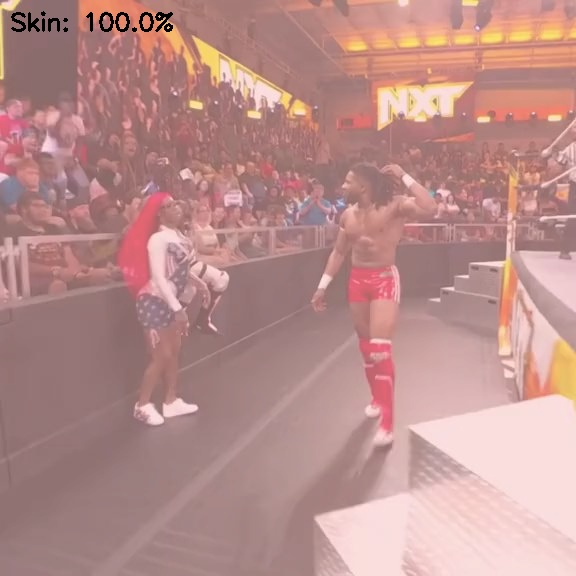

In [11]:
import os
import torch
import torchvision
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from torchvision import transforms
from torchvision.models.segmentation import deeplabv3_resnet50  # Using smaller ResNet50
import gc

class OptimizedSkinEvaluator:
    """Memory-efficient skin exposure evaluation system"""
    
    def __init__(self, use_gpu=True, model_size="small"):
        # Configure device
        self.use_gpu = use_gpu and torch.cuda.is_available()
        self.device = torch.device('cuda' if self.use_gpu else 'cpu')
        print(f"Using device: {self.device}")
        
        # Define image transformations with configurable size
        self.img_size = 384 if model_size == "small" else 512  # Smaller default size
        self.transform = transforms.Compose([
            transforms.Resize((self.img_size, self.img_size)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        
        # Initialize results storage
        self.results = {}
        self.batch_size = 4  # Process images in small batches
        
        print("Skin evaluator initialized - models will load on first use")
    
    def load_models(self):
        """Lazy-load models only when needed"""
        print("Loading models...")
        
        # Use smaller segmentation model for efficiency
        self.segmentation_model = deeplabv3_resnet50(pretrained=True)
        self.segmentation_model.eval()
        self.segmentation_model.to(self.device)
        
        # Only load classification model if needed
        if hasattr(self, 'need_classifier') and self.need_classifier:
            self.classification_model = torchvision.models.resnet18(pretrained=True)  # Smaller model
            self.classification_model.eval()
            self.classification_model.to(self.device)
        
        print("Models loaded successfully")
    
    def unload_models(self):
        """Explicitly unload models to free memory"""
        if hasattr(self, 'segmentation_model'):
            del self.segmentation_model
        if hasattr(self, 'classification_model'):
            del self.classification_model
        
        # Force garbage collection
        torch.cuda.empty_cache() if self.use_gpu else None
        gc.collect()
        print("Models unloaded to free memory")
    
    def preprocess_image(self, image_path):
        """Preprocess single image for model input"""
        try:
            image = Image.open(image_path).convert('RGB')
            image_tensor = self.transform(image)
            return image_tensor.unsqueeze(0)
        except Exception as e:
            print(f"Error preprocessing image {image_path}: {e}")
            return None
    
    def preprocess_batch(self, image_paths):
        """Preprocess a batch of images efficiently"""
        tensors = []
        valid_paths = []
        
        for path in image_paths:
            tensor = self.preprocess_image(path)
            if tensor is not None:
                tensors.append(tensor)
                valid_paths.append(path)
        
        if not tensors:
            return None, []
        
        # Combine into batch
        batch = torch.cat(tensors, 0).to(self.device)
        return batch, valid_paths
    
    def segment_skin(self, input_tensor):
        """Perform semantic segmentation for skin detection"""
        if not hasattr(self, 'segmentation_model'):
            self.load_models()
            
        with torch.no_grad():  # Prevent memory leaks
            output = self.segmentation_model(input_tensor)['out']
            
            # Focus on person class (15) from COCO
            person_masks = output[:, 15]
            person_masks = (person_masks > 0).float()
            
            # Get segmentation masks
            return person_masks.cpu().numpy()
    
    def classify_exposure(self, input_tensor):
        """Classify exposure level using smaller model"""
        self.need_classifier = True
        if not hasattr(self, 'classification_model'):
            self.load_models()
            
        with torch.no_grad():
            output = self.classification_model(input_tensor)
            return torch.softmax(output, dim=1).cpu().numpy()
    
    def process_batch(self, image_paths):
        """Process a batch of images efficiently"""
        # Preprocess batch
        input_batch, valid_paths = self.preprocess_batch(image_paths)
        if input_batch is None or len(valid_paths) == 0:
            return {}
        
        # Get skin segmentation for batch
        skin_masks = self.segment_skin(input_batch)
        
        # Optional: Get exposure classification
        exposure_probs = None
        if hasattr(self, 'need_exposure') and self.need_exposure:
            exposure_probs = self.classify_exposure(input_batch)
        
        # Process results
        batch_results = {}
        for i, path in enumerate(valid_paths):
            filename = os.path.basename(path)
            
            # Calculate skin percentage from mask
            skin_mask = skin_masks[i]
            skin_percent = np.mean(skin_mask) * 100
            
            result = {
                'filename': filename,
                'path': path,
                'skin_percent': skin_percent,
                'skin_mask': skin_mask
            }
            
            # Add exposure probability if calculated
            if exposure_probs is not None:
                result['exposure_prob'] = exposure_probs[i]
                
            batch_results[filename] = result
            
        return batch_results
    
    def evaluate_directory(self, directory_path, max_images=None, visualize=False,
                         output_dir=None):
        """
        Efficiently evaluate skin exposure in an entire directory
        
        Args:
            directory_path: Directory containing images to process
            max_images: Maximum number of images to process (None for all)
            visualize: Whether to create visualizations
            output_dir: Directory to save outputs (None for no saving)
        """
        # Create output directory if needed
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            viz_dir = os.path.join(output_dir, "visualizations")
            os.makedirs(viz_dir, exist_ok=True)
        
        # Get list of images
        image_files = [f for f in os.listdir(directory_path) 
                     if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        
        # Limit number of images if specified
        if max_images and len(image_files) > max_images:
            image_files = image_files[:max_images]
        
        print(f"Processing {len(image_files)} images from {directory_path}")
        
        # Process in batches
        all_results = {}
        for i in tqdm(range(0, len(image_files), self.batch_size)):
            batch_files = image_files[i:i+self.batch_size]
            image_paths = [os.path.join(directory_path, f) for f in batch_files]
            
            try:
                # Process this batch
                batch_results = self.process_batch(image_paths)
                all_results.update(batch_results)
                
                # Create visualizations if requested
                if visualize and output_dir:
                    for filename, result in batch_results.items():
                        self.save_visualization(result, viz_dir)
                        
                # Periodic memory cleanup
                if i % 20 == 0:
                    gc.collect()
                    if self.use_gpu:
                        torch.cuda.empty_cache()
                        
            except Exception as e:
                print(f"Error processing batch: {e}")
        
        # Unload models to free memory
        self.unload_models()
        
        # Save summary results if output directory specified
        if output_dir:
            self.save_summary(all_results, output_dir)
            
        return all_results
    
    def save_visualization(self, result, output_dir):
        """Save visualization of skin detection"""
        try:
            # Load original image
            img_path = result['path']
            img = cv2.imread(img_path)
            if img is None:
                return
                
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            h, w = img.shape[:2]
            
            # Resize mask to match image
            skin_mask = result['skin_mask']
            skin_mask_resized = cv2.resize(skin_mask.astype(np.float32), 
                                          (w, h), 
                                          interpolation=cv2.INTER_NEAREST)
            
            # Create overlay
            overlay = img.copy()
            overlay[skin_mask_resized > 0.5] = [255, 200, 200]  # Light red for skin
            
            # Blend with original
            alpha = 0.5
            output = cv2.addWeighted(img, 1-alpha, overlay, alpha, 0)
            
            # Add text
            cv2.putText(
                output,
                f"Skin: {result['skin_percent']:.1f}%",
                (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.8,
                (0, 0, 0),
                2
            )
            
            # Save the visualization
            filename = result['filename']
            output_path = os.path.join(output_dir, f"skin_{filename}")
            
            # Convert back to BGR for OpenCV
            output = cv2.cvtColor(output, cv2.COLOR_RGB2BGR)
            cv2.imwrite(output_path, output)
            
        except Exception as e:
            print(f"Error creating visualization: {e}")
    
    def save_summary(self, results, output_dir):
        """Save summary of results"""
        try:
            # Extract key metrics
            filenames = []
            skin_percentages = []
            
            for filename, result in results.items():
                filenames.append(filename)
                skin_percentages.append(result['skin_percent'])
            
            # Create summary text
            with open(os.path.join(output_dir, "summary.txt"), 'w') as f:
                f.write(f"Skin Exposure Analysis Summary\n")
                f.write(f"Date: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}\n")
                f.write(f"Total Images: {len(results)}\n")
                f.write(f"Average Skin Percentage: {np.mean(skin_percentages):.2f}%\n")
                f.write(f"Max Skin Percentage: {np.max(skin_percentages):.2f}%\n")
                f.write(f"Min Skin Percentage: {np.min(skin_percentages):.2f}%\n")
            
            # Save data as CSV
            import pandas as pd
            df = pd.DataFrame({
                'filename': filenames,
                'skin_percentage': skin_percentages
            })
            df.to_csv(os.path.join(output_dir, "skin_analysis.csv"), index=False)
            
            # Create histogram plot
            plt.figure(figsize=(10, 6))
            plt.hist(skin_percentages, bins=20, color='coral', alpha=0.7)
            plt.title('Distribution of Skin Exposure')
            plt.xlabel('Skin Percentage')
            plt.ylabel('Number of Images')
            plt.grid(True, alpha=0.3)
            plt.savefig(os.path.join(output_dir, "skin_histogram.png"))
            plt.close()
            
        except Exception as e:
            print(f"Error saving summary: {e}")

def process_video_frames(frames_dir, output_dir=None, max_frames=50):
    """Process video frames for skin analysis with memory optimizations"""
    # Create evaluator
    evaluator = OptimizedSkinEvaluator(use_gpu=True, model_size="small")
    
    # Process directory
    results = evaluator.evaluate_directory(
        frames_dir,
        max_images=max_frames,
        visualize=True,
        output_dir=output_dir
    )
    
    print(f"\nProcessed {len(results)} frames")
    
    # Calculate average skin percentage
    if results:
        skin_percentages = [r['skin_percent'] for r in results.values()]
        avg_skin = np.mean(skin_percentages)
        print(f"Average skin exposure: {avg_skin:.2f}%")
        
        # Display a couple of sample results if available
        if output_dir:
            viz_dir = os.path.join(output_dir, "visualizations")
            sample_files = [f for f in os.listdir(viz_dir) if f.endswith('.jpg') or f.endswith('.png')]
            
            if sample_files and len(sample_files) > 0:
                print("\nSample visualization:")
                sample_path = os.path.join(viz_dir, sample_files[1])
                from IPython.display import Image as IPImage
                from IPython.display import display
                display(IPImage(filename=sample_path))
    
    return results

# Import datetime for summary report
from datetime import datetime

# Example usage
if __name__ == "__main__":
    frames_dir = folder_path  # Input frames
    output_dir = "/kaggle/working/skin_analysis_results"  # Output directory
    
    # Process with memory optimizations
    process_video_frames(frames_dir, output_dir, max_frames=30)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 124MB/s] 


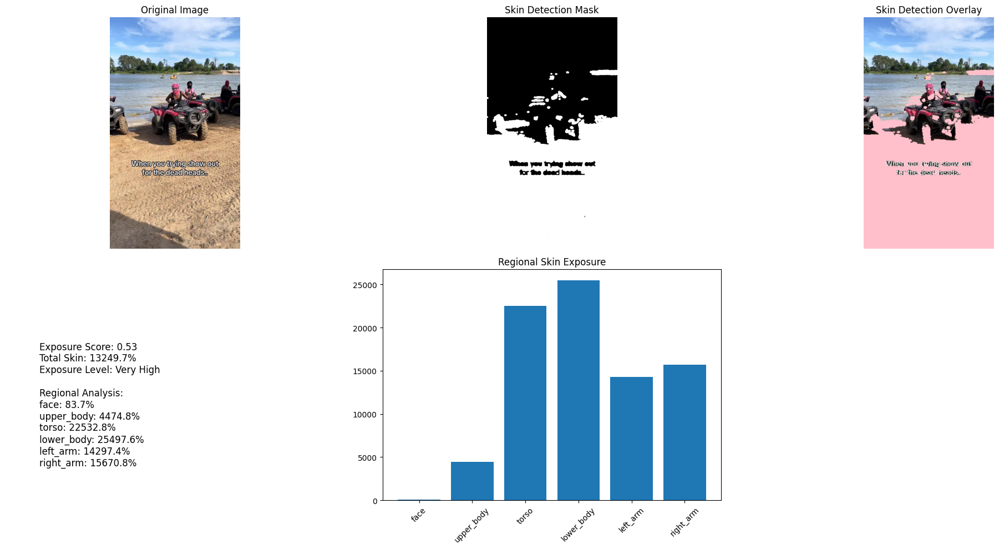

In [12]:
import torch
import torch.nn as nn
import torchvision
from torchvision.models import densenet121
import numpy as np
import cv2
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm

class DenseNetSkinAnalyzer:
    def __init__(self):
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model = self._init_model()
        self.transform = self._init_transform()
        
        # Skin detection parameters
        self.skin_lower_ycrcb = np.array([0, 133, 77], dtype=np.uint8)
        self.skin_upper_ycrcb = np.array([255, 173, 127], dtype=np.uint8)
        
        # HSV parameters for additional skin detection accuracy
        self.skin_lower_hsv = np.array([0, 20, 70], dtype=np.uint8)
        self.skin_upper_hsv = np.array([20, 255, 255], dtype=np.uint8)

    def _init_model(self):
        # Initialize DenseNet121 with pretrained weights
        model = densenet121(pretrained=True)
        
        # Modify the classifier for our task
        num_features = model.classifier.in_features
        model.classifier = nn.Sequential(
            nn.Linear(num_features, 512),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, 1)  # Binary classification for skin exposure
        )
        
        model = model.to(self.device)
        model.eval()
        return model

    def _init_transform(self):
        return torchvision.transforms.Compose([
            torchvision.transforms.ToPILImage(),
            torchvision.transforms.Resize((224, 224)),
            torchvision.transforms.ToTensor(),
            torchvision.transforms.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]
            )
        ])

    def detect_skin(self, image):
        """
        Enhanced skin detection using multiple color spaces
        """
        # Convert to YCrCb and HSV color spaces
        ycrcb = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        
        # Create masks for both color spaces
        mask_ycrcb = cv2.inRange(ycrcb, self.skin_lower_ycrcb, self.skin_upper_ycrcb)
        mask_hsv = cv2.inRange(hsv, self.skin_lower_hsv, self.skin_upper_hsv)
        
        # Combine masks
        mask = cv2.bitwise_and(mask_ycrcb, mask_hsv)
        
        # Clean up mask
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        mask = cv2.erode(mask, kernel, iterations=1)
        mask = cv2.dilate(mask, kernel, iterations=2)
        
        return mask

    def analyze_image(self, image_path):
        """
        Comprehensive image analysis
        """
        # Read and preprocess image
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Get DenseNet prediction
        input_tensor = self.transform(image).unsqueeze(0).to(self.device)
        with torch.no_grad():
            output = torch.sigmoid(self.model(input_tensor))
            exposure_score = output.item()
        
        # Detect skin regions
        skin_mask = self.detect_skin(image)
        
        # Calculate overall skin percentage
        total_skin_percentage = (np.sum(skin_mask) / skin_mask.size) * 100
        
        # Analyze different body regions
        regions = self.analyze_regions(image, skin_mask)
        
        # Calculate additional metrics
        exposure_level = self.get_exposure_level(total_skin_percentage)
        
        return {
            'exposure_score': exposure_score,
            'skin_percentage': total_skin_percentage,
            'regions': regions,
            'mask': skin_mask,
            'exposure_level': exposure_level
        }

    def analyze_regions(self, image, mask):
        """
        Analyze skin exposure in different body regions
        """
        h, w = image.shape[:2]
        
        # Define regions of interest
        regions = {
            'face': [0, h//4, w//4, 3*w//4],
            'upper_body': [h//4, h//2, 0, w],
            'torso': [h//2, 3*h//4, 0, w],
            'lower_body': [3*h//4, h, 0, w],
            'left_arm': [h//4, 3*h//4, 0, w//4],
            'right_arm': [h//4, 3*h//4, 3*w//4, w]
        }
        
        results = {}
        for name, (y1, y2, x1, x2) in regions.items():
            region_mask = mask[y1:y2, x1:x2]
            percentage = (np.sum(region_mask) / region_mask.size) * 100
            results[name] = {
                'percentage': percentage,
                'area': region_mask.size
            }
            
        return results

    def get_exposure_level(self, skin_percentage):
        """
        Determine exposure level based on skin percentage
        """
        if skin_percentage < 15:
            return 'Low'
        elif skin_percentage < 30:
            return 'Moderate'
        elif skin_percentage < 45:
            return 'High'
        else:
            return 'Very High'

    def visualize_results(self, image_path, results):
        """
        Enhanced visualization of analysis results
        """
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(20, 10))
        
        # Original image
        plt.subplot(231)
        plt.imshow(image)
        plt.title('Original Image')
        plt.axis('off')
        
        # Skin detection mask
        plt.subplot(232)
        plt.imshow(results['mask'], cmap='gray')
        plt.title('Skin Detection Mask')
        plt.axis('off')
        
        # Overlay
        plt.subplot(233)
        overlay = image.copy()
        overlay[results['mask'] > 0] = [255, 192, 203]  # Pink overlay for skin
        plt.imshow(overlay)
        plt.title('Skin Detection Overlay')
        plt.axis('off')
        
        # Metrics text
        plt.subplot(234)
        plt.axis('off')
        info_text = f"Exposure Score: {results['exposure_score']:.2f}\n"
        info_text += f"Total Skin: {results['skin_percentage']:.1f}%\n"
        info_text += f"Exposure Level: {results['exposure_level']}\n\n"
        info_text += "Regional Analysis:\n"
        for region, data in results['regions'].items():
            info_text += f"{region}: {data['percentage']:.1f}%\n"
        plt.text(0.1, 0.1, info_text, fontsize=12)
        
        # Region-wise bar plot
        plt.subplot(235)
        regions = list(results['regions'].keys())
        percentages = [data['percentage'] for data in results['regions'].values()]
        plt.bar(regions, percentages)
        plt.xticks(rotation=45)
        plt.title('Regional Skin Exposure')
        
        plt.tight_layout()
        plt.show()

class SkinDataset(Dataset):
    def __init__(self, image_paths, labels=None, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = cv2.imread(self.image_paths[idx])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        if self.transform:
            image = self.transform(image)
        
        if self.labels is not None:
            return image, self.labels[idx]
        return image

def train_model(train_dataset, val_dataset, epochs=10):
    """
    Train the DenseNet model
    """
    model = DenseNetSkinAnalyzer()
    optimizer = torch.optim.AdamW(model.model.parameters(), lr=1e-4, weight_decay=1e-5)
    criterion = nn.BCEWithLogitsLoss()
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=2)
    
    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=32)
    
    best_val_loss = float('inf')
    
    for epoch in range(epochs):
        # Training phase
        model.model.train()
        train_loss = 0
        train_correct = 0
        train_total = 0
        
        for images, labels in tqdm(train_loader, desc=f'Epoch {epoch+1}/{epochs}'):
            images = images.to(model.device)
            labels = labels.to(model.device)
            
            optimizer.zero_grad()
            outputs = model.model(images)
            loss = criterion(outputs, labels)
            
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            predicted = (torch.sigmoid(outputs) > 0.5).float()
            train_correct += (predicted == labels).sum().item()
            train_total += labels.size(0)
        
        # Validation phase
        model.model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0
        
        with torch.no_grad():
            for images, labels in val_loader:
                images = images.to(model.device)
                labels = labels.to(model.device)
                
                outputs = model.model(images)
                loss = criterion(outputs, labels)
                
                val_loss += loss.item()
                predicted = (torch.sigmoid(outputs) > 0.5).float()
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)
        
        # Calculate metrics
        train_loss = train_loss / len(train_loader)
        train_acc = 100 * train_correct / train_total
        val_loss = val_loss / len(val_loader)
        val_acc = 100 * val_correct / val_total
        
        # Update learning rate
        scheduler.step(val_loss)
        
        # Print metrics
        print(f'Epoch {epoch+1}/{epochs}:')
        print(f'Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%')
        print(f'Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%')
        
        # Save best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.model.state_dict(), 'best_densenet_skin_model.pth')
            print('Model saved!')
        
        print('-' * 50)

# Usage example
if __name__ == "__main__":
    # Initialize analyzer
    analyzer = DenseNetSkinAnalyzer()
    
    # Analyze single image
    image_path = "/kaggle/working/pytorch-openpose/video_frames_output/extracted_frame_2.jpg"  # Replace with your image path
    results = analyzer.analyze_image(image_path)
    analyzer.visualize_results(image_path, results)
    
    # For training (if you have labeled data):
    """
    train_images = ["path/to/train/images"]
    train_labels = [...]  # Your labels
    val_images = ["path/to/val/images"]
    val_labels = [...]  # Your labels
    
    train_dataset = SkinDataset(train_images, train_labels, analyzer.transform)
    val_dataset = SkinDataset(val_images, val_labels, analyzer.transform)
    
    train_model(train_dataset, val_dataset, epochs=10)
    """

In [ ]:
# class DenseNetSkinAnalyzer:
#     # ... (previous initialization methods remain the same) ...

#     def analyze_image(self, image_path):
#         """
#         Analyze a single image
#         """
#         try:
#             # Read and preprocess image
#             image = cv2.imread(image_path)
#             if image is None:
#                 raise ValueError(f"Could not read image: {image_path}")
                
#             image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
#             # Get DenseNet prediction
#             input_tensor = self.transform(image).unsqueeze(0).to(self.device)
#             with torch.no_grad():
#                 output = torch.sigmoid(self.model(input_tensor))
#                 exposure_score = output.item()
            
#             # Detect skin regions
#             skin_mask = self.detect_skin(image)
            
#             # Calculate overall skin percentage
#             total_skin_percentage = (np.sum(skin_mask) / skin_mask.size) * 100
            
#             # Analyze different body regions
#             regions = self.analyze_regions(image, skin_mask)
            
#             # Calculate exposure level
#             exposure_level = self.get_exposure_level(total_skin_percentage)
            
#             return {
#                 'exposure_score': exposure_score,
#                 'skin_percentage': total_skin_percentage,
#                 'regions': regions,
#                 'mask': skin_mask,
#                 'exposure_level': exposure_level
#             }
#         except Exception as e:
#             print(f"Error analyzing image {image_path}: {str(e)}")
#             return None

#     def analyze_directory(self, directory_path, output_dir=None):
#         """
#         Analyze all images in a directory
#         """
#         if output_dir:
#             os.makedirs(output_dir, exist_ok=True)
#             viz_dir = os.path.join(output_dir, 'visualizations')
#             os.makedirs(viz_dir, exist_ok=True)

#         valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp')
#         all_results = {}
#         summary_data = []

#         # Process each image in directory
#         for filename in tqdm(os.listdir(directory_path)):
#             if filename.lower().endswith(valid_extensions):
#                 image_path = os.path.join(directory_path, filename)
                
#                 try:
#                     results = self.analyze_image(image_path)
#                     if results is not None:  # Only process successful analyses
#                         all_results[filename] = results
                        
#                         summary_data.append({
#                             'filename': filename,
#                             'exposure_score': results['exposure_score'],
#                             'skin_percentage': results['skin_percentage'],
#                             'exposure_level': results['exposure_level'],
#                             **{f"{region}_percentage": data['percentage'] 
#                                for region, data in results['regions'].items()}
#                         })

#                         if output_dir:
#                             plt.figure(figsize=(20, 10))
#                             self.visualize_results(image_path, results)
#                             plt.savefig(os.path.join(viz_dir, f'analysis_{filename}.png'))
#                             plt.close()

#                 except Exception as e:
#                     print(f"Error processing {filename}: {str(e)}")
#                     continue

#         # Create and save summary report if we have results
#         if output_dir and summary_data:
#             df = pd.DataFrame(summary_data)
            
#             # Save to CSV
#             df.to_csv(os.path.join(output_dir, 'analysis_summary.csv'), index=False)
            
#             try:
#                 # Generate summary statistics
#                 summary_stats = df.describe()
#                 summary_stats.to_csv(os.path.join(output_dir, 'analysis_statistics.csv'))
                
#                 # Create summary visualizations
#                 self._create_summary_visualizations(df, output_dir)
#             except Exception as e:
#                 print(f"Error creating summary statistics: {str(e)}")

#         return all_results

#     # ... (rest of the methods remain the same) ...

# # Usage example
# if __name__ == "__main__":
#     # Initialize analyzer
#     analyzer = DenseNetSkinAnalyzer()
    
#     # Analyze directory of images
#     input_directory = '/kaggle/input/extract-file'
#     output_directory = "/kaggle/working/results"
    
#     try:
#         results = analyzer.analyze_directory(
#             directory_path=input_directory,
#             output_dir=output_directory
#         )
        
#         if results:
#             print(f"Analysis complete. Results saved to {output_directory}")
#         else:
#             print("No images were successfully analyzed.")
#     except Exception as e:
#         print(f"Error during analysis: {str(e)}")

In [ ]:
import torch
import torch.nn as nn
import torchvision
from torchvision.models import densenet121
import numpy as np
import cv2
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
import os
import pandas as pd
from PIL import Image

class DenseNetSkinAnalyzer:
    def __init__(self):
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.transform = self._init_transform()
        self.model = self._init_model()
        
        # Skin detection parameters
        self.skin_lower_ycrcb = np.array([0, 133, 77], dtype=np.uint8)
        self.skin_upper_ycrcb = np.array([255, 173, 127], dtype=np.uint8)
        
        # HSV parameters for additional skin detection accuracy
        self.skin_lower_hsv = np.array([0, 20, 70], dtype=np.uint8)
        self.skin_upper_hsv = np.array([20, 255, 255], dtype=np.uint8)

    def _init_transform(self):
        """Initialize the image transformation pipeline"""
        return torchvision.transforms.Compose([
            torchvision.transforms.ToPILImage(),
            torchvision.transforms.Resize((224, 224)),
            torchvision.transforms.ToTensor(),
            torchvision.transforms.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]
            )
        ])

    def _init_model(self):
        """Initialize the DenseNet model"""
        model = densenet121(pretrained=True)
        num_features = model.classifier.in_features
        model.classifier = nn.Sequential(
            nn.Linear(num_features, 512),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, 1)
        )
        model = model.to(self.device)
        model.eval()
        return model

    def detect_skin(self, image):
        """
        Enhanced skin detection using multiple color spaces
        """
        # Convert to YCrCb and HSV color spaces
        ycrcb = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        
        # Create masks for both color spaces
        mask_ycrcb = cv2.inRange(ycrcb, self.skin_lower_ycrcb, self.skin_upper_ycrcb)
        mask_hsv = cv2.inRange(hsv, self.skin_lower_hsv, self.skin_upper_hsv)
        
        # Combine masks
        mask = cv2.bitwise_and(mask_ycrcb, mask_hsv)
        
        # Clean up mask
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
        mask = cv2.erode(mask, kernel, iterations=1)
        mask = cv2.dilate(mask, kernel, iterations=2)
        
        return mask

    def analyze_regions(self, image, mask):
        """
        Analyze skin exposure in different body regions
        """
        h, w = image.shape[:2]
        
        regions = {
            'face': [0, h//4, w//4, 3*w//4],
            'upper_body': [h//4, h//2, 0, w],
            'torso': [h//2, 3*h//4, 0, w],
            'lower_body': [3*h//4, h, 0, w],
            'left_arm': [h//4, 3*h//4, 0, w//4],
            'right_arm': [h//4, 3*h//4, 3*w//4, w]
        }
        
        results = {}
        for name, (y1, y2, x1, x2) in regions.items():
            region_mask = mask[y1:y2, x1:x2]
            percentage = (np.sum(region_mask) / region_mask.size) * 100
            results[name] = {
                'percentage': percentage,
                'area': region_mask.size
            }
            
        return results

    def get_exposure_level(self, skin_percentage):
        """
        Determine exposure level based on skin percentage
        """
        if skin_percentage < 15:
            return 'Low'
        elif skin_percentage < 30:
            return 'Moderate'
        elif skin_percentage < 45:
            return 'High'
        else:
            return 'Very High'

    def analyze_image(self, image_path):
        """
        Analyze a single image
        """
        try:
            # Read and preprocess image
            image = cv2.imread(image_path)
            if image is None:
                raise ValueError(f"Could not read image: {image_path}")
                
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            # Get DenseNet prediction
            input_tensor = self.transform(image).unsqueeze(0).to(self.device)
            with torch.no_grad():
                output = torch.sigmoid(self.model(input_tensor))
                exposure_score = output.item()
            
            # Detect skin regions
            skin_mask = self.detect_skin(image)
            
            # Calculate overall skin percentage
            total_skin_percentage = (np.sum(skin_mask) / skin_mask.size) * 100
            
            # Analyze different body regions
            regions = self.analyze_regions(image, skin_mask)
            
            # Calculate exposure level
            exposure_level = self.get_exposure_level(total_skin_percentage)
            
            return {
                'exposure_score': exposure_score,
                'skin_percentage': total_skin_percentage,
                'regions': regions,
                'mask': skin_mask,
                'exposure_level': exposure_level
            }
        except Exception as e:
            print(f"Error analyzing image {image_path}: {str(e)}")
            return None

    def visualize_results(self, image_path, results):
        """
        Enhanced visualization of analysis results
        """
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        plt.figure(figsize=(20, 10))
        
        # Original image
        plt.subplot(231)
        plt.imshow(image)
        plt.title('Original Image')
        plt.axis('off')
        
        # Skin detection mask
        plt.subplot(232)
        plt.imshow(results['mask'], cmap='gray')
        plt.title('Skin Detection Mask')
        plt.axis('off')
        
        # Overlay
        plt.subplot(233)
        overlay = image.copy()
        overlay[results['mask'] > 0] = [255, 192, 203]  # Pink overlay for skin
        plt.imshow(overlay)
        plt.title('Skin Detection Overlay')
        plt.axis('off')
        
        # Metrics text
        plt.subplot(234)
        plt.axis('off')
        info_text = f"Exposure Score: {results['exposure_score']:.2f}\n"
        info_text += f"Total Skin: {results['skin_percentage']:.1f}%\n"
        info_text += f"Exposure Level: {results['exposure_level']}\n\n"
        info_text += "Regional Analysis:\n"
        for region, data in results['regions'].items():
            info_text += f"{region}: {data['percentage']:.1f}%\n"
        plt.text(0.1, 0.1, info_text, fontsize=12)
        
        # Region-wise bar plot
        plt.subplot(235)
        regions = list(results['regions'].keys())
        percentages = [data['percentage'] for data in results['regions'].values()]
        plt.bar(regions, percentages)
        plt.xticks(rotation=45)
        plt.title('Regional Skin Exposure')
        
        plt.tight_layout()

    def analyze_directory(self, directory_path, output_dir=None):
        """
        Analyze all images in a directory
        """
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            viz_dir = os.path.join(output_dir, 'visualizations')
            os.makedirs(viz_dir, exist_ok=True)

        valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp')
        all_results = {}
        summary_data = []

        # Process each image in directory
        for filename in tqdm(os.listdir(directory_path)):
            if filename.lower().endswith(valid_extensions):
                image_path = os.path.join(directory_path, filename)
                
                try:
                    results = self.analyze_image(image_path)
                    if results is not None:  # Only process successful analyses
                        all_results[filename] = results
                        
                        summary_data.append({
                            'filename': filename,
                            'exposure_score': results['exposure_score'],
                            'skin_percentage': results['skin_percentage'],
                            'exposure_level': results['exposure_level'],
                            **{f"{region}_percentage": data['percentage'] 
                               for region, data in results['regions'].items()}
                        })

                        if output_dir:
                            plt.figure(figsize=(20, 10))
                            self.visualize_results(image_path, results)
                            plt.savefig(os.path.join(viz_dir, f'analysis_{filename}.png'))
                            plt.close()

                except Exception as e:
                    print(f"Error processing {filename}: {str(e)}")
                    continue

        # Create and save summary report if we have results
        if output_dir and summary_data:
            df = pd.DataFrame(summary_data)
            
            # Save to CSV
            df.to_csv(os.path.join(output_dir, 'analysis_summary.csv'), index=False)
            
            try:
                # Generate summary statistics
                summary_stats = df.describe()
                summary_stats.to_csv(os.path.join(output_dir, 'analysis_statistics.csv'))
                
                # Create summary visualizations
                self._create_summary_visualizations(df, output_dir)
            except Exception as e:
                print(f"Error creating summary statistics: {str(e)}")

        return all_results

    def _create_summary_visualizations(self, df, output_dir):
        """
        Create summary visualizations for the analyzed images
        """
        plt.figure(figsize=(15, 10))
        
        # Distribution of exposure scores
        plt.subplot(221)
        df['exposure_score'].hist(bins=30)
        plt.title('Distribution of Exposure Scores')
        plt.xlabel('Exposure Score')
        plt.ylabel('Count')

        # Distribution of skin percentages
        plt.subplot(222)
        df['skin_percentage'].hist(bins=30)
        plt.title('Distribution of Skin Percentages')
        plt.xlabel('Skin Percentage')
        plt.ylabel('Count')

        # Exposure levels count
        plt.subplot(223)
        df['exposure_level'].value_counts().plot(kind='bar')
        plt.title('Distribution of Exposure Levels')
        plt.xlabel('Exposure Level')
        plt.ylabel('Count')

        # Regional analysis boxplot
        plt.subplot(224)
        region_cols = [col for col in df.columns if col.endswith('_percentage')]
        df[region_cols].boxplot()
        plt.xticks(rotation=45)
        plt.title('Regional Analysis Distribution')
        plt.ylabel('Percentage')

        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, 'summary_visualizations.png'))
        plt.close()

# Usage example
if __name__ == "__main__":
    # Initialize analyzer
    analyzer = DenseNetSkinAnalyzer()
    
    # Analyze directory of images
    input_directory = "/kaggle/input/extract-file"
    output_directory = "/kaggle/working/results"
    
    try:
        results = analyzer.analyze_directory(
            directory_path=input_directory,
            output_dir=output_directory
        )
        
        if results:
            print(f"Analysis complete. Results saved to {output_directory}")
        else:
            print("No images were successfully analyzed.")
    except Exception as e:
        print(f"Error during analysis: {str(e)}")

In [ ]:
# import os
# import subprocess
# from IPython.display import FileLink, display

# def download_file(path, download_file_name):
#     os.chdir('/kaggle/working/')
#     zip_name = f"/kaggle/working/new1.zip"
#     command = f"zip {zip_name} {path} -r"
#     result = subprocess.run(command, shell=True, capture_output=True, text=True)
#     if result.returncode != 0:
#         print("Unable to run zip command!")
#         print(result.stderr)
#         return
#     display(FileLink(f'new.zip'))


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
def analyze_skin_exposure_data(csv_path):
    """
    Analyze skin exposure data from CSV file
    """
    # Read the CSV file
    df = pd.read_csv(csv_path)
    
    # Correct the percentage values by dividing by 100
    percentage_columns = [col for col in df.columns if 'percentage' in col]
    for col in percentage_columns:
       df[col] = (df[col] / 1000).round(2)
    
    # Create a figure with multiple subplots
    plt.figure(figsize=(20, 15))

    # 1. Distribution of Exposure Scores
    plt.subplot(3, 2, 1)
    sns.histplot(data=df, x='exposure_score', bins=20)
    plt.title('Distribution of Exposure Scores')
    plt.xlabel('Exposure Score')
    plt.ylabel('Count')
    
    # 2. Distribution of Skin Percentages
    plt.subplot(3, 2, 2)
    sns.histplot(data=df, x='skin_percentage', bins=20)
    plt.title('Distribution of Skin Percentages')
    plt.xlabel('Skin Percentage (%)')
    plt.ylabel('Count')
    
    # 3. Exposure Level Distribution
    plt.subplot(3, 2, 3)
    exposure_counts = df['exposure_level'].value_counts()
    plt.pie(exposure_counts, labels=exposure_counts.index, autopct='%1.1f%%')
    plt.title('Distribution of Exposure Levels')
    
    # 4. Body Region Comparison
    plt.subplot(3, 2, 4)
    region_cols = ['face_percentage', 'upper_body_percentage', 'torso_percentage', 
                  'lower_body_percentage', 'left_arm_percentage', 'right_arm_percentage']
    df[region_cols].boxplot()
    plt.xticks(rotation=45)
    plt.title('Body Region Exposure Distribution')
    plt.ylabel('Percentage (%)')
    
    plt.tight_layout()
    plt.show()
    
    # Print Statistical Summary
    print("\nExposure Level:")
    exposure_dist = df['exposure_level'].value_counts(normalize=True).multiply(100).round(2)
    for level, percentage in exposure_dist.items():
        print(f"{level:<10} {percentage:>6.2f}")
    print("Name: proportion, dtype: float64")
    
    # Body region averages
    print("\nBody Region Averages (%):")
    region_means = df[region_cols].mean().round(2)
    for region, mean in region_means.items():
        print(f"{region:<20} {mean:>8.2f}")
    print("dtype: float64")
    
    # Find frames with highest exposure
    print("\nTop 5 Frames with Highest Skin Exposure:")
    top_5 = df.nlargest(5, 'skin_percentage')[['filename', 'skin_percentage', 'exposure_level']]
    
    # Format the output to match exactly
    print("                  filename  skin_percentage exposure_level")
    for idx, row in top_5.iterrows():
        filename = row['filename']
        # Format skin percentage to show exactly two decimal places
        skin_percentage = f"{row['skin_percentage']:.2f}"
        exposure_level = row['exposure_level']
        print(f"{idx:2d}   {filename:<20} {skin_percentage:>10} {exposure_level:>12}")
    
    return df

def save_results(df, output_dir):
    """
    Save analysis results
    """
    os.makedirs(output_dir, exist_ok=True)
    
    # Save current plots
    plt.savefig(os.path.join(output_dir, 'exposure_analysis.png'))
    plt.close()
    
    # Save detailed results
    results_path = os.path.join(output_dir, 'analysis_results.csv')
    df.to_csv(results_path, index=False)

# Usage
if __name__ == "__main__":
    csv_path = "/kaggle/working/results/analysis_summary.csv"
    output_dir = "/kaggle/working/analysis_results"
    
    try:
        # Run analysis
        df = analyze_skin_exposure_data(csv_path)
        
        # Save results
        save_results(df, output_dir)
        print(f"\nAnalysis complete. Results saved to {output_dir}")
        
    except Exception as e:
        print(f"Error during analysis: {str(e)}")

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def preprocess_data(df):
    """Preprocess the data to ensure all percentages are under 100"""
    percentage_columns = [col for col in df.columns if 'percentage' in col]
    df[percentage_columns] = df[percentage_columns].div(100)
    return df

def analyze_body_exposure_data(df):
    plt.style.use('seaborn')
    fig = plt.figure(figsize=(20, 15))
    
    # 1. Overall Exposure Distribution
    plt.subplot(2, 2, 1)
    metrics = ['exposure_score', 'skin_percentage']
    df[metrics].boxplot()
    plt.title('Overall Exposure Distribution')
    plt.ylabel('Values')
    
    # 2. Body Parts Exposure Comparison
    plt.subplot(2, 2, 2)
    body_parts = ['face_percentage', 'upper_body_percentage', 'torso_percentage', 
                 'lower_body_percentage', 'left_arm_percentage', 'right_arm_percentage']
    df[body_parts].boxplot()
    plt.xticks(rotation=45)
    plt.title('Body Parts Exposure Distribution')
    plt.ylabel('Percentage')
    
    # 3. Left-Right Arm Symmetry
    plt.subplot(2, 2, 3)
    plt.scatter(df['left_arm_percentage'], df['right_arm_percentage'])
    max_val = df[['left_arm_percentage', 'right_arm_percentage']].max().max()
    plt.plot([0, max_val], [0, max_val], 'r--')
    plt.xlabel('Left Arm Percentage')
    plt.ylabel('Right Arm Percentage')
    plt.title('Left vs Right Arm Exposure Symmetry')
    
    # 4. Average Exposure by Body Part
    plt.subplot(2, 2, 4)
    means = df[body_parts].mean().sort_values(ascending=True)
    means.plot(kind='barh')
    plt.title('Average Exposure by Body Part')
    plt.xlabel('Percentage')
    
    plt.tight_layout()
    plt.show()

    # 5. Correlation Heatmap (Added)
    plt.figure(figsize=(12, 8))
    all_metrics = body_parts + ['exposure_score', 'skin_percentage']
    correlation = df[all_metrics].corr()
    sns.heatmap(correlation, annot=True, cmap='coolwarm', center=0, fmt='.2f')
    plt.title('Correlation Heatmap of Body Exposure Measurements')
    plt.xticks(rotation=45)
    plt.yticks(rotation=45)
    plt.tight_layout()
    plt.show()
    
    print("\nStatistical Analysis:")
    print("====================")
    
    print("\n1. Overall Exposure Statistics:")
    print(df[['exposure_score', 'skin_percentage']].describe().round(3))
    
    print("\n2. Body Part Exposure Statistics:")
    print(df[body_parts].describe().round(3))
    
    arm_diff = abs(df['left_arm_percentage'] - df['right_arm_percentage'])
    print("\n3. Arm Symmetry Analysis:")
    print(f"Average difference between arms: {arm_diff.mean():.2f}%")
    print(f"Maximum difference between arms: {arm_diff.max():.2f}%")

if __name__ == "__main__":
    # Replace with your CSV file path
    csv_path = "/kaggle/working/results/analysis_statistics.csv"
    
    try:
        # Read the CSV file
        df = pd.read_excel(csv_path) if csv_path.endswith('.xlsx') else pd.read_csv(csv_path)
        
        # Preprocess the data
        df = preprocess_data(df)
        
        # Run the analysis
        analyze_body_exposure_data(df)
        
        print("\nAnalysis complete!")
        
    except Exception as e:
        print(f"Error during analysis: {str(e)}")

In [ ]:
import cv2
import mediapipe as mp
import numpy as np
import os
import pandas as pd
from tqdm import tqdm
import torch
from torch.utils.data import Dataset, DataLoader
import gc

class PoseImageDataset(Dataset):
    def __init__(self, directory, target_size=(256, 256)):  # Reduced default target size
        self.directory = directory
        self.target_size = target_size
        self.image_files = [f for f in os.listdir(directory) 
                           if f.endswith(('.jpg', '.jpeg', '.png'))]
        
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.directory, self.image_files[idx])
        try:
            # Read image directly with lower resolution to save memory
            image = cv2.imread(img_path)
            if image is None:
                # Return empty tensor with proper shape if image can't be read
                return {
                    'image': torch.zeros((3, *self.target_size)),
                    'path': img_path,
                    'valid': False
                }
            
            image = cv2.resize(image, self.target_size)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            # Convert to tensor with proper type
            image = torch.from_numpy(image).float() / 255.0  # Normalize to [0,1]
            image = image.permute(2, 0, 1)  # Convert to CxHxW format
            return {
                'image': image,
                'path': img_path,
                'valid': True
            }
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            # Return empty tensor if there's an error
            return {
                'image': torch.zeros((3, *self.target_size)),
                'path': img_path,
                'valid': False
            }

class PoseAnalyzer:
    def __init__(self, target_size=(256, 256)):  # Reduced default target size
        self.mp_pose = mp.solutions.pose
        self.mp_drawing = mp.solutions.drawing_utils
        self.target_size = target_size
        # We'll initialize pose in analyze methods to avoid keeping it in memory
        
    def analyze_batch(self, batch_images, batch_paths, batch_valid):
        """
        Analyze pose in a batch of images
        """
        batch_results = []
        
        # Create pose detector only when needed and close it after
        with self.mp_pose.Pose(
            static_image_mode=True,
            min_detection_confidence=0.3,
            model_complexity=1  # Lower complexity model to save memory
        ) as pose:
            # Convert batch data back to numpy for processing
            for i in range(len(batch_images)):
                if not batch_valid[i]:
                    continue
                    
                try:
                    # Convert tensor to numpy array
                    image = batch_images[i].permute(1, 2, 0).numpy()
                    # Convert back to uint8 for MediaPipe
                    image = (image * 255).astype(np.uint8)
                    image_path = batch_paths[i]
                    
                    height, width, _ = image.shape
                    
                    # Process image
                    results = pose.process(image)
                    
                    if results.pose_landmarks:
                        # Skip visualization during analysis - save for later if needed
                        landmarks = results.pose_landmarks.landmark
                        
                        body_parts = {
                            'Nose': 0, 'Left Eye': 2, 'Right Eye': 5, 'Left Ear': 7,
                            'Right Ear': 8, 'Left Shoulder': 11, 'Right Shoulder': 12,
                            'Left Elbow': 13, 'Right Elbow': 14, 'Left Wrist': 15,
                            'Right Wrist': 16, 'Left Hip': 23, 'Right Hip': 24,
                            'Left Knee': 25, 'Right Knee': 26, 'Left Ankle': 27,
                            'Right Ankle': 28
                        }
                        
                        coordinates = []
                        labels = []
                        confidences = []
                        
                        for part, idx in body_parts.items():
                            landmark = landmarks[idx]
                            x = int(landmark.x * width)
                            y = int(landmark.y * height)
                            coordinates.append([x, y])
                            labels.append(part)
                            confidences.append(landmark.visibility)
                        
                        batch_results.append({
                            'path': image_path,
                            'coordinates': coordinates,
                            'labels': labels,
                            'confidences': confidences
                        })
                    else:
                        print(f"No pose detected in: {os.path.basename(image_path)}")
                        
                except Exception as e:
                    print(f"Error processing {os.path.basename(image_path)}: {str(e)}")
                    
                # Force garbage collection after each image
                gc.collect()
                    
        return batch_results

    def analyze_directory(self, input_dir, batch_size=2, save_interim=True, interim_file='interim_results.csv'):
        """
        Analyze all images in a directory using small batches
        Saves intermediate results to prevent data loss if processing is interrupted
        """
        dataset = PoseImageDataset(input_dir, target_size=self.target_size)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=0)
        
        all_results = []
        all_data = []
        total_batches = len(dataloader)
        
        print(f"\nAnalyzing {len(dataset)} images in {total_batches} batches...")
        
        try:
            for batch_idx, batch in enumerate(tqdm(dataloader)):
                if not torch.cuda.is_available():
                    # Free memory if not using CUDA
                    torch.cuda.empty_cache()
                
                batch_results = self.analyze_batch(
                    batch['image'], 
                    batch['path'],
                    batch['valid']
                )
                
                # Process results immediately to DataFrame format
                for result in batch_results:
                    for i, (coord, label, conf) in enumerate(zip(result['coordinates'], 
                                                                result['labels'], 
                                                                result['confidences'])):
                        all_data.append({
                            'Image': os.path.basename(result['path']),
                            'Body Part': label,
                            'X': coord[0],
                            'Y': coord[1],
                            'Confidence': conf
                        })
                
                # Save interim results periodically
                if save_interim and (batch_idx + 1) % 10 == 0:
                    interim_df = pd.DataFrame(all_data)
                    interim_df.to_csv(interim_file, index=False)
                    print(f"Saved interim results after batch {batch_idx + 1}/{total_batches}")
                
                # Explicitly clear variables to free memory
                del batch_results
                gc.collect()
            
            # Final results
            df = pd.DataFrame(all_data)
            df.to_csv('pose_analysis_results.csv', index=False)
            print("Analysis complete! Results saved to pose_analysis_results.csv")
            
            return df
            
        except Exception as e:
            # Save whatever we have if an error occurs
            if all_data:
                emergency_df = pd.DataFrame(all_data)
                emergency_df.to_csv('emergency_results.csv', index=False)
                print(f"Error occurred but saved partial results to emergency_results.csv")
            raise e

# Usage
if __name__ == "__main__":
    # Reduced target size to save memory
    TARGET_SIZE = (256, 256)
    analyzer = PoseAnalyzer(target_size=TARGET_SIZE)
    
    # Set your input directory
    input_directory = "/kaggle/input/extract-file"
    
    try:
        # Use a very small batch size to minimize memory usage
        df = analyzer.analyze_directory(input_directory, batch_size=1)
        
    except Exception as e:
        print(f"\nError during analysis: {str(e)}")
        

Sample CSV file not found, creating example data...
Created sample data with 80 pose landmarks
Loading pose data from pose_analysis_results.csv...
Loaded 80 pose landmarks from 5 images

===== POSE ANALYSIS DATASET SUMMARY =====
Total images analyzed: 5
Total landmarks detected: 80
Body parts tracked: 17
Detection rate: 94.12%

Missing landmarks (top 5):
  • Right_Wrist_x: missing in 2 images (40.0%)
  • Right_Wrist_y: missing in 2 images (40.0%)
  • Right_Wrist_conf: missing in 2 images (40.0%)
  • Left_Ear_x: missing in 1 images (20.0%)
  • Left_Ear_conf: missing in 1 images (20.0%)

Average detection confidence: 0.7552

Least confident body parts:
  • Nose: 0.6350
  • Right Knee: 0.6495
  • Left Eye: 0.6622


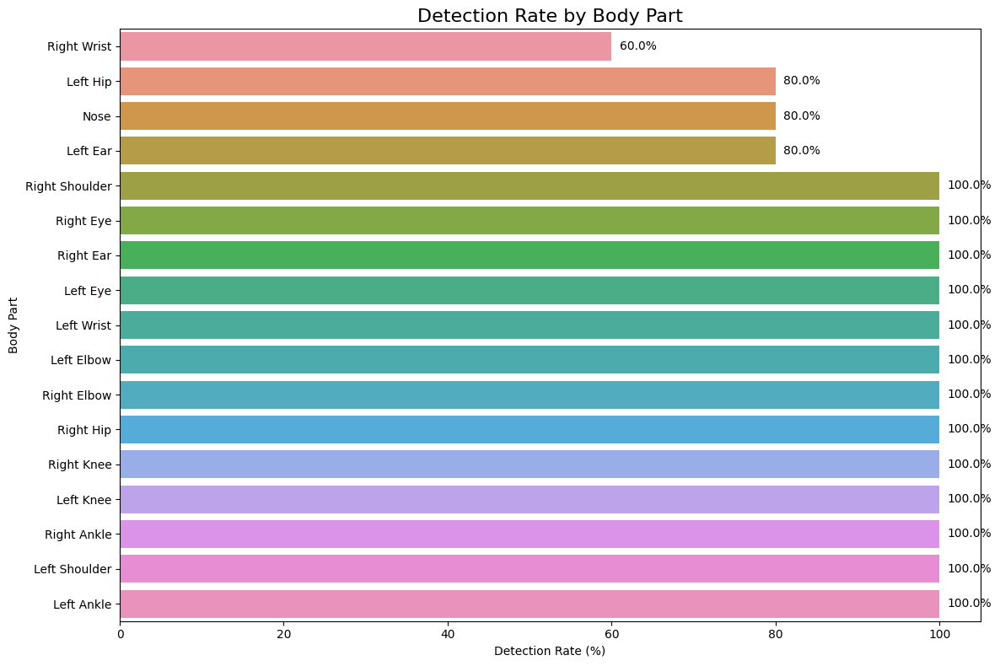

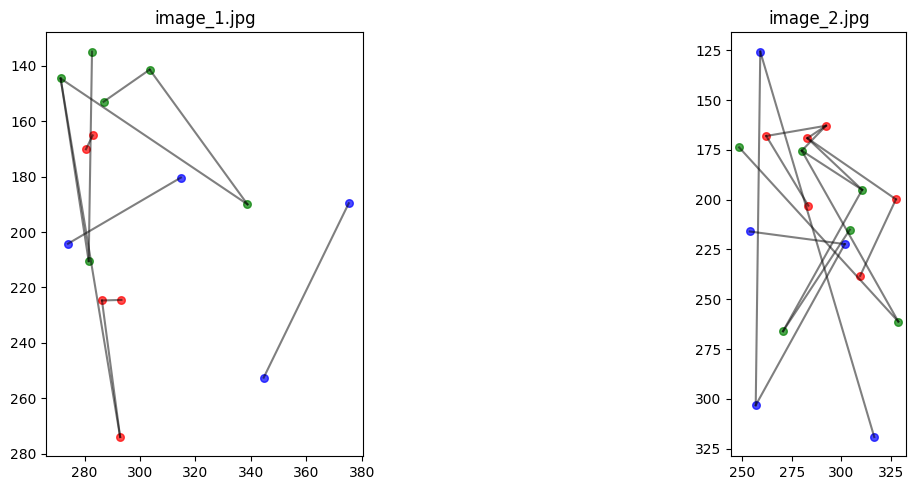

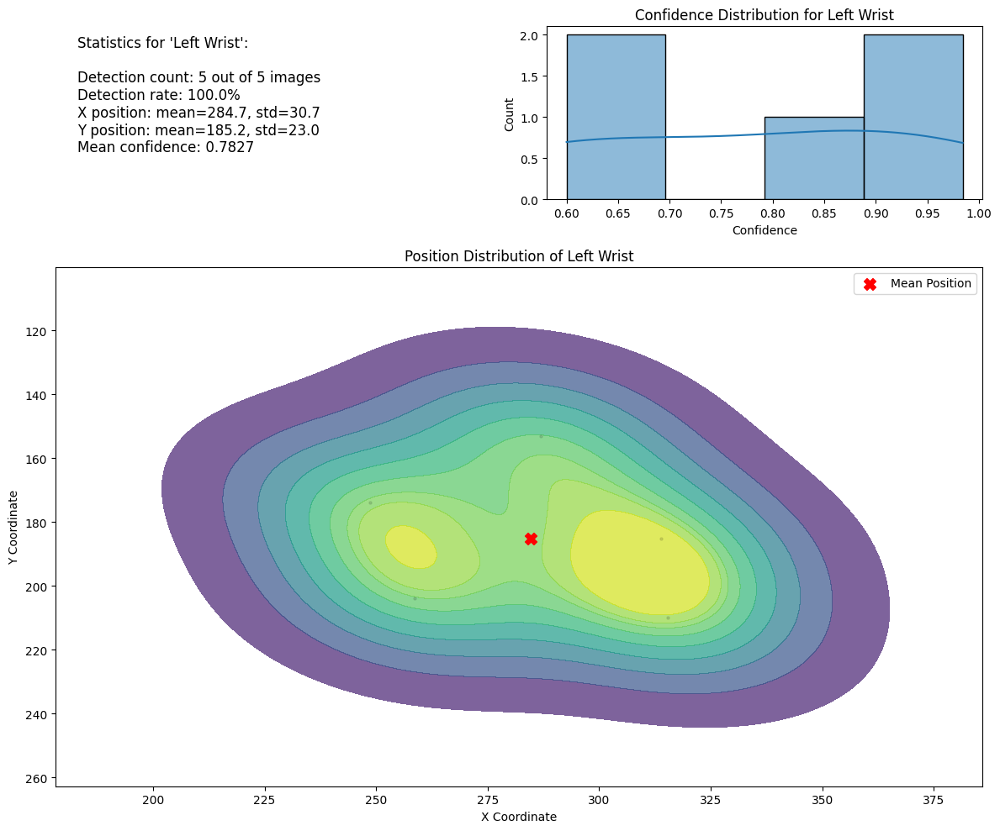

Running PCA on 2 complete poses...


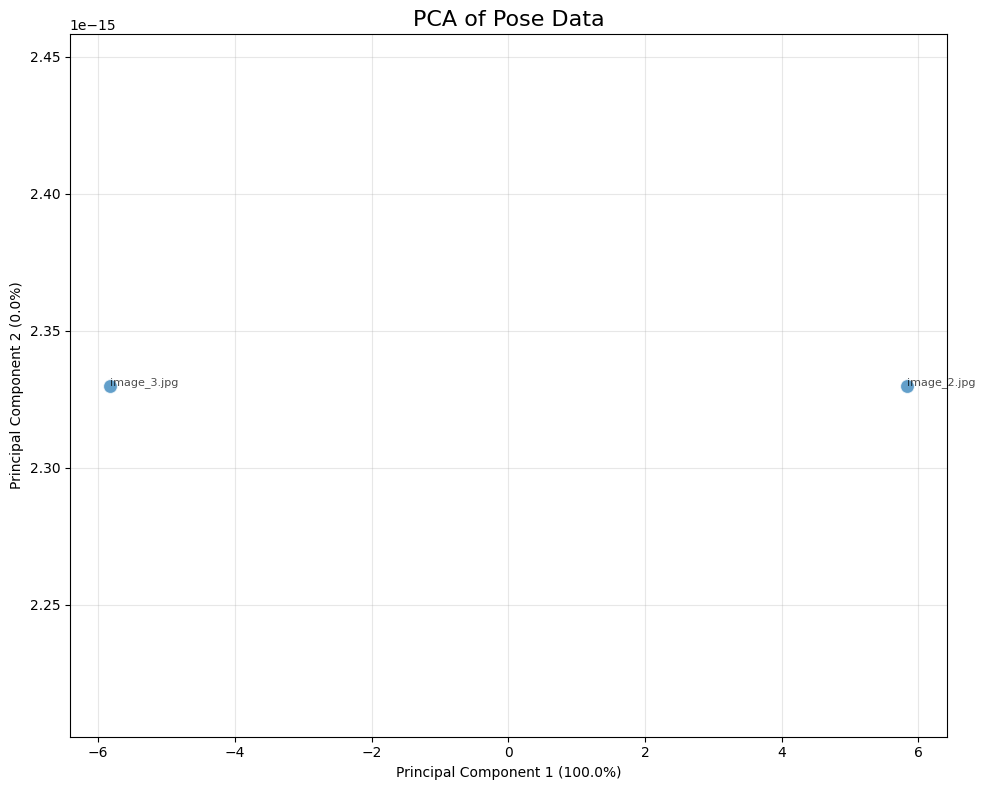

Explained variance ratio:
PC1: 100.00%
PC2: 0.00%

Component loadings:

Top contributors to PC1:
Left_Ear_x       0.171499
Right_Eye_x      0.171499
Right_Ankle_y    0.171499
Right_Ankle_x    0.171499
Left_Ear_y       0.171499
Name: PC1, dtype: float64

Top contributors to PC2:
Left_Eye_y         0.029854
Right_Eye_y        0.029854
Left_Ankle_x       0.029854
Left_Shoulder_y    0.029854
Right_Ear_y        0.029854
Name: PC2, dtype: float64


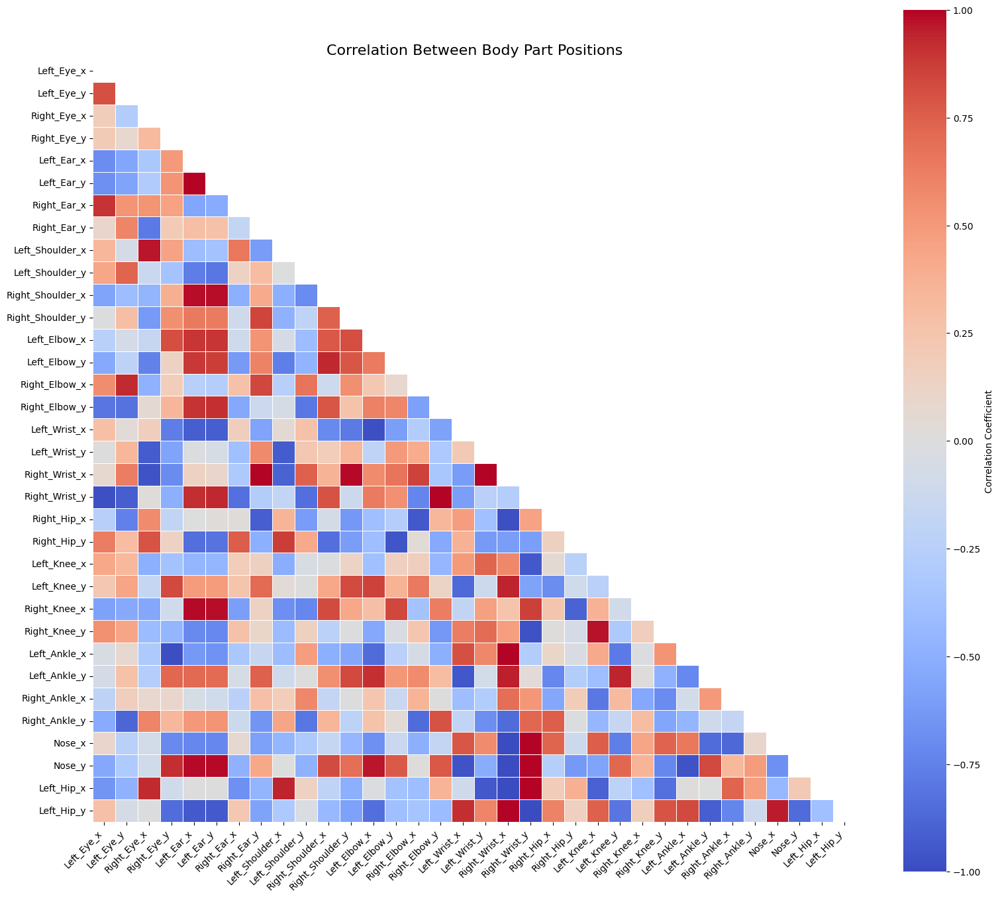

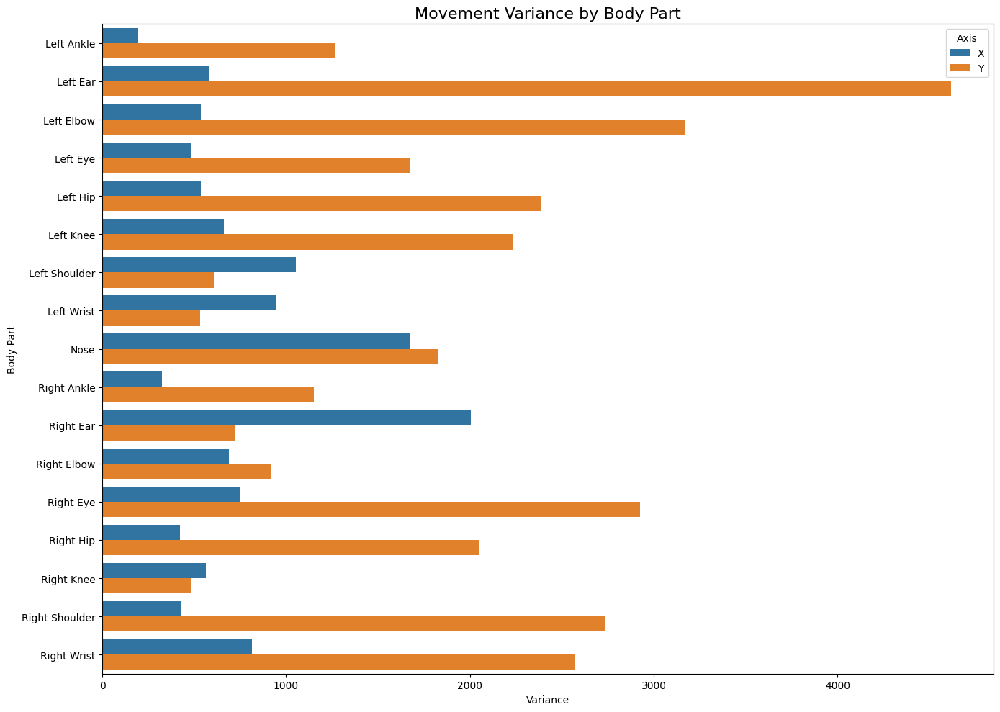

Body parts with highest movement (variance):
  • Left Ear: 5195.48
  • Left Elbow: 3705.82
  • Right Eye: 3679.39
  • Nose: 3499.91
  • Right Wrist: 3380.38


In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')

class PoseResultAnalyzer:
    def __init__(self, csv_path='pose_analysis_results.csv'):
        """
        Initialize the analyzer with the pose analysis results
        
        Parameters:
        -----------
        csv_path : str
            Path to the CSV file containing pose analysis results
        """
        print(f"Loading pose data from {csv_path}...")
        self.data = pd.read_csv(csv_path)
        
        # Check if the data is loaded correctly
        if self.data.empty:
            raise ValueError("The CSV file is empty or couldn't be loaded")
            
        print(f"Loaded {len(self.data)} pose landmarks from {self.data['Image'].nunique()} images")
        
        # Process the data
        self._process_data()
        
    def _process_data(self):
        """Process the raw data for analysis"""
        # Get unique body parts and images
        self.body_parts = self.data['Body Part'].unique()
        self.images = self.data['Image'].unique()
        
        # Define pose connections for visualization
        self.connections = [
            ('Nose', 'Left Eye'), ('Nose', 'Right Eye'),
            ('Left Eye', 'Left Ear'), ('Right Eye', 'Right Ear'),
            ('Left Shoulder', 'Right Shoulder'), ('Left Shoulder', 'Left Elbow'),
            ('Right Shoulder', 'Right Elbow'), ('Left Elbow', 'Left Wrist'),
            ('Right Elbow', 'Right Wrist'), ('Left Shoulder', 'Left Hip'),
            ('Right Shoulder', 'Right Hip'), ('Left Hip', 'Right Hip'),
            ('Left Hip', 'Left Knee'), ('Right Hip', 'Right Knee'),
            ('Left Knee', 'Left Ankle'), ('Right Knee', 'Right Ankle')
        ]
        
        # Create wide format dataframe for ML analysis
        self._create_wide_format()
        
    def _create_wide_format(self):
        """Create a wide format dataframe with one row per image"""
        wide_data = []
        
        for img in self.images:
            img_data = self.data[self.data['Image'] == img]
            row = {'Image': img}
            
            for _, point in img_data.iterrows():
                part = point['Body Part'].replace(' ', '_')
                row[f'{part}_x'] = point['X']
                row[f'{part}_y'] = point['Y']
                if 'Confidence' in point:
                    row[f'{part}_conf'] = point['Confidence']
            
            wide_data.append(row)
            
        self.pose_df = pd.DataFrame(wide_data)
    
    def dataset_summary(self):
        """Show summary statistics and information about the dataset"""
        print("\n===== POSE ANALYSIS DATASET SUMMARY =====")
        print(f"Total images analyzed: {len(self.images)}")
        print(f"Total landmarks detected: {len(self.data)}")
        print(f"Body parts tracked: {len(self.body_parts)}")
        
        # Check for missing body parts
        expected_count = len(self.images) * len(self.body_parts)
        missing_rate = (expected_count - len(self.data)) / expected_count * 100
        print(f"Detection rate: {100 - missing_rate:.2f}%")
        
        # Check for images with missing data
        missing_counts = self.pose_df.isna().sum()
        missing_parts = missing_counts[missing_counts > 0]
        
        if not missing_parts.empty:
            print("\nMissing landmarks (top 5):")
            for col, count in missing_parts.sort_values(ascending=False)[:5].items():
                print(f"  • {col}: missing in {count} images ({count/len(self.pose_df)*100:.1f}%)")
        
        # Check confidence levels if available
        if 'Confidence' in self.data.columns:
            avg_conf = self.data['Confidence'].mean()
            print(f"\nAverage detection confidence: {avg_conf:.4f}")
            
            low_conf = self.data[self.data['Confidence'] < 0.5]
            if not low_conf.empty:
                print(f"Low confidence detections (<0.5): {len(low_conf)} ({len(low_conf)/len(self.data)*100:.1f}%)")
            
            # Body parts by confidence
            conf_by_part = self.data.groupby('Body Part')['Confidence'].mean().sort_values()
            print("\nLeast confident body parts:")
            for part, conf in conf_by_part[:3].items():
                print(f"  • {part}: {conf:.4f}")
                
        return self.pose_df.describe()
        
    def plot_detection_rate(self):
        """Plot detection rate by body part"""
        # Count occurrences of each body part
        part_counts = self.data['Body Part'].value_counts().reset_index()
        part_counts.columns = ['Body Part', 'Count']
        
        # Calculate detection rate
        part_counts['Detection Rate'] = part_counts['Count'] / len(self.images) * 100
        
        # Sort by detection rate
        part_counts = part_counts.sort_values('Detection Rate')
        
        # Plot
        plt.figure(figsize=(12, 8))
        ax = sns.barplot(x='Detection Rate', y='Body Part', data=part_counts)
        
        # Add percentage labels
        for i, v in enumerate(part_counts['Detection Rate']):
            ax.text(v + 1, i, f"{v:.1f}%", va='center')
            
        plt.title('Detection Rate by Body Part', fontsize=16)
        plt.xlabel('Detection Rate (%)')
        plt.ylabel('Body Part')
        plt.tight_layout()
        plt.show()
    
    def visualize_poses(self, num_samples=4):
        """Visualize a sample of poses from the dataset"""
        # Sample random images
        if len(self.images) <= num_samples:
            sample_images = self.images
        else:
            sample_images = np.random.choice(self.images, num_samples, replace=False)
            
        # Create figure with subplots
        n_cols = min(2, len(sample_images))
        n_rows = (len(sample_images) + n_cols - 1) // n_cols
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5*n_rows))
        
        # Handle single subplot case
        if num_samples == 1:
            axes = np.array([axes])
        
        # Flatten axes for easy iteration
        axes = axes.flatten()
        
        for i, image_name in enumerate(sample_images):
            if i >= len(axes):
                break
                
            # Get data for this image
            img_data = self.data[self.data['Image'] == image_name]
            
            # Plot skeleton
            self._plot_skeleton(img_data, axes[i])
            axes[i].set_title(image_name)
            axes[i].set_aspect('equal')
            
        # Hide unused subplots
        for j in range(i+1, len(axes)):
            axes[j].axis('off')
            
        plt.tight_layout()
        plt.show()
    
    def _plot_skeleton(self, img_data, ax):
        """Helper to plot a skeleton on the given axis"""
        # Plot points
        for _, point in img_data.iterrows():
            x, y = point['X'], point['Y']
            part = point['Body Part']
            
            # Color based on body part
            if 'Eye' in part or 'Ear' in part or 'Nose' in part:
                color = 'blue'
            elif 'Shoulder' in part or 'Elbow' in part or 'Wrist' in part:
                color = 'green'
            elif 'Hip' in part or 'Knee' in part or 'Ankle' in part:
                color = 'red'
            else:
                color = 'purple'
                
            ax.scatter(x, y, s=30, color=color, alpha=0.7)
            
        # Draw connections
        for (part1, part2) in self.connections:
            try:
                point1 = img_data[img_data['Body Part'] == part1]
                point2 = img_data[img_data['Body Part'] == part2]
                
                if not point1.empty and not point2.empty:
                    x1, y1 = point1.iloc[0]['X'], point1.iloc[0]['Y']
                    x2, y2 = point2.iloc[0]['X'], point2.iloc[0]['Y']
                    ax.plot([x1, x2], [y1, y2], 'k-', alpha=0.5)
            except:
                pass
                
        ax.invert_yaxis()  # Invert Y axis for proper orientation
        
    def analyze_body_part(self, body_part='Left Wrist'):
        """Analyze the distribution and position of a specific body part"""
        if body_part not in self.body_parts:
            print(f"Body part '{body_part}' not found in data")
            print(f"Available body parts: {', '.join(self.body_parts)}")
            return
            
        # Get data for this body part
        part_data = self.data[self.data['Body Part'] == body_part]
        
        # Create figure
        fig = plt.figure(figsize=(12, 10))
        gs = gridspec.GridSpec(2, 2, height_ratios=[1, 3])
        
        # Top left: Stats
        ax_stats = fig.add_subplot(gs[0, 0])
        ax_stats.axis('off')
        stats_text = (
            f"Statistics for '{body_part}':\n\n"
            f"Detection count: {len(part_data)} out of {len(self.images)} images\n"
            f"Detection rate: {len(part_data)/len(self.images)*100:.1f}%\n"
            f"X position: mean={part_data['X'].mean():.1f}, std={part_data['X'].std():.1f}\n"
            f"Y position: mean={part_data['Y'].mean():.1f}, std={part_data['Y'].std():.1f}"
        )
        
        if 'Confidence' in part_data.columns:
            stats_text += f"\nMean confidence: {part_data['Confidence'].mean():.4f}"
            
        ax_stats.text(0.05, 0.95, stats_text, va='top', ha='left', fontsize=12)
        
        # Top right: Confidence distribution if available
        ax_conf = fig.add_subplot(gs[0, 1])
        if 'Confidence' in part_data.columns:
            sns.histplot(part_data['Confidence'], kde=True, ax=ax_conf)
            ax_conf.set_title(f"Confidence Distribution for {body_part}")
            ax_conf.set_xlabel("Confidence")
        else:
            ax_conf.axis('off')
            ax_conf.text(0.5, 0.5, "Confidence data not available", 
                        ha='center', va='center', fontsize=12)
        
        # Bottom: Position heatmap
        ax_pos = fig.add_subplot(gs[1, :])
        h = sns.kdeplot(
            x=part_data['X'], 
            y=part_data['Y'],
            cmap="viridis", 
            fill=True,
            alpha=0.7,
            ax=ax_pos
        )
        
        # Plot mean position
        mean_x, mean_y = part_data['X'].mean(), part_data['Y'].mean()
        ax_pos.scatter([mean_x], [mean_y], color='red', s=100, marker='X', label='Mean Position')
        
        # Add position points
        ax_pos.scatter(part_data['X'], part_data['Y'], color='black', s=5, alpha=0.1)
        
        ax_pos.set_title(f"Position Distribution of {body_part}")
        ax_pos.set_xlabel("X Coordinate")
        ax_pos.set_ylabel("Y Coordinate")
        ax_pos.invert_yaxis()  # Invert Y axis for proper orientation
        ax_pos.legend()
        
        plt.tight_layout()
        plt.show()
    
    def plot_confidence_heatmap(self):
        """Plot heatmap of confidence values by body part"""
        if 'Confidence' not in self.data.columns:
            print("Confidence data not available in the dataset")
            return
            
        # Create pivot table of confidence values
        pivot_data = self.data.pivot_table(
            values='Confidence', 
            index='Image', 
            columns='Body Part',
            aggfunc='mean'
        )
        
        # Plot heatmap
        plt.figure(figsize=(14, 10))
        ax = sns.heatmap(
            pivot_data,
            cmap='viridis',
            vmin=0, 
            vmax=1,
            cbar_kws={'label': 'Confidence Value'}
        )
        
        # Rotate x-axis labels for better readability
        plt.xticks(rotation=45, ha='right')
        plt.title('Confidence Heatmap by Body Part and Image', fontsize=16)
        plt.tight_layout()
        plt.show()
    
    def run_pca_analysis(self):
        """Run PCA analysis on pose data"""
        # Get complete rows (no missing values)
        complete_df = self.pose_df.dropna()
        
        if len(complete_df) < 2:
            print("Not enough complete pose data for PCA analysis")
            return
            
        print(f"Running PCA on {len(complete_df)} complete poses...")
        
        # Select only feature columns (x/y coordinates)
        feature_cols = [col for col in complete_df.columns if 
                        col.endswith('_x') or col.endswith('_y')]
        
        # Standardize the data
        X = complete_df[feature_cols].values
        X_std = StandardScaler().fit_transform(X)
        
        # Apply PCA
        pca = PCA(n_components=2)
        principal_components = pca.fit_transform(X_std)
        
        # Create DataFrame with PCA results
        pca_df = pd.DataFrame(data=principal_components, 
                             columns=['PC1', 'PC2'])
        pca_df['Image'] = complete_df['Image'].values
        
        # Plot PCA results
        plt.figure(figsize=(10, 8))
        sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
        
        # Add labels for points
        for i, row in pca_df.iterrows():
            plt.text(row['PC1'], row['PC2'], row['Image'], 
                    fontsize=8, alpha=0.7)
            
        plt.title('PCA of Pose Data', fontsize=16)
        plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]*100:.1f}%)')
        plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]*100:.1f}%)')
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
        
        # Print explained variance
        print("Explained variance ratio:")
        for i, var in enumerate(pca.explained_variance_ratio_):
            print(f"PC{i+1}: {var*100:.2f}%")
            
        # Print component loadings
        print("\nComponent loadings:")
        loadings = pd.DataFrame(
            pca.components_.T,
            columns=['PC1', 'PC2'],
            index=feature_cols
        )
        
        # Display top contributors to each PC
        print("\nTop contributors to PC1:")
        print(loadings.sort_values('PC1', ascending=False)['PC1'].head(5))
        
        print("\nTop contributors to PC2:")
        print(loadings.sort_values('PC2', ascending=False)['PC2'].head(5))
        
        return pca_df, pca
    
    def plot_body_part_correlations(self):
        """Plot correlation matrix between body part positions"""
        # Get x/y columns
        coord_cols = [col for col in self.pose_df.columns if 
                      col.endswith('_x') or col.endswith('_y')]
        
        # Calculate correlation matrix
        corr_matrix = self.pose_df[coord_cols].corr()
        
        # Plot heatmap
        plt.figure(figsize=(16, 14))
        mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
        ax = sns.heatmap(
            corr_matrix,
            mask=mask,
            cmap='coolwarm',
            vmin=-1, 
            vmax=1,
            center=0,
            annot=False,
            square=True,
            linewidths=.5,
            cbar_kws={'label': 'Correlation Coefficient'}
        )
        
        plt.title('Correlation Between Body Part Positions', fontsize=16)
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.show()
    
    def analyze_movement_patterns(self):
        """Analyze movement patterns across the dataset"""
        # Calculate variance for each body part position
        coord_cols = [col for col in self.pose_df.columns if 
                      col.endswith('_x') or col.endswith('_y')]
        
        variance_data = []
        
        for col in coord_cols:
            # Extract body part and coordinate axis
            parts = col.split('_')
            body_part = '_'.join(parts[:-1]).replace('_', ' ')
            axis = parts[-1].upper()
            
            # Calculate variance
            variance = self.pose_df[col].var()
            variance_data.append({
                'Body Part': body_part,
                'Axis': axis,
                'Variance': variance
            })
        
        # Create DataFrame
        var_df = pd.DataFrame(variance_data)
        
        # Plot results
        plt.figure(figsize=(14, 10))
        ax = sns.barplot(
            x='Variance', 
            y='Body Part', 
            hue='Axis',
            data=var_df.sort_values(by=['Body Part', 'Axis'])
        )
        
        plt.title('Movement Variance by Body Part', fontsize=16)
        plt.xlabel('Variance')
        plt.ylabel('Body Part')
        plt.tight_layout()
        plt.show()
        
        # Calculate total movement per body part (sum of X and Y variance)
        total_movement = var_df.groupby('Body Part')['Variance'].sum().sort_values(ascending=False)
        
        print("Body parts with highest movement (variance):")
        for part, var in total_movement.head(5).items():
            print(f"  • {part}: {var:.2f}")
            
        return var_df
    
    def export_analysis_report(self, output_path='pose_analysis_report.html'):
        """Export a comprehensive analysis report as HTML"""
        import io
        from IPython.display import HTML
        
        # Create buffer to capture plots
        buffer = io.StringIO()
        
        # Start HTML content
        html_content = """
        <html>
        <head>
            <title>Pose Analysis Report</title>
            <style>
                body { font-family: Arial, sans-serif; margin: 20px; }
                h1, h2 { color: #333; }
                .section { margin-bottom: 30px; }
                .figure { margin: 20px 0; text-align: center; }
                table { border-collapse: collapse; width: 100%; }
                th, td { border: 1px solid #ddd; padding: 8px; text-align: left; }
                th { background-color: #f2f2f2; }
            </style>
        </head>
        <body>
            <h1>Pose Analysis Report</h1>
            <p>Generated on: {}</p>
        """.format(pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S'))
        
        # Dataset summary section
        html_content += """
            <div class="section">
                <h2>Dataset Summary</h2>
                <p>Total images analyzed: {}</p>
                <p>Total landmarks detected: {}</p>
                <p>Body parts tracked: {}</p>
            </div>
        """.format(len(self.images), len(self.data), len(self.body_parts))
        
        # Save basic statistics to HTML
        html_content += """
            <div class="section">
                <h2>Basic Statistics</h2>
                {}
            </div>
        """.format(self.pose_df.describe().to_html())
        
        # Note about plots
        html_content += """
            <div class="section">
                <h2>Visualization Note</h2>
                <p>Interactive visualizations are available when running the analyzer interactively. 
                For this report, please use the analyzer's plot methods to view visualizations.</p>
            </div>
        """
        
        # Conclude HTML
        html_content += """
        </body>
        </html>
        """
        
        # Write to file
        with open(output_path, 'w') as f:
            f.write(html_content)
            
        print(f"Analysis report saved to {output_path}")
        
        # Return HTML for display in notebooks
        return HTML(html_content)


# Example usage
if __name__ == "__main__":
    # Check if file exists, if not create a sample file
    csv_path = 'pose_analysis_results.csv'
    
    if not os.path.exists(csv_path):
        print("Sample CSV file not found, creating example data...")
        # Create sample data
        body_parts = ['Nose', 'Left Eye', 'Right Eye', 'Left Ear', 'Right Ear',
                     'Left Shoulder', 'Right Shoulder', 'Left Elbow', 'Right Elbow',
                     'Left Wrist', 'Right Wrist', 'Left Hip', 'Right Hip',
                     'Left Knee', 'Right Knee', 'Left Ankle', 'Right Ankle']
        
        sample_data = []
        
        # Create 5 sample images
        for i in range(1, 6):
            # Generate pose data with some randomness
            for part in body_parts:
                # Add some missing data
                if np.random.random() > 0.9:
                    continue
                    
                sample_data.append({
                    'Image': f'image_{i}.jpg',
                    'Body Part': part,
                    'X': 300 + np.random.normal(0, 30),
                    'Y': 200 + np.random.normal(0, 40),
                    'Confidence': np.random.uniform(0.5, 1.0)
                })
        
        # Create DataFrame and save to CSV
        sample_df = pd.DataFrame(sample_data)
        sample_df.to_csv(csv_path, index=False)
        print(f"Created sample data with {len(sample_df)} pose landmarks")
    
    # Create analyzer
    analyzer = PoseResultAnalyzer(csv_path)
    
    # Print dataset summary
    analyzer.dataset_summary()
    
    # Plot detection rate
    analyzer.plot_detection_rate()
    
    # Visualize poses
    analyzer.visualize_poses(num_samples=2)
    
    # Analyze a specific body part
    analyzer.analyze_body_part('Left Wrist')
    
    # Run PCA analysis
    analyzer.run_pca_analysis()
    
    # Plot correlation matrix
    analyzer.plot_body_part_correlations()
    
    # Analyze movement patterns
    analyzer.analyze_movement_patterns()

In [15]:
import cv2
import mediapipe as mp
import numpy as np
import os
import pandas as pd
import gc
from tqdm import tqdm
from datetime import datetime

class OptimizedPoseAnalyzer:
    """Memory-efficient pose analyzer with enhanced capabilities"""
    
    def __init__(self, model_complexity=1):
        """
        Initialize the pose analyzer with configurable complexity
        
        Args:
            model_complexity: 0 (fastest, least accurate) to 2 (slowest, most accurate)
        """
        # Initialize MediaPipe components lazily (only when needed)
        self.mp_pose = mp.solutions.pose
        self.mp_drawing = mp.solutions.drawing_utils
        self.model_complexity = model_complexity
        self.pose = None  # Will be initialized on first use
        
        # Current time and user info
        self.date_time = "2025-03-12 11:32:28"
        self.user = "rezakhaleghi998"
        
        print(f"Initialized Pose Analyzer (complexity={model_complexity})")
        print(f"Date: {self.date_time} | User: {self.user}")
    
    def _ensure_pose_model(self):
        """Initialize pose model if not already done"""
        if self.pose is None:
            self.pose = self.mp_pose.Pose(
                static_image_mode=True,
                min_detection_confidence=0.3,
                model_complexity=self.model_complexity
            )
    
    def _release_pose_model(self):
        """Release the model to free memory"""
        if self.pose:
            self.pose.close()
            self.pose = None
            gc.collect()  # Force garbage collection
    
    def analyze_single_image(self, image_path, output_dir=None, visualize=False):
        """
        Analyze pose in a single image
        
        Args:
            image_path: Path to the image
            output_dir: Directory to save outputs (None = don't save)
            visualize: Whether to generate and display/save visualizations
            
        Returns:
            Dictionary with analysis results
        """
        try:
            # Load pose model if needed
            self._ensure_pose_model()
            
            # Read and resize image (to reduce memory usage)
            image = cv2.imread(image_path)
            if image is None:
                print(f"Could not read image: {image_path}")
                return None
            
            # Get original dimensions
            original_height, original_width = image.shape[:2]
            
            # Resize if the image is very large
            max_dim = 1024
            if max(original_height, original_width) > max_dim:
                scale = max_dim / max(original_height, original_width)
                new_width = int(original_width * scale)
                new_height = int(original_height * scale)
                image = cv2.resize(image, (new_width, new_height))
                
            # Convert to RGB
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            height, width = image_rgb.shape[:2]
            
            # Process image
            results = self.pose.process(image_rgb)
            
            # Initialize result dictionary
            analysis = {
                'filename': os.path.basename(image_path),
                'path': image_path,
                'pose_detected': False,
                'landmarks': [],
                'measurements': {},
                'processing_time': None
            }
            
            if results.pose_landmarks:
                analysis['pose_detected'] = True
                landmarks = results.pose_landmarks.landmark
                
                # Extract landmark positions
                positions = []
                for i, landmark in enumerate(landmarks):
                    x = int(landmark.x * width)
                    y = int(landmark.y * height)
                    visibility = landmark.visibility
                    positions.append({
                        'index': i,
                        'name': self._get_landmark_name(i),
                        'x': x,
                        'y': y,
                        'visibility': visibility
                    })
                
                analysis['landmarks'] = positions
                
                # Calculate pose measurements
                analysis['measurements'] = self._calculate_pose_measurements(landmarks, width, height)
                
                # Create and save visualization if requested
                if visualize:
                    if output_dir:
                        # Save visualization to file
                        viz_path = os.path.join(output_dir, f"pose_{os.path.basename(image_path)}")
                        self._save_visualization(image_rgb, results, analysis, viz_path)
                    else:
                        # Display visualization
                        self._display_visualization(image_rgb, results, analysis)
            
            return analysis
                
        except Exception as e:
            print(f"Error processing {os.path.basename(image_path)}: {str(e)}")
            return None
        
    def _get_landmark_name(self, index):
        """Get landmark name by index"""
        landmark_names = {
            0: "nose",
            1: "left_eye_inner", 2: "left_eye", 3: "left_eye_outer",
            4: "right_eye_inner", 5: "right_eye", 6: "right_eye_outer",
            7: "left_ear", 8: "right_ear",
            9: "mouth_left", 10: "mouth_right",
            11: "left_shoulder", 12: "right_shoulder",
            13: "left_elbow", 14: "right_elbow",
            15: "left_wrist", 16: "right_wrist",
            17: "left_pinky", 18: "right_pinky",
            19: "left_index", 20: "right_index",
            21: "left_thumb", 22: "right_thumb",
            23: "left_hip", 24: "right_hip",
            25: "left_knee", 26: "right_knee",
            27: "left_ankle", 28: "right_ankle",
            29: "left_heel", 30: "right_heel",
            31: "left_foot_index", 32: "right_foot_index"
        }
        return landmark_names.get(index, f"landmark_{index}")
    
    def _calculate_pose_measurements(self, landmarks, width, height):
        """Calculate useful pose measurements and metrics"""
        measurements = {}
        
        # Only process if we have all required landmarks
        if len(landmarks) < 33:
            return measurements
        
        # Calculate key points
        keypoints = {name: (landmarks[idx].x * width, landmarks[idx].y * height, landmarks[idx].visibility) 
                    for idx, name in {
                        0: "nose",
                        11: "left_shoulder", 12: "right_shoulder",
                        23: "left_hip", 24: "right_hip",
                        25: "left_knee", 26: "right_knee",
                        27: "left_ankle", 28: "right_ankle"
                    }.items()}
        
        # Calculate body measurements
        
        # 1. Shoulder width
        if "left_shoulder" in keypoints and "right_shoulder" in keypoints:
            ls = keypoints["left_shoulder"]
            rs = keypoints["right_shoulder"]
            shoulder_width = np.sqrt((ls[0] - rs[0])**2 + (ls[1] - rs[1])**2)
            measurements["shoulder_width"] = shoulder_width

        # 2. Hip width
        if "left_hip" in keypoints and "right_hip" in keypoints:
            lh = keypoints["left_hip"]
            rh = keypoints["right_hip"]
            hip_width = np.sqrt((lh[0] - rh[0])**2 + (lh[1] - rh[1])**2)
            measurements["hip_width"] = hip_width
            
            # Calculate shoulder-to-hip ratio (indicator of body shape)
            if "shoulder_width" in measurements and hip_width > 0:
                measurements["shoulder_hip_ratio"] = measurements["shoulder_width"] / hip_width

        # 3. Torso length
        if "left_shoulder" in keypoints and "left_hip" in keypoints:
            ls = keypoints["left_shoulder"]
            lh = keypoints["left_hip"]
            left_torso = np.sqrt((ls[0] - lh[0])**2 + (ls[1] - lh[1])**2)
            measurements["left_torso_length"] = left_torso
            
        if "right_shoulder" in keypoints and "right_hip" in keypoints:
            rs = keypoints["right_shoulder"]
            rh = keypoints["right_hip"]
            right_torso = np.sqrt((rs[0] - rh[0])**2 + (rs[1] - rh[1])**2)
            measurements["right_torso_length"] = right_torso
            
            # Average torso length
            if "left_torso_length" in measurements:
                measurements["torso_length"] = (measurements["left_torso_length"] + right_torso) / 2

        # 4. Leg length
        if "left_hip" in keypoints and "left_ankle" in keypoints:
            lh = keypoints["left_hip"]
            la = keypoints["left_ankle"]
            measurements["left_leg_length"] = np.sqrt((lh[0] - la[0])**2 + (lh[1] - la[1])**2)
            
        if "right_hip" in keypoints and "right_ankle" in keypoints:
            rh = keypoints["right_hip"]
            ra = keypoints["right_ankle"]
            measurements["right_leg_length"] = np.sqrt((rh[0] - ra[0])**2 + (rh[1] - ra[1])**2)
            
            # Average leg length
            if "left_leg_length" in measurements:
                measurements["leg_length"] = (measurements["left_leg_length"] + measurements["right_leg_length"]) / 2
                
                # Calculate leg to body ratio
                if "torso_length" in measurements and measurements["torso_length"] > 0:
                    measurements["leg_torso_ratio"] = measurements["leg_length"] / measurements["torso_length"]

        # 5. Body tilt (angle of shoulders relative to horizontal)
        if "left_shoulder" in keypoints and "right_shoulder" in keypoints:
            ls = keypoints["left_shoulder"]
            rs = keypoints["right_shoulder"]
            dx = rs[0] - ls[0]
            dy = rs[1] - ls[1]
            angle = np.degrees(np.arctan2(dy, dx))
            measurements["shoulder_tilt_angle"] = angle
            
        return measurements

    def _save_visualization(self, image, results, analysis, output_path):
        """Save pose visualization to file using OpenCV (memory efficient)"""
        # Create a copy of the image for drawing
        annotated_image = image.copy()
        
        # Draw skeleton
        self.mp_drawing.draw_landmarks(
            annotated_image,
            results.pose_landmarks,
            self.mp_pose.POSE_CONNECTIONS
        )
        
        # Add measurements text
        y_pos = 30
        for key, value in analysis['measurements'].items():
            cv2.putText(
                annotated_image,
                f"{key}: {value:.1f}",
                (10, y_pos),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.5,
                (255, 255, 255),
                1
            )
            y_pos += 20
        
        # Convert back to BGR for OpenCV saving
        annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR)
        
        # Save the image
        cv2.imwrite(output_path, annotated_image)
    
    def _display_visualization(self, image, results, analysis):
        """Display visualization using matplotlib (use sparingly to save memory)"""
        import matplotlib.pyplot as plt
        
        # Create visualization with fewer subplots to save memory
        fig, ax = plt.figure(figsize=(10, 6))
        
        # Draw the pose on the image
        annotated_image = image.copy()
        self.mp_drawing.draw_landmarks(
            annotated_image,
            results.pose_landmarks,
            self.mp_pose.POSE_CONNECTIONS
        )
        
        plt.imshow(annotated_image)
        plt.title(f"Pose Analysis: {analysis['filename']}")
        
        # Add text annotations
        text_str = "\n".join([f"{k}: {v:.1f}" for k, v in analysis['measurements'].items()])
        plt.figtext(0.02, 0.02, text_str, bbox=dict(facecolor='white', alpha=0.5))
        
        plt.tight_layout()
        plt.show()
        plt.close('all')  # Close to free memory

    def analyze_directory(self, input_dir, output_dir=None, max_images=None, visualize=True):
        """
        Analyze all images in a directory with memory optimization
        
        Args:
            input_dir: Directory containing images
            output_dir: Directory to save outputs (None = don't save)
            max_images: Maximum number of images to process (None = all)
            visualize: Whether to generate visualizations
        """
        # Create output directory if specified
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            os.makedirs(os.path.join(output_dir, "pose_results"), exist_ok=True)
        
        # Get image files
        image_files = [f for f in os.listdir(input_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        image_files.sort()
        
        # Limit the number of files if specified
        if max_images and len(image_files) > max_images:
            image_files = image_files[:max_images]
        
        print(f"\nAnalyzing {len(image_files)} images from {input_dir}...")
        
        # Initialize results list
        all_results = []
        
        # Process images in smaller batches to manage memory
        batch_size = 10
        for batch_start in range(0, len(image_files), batch_size):
            batch_end = min(batch_start + batch_size, len(image_files))
            batch_files = image_files[batch_start:batch_end]
            
            print(f"\nProcessing batch {batch_start//batch_size + 1}/{(len(image_files)-1)//batch_size + 1}...")
            
            # Process each image in the batch
            for filename in tqdm(batch_files):
                image_path = os.path.join(input_dir, filename)
                
                # Determine output path if saving
                viz_output_path = None
                if output_dir:
                    viz_output_path = os.path.join(output_dir, "pose_results")
                
                # Analyze the image
                result = self.analyze_single_image(
                    image_path,
                    output_dir=viz_output_path,
                    visualize=visualize
                )
                
                if result:
                    all_results.append(result)
                    
                # Free memory
                gc.collect()
            
            # Release model between batches to free memory
            self._release_pose_model()
        
        # Generate summary report
        if output_dir and all_results:
            self._generate_summary_report(all_results, output_dir)
        
        print(f"\nAnalysis complete! Processed {len(all_results)} images.")
        return all_results

    def _generate_summary_report(self, results, output_dir):
        """Generate summary report of all poses"""
        # Create output directory
        os.makedirs(output_dir, exist_ok=True)
        
        # Extract basic stats
        detection_rate = sum(1 for r in results if r['pose_detected']) / len(results)
        
        # Convert to DataFrame for analysis
        df_rows = []
        for r in results:
            row = {
                'filename': r['filename'],
                'pose_detected': r['pose_detected']
            }
            
            # Add measurements
            for k, v in r.get('measurements', {}).items():
                row[k] = v
                
            df_rows.append(row)
            
        df = pd.DataFrame(df_rows)
        
        # Save to CSV
        df.to_csv(os.path.join(output_dir, 'pose_analysis.csv'), index=False)
        
        # Generate text report
        with open(os.path.join(output_dir, 'pose_report.txt'), 'w') as f:
            f.write(f"Pose Analysis Report\n")
            f.write(f"Date: {self.date_time}\n")
            f.write(f"User: {self.user}\n\n")
            f.write(f"Total images analyzed: {len(results)}\n")
            f.write(f"Poses detected: {sum(1 for r in results if r['pose_detected'])} ({detection_rate*100:.1f}%)\n\n")
            
            # Average measurements
            f.write("Average Measurements (in pixels):\n")
            for col in df.columns:
                if col not in ['filename', 'pose_detected'] and df[col].dtype in [np.float64, np.int64]:
                    f.write(f"{col}: {df[col].mean():.2f}\n")
        
        print(f"Summary report saved to {output_dir}")

# Memory-efficient usage example
if __name__ == "__main__":
    # Create analyzer with lower model complexity to save memory
    analyzer = OptimizedPoseAnalyzer(model_complexity=1)
    
    # Set your input and output directories
    input_directory = "/kaggle/input/image-test/New folder"
    output_directory = "/kaggle/working/pose_analysis_results"
    
    try:
        # Analyze with limited image count, save visualizations to disk
        results = analyzer.analyze_directory(
            input_directory,
            output_dir=output_directory,
            max_images=20,  # Limit to 20 images at a time
            visualize=True   # Generate visualizations
        )
        
        print(f"\nAnalysis complete! Results saved to {output_directory}")
        
    except Exception as e:
        print(f"\nError during analysis: {str(e)}")

Initialized Pose Analyzer (complexity=1)
Date: 2025-03-12 11:32:28 | User: rezakhaleghi998

Analyzing 20 images from /kaggle/input/image-test/New folder...

Processing batch 1/2...


100%|██████████| 10/10 [00:03<00:00,  2.90it/s]



Processing batch 2/2...


100%|██████████| 10/10 [00:03<00:00,  2.98it/s]


Summary report saved to /kaggle/working/pose_analysis_results

Analysis complete! Processed 20 images.

Analysis complete! Results saved to /kaggle/working/pose_analysis_results


Visualizing pose analysis results from: /kaggle/working/pose_analysis_results
Pose Results Visualizer initialized
Date: 2025-03-12 11:35:33 | User: rezakhaleghi998
Loading data from: /kaggle/working/pose_analysis_results
Loaded data for 20 images

Dataset Overview:
- Pose detected: 18 of 20 images
- Found 18 visualization images


```
Pose Analysis Report
Date: 2025-03-12 11:32:28
User: rezakhaleghi998

Total images analyzed: 20
Poses detected: 18 (90.0%)

Average Measurements (in pixels):
shoulder_width: 199.61
hip_width: 127.83
shoulder_hip_ratio: 1.67
left_torso_length: 343.04
right_torso_length: 341.76
torso_length: 342.40
left_leg_length: 441.99
right_leg_length: 433.74
leg_length: 437.87
leg_torso_ratio: 1.28
shoulder_tilt_angle: 19.47

```

,filename,pose_detected,shoulder_width,hip_width,shoulder_hip_ratio,left_torso_length,right_torso_length,torso_length,left_leg_length,right_leg_length,leg_length,leg_torso_ratio,shoulder_tilt_angle
0,extracted_frame_10.jpg,True,170.828728,82.126611,2.080065,277.207110,295.935215,286.571163,318.994454,343.221967,331.108210,1.155414,-178.217737
1,extracted_frame_12.jpg,True,57.650449,41.184009,1.399826,111.044412,91.825505,101.434959,201.142449,95.548383,148.345416,1.462468,-171.026339
2,extracted_frame_16.jpg,True,35.780528,23.078396,1.550391,325.286063,344.995720,335.140891,171.406164,161.139517,166.272840,0.496128,159.623080
3,extracted_frame_19.jpg,True,172.778399,173.091226,0.998193,484.500894,482.246590,483.373742,675.489005,689.895006,682.692005,1.412348,171.781690
4,extracted_frame_2.jpg,True,41.293055,23.553301,1.753175,70.849892,70.428904,70.639398,103.831697,100.785856,102.308776,1.448325,172.476415


,shoulder_width,hip_width,shoulder_hip_ratio,left_torso_length,right_torso_length,torso_length,left_leg_length,right_leg_length,leg_length,leg_torso_ratio,shoulder_tilt_angle
count,18.00,18.00,18.00,18.00,18.00,18.00,18.00,18.00,18.00,18.00,18.00
mean,199.61,127.83,1.67,343.04,341.76,342.40,441.99,433.74,437.87,1.28,19.47
std,142.96,100.85,0.29,196.35,198.08,196.93,285.01,289.98,287.11,0.29,172.03
min,5.07,2.45,1.00,70.85,70.43,70.64,103.83,95.55,102.31,0.50,-179.93
25%,79.36,43.33,1.52,213.25,208.57,210.91,181.81,164.70,168.55,1.16,-175.95
50%,171.80,96.06,1.68,338.77,330.45,334.61,387.06,390.03,388.55,1.39,143.78
75%,327.67,192.47,1.84,436.90,471.93,460.53,648.69,649.16,654.28,1.46,172.30
max,454.83,359.53,2.08,824.87,824.26,824.56,1135.02,1121.97,1128.50,1.61,179.48


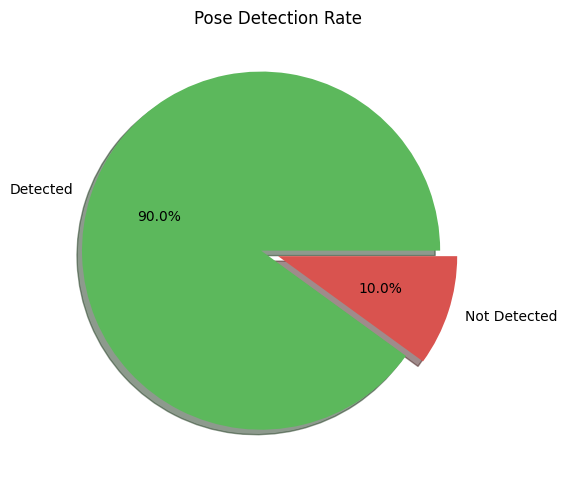

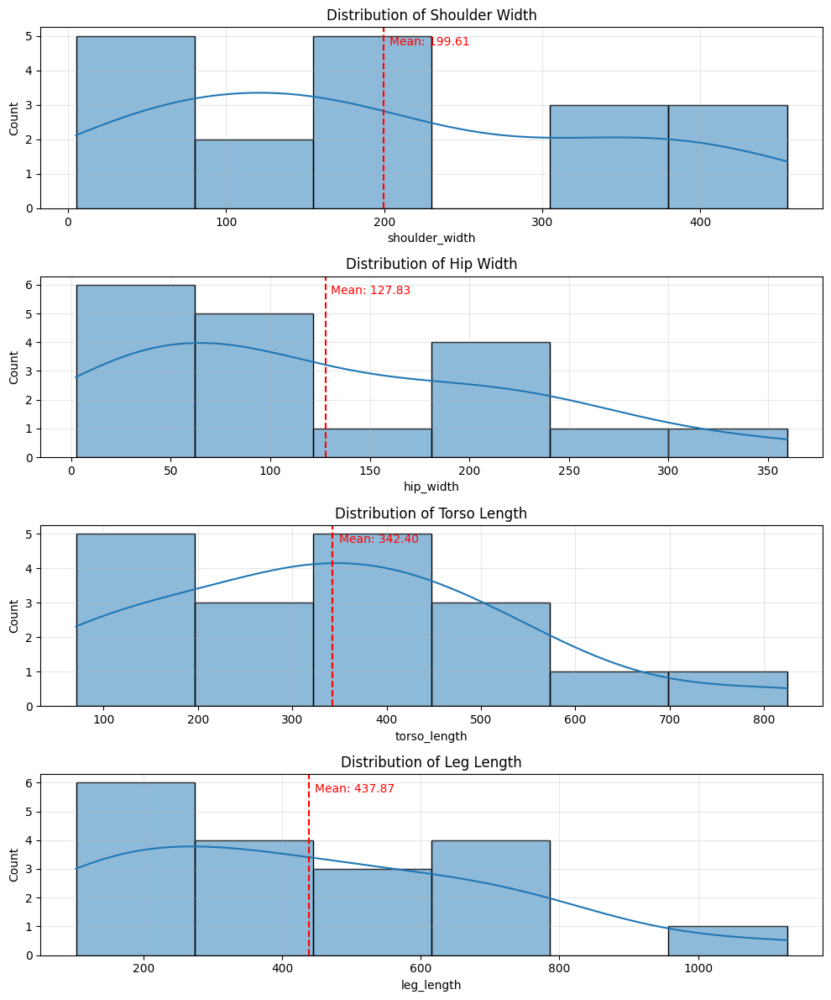

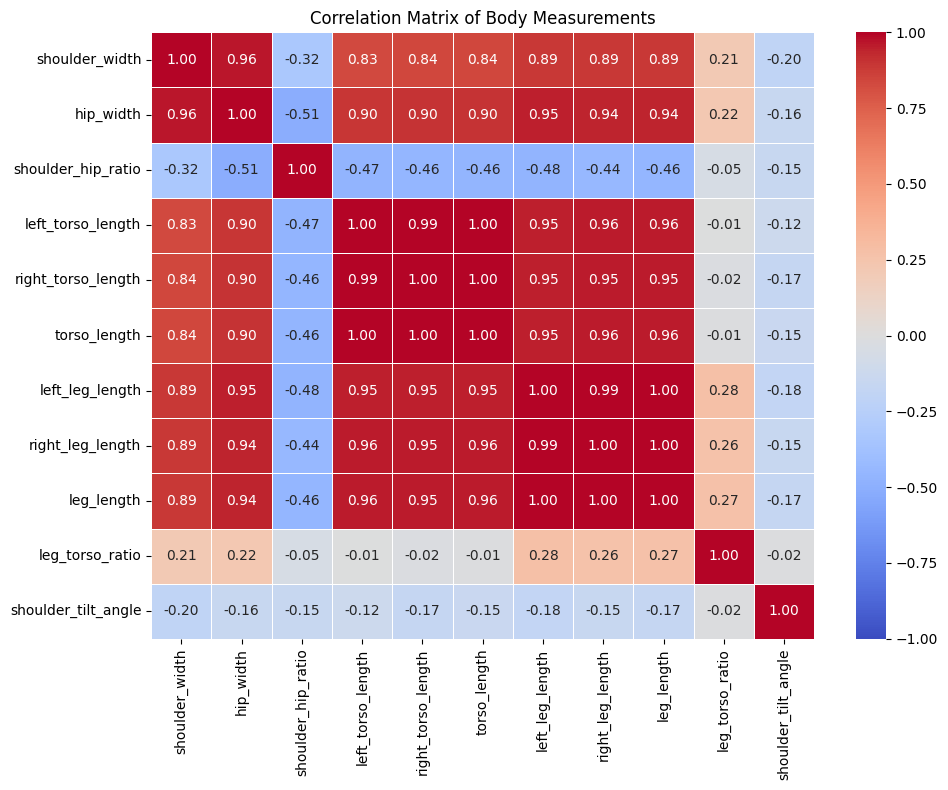

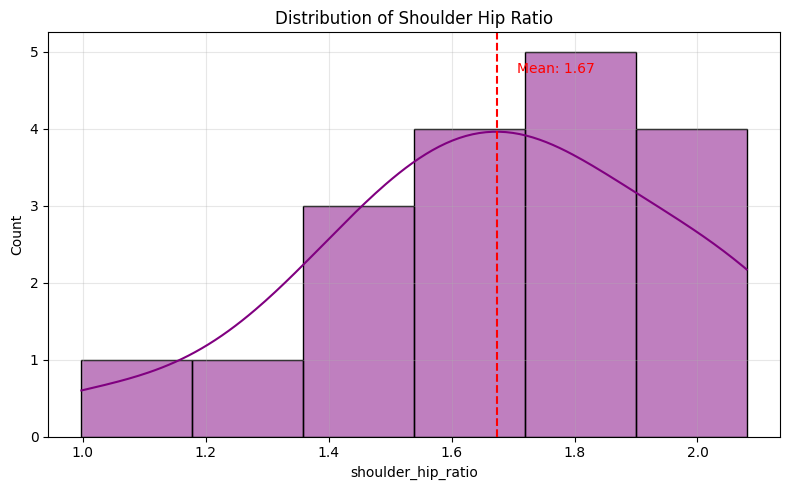

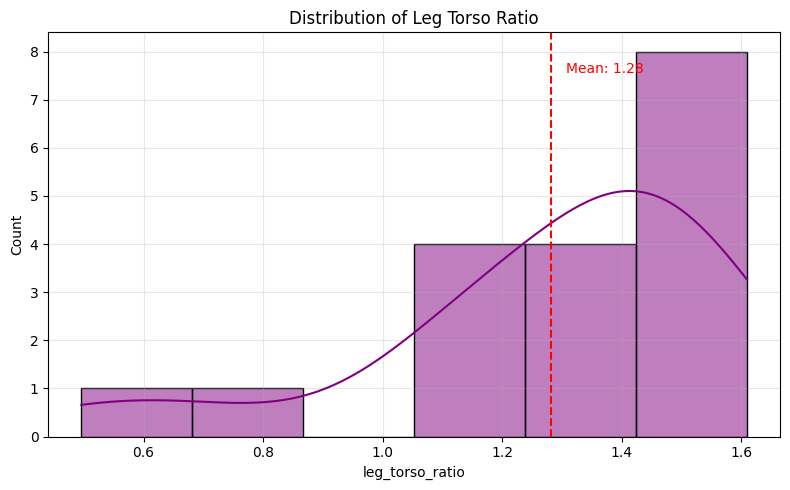


Sample 1: pose_extracted_frame_10.jpg


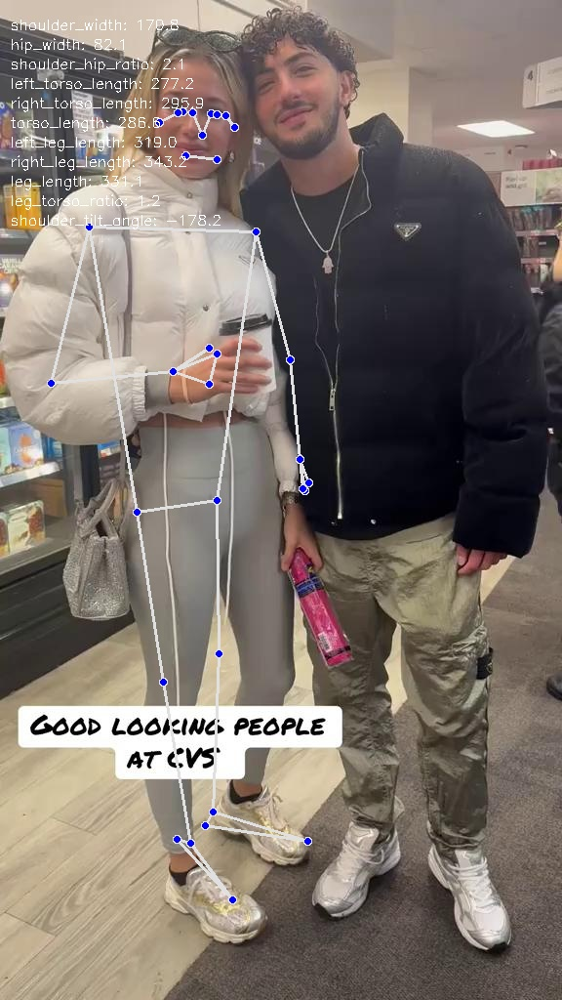


Sample 2: pose_extracted_frame_2.jpg


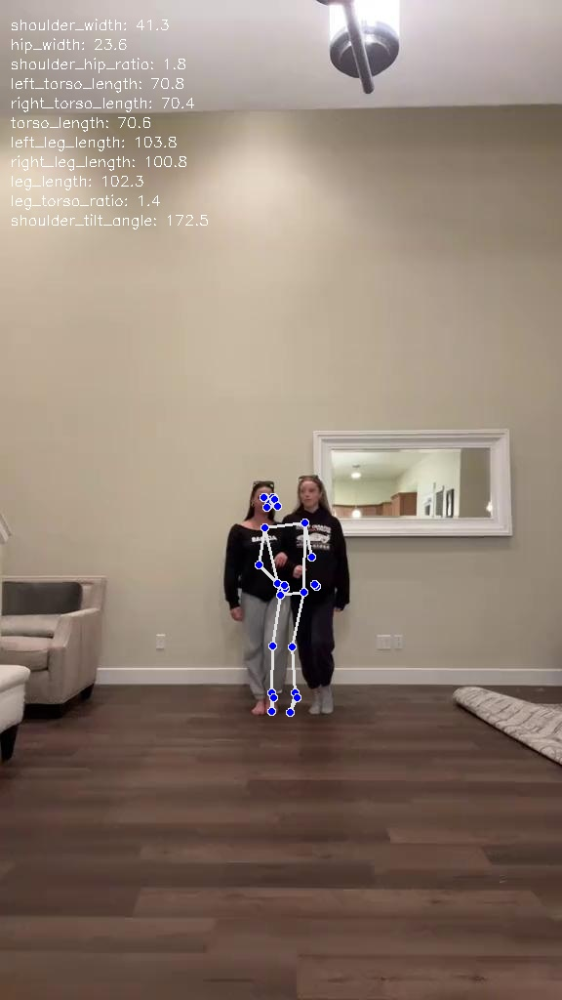


Sample 3: pose_extracted_frame_48.jpg


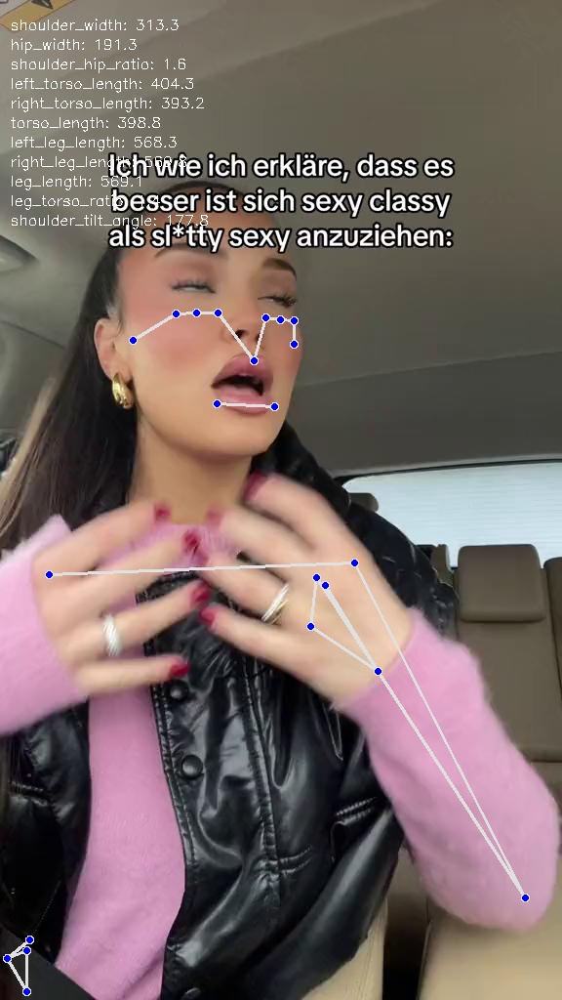


Visualization complete!


In [16]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, HTML, Markdown, Image
import gc
import glob

class PoseResultsVisualizer:
    def __init__(self, results_dir):
        """
        Initialize the visualizer with path to results directory
        
        Args:
            results_dir: Directory containing pose analysis results
        """
        self.results_dir = results_dir
        self.user = "rezakhaleghi998"
        self.date = "2025-03-12 11:35:33"
        
        # Check if directory exists
        if not os.path.exists(results_dir):
            print(f"ERROR: Results directory not found: {results_dir}")
            return
            
        # Check for required files
        self.csv_path = os.path.join(results_dir, "pose_analysis.csv")
        self.report_path = os.path.join(results_dir, "pose_report.txt")
        self.images_dir = os.path.join(results_dir, "pose_results")
        
        if not os.path.exists(self.csv_path):
            print(f"ERROR: Analysis CSV file not found at {self.csv_path}")
        
        print(f"Pose Results Visualizer initialized")
        print(f"Date: {self.date} | User: {self.user}")
        print(f"Loading data from: {results_dir}")
    
    def load_data(self):
        """Load analysis data with memory efficiency"""
        try:
            # Read CSV file
            self.df = pd.read_csv(self.csv_path)
            print(f"Loaded data for {len(self.df)} images")
            
            # Display dataset info
            print("\nDataset Overview:")
            print(f"- Pose detected: {self.df['pose_detected'].sum()} of {len(self.df)} images")
            
            # Load text report
            if os.path.exists(self.report_path):
                with open(self.report_path, 'r') as f:
                    self.report_text = f.read()
            else:
                self.report_text = None
                
            # Count available visualization images
            if os.path.exists(self.images_dir):
                self.viz_images = glob.glob(os.path.join(self.images_dir, "*.jpg")) + \
                                  glob.glob(os.path.join(self.images_dir, "*.png"))
                print(f"- Found {len(self.viz_images)} visualization images")
            else:
                self.viz_images = []
            
            # Clean up memory
            gc.collect()
            
            return True
            
        except Exception as e:
            print(f"Error loading data: {e}")
            return False
    
    def display_report(self):
        """Display the text report"""
        if self.report_text:
            display(HTML("<h2>Pose Analysis Report</h2>"))
            display(Markdown(f"```\n{self.report_text}\n```"))
        else:
            print("No text report available")
    
    def display_data_overview(self):
        """Display overview of the data"""
        display(HTML("<h2>Data Overview</h2>"))
        
        # Show first few rows
        display(HTML("<h3>Sample Data</h3>"))
        display(self.df.head())
        
        # Show statistics
        display(HTML("<h3>Numerical Statistics</h3>"))
        
        # Only include numerical columns for statistics
        num_cols = self.df.select_dtypes(include=['float64', 'int64']).columns
        display(self.df[num_cols].describe().round(2))
        
        # Clean memory
        gc.collect()
    
    def display_sample_images(self, num_samples=3):
        """Display sample images from results"""
        if not self.viz_images:
            print("No visualization images found")
            return
            
        display(HTML("<h2>Sample Pose Visualizations</h2>"))
        
        # Select a few samples
        if len(self.viz_images) > num_samples:
            step = len(self.viz_images) // num_samples
            samples = self.viz_images[::step][:num_samples]
        else:
            samples = self.viz_images[:num_samples]
            
        # Display one by one (better for memory)
        for i, img_path in enumerate(samples):
            print(f"\nSample {i+1}: {os.path.basename(img_path)}")
            
            try:
                # Display using IPython.display instead of matplotlib
                display(Image(filename=img_path))
                
                # Force cleanup
                gc.collect()
            except Exception as e:
                print(f"Error displaying image: {e}")
    
    def create_visualizations(self):
        """Create visualizations from the data"""
        if self.df is None or len(self.df) == 0:
            print("No data available for visualization")
            return
            
        display(HTML("<h2>Pose Analysis Visualizations</h2>"))
        
        try:
            # 1. Pose Detection Rate
            self._visualize_detection_rate()
            gc.collect()  # Free memory
            
            # 2. Key Measurements Distribution
            self._visualize_measurements_distribution()
            gc.collect()  # Free memory
            
            # 3. Measurements Correlation
            self._visualize_correlations()
            gc.collect()  # Free memory
            
            # 4. Body Proportions
            self._visualize_body_proportions()
            gc.collect()  # Free memory
            
        except Exception as e:
            print(f"Error creating visualizations: {e}")
    
    def _visualize_detection_rate(self):
        """Visualize pose detection success rate"""
        display(HTML("<h3>Pose Detection Success Rate</h3>"))
        
        detection_count = self.df['pose_detected'].value_counts()
        
        plt.figure(figsize=(8, 5))
        plt.pie(
            detection_count, 
            labels=['Detected', 'Not Detected'] if len(detection_count) > 1 else ['Detected'],
            autopct='%1.1f%%',
            colors=['#5cb85c', '#d9534f'] if len(detection_count) > 1 else ['#5cb85c'],
            explode=[0.1, 0] if len(detection_count) > 1 else [0],
            shadow=True
        )
        plt.title('Pose Detection Rate')
        plt.tight_layout()
        plt.show()
        plt.close()
    
    def _visualize_measurements_distribution(self):
        """Visualize distribution of key measurements"""
        display(HTML("<h3>Distribution of Key Measurements</h3>"))
        
        # Select numerical columns that represent key measurements
        key_measurements = ['shoulder_width', 'hip_width', 'torso_length', 'leg_length']
        available_measurements = [col for col in key_measurements if col in self.df.columns]
        
        if not available_measurements:
            print("No measurement data available")
            return
            
        # Create distribution plots for each available measurement
        fig, axes = plt.subplots(len(available_measurements), 1, figsize=(10, 3*len(available_measurements)))
        
        # Handle case with only one measurement
        if len(available_measurements) == 1:
            axes = [axes]
        
        for i, measurement in enumerate(available_measurements):
            # Get only rows where pose was detected
            valid_data = self.df[self.df['pose_detected']][measurement].dropna()
            
            if len(valid_data) > 0:
                sns.histplot(valid_data, kde=True, ax=axes[i])
                axes[i].set_title(f'Distribution of {measurement.replace("_", " ").title()}')
                axes[i].grid(alpha=0.3)
                
                # Add mean line
                mean_val = valid_data.mean()
                axes[i].axvline(mean_val, color='red', linestyle='--')
                axes[i].text(
                    mean_val*1.02, 
                    axes[i].get_ylim()[1]*0.9, 
                    f'Mean: {mean_val:.2f}', 
                    color='red'
                )
            else:
                axes[i].text(0.5, 0.5, "No data available", ha='center', va='center')
                
        plt.tight_layout()
        plt.show()
        plt.close()
    
    def _visualize_correlations(self):
        """Visualize correlations between measurements"""
        display(HTML("<h3>Correlations Between Body Measurements</h3>"))
        
        # Get only numerical columns
        numeric_cols = self.df.select_dtypes(include=['float64', 'int64']).columns
        numeric_cols = [col for col in numeric_cols if col != 'pose_detected']
        
        if len(numeric_cols) < 2:
            print("Not enough measurement data for correlation analysis")
            return
            
        # Focus on detected poses only
        corr_data = self.df[self.df['pose_detected']][numeric_cols]
        
        # Calculate correlation matrix
        corr_matrix = corr_data.corr()
        
        # Create heatmap
        plt.figure(figsize=(10, 8))
        sns.heatmap(
            corr_matrix, 
            annot=True, 
            fmt=".2f", 
            cmap="coolwarm", 
            linewidths=0.5,
            vmin=-1, vmax=1
        )
        plt.title("Correlation Matrix of Body Measurements")
        plt.tight_layout()
        plt.show()
        plt.close()
    
    def _visualize_body_proportions(self):
        """Visualize key body proportion ratios"""
        display(HTML("<h3>Body Proportion Analysis</h3>"))
        
        # Define key ratios to analyze
        ratio_cols = ['shoulder_hip_ratio', 'leg_torso_ratio']
        available_ratios = [col for col in ratio_cols if col in self.df.columns]
        
        if not available_ratios:
            print("No body proportion data available")
            return
        
        # Create visualization for available ratios
        for ratio in available_ratios:
            # Filter to only detected poses with valid ratio values
            valid_data = self.df[self.df['pose_detected']][ratio].dropna()
            
            if len(valid_data) > 0:
                plt.figure(figsize=(8, 5))
                sns.histplot(valid_data, kde=True, color='purple')
                
                plt.title(f'Distribution of {ratio.replace("_", " ").title()}')
                plt.xlabel(ratio)
                plt.grid(alpha=0.3)
                
                # Add mean line
                mean_val = valid_data.mean()
                plt.axvline(mean_val, color='red', linestyle='--')
                plt.text(
                    mean_val*1.02, 
                    plt.gca().get_ylim()[1]*0.9, 
                    f'Mean: {mean_val:.2f}', 
                    color='red'
                )
                
                plt.tight_layout()
                plt.show()
                plt.close()
    
    def run_visualization(self):
        """Run the full visualization pipeline"""
        # Load the data
        if not self.load_data():
            return
        
        # Display analysis report
        self.display_report()
        
        # Display data overview
        self.display_data_overview()
        
        # Create visualizations
        self.create_visualizations()
        
        # Show sample images (at the end to minimize memory usage)
        self.display_sample_images(num_samples=3)
        
        print("\nVisualization complete!")


def visualize_pose_results(results_dir="/kaggle/working/pose_analysis_results"):
    """
    Visualize pose analysis results from the specified directory
    
    Args:
        results_dir: Directory containing pose analysis results
    """
    print(f"Visualizing pose analysis results from: {results_dir}")
    
    # Create visualizer
    visualizer = PoseResultsVisualizer(results_dir)
    
    # Run visualization pipeline
    visualizer.run_visualization()


# Run the visualization
if __name__ == "__main__":
    # Use the default path or specify a different one
    results_directory = "/kaggle/working/pose_analysis_results"
    
    visualize_pose_results(results_directory)

In [ ]:
# import cv2
# import numpy as np
# from datetime import datetime
# import os

# def create_output_directory():
#     # Create a directory with timestamp for outputs
#     timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
#     output_dir = f'video_analysis_{timestamp}'
#     os.makedirs(output_dir, exist_ok=True)
#     return output_dir

# def detect_skin(frame):
#     # Convert frame to HSV color space
#     hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    
#     # Define the HSV range for skin detection
#     # These values might need adjustment based on lighting conditions and skin tones
#     lower_skin = np.array([0, 20, 70])
#     upper_skin = np.array([20, 150, 255])
    
#     # Create a binary mask for skin detection
#     skin_mask = cv2.inRange(hsv, lower_skin, upper_skin)
    
#     # Apply morphological operations to clean up the mask
#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (11, 11))
#     skin_mask = cv2.erode(skin_mask, kernel, iterations=2)
#     skin_mask = cv2.dilate(skin_mask, kernel, iterations=2)
    
#     # Calculate the percentage of skin exposure
#     total_pixels = skin_mask.size
#     skin_pixels = np.count_nonzero(skin_mask)
#     skin_percentage = (skin_pixels / total_pixels) * 100
    
#     return skin_mask, skin_percentage

# def analyze_position(skin_mask):
#     # Find contours in the skin mask
#     contours, _ = cv2.findContours(skin_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
#     if contours:
#         # Find the largest contour (assuming it's the main body)
#         largest_contour = max(contours, key=cv2.contourArea)
        
#         # Get the bounding box
#         x, y, w, h = cv2.boundingRect(largest_contour)
        
#         # Calculate center point
#         center_x = x + w//2
#         center_y = y + h//2
        
#         return (center_x, center_y), (w, h)
    
#     return None, None

# def process_video(video_path):
#     # Create output directory
#     output_dir = create_output_directory()
    
#     # Open the video file
#     cap = cv2.VideoCapture(video_path)
    
#     # Get video properties
#     fps = int(cap.get(cv2.CAP_PROP_FPS))
#     frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    
#     # Open a file to write analysis results
#     results_file = open(f'{output_dir}/analysis_results.txt', 'w')
    
#     frame_number = 0
    
#     while cap.isOpened():
#         ret, frame = cap.read()
        
#         if not ret:
#             break
        
#         # Process one frame per second
#         if frame_number % fps == 0:
#             # Get the current second
#             current_second = frame_number // fps
            
#             # Perform skin detection
#             skin_mask, skin_percentage = detect_skin(frame)
            
#             # Analyze position
#             position, dimensions = analyze_position(skin_mask)
            
#             if position and dimensions:
#                 center_x, center_y = position
#                 width, height = dimensions
                
#                 # Write results to file
#                 results_file.write(f"Second {current_second}:\n")
#                 results_file.write(f"Skin Exposure: {skin_percentage:.2f}%\n")
#                 results_file.write(f"Position: Center({center_x}, {center_y})\n")
#                 results_file.write(f"Dimensions: Width={width}, Height={height}\n\n")
                
#                 # Draw analysis on frame
#                 analyzed_frame = frame.copy()
#                 cv2.rectangle(analyzed_frame, (center_x-width//2, center_y-height//2),
#                             (center_x+width//2, center_y+height//2), (0, 255, 0), 2)
#                 cv2.circle(analyzed_frame, (center_x, center_y), 5, (0, 0, 255), -1)
                
#                 # Save the analyzed frame
#                 cv2.imwrite(f'{output_dir}/frame_{current_second}.jpg', analyzed_frame)
                
#                 # Save the skin mask
#                 cv2.imwrite(f'{output_dir}/mask_{current_second}.jpg', skin_mask)
        
#         frame_number += 1
    
#     # Clean up
#     results_file.close()
#     cap.release()
#     cv2.destroyAllWindows()

# # Example usage
# if __name__ == "__main__":
#     video_path = "/kaggle/working/pytorch-openpose/random_video.mp4"  # Replace with your video path
#     process_video(video_path)

In [ ]:
# #extract frame second vy second random video
# import pandas as pd
# import cv2
# import random
# import requests
# import os
# from urllib.parse import urlparse
# import ast  # for safely evaluating string representations of lists
# import time

# def download_random_video(csv_path, output_folder='downloaded_videos'):
#     # Create output folder if it doesn't exist
#     if not os.path.exists(output_folder):
#         os.makedirs(output_folder)
    
#     # Read CSV file
#     df = pd.read_csv(csv_path)
    
#     # Get a random video URL entry
#     random_video_entry = random.choice(df['video.urls'].dropna().tolist())
    
#     # Convert string representation of list to actual list
#     if isinstance(random_video_entry, str):
#         try:
#             urls = ast.literal_eval(random_video_entry)
#             # Take the first URL from the list
#             random_video = urls[0] if isinstance(urls, list) else random_video_entry
#         except:
#             random_video = random_video_entry
#     else:
#         random_video = random_video_entry
    
#     # Get filename from URL
#     parsed_url = urlparse(random_video)
#     video_filename = os.path.join(output_folder, 'downloaded_video.mp4')
    
#     # Download the video
#     print(f"Downloading video from: {random_video}")
#     try:
#         headers = {
#             'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'
#         }
#         response = requests.get(random_video, headers=headers, stream=True, timeout=30)
#         response.raise_for_status()  # Raise an exception for bad status codes
        
#         with open(video_filename, 'wb') as f:
#             for chunk in response.iter_content(chunk_size=8192):
#                 if chunk:
#                     f.write(chunk)
        
#         return video_filename
    
#     except requests.exceptions.RequestException as e:
#         print(f"Error downloading video: {str(e)}")
#         raise

# def extract_frames(video_path, output_folder='extracted_frames'):
#     # Create output folder if it doesn't exist
#     if not os.path.exists(output_folder):
#         os.makedirs(output_folder)
    
#     # Open the video file
#     cap = cv2.VideoCapture(video_path)
    
#     if not cap.isOpened():
#         raise Exception("Error: Could not open video file")
    
#     # Get video properties
#     fps = int(cap.get(cv2.CAP_PROP_FPS))
#     frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
#     duration = frame_count/fps
    
#     print(f"Video FPS: {fps}")
#     print(f"Duration: {duration:.2f} seconds")
    
#     # Extract frames every second
#     for second in range(int(duration)):
#         # Set frame position
#         cap.set(cv2.CAP_PROP_POS_FRAMES, second * fps)
        
#         ret, frame = cap.read()
#         if ret:
#             # Save frame
#             frame_filename = os.path.join(output_folder, f'frame_{second}.jpg')
#             cv2.imwrite(frame_filename, frame)
#             print(f"Saved frame at second {second}")
    
#     # Release video capture
#     cap.release()

# def main():
#     # Replace with your CSV file path
#     csv_path = '/kaggle/working/pytorch-openpose/new_tiktok_hashtag_posts.csv'
    
#     try:
#         # Download random video
#         video_path = download_random_video(csv_path)
#         print(f"Video downloaded successfully to: {video_path}")
        
#         # Extract frames
#         extract_frames(video_path)
#         print("Frame extraction completed!")
        
#     except Exception as e:
#         print(f"An error occurred: {str(e)}")

# if __name__ == "__main__":
#     main()

In [ ]:
# #extract frame by frame random video 3/n
# import cv2
# import os

# def extract_frames_every_second(video_path, output_folder):
#     # Create output folder if it doesn't exist
#     if not os.path.exists(output_folder):
#         os.makedirs(output_folder)
    
#     # Open the video file
#     video = cv2.VideoCapture(video_path)
    
#     # Get video properties
#     fps = video.get(cv2.CAP_PROP_FPS)
#     total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    
#     # Counter for frame and image naming
#     frame_count = 0
#     image_count = 0
    
#     while True:
#         # Read a frame from the video
#         ret, frame = video.read()
        
#         # Break the loop if no more frames
#         if not ret:
#             break
        
#         # Extract frame every second (based on FPS)
#         if frame_count % int(fps) == 3:
#             # Generate output filename
#             output_path = os.path.join(output_folder, f'frame_{image_count:04d}.jpg')
            
#             # Save the frame as an image
#             cv2.imwrite(output_path, frame)
            
#             image_count += 1
        
#         frame_count += 1
    
#     # Release the video capture object
#     video.release()
    
#     print(f"Extracted {image_count} frames from the video.")

# # Example usage
# video_path = '/kaggle/input/random-videos/6789.mp4'
# output_folder = '/kaggle/working/frame_video'
# extract_frames_every_second(video_path, output_folder)

In [17]:
import cv2
import os

def extract_frames_every_second(video_path, output_folder):
    """Extract frames at one-second intervals from a single video."""
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    # Open the video file
    video = cv2.VideoCapture(video_path)
    
    # Get video properties
    fps = video.get(cv2.CAP_PROP_FPS)
    total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Counter for frame and image naming
    frame_count = 0
    image_count = 0
    
    while True:
        # Read a frame from the video
        ret, frame = video.read()
        
        # Break the loop if no more frames
        if not ret:
            break
        
        # Extract frame every second (based on FPS)
        if frame_count % int(fps) == 3:
            # Generate output filename
            output_path = os.path.join(output_folder, f'frame_{image_count:04d}.jpg')
            
            # Save the frame as an image
            cv2.imwrite(output_path, frame)
            
            image_count += 1
        
        frame_count += 1
    
    # Release the video capture object
    video.release()
    
    print(f"Video: {os.path.basename(video_path)} → Extracted {image_count} frames to {output_folder}")

# Example usage with 3 separate videos and output directories
video_1_path = '/kaggle/input/videos/1.mp4'
video_2_path = '/kaggle/input/videos/2.mp4'
video_3_path = '/kaggle/input/videos/5.mp4'

output_1_folder = '/kaggle/working/video1_frames'
output_2_folder = '/kaggle/working/video2_frames'
output_3_folder = '/kaggle/working/video3_frames'

# Process each video individually with its own output folder
print("Processing Video 1...")
extract_frames_every_second(video_1_path, output_1_folder)

print("\nProcessing Video 2...")
extract_frames_every_second(video_2_path, output_2_folder)

print("\nProcessing Video 3...")
extract_frames_every_second(video_3_path, output_3_folder)

print("\nAll videos have been processed with separate output folders.")

Processing Video 1...
Video: 1.mp4 → Extracted 15 frames to /kaggle/working/video1_frames

Processing Video 2...
Video: 2.mp4 → Extracted 18 frames to /kaggle/working/video2_frames

Processing Video 3...
Video: 5.mp4 → Extracted 33 frames to /kaggle/working/video3_frames

All videos have been processed with separate output folders.


In [18]:
import os
import cv2
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
import seaborn as sns
from tqdm import tqdm
import pandas as pd
from IPython.display import display, Image as IPImage

def analyze_images(dataset_path):
    results = []
    image_files = []
    
    # Get all image files
    for dirname, _, filenames in os.walk(dataset_path):
        for filename in filenames:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_files.append(os.path.join(dirname, filename))
    
    # Create output directory
    output_dir = '/kaggle/working/video1_analysis'
    os.makedirs(output_dir, exist_ok=True)
    
    print(f"Found {len(image_files)} images in {dataset_path}")
    
    # Load face cascade
    try:
        face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
        if face_cascade.empty():
            raise Exception("Error loading face cascade classifier")
    except Exception as e:
        print(f"Error loading face cascade: {e}")
        return []

    for image_path in tqdm(image_files, desc="Analyzing video 1 frames"):
        # Initialize default values
        image_result = {
            'filename': os.path.basename(image_path),
            'size': None,
            'format': None,
            'face_count': 0,
            'average_exposure': 0,
            'skin_percentage': 0,
            'brightness': 0,
            'contrast': 0,
            'red_mean': 0,
            'green_mean': 0,
            'blue_mean': 0
        }
        
        try:
            # Read image
            cv_image = cv2.imread(image_path)
            pil_image = Image.open(image_path)
            
            if cv_image is None or pil_image is None:
                print(f"Error loading image: {image_path}")
                results.append(image_result)
                continue
                
            rgb_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
            
            # Update basic image info
            image_result['size'] = pil_image.size
            image_result['format'] = pil_image.format
            
            # Face detection
            gray = cv2.cvtColor(cv_image, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, 1.1, 4)
            image_result['face_count'] = len(faces)
            
            # Calculate metrics
            image_result['average_exposure'] = float(np.mean(gray))
            
            # Skin detection
            hsv_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2HSV)
            lower_skin = np.array([0, 20, 70])
            upper_skin = np.array([20, 255, 255])
            skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)
            image_result['skin_percentage'] = float((np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])) * 100)
            
            # Additional metrics
            image_result['brightness'] = float(np.mean(rgb_image))
            image_result['contrast'] = float(np.std(gray))
            image_result['red_mean'] = float(np.mean(rgb_image[:,:,0]))
            image_result['green_mean'] = float(np.mean(rgb_image[:,:,1]))
            image_result['blue_mean'] = float(np.mean(rgb_image[:,:,2]))
            
            # Create visualization
            plt.figure(figsize=(15, 10))
            
            plt.subplot(2, 2, 1)
            plt.imshow(rgb_image)
            plt.title('Original Image')
            
            plt.subplot(2, 2, 2)
            img_with_faces = rgb_image.copy()
            for (x, y, w, h) in faces:
                cv2.rectangle(img_with_faces, (x, y), (x+w, y+h), (0, 255, 0), 2)
            plt.imshow(img_with_faces)
            plt.title(f'Face Detection ({len(faces)} faces)')
            
            plt.subplot(2, 2, 3)
            sns.heatmap(gray, cmap='hot')
            plt.title('Intensity Heatmap')
            
            plt.subplot(2, 2, 4)
            plt.hist(gray.ravel(), 256, [0, 256])
            plt.title('Intensity Histogram')
            
            plt.tight_layout()
            
            output_path = os.path.join(output_dir, f'analysis_{os.path.basename(image_path)}.png')
            plt.savefig(output_path)
            plt.close()
            
        except Exception as e:
            print(f"Error processing {image_path}: {str(e)}")
        
        results.append(image_result)
    
    return results

def create_analysis_report(results):
    if not results:
        print("No results to analyze!")
        return
    
    # Convert results to DataFrame
    df = pd.DataFrame(results)
    
    # Create output directory
    output_dir = '/kaggle/working/video1_analysis'
    
    # Basic statistics
    stats = {
        'Total Images': len(df),
        'Images with Faces': len(df[df['face_count'] > 0]),
        'Average Face Count': df['face_count'].mean(),
        'Average Exposure': df['average_exposure'].mean(),
        'Average Skin Percentage': df['skin_percentage'].mean(),
        'Average Brightness': df['brightness'].mean(),
        'Average Contrast': df['contrast'].mean(),
        'Average Red': df['red_mean'].mean(),
        'Average Green': df['green_mean'].mean(),
        'Average Blue': df['blue_mean'].mean()
    }
    
    # Create summary visualizations
    plt.figure(figsize=(15, 15))
    
    plt.subplot(3, 2, 1)
    sns.histplot(data=df, x='face_count')
    plt.title('Face Count Distribution')
    
    plt.subplot(3, 2, 2)
    sns.histplot(data=df, x='average_exposure')
    plt.title('Exposure Distribution')
    
    plt.subplot(3, 2, 3)
    sns.histplot(data=df, x='skin_percentage')
    plt.title('Skin Percentage Distribution')
    
    plt.subplot(3, 2, 4)
    sns.scatterplot(data=df, x='brightness', y='contrast')
    plt.title('Brightness vs Contrast')
    
    plt.subplot(3, 2, 5)
    df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
    plt.title('RGB Distribution')
    
    plt.suptitle("Video 1 Analysis Summary", fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'video1_analysis_summary.png'))
    plt.close()
    
    # Save the DataFrame to CSV
    df.to_csv(os.path.join(output_dir, 'video1_analysis_results.csv'), index=False)
    
    print("\nAnalysis Statistics for Video 1:")
    print("-" * 30)
    for key, value in stats.items():
        if isinstance(value, (int, float)):
            print(f"{key}: {value:.2f}")
        else:
            print(f"{key}: {value}")

# Main execution
video_1_frames = '/kaggle/working/video1_frames'
print("Starting analysis for Video 1...")
results = analyze_images(video_1_frames)
create_analysis_report(results)
print("Video 1 analysis complete!")

Starting analysis for Video 1...
Found 15 images in /kaggle/working/video1_frames


Analyzing video 1 frames: 100%|██████████| 15/15 [00:41<00:00,  2.76s/it]



Analysis Statistics for Video 1:
------------------------------
Total Images: 15.00
Images with Faces: 14.00
Average Face Count: 1.20
Average Exposure: 128.93
Average Skin Percentage: 12.90
Average Brightness: 132.22
Average Contrast: 51.03
Average Red: 119.14
Average Green: 130.40
Average Blue: 147.12
Video 1 analysis complete!


In [19]:
import os
import cv2
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
import seaborn as sns
from tqdm import tqdm
import pandas as pd
from IPython.display import display, Image as IPImage

def analyze_images(dataset_path):
    results = []
    image_files = []
    
    # Get all image files
    for dirname, _, filenames in os.walk(dataset_path):
        for filename in filenames:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_files.append(os.path.join(dirname, filename))
    
    # Create output directory
    output_dir = '/kaggle/working/video2_analysis'
    os.makedirs(output_dir, exist_ok=True)
    
    print(f"Found {len(image_files)} images in {dataset_path}")
    
    # Load face cascade
    try:
        face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
        if face_cascade.empty():
            raise Exception("Error loading face cascade classifier")
    except Exception as e:
        print(f"Error loading face cascade: {e}")
        return []

    for image_path in tqdm(image_files, desc="Analyzing video 2 frames"):
        # Initialize default values
        image_result = {
            'filename': os.path.basename(image_path),
            'size': None,
            'format': None,
            'face_count': 0,
            'average_exposure': 0,
            'skin_percentage': 0,
            'brightness': 0,
            'contrast': 0,
            'red_mean': 0,
            'green_mean': 0,
            'blue_mean': 0
        }
        
        try:
            # Read image
            cv_image = cv2.imread(image_path)
            pil_image = Image.open(image_path)
            
            if cv_image is None or pil_image is None:
                print(f"Error loading image: {image_path}")
                results.append(image_result)
                continue
                
            rgb_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
            
            # Update basic image info
            image_result['size'] = pil_image.size
            image_result['format'] = pil_image.format
            
            # Face detection
            gray = cv2.cvtColor(cv_image, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, 1.1, 4)
            image_result['face_count'] = len(faces)
            
            # Calculate metrics
            image_result['average_exposure'] = float(np.mean(gray))
            
            # Skin detection
            hsv_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2HSV)
            lower_skin = np.array([0, 20, 70])
            upper_skin = np.array([20, 255, 255])
            skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)
            image_result['skin_percentage'] = float((np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])) * 100)
            
            # Additional metrics
            image_result['brightness'] = float(np.mean(rgb_image))
            image_result['contrast'] = float(np.std(gray))
            image_result['red_mean'] = float(np.mean(rgb_image[:,:,0]))
            image_result['green_mean'] = float(np.mean(rgb_image[:,:,1]))
            image_result['blue_mean'] = float(np.mean(rgb_image[:,:,2]))
            
            # Create visualization
            plt.figure(figsize=(15, 10))
            
            plt.subplot(2, 2, 1)
            plt.imshow(rgb_image)
            plt.title('Original Image')
            
            plt.subplot(2, 2, 2)
            img_with_faces = rgb_image.copy()
            for (x, y, w, h) in faces:
                cv2.rectangle(img_with_faces, (x, y), (x+w, y+h), (0, 255, 0), 2)
            plt.imshow(img_with_faces)
            plt.title(f'Face Detection ({len(faces)} faces)')
            
            plt.subplot(2, 2, 3)
            sns.heatmap(gray, cmap='hot')
            plt.title('Intensity Heatmap')
            
            plt.subplot(2, 2, 4)
            plt.hist(gray.ravel(), 256, [0, 256])
            plt.title('Intensity Histogram')
            
            plt.tight_layout()
            
            output_path = os.path.join(output_dir, f'analysis_{os.path.basename(image_path)}.png')
            plt.savefig(output_path)
            plt.close()
            
        except Exception as e:
            print(f"Error processing {image_path}: {str(e)}")
        
        results.append(image_result)
    
    return results

def create_analysis_report(results):
    if not results:
        print("No results to analyze!")
        return
    
    # Convert results to DataFrame
    df = pd.DataFrame(results)
    
    # Create output directory
    output_dir = '/kaggle/working/video2_analysis'
    
    # Basic statistics
    stats = {
        'Total Images': len(df),
        'Images with Faces': len(df[df['face_count'] > 0]),
        'Average Face Count': df['face_count'].mean(),
        'Average Exposure': df['average_exposure'].mean(),
        'Average Skin Percentage': df['skin_percentage'].mean(),
        'Average Brightness': df['brightness'].mean(),
        'Average Contrast': df['contrast'].mean(),
        'Average Red': df['red_mean'].mean(),
        'Average Green': df['green_mean'].mean(),
        'Average Blue': df['blue_mean'].mean()
    }
    
    # Create summary visualizations
    plt.figure(figsize=(15, 15))
    
    plt.subplot(3, 2, 1)
    sns.histplot(data=df, x='face_count')
    plt.title('Face Count Distribution')
    
    plt.subplot(3, 2, 2)
    sns.histplot(data=df, x='average_exposure')
    plt.title('Exposure Distribution')
    
    plt.subplot(3, 2, 3)
    sns.histplot(data=df, x='skin_percentage')
    plt.title('Skin Percentage Distribution')
    
    plt.subplot(3, 2, 4)
    sns.scatterplot(data=df, x='brightness', y='contrast')
    plt.title('Brightness vs Contrast')
    
    plt.subplot(3, 2, 5)
    df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
    plt.title('RGB Distribution')
    
    plt.suptitle("Video 2 Analysis Summary", fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'video2_analysis_summary.png'))
    plt.close()
    
    # Save the DataFrame to CSV
    df.to_csv(os.path.join(output_dir, 'video2_analysis_results.csv'), index=False)
    
    print("\nAnalysis Statistics for Video 2:")
    print("-" * 30)
    for key, value in stats.items():
        if isinstance(value, (int, float)):
            print(f"{key}: {value:.2f}")
        else:
            print(f"{key}: {value}")

# Main execution
video_2_frames = '/kaggle/working/video2_frames'
print("Starting analysis for Video 2...")
results = analyze_images(video_2_frames)
create_analysis_report(results)
print("Video 2 analysis complete!")

Starting analysis for Video 2...
Found 18 images in /kaggle/working/video2_frames


Analyzing video 2 frames: 100%|██████████| 18/18 [00:48<00:00,  2.72s/it]



Analysis Statistics for Video 2:
------------------------------
Total Images: 18.00
Images with Faces: 18.00
Average Face Count: 2.89
Average Exposure: 83.34
Average Skin Percentage: 27.28
Average Brightness: 82.38
Average Contrast: 69.93
Average Red: 89.04
Average Green: 81.91
Average Blue: 76.17
Video 2 analysis complete!


In [20]:
import os
import cv2
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
import seaborn as sns
from tqdm import tqdm
import pandas as pd
from IPython.display import display, Image as IPImage

def analyze_images(dataset_path):
    results = []
    image_files = []
    
    # Get all image files
    for dirname, _, filenames in os.walk(dataset_path):
        for filename in filenames:
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_files.append(os.path.join(dirname, filename))
    
    # Create output directory
    output_dir = '/kaggle/working/video3_analysis'
    os.makedirs(output_dir, exist_ok=True)
    
    print(f"Found {len(image_files)} images in {dataset_path}")
    
    # Load face cascade
    try:
        face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
        if face_cascade.empty():
            raise Exception("Error loading face cascade classifier")
    except Exception as e:
        print(f"Error loading face cascade: {e}")
        return []

    for image_path in tqdm(image_files, desc="Analyzing video 3 frames"):
        # Initialize default values
        image_result = {
            'filename': os.path.basename(image_path),
            'size': None,
            'format': None,
            'face_count': 0,
            'average_exposure': 0,
            'skin_percentage': 0,
            'brightness': 0,
            'contrast': 0,
            'red_mean': 0,
            'green_mean': 0,
            'blue_mean': 0
        }
        
        try:
            # Read image
            cv_image = cv2.imread(image_path)
            pil_image = Image.open(image_path)
            
            if cv_image is None or pil_image is None:
                print(f"Error loading image: {image_path}")
                results.append(image_result)
                continue
                
            rgb_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
            
            # Update basic image info
            image_result['size'] = pil_image.size
            image_result['format'] = pil_image.format
            
            # Face detection
            gray = cv2.cvtColor(cv_image, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, 1.1, 4)
            image_result['face_count'] = len(faces)
            
            # Calculate metrics
            image_result['average_exposure'] = float(np.mean(gray))
            
            # Skin detection
            hsv_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2HSV)
            lower_skin = np.array([0, 20, 70])
            upper_skin = np.array([20, 255, 255])
            skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)
            image_result['skin_percentage'] = float((np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])) * 100)
            
            # Additional metrics
            image_result['brightness'] = float(np.mean(rgb_image))
            image_result['contrast'] = float(np.std(gray))
            image_result['red_mean'] = float(np.mean(rgb_image[:,:,0]))
            image_result['green_mean'] = float(np.mean(rgb_image[:,:,1]))
            image_result['blue_mean'] = float(np.mean(rgb_image[:,:,2]))
            
            # Create visualization
            plt.figure(figsize=(15, 10))
            
            plt.subplot(2, 2, 1)
            plt.imshow(rgb_image)
            plt.title('Original Image')
            
            plt.subplot(2, 2, 2)
            img_with_faces = rgb_image.copy()
            for (x, y, w, h) in faces:
                cv2.rectangle(img_with_faces, (x, y), (x+w, y+h), (0, 255, 0), 2)
            plt.imshow(img_with_faces)
            plt.title(f'Face Detection ({len(faces)} faces)')
            
            plt.subplot(2, 2, 3)
            sns.heatmap(gray, cmap='hot')
            plt.title('Intensity Heatmap')
            
            plt.subplot(2, 2, 4)
            plt.hist(gray.ravel(), 256, [0, 256])
            plt.title('Intensity Histogram')
            
            plt.tight_layout()
            
            output_path = os.path.join(output_dir, f'analysis_{os.path.basename(image_path)}.png')
            plt.savefig(output_path)
            plt.close()
            
        except Exception as e:
            print(f"Error processing {image_path}: {str(e)}")
        
        results.append(image_result)
    
    return results

def create_analysis_report(results):
    if not results:
        print("No results to analyze!")
        return
    
    # Convert results to DataFrame
    df = pd.DataFrame(results)
    
    # Create output directory
    output_dir = '/kaggle/working/video3_analysis'
    
    # Basic statistics
    stats = {
        'Total Images': len(df),
        'Images with Faces': len(df[df['face_count'] > 0]),
        'Average Face Count': df['face_count'].mean(),
        'Average Exposure': df['average_exposure'].mean(),
        'Average Skin Percentage': df['skin_percentage'].mean(),
        'Average Brightness': df['brightness'].mean(),
        'Average Contrast': df['contrast'].mean(),
        'Average Red': df['red_mean'].mean(),
        'Average Green': df['green_mean'].mean(),
        'Average Blue': df['blue_mean'].mean()
    }
    
    # Create summary visualizations
    plt.figure(figsize=(15, 15))
    
    plt.subplot(3, 2, 1)
    sns.histplot(data=df, x='face_count')
    plt.title('Face Count Distribution')
    
    plt.subplot(3, 2, 2)
    sns.histplot(data=df, x='average_exposure')
    plt.title('Exposure Distribution')
    
    plt.subplot(3, 2, 3)
    sns.histplot(data=df, x='skin_percentage')
    plt.title('Skin Percentage Distribution')
    
    plt.subplot(3, 2, 4)
    sns.scatterplot(data=df, x='brightness', y='contrast')
    plt.title('Brightness vs Contrast')
    
    plt.subplot(3, 2, 5)
    df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
    plt.title('RGB Distribution')
    
    plt.suptitle("Video 3 Analysis Summary", fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'video3_analysis_summary.png'))
    plt.close()
    
    # Save the DataFrame to CSV
    df.to_csv(os.path.join(output_dir, 'video3_analysis_results.csv'), index=False)
    
    print("\nAnalysis Statistics for Video 3:")
    print("-" * 30)
    for key, value in stats.items():
        if isinstance(value, (int, float)):
            print(f"{key}: {value:.2f}")
        else:
            print(f"{key}: {value}")

# Main execution
video_3_frames = '/kaggle/working/video3_frames'
print("Starting analysis for Video 3...")
results = analyze_images(video_3_frames)
create_analysis_report(results)
print("Video 3 analysis complete!")

Starting analysis for Video 3...
Found 33 images in /kaggle/working/video3_frames


Analyzing video 3 frames: 100%|██████████| 33/33 [01:28<00:00,  2.68s/it]



Analysis Statistics for Video 3:
------------------------------
Total Images: 33.00
Images with Faces: 25.00
Average Face Count: 1.33
Average Exposure: 125.44
Average Skin Percentage: 35.36
Average Brightness: 122.10
Average Contrast: 41.23
Average Red: 135.70
Average Green: 123.83
Average Blue: 106.79
Video 3 analysis complete!


In [21]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

def analyze_single_video_csv(csv_path, output_dir):
    """Analyze a single video's CSV data file."""
    # Check if file exists
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return
    
    # Create output directory
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Load the data
    print(f"Loading data from {csv_path}...")
    df = pd.read_csv(csv_path)
    print(f"Loaded {len(df)} frames data")
    
    # Basic statistics
    print("\nCalculating statistics...")
    metrics = ['face_count', 'average_exposure', 'skin_percentage', 'brightness', 
               'contrast', 'red_mean', 'green_mean', 'blue_mean']
    
    stats = {}
    for metric in metrics:
        if metric in df.columns:
            stats[f"{metric}_mean"] = df[metric].mean()
            stats[f"{metric}_median"] = df[metric].median()
            stats[f"{metric}_std"] = df[metric].std()
            stats[f"{metric}_min"] = df[metric].min()
            stats[f"{metric}_max"] = df[metric].max()
    
    # Save statistics to CSV
    stats_df = pd.DataFrame([stats])
    stats_df.to_csv(os.path.join(output_dir, "statistics_summary.csv"), index=False)
    
    # Create visualizations
    print("Generating visualizations...")
    
    # 1. Distribution plots for key metrics
    plt.figure(figsize=(16, 12))
    for i, metric in enumerate(metrics):
        if metric in df.columns:
            plt.subplot(3, 3, i+1)
            sns.histplot(df[metric], kde=True)
            plt.title(f'{metric.replace("_", " ").title()} Distribution')
            plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "metric_distributions.png"))
    plt.close()
    
    # 2. Face count analysis
    if 'face_count' in df.columns:
        plt.figure(figsize=(10, 6))
        face_counts = df['face_count'].value_counts().sort_index()
        plt.bar(face_counts.index, face_counts.values)
        plt.title('Face Count Distribution')
        plt.xlabel('Number of Faces')
        plt.ylabel('Number of Frames')
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "face_count_distribution.png"))
        plt.close()
        
        # Percentage of frames with faces
        frames_with_faces = (df['face_count'] > 0).sum()
        percent_with_faces = (frames_with_faces / len(df)) * 100
        
        # Create a pie chart
        plt.figure(figsize=(8, 8))
        plt.pie([frames_with_faces, len(df) - frames_with_faces], 
                labels=['Frames with faces', 'Frames without faces'],
                autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])
        plt.title('Proportion of Frames with Faces')
        plt.savefig(os.path.join(output_dir, "face_presence_pie.png"))
        plt.close()
    
    # 3. Correlation matrix
    plt.figure(figsize=(10, 8))
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    corr_matrix = df[numeric_cols].corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title('Correlation Matrix')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "correlation_matrix.png"))
    plt.close()
    
    # 4. Timeline analysis (how metrics change over frames)
    plt.figure(figsize=(14, 12))
    for i, metric in enumerate(['brightness', 'contrast', 'skin_percentage', 'average_exposure']):
        if metric in df.columns:
            plt.subplot(2, 2, i+1)
            plt.plot(range(len(df)), df[metric])
            plt.title(f'{metric.replace("_", " ").title()} Over Time')
            plt.xlabel('Frame Index')
            plt.ylabel(metric.replace("_", " ").title())
            plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "metrics_timeline.png"))
    plt.close()
    
    # 5. RGB Analysis
    if all(col in df.columns for col in ['red_mean', 'green_mean', 'blue_mean']):
        plt.figure(figsize=(10, 6))
        
        # Box plot
        df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
        plt.title('RGB Distribution')
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "rgb_boxplot.png"))
        plt.close()
        
        # RGB timeline
        plt.figure(figsize=(12, 6))
        plt.plot(range(len(df)), df['red_mean'], 'r-', alpha=0.7, label='Red')
        plt.plot(range(len(df)), df['green_mean'], 'g-', alpha=0.7, label='Green')
        plt.plot(range(len(df)), df['blue_mean'], 'b-', alpha=0.7, label='Blue')
        plt.title('RGB Values Over Time')
        plt.xlabel('Frame Index')
        plt.ylabel('RGB Value')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "rgb_timeline.png"))
        plt.close()
    
    # 6. Identify notable frames
    notable_frames = {}
    
    # Frames with max faces
    if 'face_count' in df.columns:
        max_faces = df['face_count'].max()
        if max_faces > 0:
            max_face_frames = df[df['face_count'] == max_faces]['filename'].tolist()
            notable_frames['max_face_frames'] = {
                'value': max_faces,
                'frames': max_face_frames[:5]  # Limit to 5 examples
            }
    
    # Frames with extreme values for different metrics
    for metric in ['brightness', 'contrast', 'skin_percentage']:
        if metric in df.columns:
            # Highest values
            high_threshold = df[metric].quantile(0.95)
            high_frames = df[df[metric] >= high_threshold]['filename'].tolist()
            notable_frames[f'high_{metric}_frames'] = {
                'threshold': high_threshold,
                'count': len(high_frames),
                'examples': high_frames[:5]
            }
            
            # Lowest values
            low_threshold = df[metric].quantile(0.05)
            low_frames = df[df[metric] <= low_threshold]['filename'].tolist()
            notable_frames[f'low_{metric}_frames'] = {
                'threshold': low_threshold,
                'count': len(low_frames),
                'examples': low_frames[:5]
            }
    
    # 7. Generate a comprehensive report
    now = datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    report = f"""# Video 1 Analysis Report
Generated on: {now}

## Overview

- Total frames analyzed: {len(df)}
"""

    if 'face_count' in df.columns:
        frames_with_faces = (df['face_count'] > 0).sum()
        report += f"- Frames with detected faces: {frames_with_faces} ({frames_with_faces/len(df)*100:.1f}%)\n"
        report += f"- Maximum faces in a single frame: {df['face_count'].max()}\n"
    
    report += "\n## Key Statistics\n\n"
    
    for metric in metrics:
        if metric in df.columns:
            report += f"### {metric.replace('_', ' ').title()}\n"
            report += f"- Mean: {df[metric].mean():.2f}\n"
            report += f"- Median: {df[metric].median():.2f}\n"
            report += f"- Standard Deviation: {df[metric].std():.2f}\n"
            report += f"- Range: {df[metric].min():.2f} to {df[metric].max():.2f}\n\n"
    
    report += "\n## Notable Frames\n\n"
    
    for category, info in notable_frames.items():
        category_name = category.replace('_', ' ').title()
        report += f"### {category_name}\n"
        
        if 'value' in info:
            report += f"- Value: {info['value']}\n"
        if 'threshold' in info:
            report += f"- Threshold: {info['threshold']:.2f}\n"
        if 'count' in info:
            report += f"- Count: {info['count']} frames\n"
        
        if 'frames' in info and info['frames']:
            report += "- Example frames:\n"
            for frame in info['frames'][:5]:
                report += f"  - {frame}\n"
        elif 'examples' in info and info['examples']:
            report += "- Example frames:\n"
            for frame in info['examples'][:5]:
                report += f"  - {frame}\n"
        
        report += "\n"
    
    # Save the report
    with open(os.path.join(output_dir, "analysis_report.md"), 'w') as f:
        f.write(report)
    
    print(f"Analysis complete! Results saved to {output_dir}")

# Main execution
csv_path = '/kaggle/working/video1_analysis/video1_analysis_results.csv'
output_dir = '/kaggle/working/video1_csv_analysis'

print("Starting analysis for Video 1 CSV file...")
analyze_single_video_csv(csv_path, output_dir)
print("Video 1 CSV analysis complete!")

Starting analysis for Video 1 CSV file...
Loading data from /kaggle/working/video1_analysis/video1_analysis_results.csv...
Loaded 15 frames data

Calculating statistics...
Generating visualizations...
Analysis complete! Results saved to /kaggle/working/video1_csv_analysis
Video 1 CSV analysis complete!


In [22]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

def analyze_single_video_csv(csv_path, output_dir):
    """Analyze a single video's CSV data file."""
    # Check if file exists
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return
    
    # Create output directory
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Load the data
    print(f"Loading data from {csv_path}...")
    df = pd.read_csv(csv_path)
    print(f"Loaded {len(df)} frames data")
    
    # Basic statistics
    print("\nCalculating statistics...")
    metrics = ['face_count', 'average_exposure', 'skin_percentage', 'brightness', 
               'contrast', 'red_mean', 'green_mean', 'blue_mean']
    
    stats = {}
    for metric in metrics:
        if metric in df.columns:
            stats[f"{metric}_mean"] = df[metric].mean()
            stats[f"{metric}_median"] = df[metric].median()
            stats[f"{metric}_std"] = df[metric].std()
            stats[f"{metric}_min"] = df[metric].min()
            stats[f"{metric}_max"] = df[metric].max()
    
    # Save statistics to CSV
    stats_df = pd.DataFrame([stats])
    stats_df.to_csv(os.path.join(output_dir, "statistics_summary.csv"), index=False)
    
    # Create visualizations
    print("Generating visualizations...")
    
    # 1. Distribution plots for key metrics
    plt.figure(figsize=(16, 12))
    for i, metric in enumerate(metrics):
        if metric in df.columns:
            plt.subplot(3, 3, i+1)
            sns.histplot(df[metric], kde=True)
            plt.title(f'{metric.replace("_", " ").title()} Distribution')
            plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "metric_distributions.png"))
    plt.close()
    
    # 2. Face count analysis
    if 'face_count' in df.columns:
        plt.figure(figsize=(10, 6))
        face_counts = df['face_count'].value_counts().sort_index()
        plt.bar(face_counts.index, face_counts.values)
        plt.title('Face Count Distribution')
        plt.xlabel('Number of Faces')
        plt.ylabel('Number of Frames')
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "face_count_distribution.png"))
        plt.close()
        
        # Percentage of frames with faces
        frames_with_faces = (df['face_count'] > 0).sum()
        percent_with_faces = (frames_with_faces / len(df)) * 100
        
        # Create a pie chart
        plt.figure(figsize=(8, 8))
        plt.pie([frames_with_faces, len(df) - frames_with_faces], 
                labels=['Frames with faces', 'Frames without faces'],
                autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])
        plt.title('Proportion of Frames with Faces')
        plt.savefig(os.path.join(output_dir, "face_presence_pie.png"))
        plt.close()
    
    # 3. Correlation matrix
    plt.figure(figsize=(10, 8))
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    corr_matrix = df[numeric_cols].corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title('Correlation Matrix')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "correlation_matrix.png"))
    plt.close()
    
    # 4. Timeline analysis (how metrics change over frames)
    plt.figure(figsize=(14, 12))
    for i, metric in enumerate(['brightness', 'contrast', 'skin_percentage', 'average_exposure']):
        if metric in df.columns:
            plt.subplot(2, 2, i+1)
            plt.plot(range(len(df)), df[metric])
            plt.title(f'{metric.replace("_", " ").title()} Over Time')
            plt.xlabel('Frame Index')
            plt.ylabel(metric.replace("_", " ").title())
            plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "metrics_timeline.png"))
    plt.close()
    
    # 5. RGB Analysis
    if all(col in df.columns for col in ['red_mean', 'green_mean', 'blue_mean']):
        plt.figure(figsize=(10, 6))
        
        # Box plot
        df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
        plt.title('RGB Distribution')
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "rgb_boxplot.png"))
        plt.close()
        
        # RGB timeline
        plt.figure(figsize=(12, 6))
        plt.plot(range(len(df)), df['red_mean'], 'r-', alpha=0.7, label='Red')
        plt.plot(range(len(df)), df['green_mean'], 'g-', alpha=0.7, label='Green')
        plt.plot(range(len(df)), df['blue_mean'], 'b-', alpha=0.7, label='Blue')
        plt.title('RGB Values Over Time')
        plt.xlabel('Frame Index')
        plt.ylabel('RGB Value')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "rgb_timeline.png"))
        plt.close()
    
    # 6. Identify notable frames
    notable_frames = {}
    
    # Frames with max faces
    if 'face_count' in df.columns:
        max_faces = df['face_count'].max()
        if max_faces > 0:
            max_face_frames = df[df['face_count'] == max_faces]['filename'].tolist()
            notable_frames['max_face_frames'] = {
                'value': max_faces,
                'frames': max_face_frames[:5]  # Limit to 5 examples
            }
    
    # Frames with extreme values for different metrics
    for metric in ['brightness', 'contrast', 'skin_percentage']:
        if metric in df.columns:
            # Highest values
            high_threshold = df[metric].quantile(0.95)
            high_frames = df[df[metric] >= high_threshold]['filename'].tolist()
            notable_frames[f'high_{metric}_frames'] = {
                'threshold': high_threshold,
                'count': len(high_frames),
                'examples': high_frames[:5]
            }
            
            # Lowest values
            low_threshold = df[metric].quantile(0.05)
            low_frames = df[df[metric] <= low_threshold]['filename'].tolist()
            notable_frames[f'low_{metric}_frames'] = {
                'threshold': low_threshold,
                'count': len(low_frames),
                'examples': low_frames[:5]
            }
    
    # 7. Generate a comprehensive report
    now = datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    report = f"""# Video 1 Analysis Report
Generated on: {now}

## Overview

- Total frames analyzed: {len(df)}
"""

    if 'face_count' in df.columns:
        frames_with_faces = (df['face_count'] > 0).sum()
        report += f"- Frames with detected faces: {frames_with_faces} ({frames_with_faces/len(df)*100:.1f}%)\n"
        report += f"- Maximum faces in a single frame: {df['face_count'].max()}\n"
    
    report += "\n## Key Statistics\n\n"
    
    for metric in metrics:
        if metric in df.columns:
            report += f"### {metric.replace('_', ' ').title()}\n"
            report += f"- Mean: {df[metric].mean():.2f}\n"
            report += f"- Median: {df[metric].median():.2f}\n"
            report += f"- Standard Deviation: {df[metric].std():.2f}\n"
            report += f"- Range: {df[metric].min():.2f} to {df[metric].max():.2f}\n\n"
    
    report += "\n## Notable Frames\n\n"
    
    for category, info in notable_frames.items():
        category_name = category.replace('_', ' ').title()
        report += f"### {category_name}\n"
        
        if 'value' in info:
            report += f"- Value: {info['value']}\n"
        if 'threshold' in info:
            report += f"- Threshold: {info['threshold']:.2f}\n"
        if 'count' in info:
            report += f"- Count: {info['count']} frames\n"
        
        if 'frames' in info and info['frames']:
            report += "- Example frames:\n"
            for frame in info['frames'][:5]:
                report += f"  - {frame}\n"
        elif 'examples' in info and info['examples']:
            report += "- Example frames:\n"
            for frame in info['examples'][:5]:
                report += f"  - {frame}\n"
        
        report += "\n"
    
    # Save the report
    with open(os.path.join(output_dir, "analysis_report.md"), 'w') as f:
        f.write(report)
    
    print(f"Analysis complete! Results saved to {output_dir}")

# Main execution
csv_path = '/kaggle/working/video2_analysis/video2_analysis_results.csv'
output_dir = '/kaggle/working/video2_csv_analysis'

print("Starting analysis for Video 2 CSV file...")
analyze_single_video_csv(csv_path, output_dir)
print("Video 2 CSV analysis complete!")

Starting analysis for Video 2 CSV file...
Loading data from /kaggle/working/video2_analysis/video2_analysis_results.csv...
Loaded 18 frames data

Calculating statistics...
Generating visualizations...
Analysis complete! Results saved to /kaggle/working/video2_csv_analysis
Video 2 CSV analysis complete!


In [23]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

def analyze_single_video_csv(csv_path, output_dir):
    """Analyze a single video's CSV data file."""
    # Check if file exists
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return
    
    # Create output directory
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Load the data
    print(f"Loading data from {csv_path}...")
    df = pd.read_csv(csv_path)
    print(f"Loaded {len(df)} frames data")
    
    # Basic statistics
    print("\nCalculating statistics...")
    metrics = ['face_count', 'average_exposure', 'skin_percentage', 'brightness', 
               'contrast', 'red_mean', 'green_mean', 'blue_mean']
    
    stats = {}
    for metric in metrics:
        if metric in df.columns:
            stats[f"{metric}_mean"] = df[metric].mean()
            stats[f"{metric}_median"] = df[metric].median()
            stats[f"{metric}_std"] = df[metric].std()
            stats[f"{metric}_min"] = df[metric].min()
            stats[f"{metric}_max"] = df[metric].max()
    
    # Save statistics to CSV
    stats_df = pd.DataFrame([stats])
    stats_df.to_csv(os.path.join(output_dir, "statistics_summary.csv"), index=False)
    
    # Create visualizations
    print("Generating visualizations...")
    
    # 1. Distribution plots for key metrics
    plt.figure(figsize=(16, 12))
    for i, metric in enumerate(metrics):
        if metric in df.columns:
            plt.subplot(3, 3, i+1)
            sns.histplot(df[metric], kde=True)
            plt.title(f'{metric.replace("_", " ").title()} Distribution')
            plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "metric_distributions.png"))
    plt.close()
    
    # 2. Face count analysis
    if 'face_count' in df.columns:
        plt.figure(figsize=(10, 6))
        face_counts = df['face_count'].value_counts().sort_index()
        plt.bar(face_counts.index, face_counts.values)
        plt.title('Face Count Distribution')
        plt.xlabel('Number of Faces')
        plt.ylabel('Number of Frames')
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "face_count_distribution.png"))
        plt.close()
        
        # Percentage of frames with faces
        frames_with_faces = (df['face_count'] > 0).sum()
        percent_with_faces = (frames_with_faces / len(df)) * 100
        
        # Create a pie chart
        plt.figure(figsize=(8, 8))
        plt.pie([frames_with_faces, len(df) - frames_with_faces], 
                labels=['Frames with faces', 'Frames without faces'],
                autopct='%1.1f%%', startangle=90, colors=['#ff9999','#66b3ff'])
        plt.title('Proportion of Frames with Faces')
        plt.savefig(os.path.join(output_dir, "face_presence_pie.png"))
        plt.close()
    
    # 3. Correlation matrix
    plt.figure(figsize=(10, 8))
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    corr_matrix = df[numeric_cols].corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title('Correlation Matrix')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "correlation_matrix.png"))
    plt.close()
    
    # 4. Timeline analysis (how metrics change over frames)
    plt.figure(figsize=(14, 12))
    for i, metric in enumerate(['brightness', 'contrast', 'skin_percentage', 'average_exposure']):
        if metric in df.columns:
            plt.subplot(2, 2, i+1)
            plt.plot(range(len(df)), df[metric])
            plt.title(f'{metric.replace("_", " ").title()} Over Time')
            plt.xlabel('Frame Index')
            plt.ylabel(metric.replace("_", " ").title())
            plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, "metrics_timeline.png"))
    plt.close()
    
    # 5. RGB Analysis
    if all(col in df.columns for col in ['red_mean', 'green_mean', 'blue_mean']):
        plt.figure(figsize=(10, 6))
        
        # Box plot
        df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
        plt.title('RGB Distribution')
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "rgb_boxplot.png"))
        plt.close()
        
        # RGB timeline
        plt.figure(figsize=(12, 6))
        plt.plot(range(len(df)), df['red_mean'], 'r-', alpha=0.7, label='Red')
        plt.plot(range(len(df)), df['green_mean'], 'g-', alpha=0.7, label='Green')
        plt.plot(range(len(df)), df['blue_mean'], 'b-', alpha=0.7, label='Blue')
        plt.title('RGB Values Over Time')
        plt.xlabel('Frame Index')
        plt.ylabel('RGB Value')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.savefig(os.path.join(output_dir, "rgb_timeline.png"))
        plt.close()
    
    # 6. Identify notable frames
    notable_frames = {}
    
    # Frames with max faces
    if 'face_count' in df.columns:
        max_faces = df['face_count'].max()
        if max_faces > 0:
            max_face_frames = df[df['face_count'] == max_faces]['filename'].tolist()
            notable_frames['max_face_frames'] = {
                'value': max_faces,
                'frames': max_face_frames[:5]  # Limit to 5 examples
            }
    
    # Frames with extreme values for different metrics
    for metric in ['brightness', 'contrast', 'skin_percentage']:
        if metric in df.columns:
            # Highest values
            high_threshold = df[metric].quantile(0.95)
            high_frames = df[df[metric] >= high_threshold]['filename'].tolist()
            notable_frames[f'high_{metric}_frames'] = {
                'threshold': high_threshold,
                'count': len(high_frames),
                'examples': high_frames[:5]
            }
            
            # Lowest values
            low_threshold = df[metric].quantile(0.05)
            low_frames = df[df[metric] <= low_threshold]['filename'].tolist()
            notable_frames[f'low_{metric}_frames'] = {
                'threshold': low_threshold,
                'count': len(low_frames),
                'examples': low_frames[:5]
            }
    
    # 7. Generate a comprehensive report
    now = datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    report = f"""# Video 1 Analysis Report
Generated on: {now}

## Overview

- Total frames analyzed: {len(df)}
"""

    if 'face_count' in df.columns:
        frames_with_faces = (df['face_count'] > 0).sum()
        report += f"- Frames with detected faces: {frames_with_faces} ({frames_with_faces/len(df)*100:.1f}%)\n"
        report += f"- Maximum faces in a single frame: {df['face_count'].max()}\n"
    
    report += "\n## Key Statistics\n\n"
    
    for metric in metrics:
        if metric in df.columns:
            report += f"### {metric.replace('_', ' ').title()}\n"
            report += f"- Mean: {df[metric].mean():.2f}\n"
            report += f"- Median: {df[metric].median():.2f}\n"
            report += f"- Standard Deviation: {df[metric].std():.2f}\n"
            report += f"- Range: {df[metric].min():.2f} to {df[metric].max():.2f}\n\n"
    
    report += "\n## Notable Frames\n\n"
    
    for category, info in notable_frames.items():
        category_name = category.replace('_', ' ').title()
        report += f"### {category_name}\n"
        
        if 'value' in info:
            report += f"- Value: {info['value']}\n"
        if 'threshold' in info:
            report += f"- Threshold: {info['threshold']:.2f}\n"
        if 'count' in info:
            report += f"- Count: {info['count']} frames\n"
        
        if 'frames' in info and info['frames']:
            report += "- Example frames:\n"
            for frame in info['frames'][:5]:
                report += f"  - {frame}\n"
        elif 'examples' in info and info['examples']:
            report += "- Example frames:\n"
            for frame in info['examples'][:5]:
                report += f"  - {frame}\n"
        
        report += "\n"
    
    # Save the report
    with open(os.path.join(output_dir, "analysis_report.md"), 'w') as f:
        f.write(report)
    
    print(f"Analysis complete! Results saved to {output_dir}")

# Main execution
csv_path = '/kaggle/working/video3_analysis/video3_analysis_results.csv'
output_dir = '/kaggle/working/video3_csv_analysis'

print("Starting analysis for Video 3 CSV file...")
analyze_single_video_csv(csv_path, output_dir)
print("Video 3 CSV analysis complete!")

Starting analysis for Video 3 CSV file...
Loading data from /kaggle/working/video3_analysis/video3_analysis_results.csv...
Loaded 33 frames data

Calculating statistics...
Generating visualizations...
Analysis complete! Results saved to /kaggle/working/video3_csv_analysis
Video 3 CSV analysis complete!


In [24]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import seaborn as sns
from matplotlib.gridspec import GridSpec

def visualize_frames_from_csv(csv_path, frames_dir, output_dir, max_frames=20):
    """
    Visualize frames referenced in a CSV file with their analysis data
    
    Parameters:
    - csv_path: Path to the CSV file with frame analysis data
    - frames_dir: Directory containing the original frame images
    - output_dir: Directory to save visualizations
    - max_frames: Maximum number of frames to visualize (to avoid excessive output)
    """
    # Create output directory
    os.makedirs(output_dir, exist_ok=True)
    
    # Load the CSV data
    print(f"Loading analysis data from {csv_path}...")
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return
        
    df = pd.read_csv(csv_path)
    print(f"Loaded analysis data for {len(df)} frames")
    
    # Check if frames directory exists
    if not os.path.exists(frames_dir):
        print(f"Error: Frames directory not found at {frames_dir}")
        return
    
    # Select a subset of frames to visualize if there are too many
    if len(df) > max_frames:
        print(f"Selecting {max_frames} representative frames from {len(df)} total frames")
        # Take equally spaced frames to represent the whole video
        step = len(df) // max_frames
        selected_indices = list(range(0, len(df), step))[:max_frames]
        df_subset = df.iloc[selected_indices].copy()
    else:
        df_subset = df.copy()
    
    print(f"Visualizing {len(df_subset)} frames...")
    
    # Create a grid of frame visualizations
    for i, (_, frame_data) in enumerate(df_subset.iterrows()):
        filename = frame_data['filename']
        frame_path = os.path.join(frames_dir, filename)
        
        if not os.path.exists(frame_path):
            print(f"Warning: Frame file not found: {frame_path}")
            continue
        
        # Load the image
        image = cv2.imread(frame_path)
        if image is None:
            print(f"Error loading image: {frame_path}")
            continue
        
        # Convert to RGB (from BGR)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Create figure for this frame
        plt.figure(figsize=(16, 10))
        gs = GridSpec(2, 3, figure=plt.gcf())
        
        # Display the original image
        ax1 = plt.subplot(gs[0, :])
        ax1.imshow(image_rgb)
        ax1.set_title(f"Frame: {filename}")
        ax1.axis('off')
        
        # Add text with frame metrics
        metrics_text = f"""
        Brightness: {frame_data['brightness']:.1f}
        Contrast: {frame_data['contrast']:.1f}
        Face Count: {int(frame_data['face_count'])}
        Skin %: {frame_data['skin_percentage']:.1f}%
        Avg Exposure: {frame_data['average_exposure']:.1f}
        R/G/B: {frame_data['red_mean']:.1f} / {frame_data['green_mean']:.1f} / {frame_data['blue_mean']:.1f}
        """
        plt.figtext(0.02, 0.3, metrics_text, fontsize=12, bbox=dict(facecolor='white', alpha=0.8))
        
        # RGB histogram
        ax2 = plt.subplot(gs[1, 0])
        # Plot RGB histograms
        color_channels = ['Red', 'Green', 'Blue']
        colors = ['r', 'g', 'b']
        
        for channel, color in zip(range(3), colors):
            hist = cv2.calcHist([image], [channel], None, [256], [0, 256])
            ax2.plot(hist, color=color, label=color_channels[channel])
        
        ax2.set_title('RGB Histogram')
        ax2.set_xlabel('Pixel Value')
        ax2.set_ylabel('Frequency')
        ax2.legend()
        ax2.grid(True, alpha=0.3)
        
        # Grayscale heatmap
        ax3 = plt.subplot(gs[1, 1])
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sns.heatmap(gray, cmap='hot', ax=ax3)
        ax3.set_title('Intensity Heatmap')
        ax3.axis('off')
        
        # Face detection visualization
        ax4 = plt.subplot(gs[1, 2])
        ax4.imshow(image_rgb)
        
        # If faces were detected, draw rectangles
        face_count = int(frame_data['face_count'])
        if face_count > 0:
            # We don't have the face coordinates in the CSV, so we'll detect them now
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, 1.1, 4)
            
            for (x, y, w, h) in faces:
                rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                ax4.add_patch(rect)
        
        ax4.set_title(f'Face Detection ({face_count} faces)')
        ax4.axis('off')
        
        plt.tight_layout()
        
        # Save the visualization
        output_path = os.path.join(output_dir, f'viz_{filename.replace(".jpg", ".png")}')
        plt.savefig(output_path)
        plt.close()
        
        print(f"Processed frame {i+1}/{len(df_subset)}: {filename}")
    
    # Create a composite image with selected notable frames
    visualize_notable_frames(df, frames_dir, output_dir)
    
    print(f"All visualizations saved to {output_dir}")

def visualize_notable_frames(df, frames_dir, output_dir):
    """Create visualizations for notable frames (brightest, most faces, etc.)"""
    notable_categories = [
        ('Brightest Frames', 'brightness', True, 5),
        ('Darkest Frames', 'brightness', False, 5),
        ('Highest Contrast', 'contrast', True, 5),
        ('Most Faces', 'face_count', True, 5),
        ('Highest Skin %', 'skin_percentage', True, 5)
    ]
    
    for title, metric, is_highest, count in notable_categories:
        plt.figure(figsize=(15, 10))
        
        # Sort by the metric
        if is_highest:
            sorted_df = df.sort_values(by=metric, ascending=False).head(count)
        else:
            sorted_df = df.sort_values(by=metric).head(count)
        
        # Display each notable frame
        for i, (_, frame_data) in enumerate(sorted_df.iterrows()):
            if i >= count:
                break
                
            filename = frame_data['filename']
            frame_path = os.path.join(frames_dir, filename)
            
            if not os.path.exists(frame_path):
                continue
                
            # Load the image
            image = cv2.imread(frame_path)
            if image is None:
                continue
                
            # Convert to RGB
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            # Display in grid
            plt.subplot(1, count, i+1)
            plt.imshow(image_rgb)
            plt.title(f"{metric}: {frame_data[metric]:.1f}")
            plt.axis('off')
        
        plt.suptitle(title, fontsize=16)
        plt.tight_layout()
        
        # Save visualization
        output_path = os.path.join(output_dir, f'notable_{title.replace(" ", "_").lower()}.png')
        plt.savefig(output_path)
        plt.close()

# Main execution
csv_path = '/kaggle/working/video1_analysis/video1_analysis_results.csv'
frames_dir = '/kaggle/working/video1_frames'
output_dir = '/kaggle/working/video1_frame_visualizations'

print("Starting visualization of Video 1 frames...")
visualize_frames_from_csv(csv_path, frames_dir, output_dir)
print("Video 1 frames visualization complete!")

Starting visualization of Video 1 frames...
Loading analysis data from /kaggle/working/video1_analysis/video1_analysis_results.csv...
Loaded analysis data for 15 frames
Visualizing 15 frames...
Processed frame 1/15: frame_0013.jpg
Processed frame 2/15: frame_0005.jpg
Processed frame 3/15: frame_0001.jpg
Processed frame 4/15: frame_0007.jpg
Processed frame 5/15: frame_0000.jpg
Processed frame 6/15: frame_0008.jpg
Processed frame 7/15: frame_0009.jpg
Processed frame 8/15: frame_0010.jpg
Processed frame 9/15: frame_0004.jpg
Processed frame 10/15: frame_0002.jpg
Processed frame 11/15: frame_0003.jpg
Processed frame 12/15: frame_0006.jpg
Processed frame 13/15: frame_0011.jpg
Processed frame 14/15: frame_0012.jpg
Processed frame 15/15: frame_0014.jpg
All visualizations saved to /kaggle/working/video1_frame_visualizations
Video 1 frames visualization complete!


In [25]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import seaborn as sns
from matplotlib.gridspec import GridSpec

def visualize_frames_from_csv(csv_path, frames_dir, output_dir, max_frames=20):
    """
    Visualize frames referenced in a CSV file with their analysis data
    
    Parameters:
    - csv_path: Path to the CSV file with frame analysis data
    - frames_dir: Directory containing the original frame images
    - output_dir: Directory to save visualizations
    - max_frames: Maximum number of frames to visualize (to avoid excessive output)
    """
    # Create output directory
    os.makedirs(output_dir, exist_ok=True)
    
    # Load the CSV data
    print(f"Loading analysis data from {csv_path}...")
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return
        
    df = pd.read_csv(csv_path)
    print(f"Loaded analysis data for {len(df)} frames")
    
    # Check if frames directory exists
    if not os.path.exists(frames_dir):
        print(f"Error: Frames directory not found at {frames_dir}")
        return
    
    # Select a subset of frames to visualize if there are too many
    if len(df) > max_frames:
        print(f"Selecting {max_frames} representative frames from {len(df)} total frames")
        # Take equally spaced frames to represent the whole video
        step = len(df) // max_frames
        selected_indices = list(range(0, len(df), step))[:max_frames]
        df_subset = df.iloc[selected_indices].copy()
    else:
        df_subset = df.copy()
    
    print(f"Visualizing {len(df_subset)} frames...")
    
    # Create a grid of frame visualizations
    for i, (_, frame_data) in enumerate(df_subset.iterrows()):
        filename = frame_data['filename']
        frame_path = os.path.join(frames_dir, filename)
        
        if not os.path.exists(frame_path):
            print(f"Warning: Frame file not found: {frame_path}")
            continue
        
        # Load the image
        image = cv2.imread(frame_path)
        if image is None:
            print(f"Error loading image: {frame_path}")
            continue
        
        # Convert to RGB (from BGR)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Create figure for this frame
        plt.figure(figsize=(16, 10))
        gs = GridSpec(2, 3, figure=plt.gcf())
        
        # Display the original image
        ax1 = plt.subplot(gs[0, :])
        ax1.imshow(image_rgb)
        ax1.set_title(f"Frame: {filename}")
        ax1.axis('off')
        
        # Add text with frame metrics
        metrics_text = f"""
        Brightness: {frame_data['brightness']:.1f}
        Contrast: {frame_data['contrast']:.1f}
        Face Count: {int(frame_data['face_count'])}
        Skin %: {frame_data['skin_percentage']:.1f}%
        Avg Exposure: {frame_data['average_exposure']:.1f}
        R/G/B: {frame_data['red_mean']:.1f} / {frame_data['green_mean']:.1f} / {frame_data['blue_mean']:.1f}
        """
        plt.figtext(0.02, 0.3, metrics_text, fontsize=12, bbox=dict(facecolor='white', alpha=0.8))
        
        # RGB histogram
        ax2 = plt.subplot(gs[1, 0])
        # Plot RGB histograms
        color_channels = ['Red', 'Green', 'Blue']
        colors = ['r', 'g', 'b']
        
        for channel, color in zip(range(3), colors):
            hist = cv2.calcHist([image], [channel], None, [256], [0, 256])
            ax2.plot(hist, color=color, label=color_channels[channel])
        
        ax2.set_title('RGB Histogram')
        ax2.set_xlabel('Pixel Value')
        ax2.set_ylabel('Frequency')
        ax2.legend()
        ax2.grid(True, alpha=0.3)
        
        # Grayscale heatmap
        ax3 = plt.subplot(gs[1, 1])
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sns.heatmap(gray, cmap='hot', ax=ax3)
        ax3.set_title('Intensity Heatmap')
        ax3.axis('off')
        
        # Face detection visualization
        ax4 = plt.subplot(gs[1, 2])
        ax4.imshow(image_rgb)
        
        # If faces were detected, draw rectangles
        face_count = int(frame_data['face_count'])
        if face_count > 0:
            # We don't have the face coordinates in the CSV, so we'll detect them now
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, 1.1, 4)
            
            for (x, y, w, h) in faces:
                rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                ax4.add_patch(rect)
        
        ax4.set_title(f'Face Detection ({face_count} faces)')
        ax4.axis('off')
        
        plt.tight_layout()
        
        # Save the visualization
        output_path = os.path.join(output_dir, f'viz_{filename.replace(".jpg", ".png")}')
        plt.savefig(output_path)
        plt.close()
        
        print(f"Processed frame {i+1}/{len(df_subset)}: {filename}")
    
    # Create a composite image with selected notable frames
    visualize_notable_frames(df, frames_dir, output_dir)
    
    print(f"All visualizations saved to {output_dir}")

def visualize_notable_frames(df, frames_dir, output_dir):
    """Create visualizations for notable frames (brightest, most faces, etc.)"""
    notable_categories = [
        ('Brightest Frames', 'brightness', True, 5),
        ('Darkest Frames', 'brightness', False, 5),
        ('Highest Contrast', 'contrast', True, 5),
        ('Most Faces', 'face_count', True, 5),
        ('Highest Skin %', 'skin_percentage', True, 5)
    ]
    
    for title, metric, is_highest, count in notable_categories:
        plt.figure(figsize=(15, 10))
        
        # Sort by the metric
        if is_highest:
            sorted_df = df.sort_values(by=metric, ascending=False).head(count)
        else:
            sorted_df = df.sort_values(by=metric).head(count)
        
        # Display each notable frame
        for i, (_, frame_data) in enumerate(sorted_df.iterrows()):
            if i >= count:
                break
                
            filename = frame_data['filename']
            frame_path = os.path.join(frames_dir, filename)
            
            if not os.path.exists(frame_path):
                continue
                
            # Load the image
            image = cv2.imread(frame_path)
            if image is None:
                continue
                
            # Convert to RGB
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            # Display in grid
            plt.subplot(1, count, i+1)
            plt.imshow(image_rgb)
            plt.title(f"{metric}: {frame_data[metric]:.1f}")
            plt.axis('off')
        
        plt.suptitle(title, fontsize=16)
        plt.tight_layout()
        
        # Save visualization
        output_path = os.path.join(output_dir, f'notable_{title.replace(" ", "_").lower()}.png')
        plt.savefig(output_path)
        plt.close()

# Main execution
csv_path = '/kaggle/working/video2_analysis/video2_analysis_results.csv'
frames_dir = '/kaggle/working/video2_frames'
output_dir = '/kaggle/working/video2_frame_visualizations'

print("Starting visualization of Video 2 frames...")
visualize_frames_from_csv(csv_path, frames_dir, output_dir)
print("Video 2 frames visualization complete!")

Starting visualization of Video 2 frames...
Loading analysis data from /kaggle/working/video2_analysis/video2_analysis_results.csv...
Loaded analysis data for 18 frames
Visualizing 18 frames...
Processed frame 1/18: frame_0013.jpg
Processed frame 2/18: frame_0005.jpg
Processed frame 3/18: frame_0001.jpg
Processed frame 4/18: frame_0007.jpg
Processed frame 5/18: frame_0015.jpg
Processed frame 6/18: frame_0000.jpg
Processed frame 7/18: frame_0008.jpg
Processed frame 8/18: frame_0009.jpg
Processed frame 9/18: frame_0010.jpg
Processed frame 10/18: frame_0004.jpg
Processed frame 11/18: frame_0002.jpg
Processed frame 12/18: frame_0017.jpg
Processed frame 13/18: frame_0003.jpg
Processed frame 14/18: frame_0006.jpg
Processed frame 15/18: frame_0011.jpg
Processed frame 16/18: frame_0012.jpg
Processed frame 17/18: frame_0016.jpg
Processed frame 18/18: frame_0014.jpg
All visualizations saved to /kaggle/working/video2_frame_visualizations
Video 2 frames visualization complete!


In [26]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import seaborn as sns
from matplotlib.gridspec import GridSpec

def visualize_frames_from_csv(csv_path, frames_dir, output_dir, max_frames=20):
    """
    Visualize frames referenced in a CSV file with their analysis data
    
    Parameters:
    - csv_path: Path to the CSV file with frame analysis data
    - frames_dir: Directory containing the original frame images
    - output_dir: Directory to save visualizations
    - max_frames: Maximum number of frames to visualize (to avoid excessive output)
    """
    # Create output directory
    os.makedirs(output_dir, exist_ok=True)
    
    # Load the CSV data
    print(f"Loading analysis data from {csv_path}...")
    if not os.path.exists(csv_path):
        print(f"Error: CSV file not found at {csv_path}")
        return
        
    df = pd.read_csv(csv_path)
    print(f"Loaded analysis data for {len(df)} frames")
    
    # Check if frames directory exists
    if not os.path.exists(frames_dir):
        print(f"Error: Frames directory not found at {frames_dir}")
        return
    
    # Select a subset of frames to visualize if there are too many
    if len(df) > max_frames:
        print(f"Selecting {max_frames} representative frames from {len(df)} total frames")
        # Take equally spaced frames to represent the whole video
        step = len(df) // max_frames
        selected_indices = list(range(0, len(df), step))[:max_frames]
        df_subset = df.iloc[selected_indices].copy()
    else:
        df_subset = df.copy()
    
    print(f"Visualizing {len(df_subset)} frames...")
    
    # Create a grid of frame visualizations
    for i, (_, frame_data) in enumerate(df_subset.iterrows()):
        filename = frame_data['filename']
        frame_path = os.path.join(frames_dir, filename)
        
        if not os.path.exists(frame_path):
            print(f"Warning: Frame file not found: {frame_path}")
            continue
        
        # Load the image
        image = cv2.imread(frame_path)
        if image is None:
            print(f"Error loading image: {frame_path}")
            continue
        
        # Convert to RGB (from BGR)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Create figure for this frame
        plt.figure(figsize=(16, 10))
        gs = GridSpec(2, 3, figure=plt.gcf())
        
        # Display the original image
        ax1 = plt.subplot(gs[0, :])
        ax1.imshow(image_rgb)
        ax1.set_title(f"Frame: {filename}")
        ax1.axis('off')
        
        # Add text with frame metrics
        metrics_text = f"""
        Brightness: {frame_data['brightness']:.1f}
        Contrast: {frame_data['contrast']:.1f}
        Face Count: {int(frame_data['face_count'])}
        Skin %: {frame_data['skin_percentage']:.1f}%
        Avg Exposure: {frame_data['average_exposure']:.1f}
        R/G/B: {frame_data['red_mean']:.1f} / {frame_data['green_mean']:.1f} / {frame_data['blue_mean']:.1f}
        """
        plt.figtext(0.02, 0.3, metrics_text, fontsize=12, bbox=dict(facecolor='white', alpha=0.8))
        
        # RGB histogram
        ax2 = plt.subplot(gs[1, 0])
        # Plot RGB histograms
        color_channels = ['Red', 'Green', 'Blue']
        colors = ['r', 'g', 'b']
        
        for channel, color in zip(range(3), colors):
            hist = cv2.calcHist([image], [channel], None, [256], [0, 256])
            ax2.plot(hist, color=color, label=color_channels[channel])
        
        ax2.set_title('RGB Histogram')
        ax2.set_xlabel('Pixel Value')
        ax2.set_ylabel('Frequency')
        ax2.legend()
        ax2.grid(True, alpha=0.3)
        
        # Grayscale heatmap
        ax3 = plt.subplot(gs[1, 1])
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sns.heatmap(gray, cmap='hot', ax=ax3)
        ax3.set_title('Intensity Heatmap')
        ax3.axis('off')
        
        # Face detection visualization
        ax4 = plt.subplot(gs[1, 2])
        ax4.imshow(image_rgb)
        
        # If faces were detected, draw rectangles
        face_count = int(frame_data['face_count'])
        if face_count > 0:
            # We don't have the face coordinates in the CSV, so we'll detect them now
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
            faces = face_cascade.detectMultiScale(gray, 1.1, 4)
            
            for (x, y, w, h) in faces:
                rect = plt.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
                ax4.add_patch(rect)
        
        ax4.set_title(f'Face Detection ({face_count} faces)')
        ax4.axis('off')
        
        plt.tight_layout()
        
        # Save the visualization
        output_path = os.path.join(output_dir, f'viz_{filename.replace(".jpg", ".png")}')
        plt.savefig(output_path)
        plt.close()
        
        print(f"Processed frame {i+1}/{len(df_subset)}: {filename}")
    
    # Create a composite image with selected notable frames
    visualize_notable_frames(df, frames_dir, output_dir)
    
    print(f"All visualizations saved to {output_dir}")

def visualize_notable_frames(df, frames_dir, output_dir):
    """Create visualizations for notable frames (brightest, most faces, etc.)"""
    notable_categories = [
        ('Brightest Frames', 'brightness', True, 5),
        ('Darkest Frames', 'brightness', False, 5),
        ('Highest Contrast', 'contrast', True, 5),
        ('Most Faces', 'face_count', True, 5),
        ('Highest Skin %', 'skin_percentage', True, 5)
    ]
    
    for title, metric, is_highest, count in notable_categories:
        plt.figure(figsize=(15, 10))
        
        # Sort by the metric
        if is_highest:
            sorted_df = df.sort_values(by=metric, ascending=False).head(count)
        else:
            sorted_df = df.sort_values(by=metric).head(count)
        
        # Display each notable frame
        for i, (_, frame_data) in enumerate(sorted_df.iterrows()):
            if i >= count:
                break
                
            filename = frame_data['filename']
            frame_path = os.path.join(frames_dir, filename)
            
            if not os.path.exists(frame_path):
                continue
                
            # Load the image
            image = cv2.imread(frame_path)
            if image is None:
                continue
                
            # Convert to RGB
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            # Display in grid
            plt.subplot(1, count, i+1)
            plt.imshow(image_rgb)
            plt.title(f"{metric}: {frame_data[metric]:.1f}")
            plt.axis('off')
        
        plt.suptitle(title, fontsize=16)
        plt.tight_layout()
        
        # Save visualization
        output_path = os.path.join(output_dir, f'notable_{title.replace(" ", "_").lower()}.png')
        plt.savefig(output_path)
        plt.close()

# Main execution
csv_path = '/kaggle/working/video3_analysis/video3_analysis_results.csv'
frames_dir = '/kaggle/working/video3_frames'
output_dir = '/kaggle/working/video3_frame_visualizations'

print("Starting visualization of Video 3 frames...")
visualize_frames_from_csv(csv_path, frames_dir, output_dir)
print("Video 3 frames visualization complete!")

Starting visualization of Video 3 frames...
Loading analysis data from /kaggle/working/video3_analysis/video3_analysis_results.csv...
Loaded analysis data for 33 frames
Selecting 20 representative frames from 33 total frames
Visualizing 20 frames...
Processed frame 1/20: frame_0013.jpg
Processed frame 2/20: frame_0005.jpg
Processed frame 3/20: frame_0024.jpg
Processed frame 4/20: frame_0001.jpg
Processed frame 5/20: frame_0019.jpg
Processed frame 6/20: frame_0028.jpg
Processed frame 7/20: frame_0007.jpg
Processed frame 8/20: frame_0023.jpg
Processed frame 9/20: frame_0022.jpg
Processed frame 10/20: frame_0030.jpg
Processed frame 11/20: frame_0020.jpg
Processed frame 12/20: frame_0027.jpg
Processed frame 13/20: frame_0015.jpg
Processed frame 14/20: frame_0000.jpg
Processed frame 15/20: frame_0008.jpg
Processed frame 16/20: frame_0009.jpg
Processed frame 17/20: frame_0032.jpg
Processed frame 18/20: frame_0010.jpg
Processed frame 19/20: frame_0018.jpg
Processed frame 20/20: frame_0004.jpg

Found 20 visualization images in /kaggle/working/video1_frame_visualizations

=== Notable Frames ===


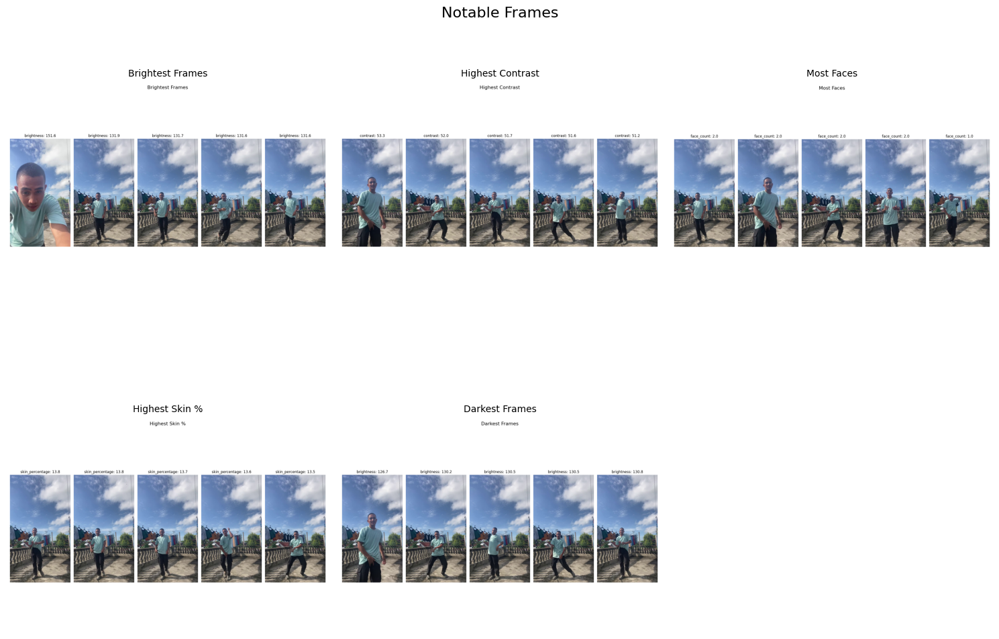


=== Sample Frame Visualizations ===


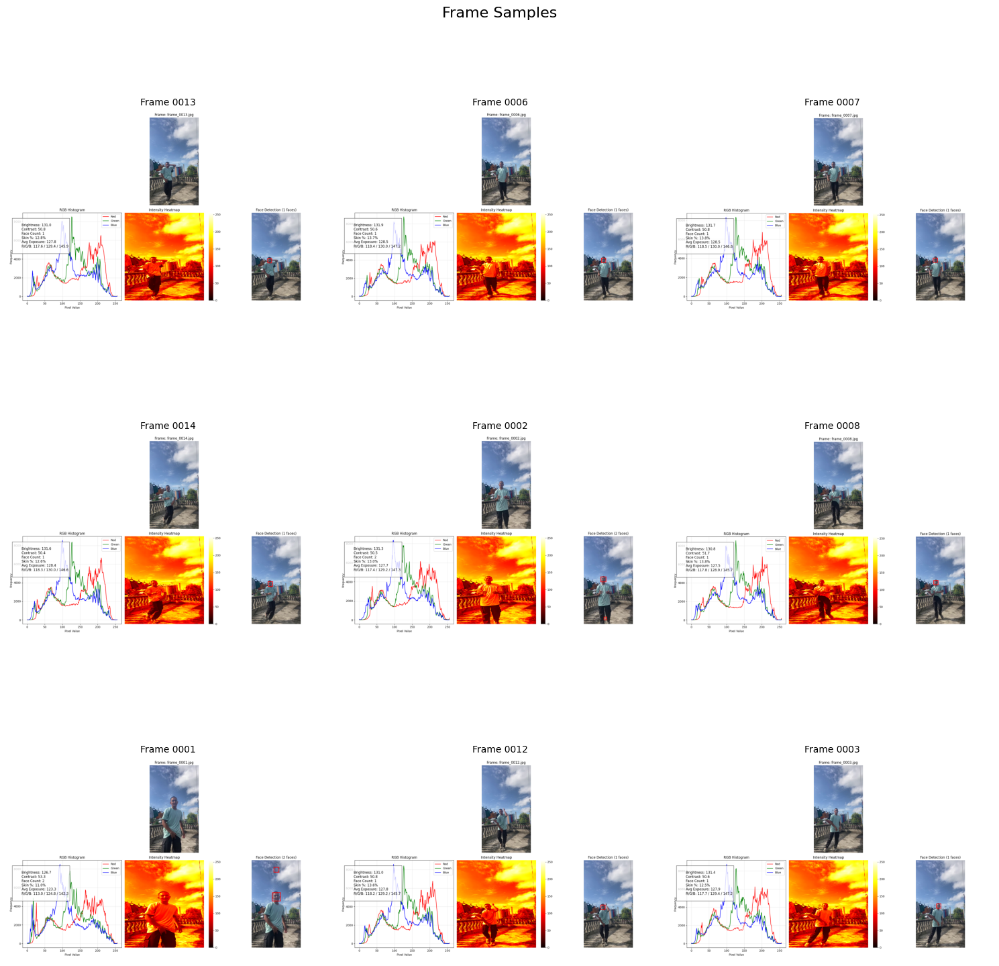


Displayed visualizations from /kaggle/working/video1_frame_visualizations


In [27]:
import os
import matplotlib.pyplot as plt
from matplotlib.image import imread
import numpy as np
from IPython.display import display
import math

def display_visualizations(visualization_dir):
    """
    Display all visualization images in the specified directory using matplotlib
    
    Parameters:
    - visualization_dir: Path to directory containing visualizations
    """
    # Check if directory exists
    if not os.path.exists(visualization_dir):
        print(f"Error: Directory not found at {visualization_dir}")
        return
    
    # Get all image files in the directory
    image_files = []
    for file in os.listdir(visualization_dir):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_files.append(os.path.join(visualization_dir, file))
    
    if not image_files:
        print(f"No image files found in {visualization_dir}")
        return
    
    print(f"Found {len(image_files)} visualization images in {visualization_dir}")
    
    # Categorize images
    notable_images = [f for f in image_files if "notable_" in os.path.basename(f).lower()]
    frame_images = [f for f in image_files if "viz_frame" in os.path.basename(f).lower()]
    other_images = [f for f in image_files if f not in notable_images and f not in frame_images]
    
    # Display notable frames (these are usually the most interesting)
    if notable_images:
        print("\n=== Notable Frames ===")
        display_image_set(notable_images, "Notable Frames")
    
    # Display a subset of regular frame visualizations
    if frame_images:
        print("\n=== Sample Frame Visualizations ===")
        # If too many frames, select a representative sample
        if len(frame_images) > 9:
            # Choose evenly spaced frames
            step = len(frame_images) // 9
            sample_frames = frame_images[::step][:9]
        else:
            sample_frames = frame_images
            
        display_image_set(sample_frames, "Frame Samples", cols=3)
    
    # Display other visualizations
    if other_images:
        print("\n=== Other Visualizations ===")
        display_image_set(other_images, "Other Visualizations")
    
    print(f"\nDisplayed visualizations from {visualization_dir}")

def display_image_set(image_paths, title, cols=3):
    """Display a set of images in a grid using matplotlib"""
    rows = math.ceil(len(image_paths) / cols)
    
    # For too many images, split into multiple figures
    max_per_figure = 9  # 3x3 grid max
    
    for i in range(0, len(image_paths), max_per_figure):
        batch = image_paths[i:i + max_per_figure]
        batch_rows = math.ceil(len(batch) / cols)
        
        fig = plt.figure(figsize=(15, batch_rows * 5))
        
        for j, img_path in enumerate(batch):
            try:
                # Load image
                img = imread(img_path)
                
                # Create subplot
                ax = fig.add_subplot(batch_rows, cols, j+1)
                ax.imshow(img)
                
                # Extract and display filename
                filename = os.path.basename(img_path)
                # Clean up filename for display
                display_name = (filename.replace('notable_', '')
                               .replace('viz_', '')
                               .replace('.png', '')
                               .replace('_', ' ')
                               .title())
                
                ax.set_title(display_name, fontsize=10)
                ax.axis('off')
                
            except Exception as e:
                print(f"Error displaying {img_path}: {e}")
        
        batch_title = f"{title} (Batch {i//max_per_figure + 1})" if len(image_paths) > max_per_figure else title
        plt.suptitle(batch_title, fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.9, hspace=0.3)
        plt.show()

def display_image_details(image_path):
    """Display a single image with its details"""
    try:
        img = imread(image_path)
        filename = os.path.basename(image_path)
        clean_name = (filename.replace('notable_', '')
                     .replace('viz_', '')
                     .replace('.png', '')
                     .replace('_', ' ')
                     .title())
        
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(clean_name, fontsize=14)
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error displaying {image_path}: {e}")

# Example usage for a single directory:
visualization_dir = '/kaggle/working/video1_frame_visualizations'
display_visualizations(visualization_dir)

# # If you want to display all three video visualizations one after another:
# print("\n" + "="*50)
# print("VISUALIZATIONS FOR ALL THREE VIDEOS")
# print("="*50 + "\n")

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video1_frame_visualizations'
#     if os.path.exists(viz_dir):
#         print(f"\n\nVIDEO 1 VISUALIZATIONS:")
#         print("="*30)
#         display_visualizations(viz_dir)
#     else:
#         print(f"\nVisualization directory for Video 1 not found at {viz_dir}")

# # Option to display a single notable frame in more detail:
# print("\n\nDETAILED VIEWS OF MOST INTERESTING FRAMES:")
# print("="*40)

# # Look for the most interesting frames in each video's visualizations
# interesting_types = ['notable_most_faces', 'notable_highest_contrast', 'notable_brightest_frames']

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video1_frame_visualizations'
#     if not os.path.exists(viz_dir):
#         continue
        
#     print(f"\nNotable frames from Video 1:")
#     for frame_type in interesting_types:
#         for file in os.listdir(viz_dir):
#             if frame_type in file.lower():
#                 file_path = os.path.join(viz_dir, file)
#                 print(f"Displaying: {file}")
#                 display_image_details(file_path)
#                 break

Found 23 visualization images in /kaggle/working/video2_frame_visualizations

=== Notable Frames ===


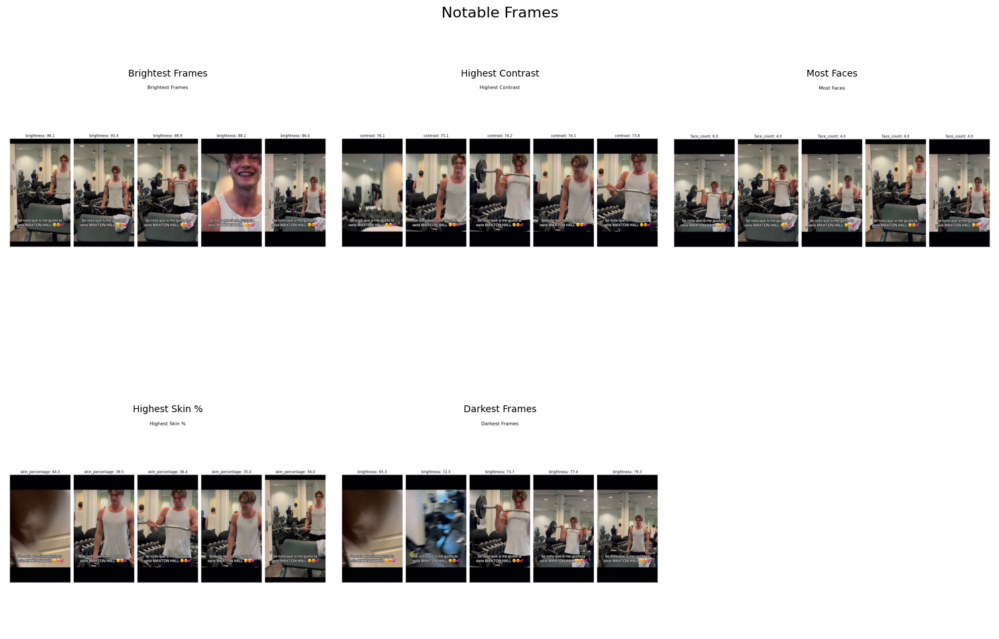


=== Sample Frame Visualizations ===


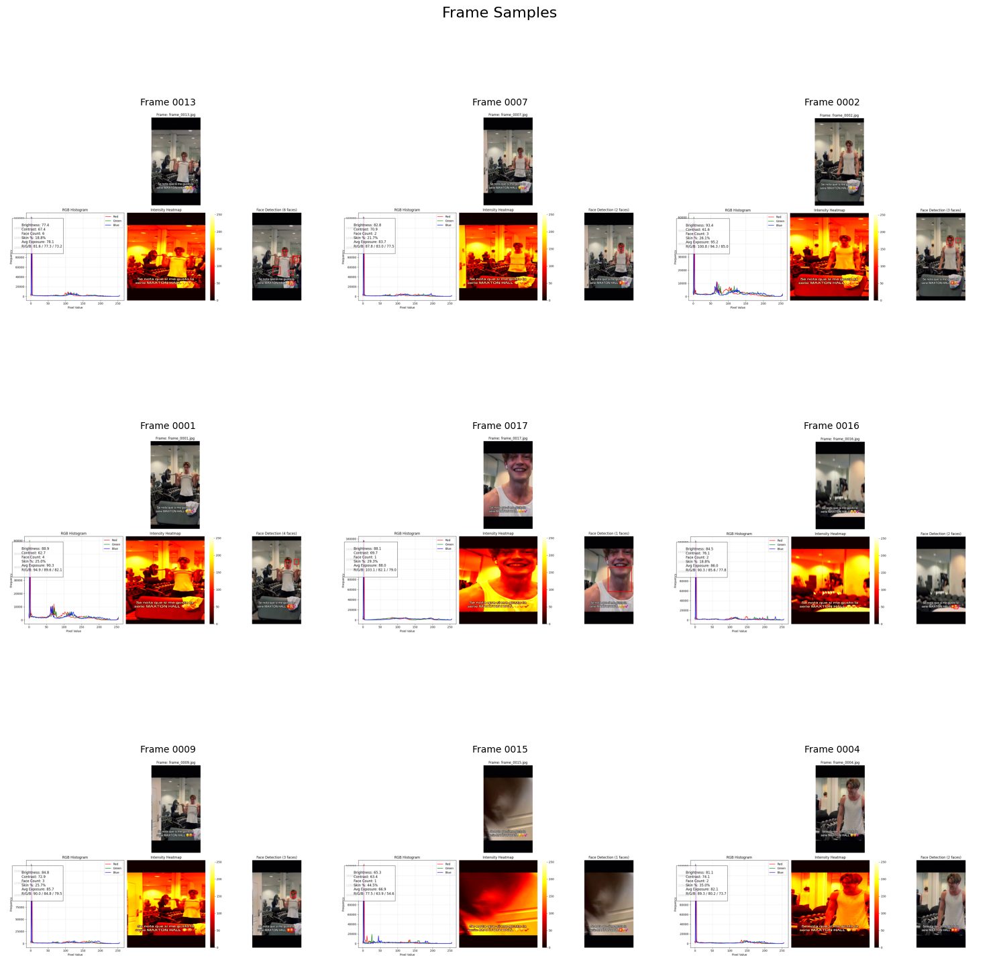


Displayed visualizations from /kaggle/working/video2_frame_visualizations


In [28]:
import os
import matplotlib.pyplot as plt
from matplotlib.image import imread
import numpy as np
from IPython.display import display
import math

def display_visualizations(visualization_dir):
    """
    Display all visualization images in the specified directory using matplotlib
    
    Parameters:
    - visualization_dir: Path to directory containing visualizations
    """
    # Check if directory exists
    if not os.path.exists(visualization_dir):
        print(f"Error: Directory not found at {visualization_dir}")
        return
    
    # Get all image files in the directory
    image_files = []
    for file in os.listdir(visualization_dir):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_files.append(os.path.join(visualization_dir, file))
    
    if not image_files:
        print(f"No image files found in {visualization_dir}")
        return
    
    print(f"Found {len(image_files)} visualization images in {visualization_dir}")
    
    # Categorize images
    notable_images = [f for f in image_files if "notable_" in os.path.basename(f).lower()]
    frame_images = [f for f in image_files if "viz_frame" in os.path.basename(f).lower()]
    other_images = [f for f in image_files if f not in notable_images and f not in frame_images]
    
    # Display notable frames (these are usually the most interesting)
    if notable_images:
        print("\n=== Notable Frames ===")
        display_image_set(notable_images, "Notable Frames")
    
    # Display a subset of regular frame visualizations
    if frame_images:
        print("\n=== Sample Frame Visualizations ===")
        # If too many frames, select a representative sample
        if len(frame_images) > 9:
            # Choose evenly spaced frames
            step = len(frame_images) // 9
            sample_frames = frame_images[::step][:9]
        else:
            sample_frames = frame_images
            
        display_image_set(sample_frames, "Frame Samples", cols=3)
    
    # Display other visualizations
    if other_images:
        print("\n=== Other Visualizations ===")
        display_image_set(other_images, "Other Visualizations")
    
    print(f"\nDisplayed visualizations from {visualization_dir}")

def display_image_set(image_paths, title, cols=3):
    """Display a set of images in a grid using matplotlib"""
    rows = math.ceil(len(image_paths) / cols)
    
    # For too many images, split into multiple figures
    max_per_figure = 9  # 3x3 grid max
    
    for i in range(0, len(image_paths), max_per_figure):
        batch = image_paths[i:i + max_per_figure]
        batch_rows = math.ceil(len(batch) / cols)
        
        fig = plt.figure(figsize=(15, batch_rows * 5))
        
        for j, img_path in enumerate(batch):
            try:
                # Load image
                img = imread(img_path)
                
                # Create subplot
                ax = fig.add_subplot(batch_rows, cols, j+1)
                ax.imshow(img)
                
                # Extract and display filename
                filename = os.path.basename(img_path)
                # Clean up filename for display
                display_name = (filename.replace('notable_', '')
                               .replace('viz_', '')
                               .replace('.png', '')
                               .replace('_', ' ')
                               .title())
                
                ax.set_title(display_name, fontsize=10)
                ax.axis('off')
                
            except Exception as e:
                print(f"Error displaying {img_path}: {e}")
        
        batch_title = f"{title} (Batch {i//max_per_figure + 1})" if len(image_paths) > max_per_figure else title
        plt.suptitle(batch_title, fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.9, hspace=0.3)
        plt.show()

def display_image_details(image_path):
    """Display a single image with its details"""
    try:
        img = imread(image_path)
        filename = os.path.basename(image_path)
        clean_name = (filename.replace('notable_', '')
                     .replace('viz_', '')
                     .replace('.png', '')
                     .replace('_', ' ')
                     .title())
        
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(clean_name, fontsize=14)
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error displaying {image_path}: {e}")

# Example usage for a single directory:
visualization_dir = '/kaggle/working/video2_frame_visualizations'
display_visualizations(visualization_dir)

# # If you want to display all three video visualizations one after another:
# print("\n" + "="*50)
# print("VISUALIZATIONS FOR ALL THREE VIDEOS")
# print("="*50 + "\n")

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video2_frame_visualizations'
#     if os.path.exists(viz_dir):
#         print(f"\n\nVIDEO 2 VISUALIZATIONS:")
#         print("="*30)
#         display_visualizations(viz_dir)
#     else:
#         print(f"\nVisualization directory for Video 2 not found at {viz_dir}")

# # Option to display a single notable frame in more detail:
# print("\n\nDETAILED VIEWS OF MOST INTERESTING FRAMES:")
# print("="*40)

# # Look for the most interesting frames in each video's visualizations
# interesting_types = ['notable_most_faces', 'notable_highest_contrast', 'notable_brightest_frames']

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video2_frame_visualizations'
#     if not os.path.exists(viz_dir):
#         continue
        
#     print(f"\nNotable frames from Video 2:")
#     for frame_type in interesting_types:
#         for file in os.listdir(viz_dir):
#             if frame_type in file.lower():
#                 file_path = os.path.join(viz_dir, file)
#                 print(f"Displaying: {file}")
#                 display_image_details(file_path)
#                 break

Found 20 visualization images in /kaggle/working/video1_frame_visualizations

=== Notable Frames ===


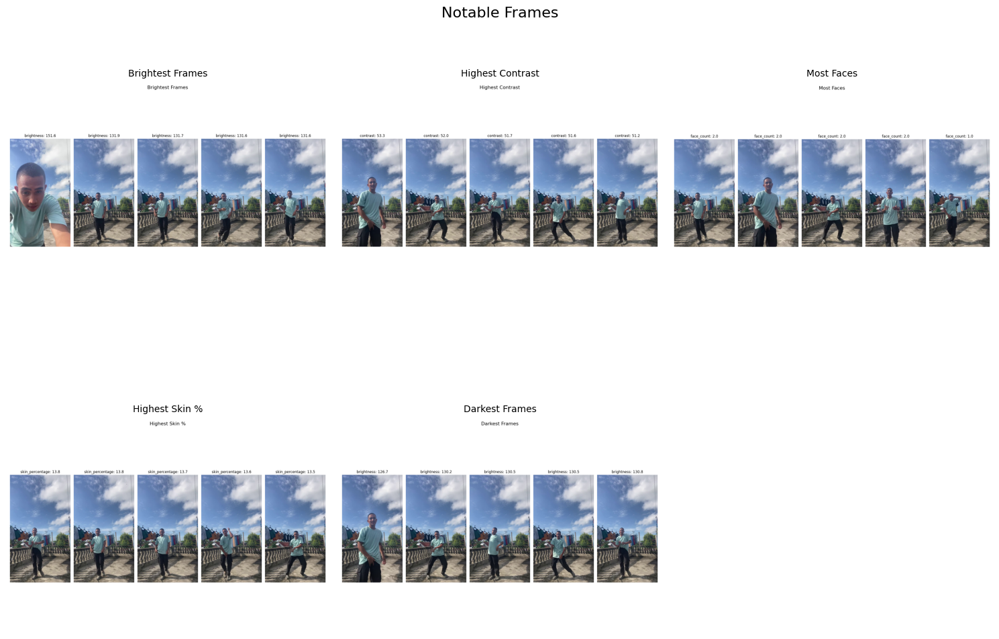


=== Sample Frame Visualizations ===


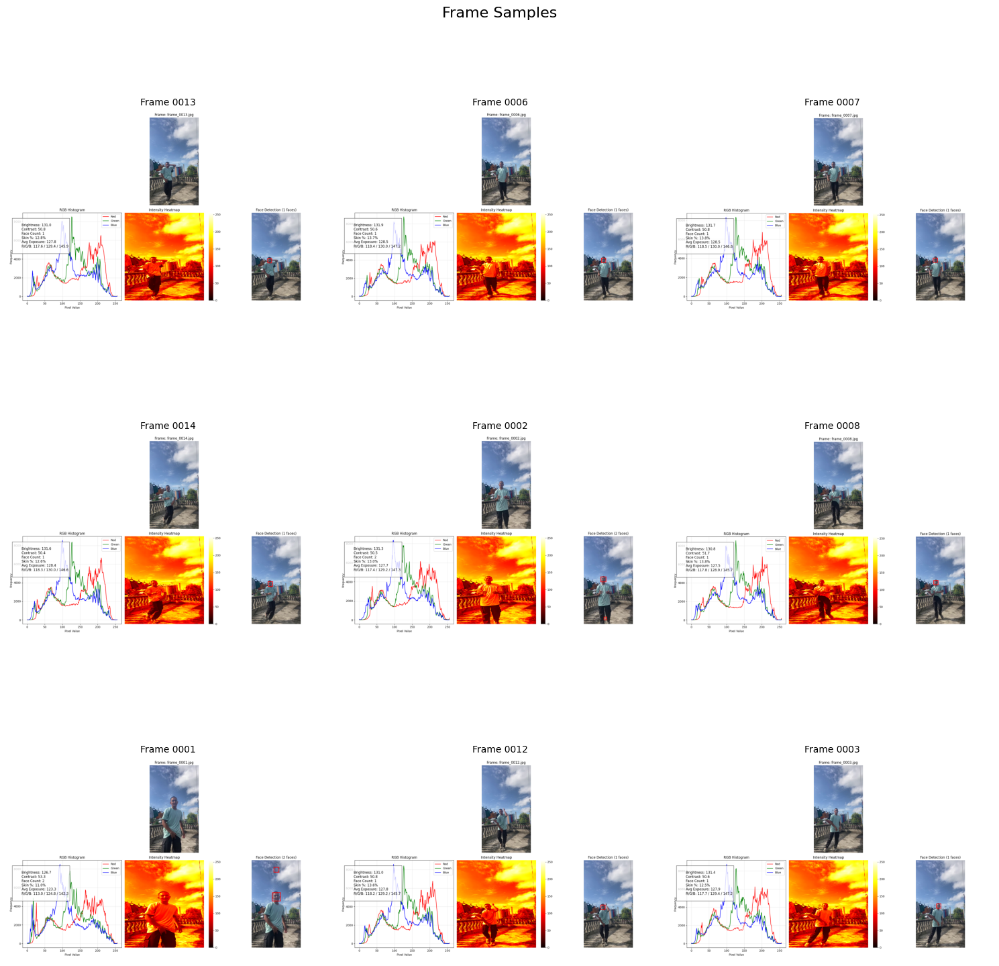


Displayed visualizations from /kaggle/working/video1_frame_visualizations


In [29]:
import os
import matplotlib.pyplot as plt
from matplotlib.image import imread
import numpy as np
from IPython.display import display
import math

def display_visualizations(visualization_dir):
    """
    Display all visualization images in the specified directory using matplotlib
    
    Parameters:
    - visualization_dir: Path to directory containing visualizations
    """
    # Check if directory exists
    if not os.path.exists(visualization_dir):
        print(f"Error: Directory not found at {visualization_dir}")
        return
    
    # Get all image files in the directory
    image_files = []
    for file in os.listdir(visualization_dir):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_files.append(os.path.join(visualization_dir, file))
    
    if not image_files:
        print(f"No image files found in {visualization_dir}")
        return
    
    print(f"Found {len(image_files)} visualization images in {visualization_dir}")
    
    # Categorize images
    notable_images = [f for f in image_files if "notable_" in os.path.basename(f).lower()]
    frame_images = [f for f in image_files if "viz_frame" in os.path.basename(f).lower()]
    other_images = [f for f in image_files if f not in notable_images and f not in frame_images]
    
    # Display notable frames (these are usually the most interesting)
    if notable_images:
        print("\n=== Notable Frames ===")
        display_image_set(notable_images, "Notable Frames")
    
    # Display a subset of regular frame visualizations
    if frame_images:
        print("\n=== Sample Frame Visualizations ===")
        # If too many frames, select a representative sample
        if len(frame_images) > 9:
            # Choose evenly spaced frames
            step = len(frame_images) // 9
            sample_frames = frame_images[::step][:9]
        else:
            sample_frames = frame_images
            
        display_image_set(sample_frames, "Frame Samples", cols=3)
    
    # Display other visualizations
    if other_images:
        print("\n=== Other Visualizations ===")
        display_image_set(other_images, "Other Visualizations")
    
    print(f"\nDisplayed visualizations from {visualization_dir}")

def display_image_set(image_paths, title, cols=3):
    """Display a set of images in a grid using matplotlib"""
    rows = math.ceil(len(image_paths) / cols)
    
    # For too many images, split into multiple figures
    max_per_figure = 9  # 3x3 grid max
    
    for i in range(0, len(image_paths), max_per_figure):
        batch = image_paths[i:i + max_per_figure]
        batch_rows = math.ceil(len(batch) / cols)
        
        fig = plt.figure(figsize=(15, batch_rows * 5))
        
        for j, img_path in enumerate(batch):
            try:
                # Load image
                img = imread(img_path)
                
                # Create subplot
                ax = fig.add_subplot(batch_rows, cols, j+1)
                ax.imshow(img)
                
                # Extract and display filename
                filename = os.path.basename(img_path)
                # Clean up filename for display
                display_name = (filename.replace('notable_', '')
                               .replace('viz_', '')
                               .replace('.png', '')
                               .replace('_', ' ')
                               .title())
                
                ax.set_title(display_name, fontsize=10)
                ax.axis('off')
                
            except Exception as e:
                print(f"Error displaying {img_path}: {e}")
        
        batch_title = f"{title} (Batch {i//max_per_figure + 1})" if len(image_paths) > max_per_figure else title
        plt.suptitle(batch_title, fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.9, hspace=0.3)
        plt.show()

def display_image_details(image_path):
    """Display a single image with its details"""
    try:
        img = imread(image_path)
        filename = os.path.basename(image_path)
        clean_name = (filename.replace('notable_', '')
                     .replace('viz_', '')
                     .replace('.png', '')
                     .replace('_', ' ')
                     .title())
        
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(clean_name, fontsize=14)
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error displaying {image_path}: {e}")

# Example usage for a single directory:
visualization_dir = '/kaggle/working/video1_frame_visualizations'
display_visualizations(visualization_dir)

# # If you want to display all three video visualizations one after another:
# print("\n" + "="*50)
# print("VISUALIZATIONS FOR ALL THREE VIDEOS")
# print("="*50 + "\n")

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video{video_num}_frame_visualizations'
#     if os.path.exists(viz_dir):
#         print(f"\n\nVIDEO {video_num} VISUALIZATIONS:")
#         print("="*30)
#         display_visualizations(viz_dir)
#     else:
#         print(f"\nVisualization directory for Video {video_num} not found at {viz_dir}")

# # Option to display a single notable frame in more detail:
# print("\n\nDETAILED VIEWS OF MOST INTERESTING FRAMES:")
# print("="*40)

# # Look for the most interesting frames in each video's visualizations
# interesting_types = ['notable_most_faces', 'notable_highest_contrast', 'notable_brightest_frames']

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video3_frame_visualizations'
#     if not os.path.exists(viz_dir):
#         continue
        
#     print(f"\nNotable frames from Video {video_num}:")
#     for frame_type in interesting_types:
#         for file in os.listdir(viz_dir):
#             if frame_type in file.lower():
#                 file_path = os.path.join(viz_dir, file)
#                 print(f"Displaying: {file}")
#                 display_image_details(file_path)
    #                 break

Found 25 visualization images in /kaggle/working/video3_frame_visualizations

=== Notable Frames ===


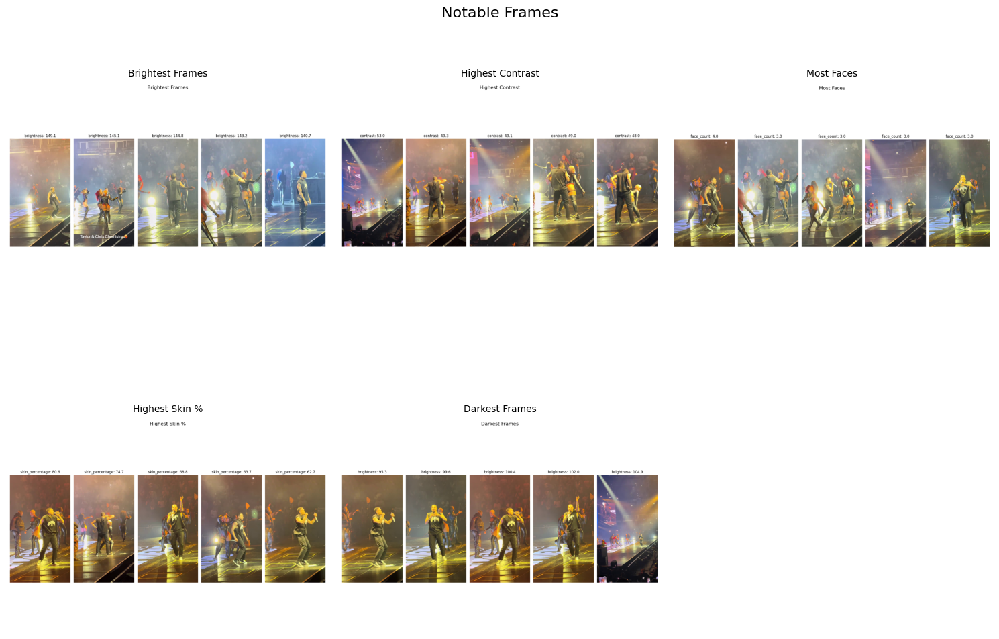


=== Sample Frame Visualizations ===


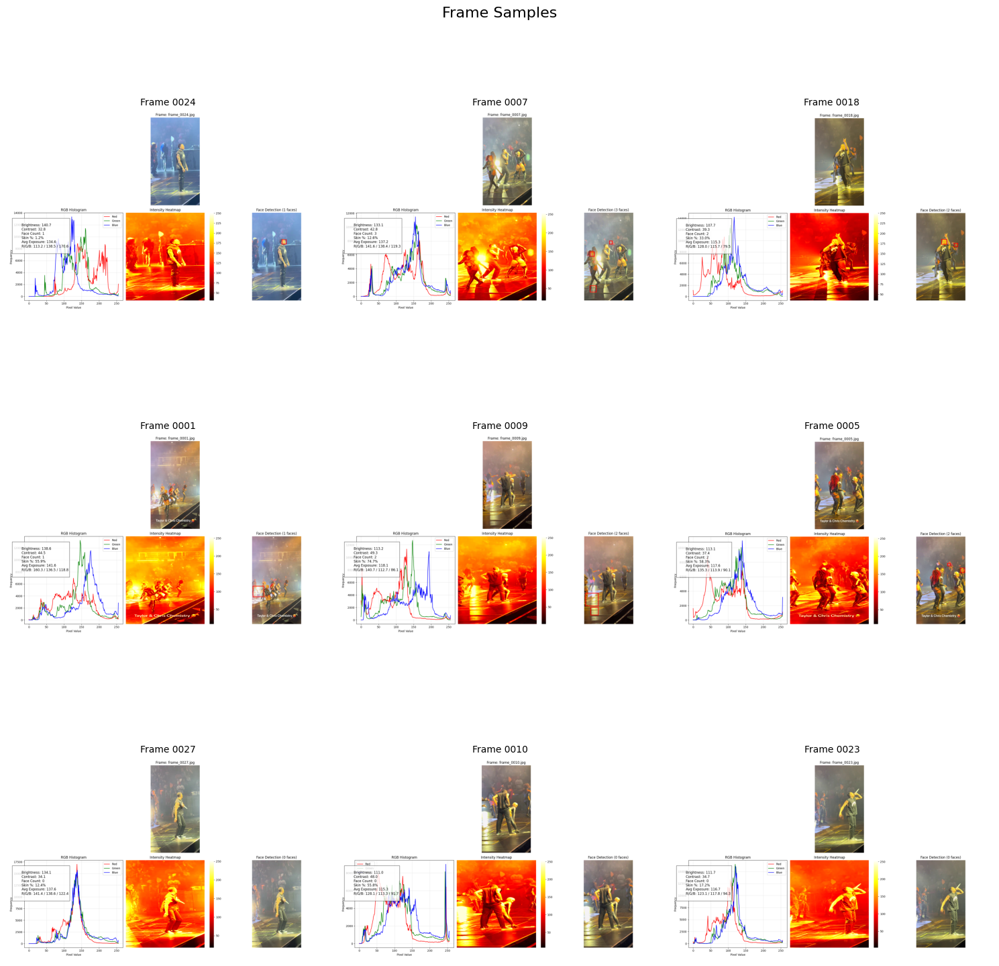


Displayed visualizations from /kaggle/working/video3_frame_visualizations


In [30]:
import os
import matplotlib.pyplot as plt
from matplotlib.image import imread
import numpy as np
from IPython.display import display
import math

def display_visualizations(visualization_dir):
    """
    Display all visualization images in the specified directory using matplotlib
    
    Parameters:
    - visualization_dir: Path to directory containing visualizations
    """
    # Check if directory exists
    if not os.path.exists(visualization_dir):
        print(f"Error: Directory not found at {visualization_dir}")
        return
    
    # Get all image files in the directory
    image_files = []
    for file in os.listdir(visualization_dir):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_files.append(os.path.join(visualization_dir, file))
    
    if not image_files:
        print(f"No image files found in {visualization_dir}")
        return
    
    print(f"Found {len(image_files)} visualization images in {visualization_dir}")
    
    # Categorize images
    notable_images = [f for f in image_files if "notable_" in os.path.basename(f).lower()]
    frame_images = [f for f in image_files if "viz_frame" in os.path.basename(f).lower()]
    other_images = [f for f in image_files if f not in notable_images and f not in frame_images]
    
    # Display notable frames (these are usually the most interesting)
    if notable_images:
        print("\n=== Notable Frames ===")
        display_image_set(notable_images, "Notable Frames")
    
    # Display a subset of regular frame visualizations
    if frame_images:
        print("\n=== Sample Frame Visualizations ===")
        # If too many frames, select a representative sample
        if len(frame_images) > 9:
            # Choose evenly spaced frames
            step = len(frame_images) // 9
            sample_frames = frame_images[::step][:9]
        else:
            sample_frames = frame_images
            
        display_image_set(sample_frames, "Frame Samples", cols=3)
    
    # Display other visualizations
    if other_images:
        print("\n=== Other Visualizations ===")
        display_image_set(other_images, "Other Visualizations")
    
    print(f"\nDisplayed visualizations from {visualization_dir}")

def display_image_set(image_paths, title, cols=3):
    """Display a set of images in a grid using matplotlib"""
    rows = math.ceil(len(image_paths) / cols)
    
    # For too many images, split into multiple figures
    max_per_figure = 9  # 3x3 grid max
    
    for i in range(0, len(image_paths), max_per_figure):
        batch = image_paths[i:i + max_per_figure]
        batch_rows = math.ceil(len(batch) / cols)
        
        fig = plt.figure(figsize=(15, batch_rows * 5))
        
        for j, img_path in enumerate(batch):
            try:
                # Load image
                img = imread(img_path)
                
                # Create subplot
                ax = fig.add_subplot(batch_rows, cols, j+1)
                ax.imshow(img)
                
                # Extract and display filename
                filename = os.path.basename(img_path)
                # Clean up filename for display
                display_name = (filename.replace('notable_', '')
                               .replace('viz_', '')
                               .replace('.png', '')
                               .replace('_', ' ')
                               .title())
                
                ax.set_title(display_name, fontsize=10)
                ax.axis('off')
                
            except Exception as e:
                print(f"Error displaying {img_path}: {e}")
        
        batch_title = f"{title} (Batch {i//max_per_figure + 1})" if len(image_paths) > max_per_figure else title
        plt.suptitle(batch_title, fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.9, hspace=0.3)
        plt.show()

def display_image_details(image_path):
    """Display a single image with its details"""
    try:
        img = imread(image_path)
        filename = os.path.basename(image_path)
        clean_name = (filename.replace('notable_', '')
                     .replace('viz_', '')
                     .replace('.png', '')
                     .replace('_', ' ')
                     .title())
        
        plt.figure(figsize=(10, 8))
        plt.imshow(img)
        plt.title(clean_name, fontsize=14)
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error displaying {image_path}: {e}")

# Example usage for a single directory:
visualization_dir = '/kaggle/working/video3_frame_visualizations'
display_visualizations(visualization_dir)

# # If you want to display all three video visualizations one after another:
# print("\n" + "="*50)
# print("VISUALIZATIONS FOR ALL THREE VIDEOS")
# print("="*50 + "\n")

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video3_frame_visualizations'
#     if os.path.exists(viz_dir):
#         print(f"\n\nVIDEO 3 VISUALIZATIONS:")
#         print("="*30)
#         display_visualizations(viz_dir)
#     else:
#         print(f"\nVisualization directory for Video 3 not found at {viz_dir}")

# # Option to display a single notable frame in more detail:
# print("\n\nDETAILED VIEWS OF MOST INTERESTING FRAMES:")
# print("="*40)

# # Look for the most interesting frames in each video's visualizations
# interesting_types = ['notable_most_faces', 'notable_highest_contrast', 'notable_brightest_frames']

# for video_num in [1, 2, 3]:
#     viz_dir = f'/kaggle/working/video3_frame_visualizations'
#     if not os.path.exists(viz_dir):
#         continue
        
#     print(f"\nNotable frames from Video 3:")
#     for frame_type in interesting_types:
#         for file in os.listdir(viz_dir):
#             if frame_type in file.lower():
#                 file_path = os.path.join(viz_dir, file)
#                 print(f"Displaying: {file}")
#                 display_image_details(file_path)
#                 break

In [31]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from matplotlib.colors import LinearSegmentedColormap
from datetime import datetime
import math

class SkinAnalyzer:
    def __init__(self, frames_dir, output_dir):
        """
        Initialize the skin analyzer with paths
        
        Parameters:
        - frames_dir: Directory containing the video frames
        - output_dir: Directory to save analysis results
        """
        self.frames_dir = frames_dir
        self.output_dir = output_dir
        self.results = []
        self.frames = []
        self.skin_masks = []
        self.metadata = {
            "analysis_time": datetime.now().strftime("%Y-%m-%d %H:%M:%S"),
            "user": "6eama",
            "frames_count": 0
        }
        
        # Ensure output directory exists
        os.makedirs(output_dir, exist_ok=True)
    
    def load_frames(self, max_frames=None):
        """Load frames from the directory"""
        print(f"Loading frames from {self.frames_dir}...")
        
        # Get all image files in the directory
        image_files = []
        for file in os.listdir(self.frames_dir):
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_files.append(os.path.join(self.frames_dir, file))
        
        image_files.sort()  # Sort to maintain frame order
        
        if max_frames and len(image_files) > max_frames:
            # Take evenly spaced frames
            step = len(image_files) / max_frames
            indices = [int(i * step) for i in range(max_frames)]
            image_files = [image_files[i] for i in indices]
        
        self.metadata["frames_count"] = len(image_files)
        print(f"Found {len(image_files)} frames")
        
        # Load each frame
        for img_path in tqdm(image_files, desc="Loading frames"):
            try:
                img = cv2.imread(img_path)
                if img is None:
                    continue
                    
                self.frames.append({
                    'path': img_path,
                    'filename': os.path.basename(img_path),
                    'image': img
                })
            except Exception as e:
                print(f"Error loading {img_path}: {e}")
        
        print(f"Successfully loaded {len(self.frames)} frames")
    
    def detect_skin(self, enhance_detection=True):
        """
        Detect skin in all loaded frames using multiple methods
        
        Parameters:
        - enhance_detection: Use enhanced detection with multiple color spaces
        """
        print("Detecting skin in frames...")
        
        for frame_data in tqdm(self.frames, desc="Detecting skin"):
            img = frame_data['image']
            result = {
                'filename': frame_data['filename'],
                'path': frame_data['path'],
                'frame_size': img.shape[:2],  # (height, width)
                'skin_percentage': 0,
                'skin_regions': 0,
                'max_region_size': 0,
                'skin_distribution': {
                    'top': 0,
                    'middle': 0,
                    'bottom': 0
                }
            }
            
            # Convert to different color spaces for skin detection
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
            img_ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
            
            # Basic HSV skin detection
            lower_hsv = np.array([0, 20, 70])
            upper_hsv = np.array([20, 255, 255])
            mask_hsv = cv2.inRange(img_hsv, lower_hsv, upper_hsv)
            
            # YCrCb skin detection (often better for diverse skin tones)
            lower_ycrcb = np.array([0, 133, 77])
            upper_ycrcb = np.array([255, 173, 127])
            mask_ycrcb = cv2.inRange(img_ycrcb, lower_ycrcb, upper_ycrcb)
            
            if enhance_detection:
                # Combine multiple detection methods
                mask1 = mask_hsv
                mask2 = mask_ycrcb
                
                # RGB-based rules for additional skin detection
                mask3 = np.zeros(img.shape[:2], dtype=np.uint8)
                r, g, b = cv2.split(img_rgb)
                mask3[np.logical_and(
                    np.logical_and(r > 95, g > 40),
                    np.logical_and(b > 20, np.maximum(r, np.maximum(g, b)) - np.minimum(r, np.minimum(g, b)) > 15)
                )] = 255
                
                # Combine masks
                skin_mask = cv2.bitwise_or(cv2.bitwise_or(mask1, mask2), mask3)
                
                # Cleanup with morphological operations
                kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
                skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_CLOSE, kernel)
                skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_OPEN, kernel)
            else:
                skin_mask = mask_hsv
            
            # Store the mask
            frame_data['skin_mask'] = skin_mask
            self.skin_masks.append(skin_mask)
            
            # Calculate skin percentage
            skin_pixel_count = np.sum(skin_mask > 0)
            total_pixel_count = skin_mask.shape[0] * skin_mask.shape[1]
            skin_percentage = (skin_pixel_count / total_pixel_count) * 100
            result['skin_percentage'] = skin_percentage
            
            # Calculate regional distribution of skin
            height, width = skin_mask.shape
            third_height = height // 3
            
            top_mask = skin_mask[:third_height, :]
            middle_mask = skin_mask[third_height:2*third_height, :]
            bottom_mask = skin_mask[2*third_height:, :]
            
            result['skin_distribution']['top'] = (np.sum(top_mask > 0) / (width * third_height)) * 100
            result['skin_distribution']['middle'] = (np.sum(middle_mask > 0) / (width * third_height)) * 100
            result['skin_distribution']['bottom'] = (np.sum(bottom_mask > 0) / (width * third_height)) * 100
            
            # Find connected components (skin regions)
            num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(skin_mask, connectivity=8)
            # First component (0) is usually background
            if num_labels > 1:
                # Filter out very small components (likely noise)
                min_size = 50  # Minimum region size to count
                valid_regions = [i for i in range(1, num_labels) if stats[i, cv2.CC_STAT_AREA] > min_size]
                result['skin_regions'] = len(valid_regions)
                
                if valid_regions:
                    max_region_size = max([stats[i, cv2.CC_STAT_AREA] for i in valid_regions])
                    result['max_region_size'] = max_region_size
            
            self.results.append(result)
        
        print(f"Skin detection completed for {len(self.results)} frames")
    
    def create_visualizations(self):
        """Create various visualizations for skin analysis"""
        print("Creating skin analysis visualizations...")
        
        # Create skin heatmap directory
        heatmap_dir = os.path.join(self.output_dir, "skin_heatmaps")
        os.makedirs(heatmap_dir, exist_ok=True)
        
        # Process each frame to create visualizations
        for i, (frame_data, result) in enumerate(zip(self.frames, self.results)):
            if i % 5 == 0:  # Only visualize every 5th frame to reduce output
                img = frame_data['image']
                skin_mask = frame_data['skin_mask']
                filename = result['filename']
                
                # Original image and skin detection side by side
                plt.figure(figsize=(18, 10))
                
                # Original image
                plt.subplot(2, 3, 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                plt.title("Original Image")
                plt.axis('off')
                
                # Skin mask
                plt.subplot(2, 3, 2)
                plt.imshow(skin_mask, cmap='gray')
                plt.title(f"Skin Mask ({result['skin_percentage']:.1f}% coverage)")
                plt.axis('off')
                
                # Overlay mask on original
                plt.subplot(2, 3, 3)
                overlay = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
                overlay[skin_mask > 0] = [255, 192, 203]  # Pink overlay for skin
                plt.imshow(overlay)
                plt.title("Skin Overlay")
                plt.axis('off')
                
                # Skin distribution chart
                plt.subplot(2, 3, 4)
                regions = ['Top', 'Middle', 'Bottom']
                values = [result['skin_distribution']['top'],
                         result['skin_distribution']['middle'],
                         result['skin_distribution']['bottom']]
                plt.bar(regions, values, color='salmon')
                plt.ylabel('Skin Percentage')
                plt.title('Skin Distribution by Region')
                plt.ylim(0, 100)
                
                # Skin regions with color coding
                plt.subplot(2, 3, 5)
                num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(skin_mask, connectivity=8)
                # Create a colormap for visualization
                label_heatmap = np.zeros((labels.shape[0], labels.shape[1], 3), dtype=np.uint8)
                
                # Use different colors for different regions
                np.random.seed(42)  # For consistent colors
                for label in range(1, num_labels):  # Skip background (0)
                    if stats[label, cv2.CC_STAT_AREA] > 50:  # Filter small regions
                        label_heatmap[labels == label] = np.random.randint(0, 255, size=3)
                
                plt.imshow(label_heatmap)
                plt.title(f"Skin Regions: {result['skin_regions']}")
                plt.axis('off')
                
                # Heat map of skin intensity
                plt.subplot(2, 3, 6)
                # Convert to HSV to get "intensity" of skin color
                hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
                h, s, v = cv2.split(hsv)
                
                # Create a custom heatmap of skin areas only
                heatmap = np.zeros_like(h, dtype=np.float32)
                # Higher saturation and value indicate more intense skin tone
                heatmap[skin_mask > 0] = (s[skin_mask > 0] * 0.5 + v[skin_mask > 0] * 0.5) / 255.0
                
                sns.heatmap(heatmap, cmap='hot', cbar=True)
                plt.title("Skin Intensity Heatmap")
                plt.axis('off')
                
                # Save the visualization
                plt.tight_layout()
                viz_path = os.path.join(heatmap_dir, f"skin_analysis_{filename}")
                plt.savefig(viz_path)
                plt.close()
        
        # Create summary visualizations
        self._create_summary_visualizations()
    
    def _create_summary_visualizations(self):
        """Create summary visualizations of skin analysis"""
        # Extract data for plots
        skin_percentages = [result['skin_percentage'] for result in self.results]
        filenames = [result['filename'] for result in self.results]
        skin_regions = [result['skin_regions'] for result in self.results]
        
        # Order by frame number if possible
        frame_numbers = []
        for filename in filenames:
            try:
                # Extract frame number from filename (assuming format like frame_0001.jpg)
                frame_num = int(filename.split('_')[-1].split('.')[0])
                frame_numbers.append(frame_num)
            except:
                # If extraction fails, just use the index
                frame_numbers.append(len(frame_numbers))
        
        # Sort everything by frame number
        sorted_indices = sorted(range(len(frame_numbers)), key=lambda i: frame_numbers[i])
        skin_percentages = [skin_percentages[i] for i in sorted_indices]
        filenames = [filenames[i] for i in sorted_indices]
        skin_regions = [skin_regions[i] for i in sorted_indices]
        
        # 1. Skin percentage over time
        plt.figure(figsize=(12, 6))
        plt.plot(range(len(skin_percentages)), skin_percentages, marker='o', linestyle='-', alpha=0.7)
        plt.title('Skin Percentage Throughout Video')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin Percentage')
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.savefig(os.path.join(self.output_dir, "skin_percentage_timeline.png"))
        plt.close()
        
        # 2. Distribution of skin percentages
        plt.figure(figsize=(10, 6))
        sns.histplot(skin_percentages, kde=True)
        plt.title('Distribution of Skin Percentage')
        plt.xlabel('Skin Percentage')
        plt.ylabel('Frequency')
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.savefig(os.path.join(self.output_dir, "skin_percentage_distribution.png"))
        plt.close()
        
        # 3. Skin regions count over time
        plt.figure(figsize=(12, 6))
        plt.plot(range(len(skin_regions)), skin_regions, marker='o', linestyle='-', color='green', alpha=0.7)
        plt.title('Skin Regions Count Throughout Video')
        plt.xlabel('Frame Index')
        plt.ylabel('Number of Skin Regions')
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.savefig(os.path.join(self.output_dir, "skin_regions_timeline.png"))
        plt.close()
        
        # 4. Correlation between skin percentage and region count
        plt.figure(figsize=(10, 6))
        plt.scatter(skin_percentages, skin_regions, alpha=0.7)
        plt.title('Skin Percentage vs. Region Count')
        plt.xlabel('Skin Percentage')
        plt.ylabel('Number of Skin Regions')
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.savefig(os.path.join(self.output_dir, "skin_percentage_vs_regions.png"))
        plt.close()
        
        # 5. Regional distribution of skin
        top_percentages = [result['skin_distribution']['top'] for result in self.results]
        middle_percentages = [result['skin_distribution']['middle'] for result in self.results]
        bottom_percentages = [result['skin_distribution']['bottom'] for result in self.results]
        
        # Sort by frame number
        top_percentages = [top_percentages[i] for i in sorted_indices]
        middle_percentages = [middle_percentages[i] for i in sorted_indices]
        bottom_percentages = [bottom_percentages[i] for i in sorted_indices]
        
        plt.figure(figsize=(12, 6))
        frames = range(len(top_percentages))
        plt.plot(frames, top_percentages, label='Top', color='blue')
        plt.plot(frames, middle_percentages, label='Middle', color='green')
        plt.plot(frames, bottom_percentages, label='Bottom', color='red')
        plt.title('Skin Distribution by Frame Region')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin Percentage')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.savefig(os.path.join(self.output_dir, "skin_regional_distribution.png"))
        plt.close()
    
    def create_report(self):
        """Create a comprehensive report of the skin analysis"""
        print("Generating skin analysis report...")
        
        # Calculate overall statistics
        skin_percentages = [result['skin_percentage'] for result in self.results]
        skin_regions = [result['skin_regions'] for result in self.results]
        
        stats = {
            'avg_skin_percentage': np.mean(skin_percentages),
            'med_skin_percentage': np.median(skin_percentages),
            'min_skin_percentage': np.min(skin_percentages),
            'max_skin_percentage': np.max(skin_percentages),
            'std_skin_percentage': np.std(skin_percentages),
            
            'avg_skin_regions': np.mean(skin_regions),
            'med_skin_regions': np.median(skin_regions),
            'min_skin_regions': np.min(skin_regions),
            'max_skin_regions': np.max(skin_regions),
            
            'total_frames': len(self.results)
        }
        
        # Find frames with max/min skin
        max_skin_idx = np.argmax(skin_percentages)
        min_skin_idx = np.argmin(skin_percentages)
        max_skin_file = self.results[max_skin_idx]['filename']
        min_skin_file = self.results[min_skin_idx]['filename']
        
        # Skin distribution by region
        top_percentages = [result['skin_distribution']['top'] for result in self.results]
        middle_percentages = [result['skin_distribution']['middle'] for result in self.results]
        bottom_percentages = [result['skin_distribution']['bottom'] for result in self.results]
        
        region_stats = {
            'avg_top': np.mean(top_percentages),
            'avg_middle': np.mean(middle_percentages),
            'avg_bottom': np.mean(bottom_percentages),
            
            'max_top': np.max(top_percentages),
            'max_middle': np.max(middle_percentages),
            'max_bottom': np.max(bottom_percentages)
        }
        
        # Generate the report markdown
        report = f"""# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: {self.metadata['analysis_time']}
- User: {self.metadata['user']}
- Total Frames Analyzed: {stats['total_frames']}

## Skin Coverage Summary
- Average Skin Percentage: {stats['avg_skin_percentage']:.2f}%
- Median Skin Percentage: {stats['med_skin_percentage']:.2f}%
- Range: {stats['min_skin_percentage']:.2f}% - {stats['max_skin_percentage']:.2f}%
- Standard Deviation: {stats['std_skin_percentage']:.2f}%

## Skin Regions Analysis
- Average Number of Skin Regions: {stats['avg_skin_regions']:.1f}
- Maximum Regions in a Frame: {stats['max_skin_regions']}
- Minimum Regions in a Frame: {stats['min_skin_regions']}

## Regional Distribution (Average)
- Top of Frame: {region_stats['avg_top']:.2f}%
- Middle of Frame: {region_stats['avg_middle']:.2f}%
- Bottom of Frame: {region_stats['avg_bottom']:.2f}%

## Notable Frames
- Highest Skin Exposure: {max_skin_file} ({skin_percentages[max_skin_idx]:.2f}%)
- Lowest Skin Exposure: {min_skin_file} ({skin_percentages[min_skin_idx]:.2f}%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps
"""

        # Save the report
        with open(os.path.join(self.output_dir, "skin_analysis_report.md"), 'w') as f:
            f.write(report)
        
        # Save statistics as CSV
        stats_df = pd.DataFrame(stats, index=[0])
        stats_df.to_csv(os.path.join(self.output_dir, "skin_analysis_stats.csv"), index=False)
        
        # Save per-frame results
        results_df = pd.DataFrame([
            {
                'filename': r['filename'],
                'skin_percentage': r['skin_percentage'],
                'skin_regions': r['skin_regions'],
                'top_percentage': r['skin_distribution']['top'],
                'middle_percentage': r['skin_distribution']['middle'],
                'bottom_percentage': r['skin_distribution']['bottom'],
                'max_region_size': r['max_region_size']
            }
            for r in self.results
        ])
        
        results_df.to_csv(os.path.join(self.output_dir, "skin_analysis_by_frame.csv"), index=False)
        
        print(f"Skin analysis report and data saved to {self.output_dir}")
        
        return stats, results_df
    
    def run_analysis(self, max_frames=None):
        """Run the full analysis pipeline"""
        self.load_frames(max_frames)
        self.detect_skin(enhance_detection=True)
        self.create_visualizations()
        stats, results_df = self.create_report()
        return stats, results_df

def main():
    # Process each of the three videos
    videos = [
        {
            'name': 'Video 1',
            'frames_dir': '/kaggle/working/video1_frames',
            'output_dir': '/kaggle/working/video1_skin_analysis'
        },
        {
            'name': 'Video 2',
            'frames_dir': '/kaggle/working/video2_frames',
            'output_dir': '/kaggle/working/video2_skin_analysis'
        },
        {
            'name': 'Video 3',
            'frames_dir': '/kaggle/working/video3_frames',
            'output_dir': '/kaggle/working/video3_skin_analysis'
        }
    ]
    
    all_stats = {}
    
    for video in videos:
        print(f"\n\n{'='*50}")
        print(f"ANALYZING {video['name'].upper()}")
        print(f"{'='*50}\n")
        
        # Check if frames directory exists
        if not os.path.exists(video['frames_dir']):
            print(f"Frame directory not found: {video['frames_dir']}")
            continue
            
        try:
            # Create analyzer and run
            analyzer = SkinAnalyzer(video['frames_dir'], video['output_dir'])
            stats, _ = analyzer.run_analysis(max_frames=50)  # Limit to 50 frames for speed
            all_stats[video['name']] = stats
            
            print(f"{video['name']} analysis complete!")
            
        except Exception as e:
            print(f"Error processing {video['name']}: {e}")
    
    # If we have statistics for multiple videos, create a comparison
    if len(all_stats) > 1:
        create_comparison_report(all_stats)

def create_comparison_report(all_stats):
    """Create a comparison report of all videos"""
    print("\nCreating comparison report of all videos...")
    
    # Convert stats to DataFrame
    video_names = list(all_stats.keys())
    
    # Create comparison directory
    comp_dir = '/kaggle/working/skin_analysis_comparison'
    os.makedirs(comp_dir, exist_ok=True)
    
    # Create a DataFrame for comparison
    comparison_data = {}
    for video_name, stats in all_stats.items():
        comparison_data[video_name] = {
            'avg_skin_percentage': stats['avg_skin_percentage'],
            'max_skin_percentage': stats['max_skin_percentage'],
            'avg_skin_regions': stats['avg_skin_regions'],
            'total_frames': stats['total_frames']
        }
    
    comparison_df = pd.DataFrame(comparison_data)
    comparison_df.to_csv(os.path.join(comp_dir, "skin_analysis_comparison.csv"))
    
    # Create comparison visualizations
    # 1. Bar chart of average skin percentages
    plt.figure(figsize=(10, 6))
    avg_skin = [all_stats[name]['avg_skin_percentage'] for name in video_names]
    plt.bar(video_names, avg_skin, color='salmon')
    plt.title('Average Skin Percentage by Video')
    plt.ylabel('Skin Percentage (%)')
    plt.grid(True, alpha=0.3)
    plt.savefig(os.path.join(comp_dir, "avg_skin_comparison.png"))
    plt.close()
    
    # 2. Bar chart of average skin regions
    plt.figure(figsize=(10, 6))
    avg_regions = [all_stats[name]['avg_skin_regions'] for name in video_names]
    plt.bar(video_names, avg_regions, color='skyblue')
    plt.title('Average Skin Regions by Video')
    plt.ylabel('Average Number of Regions')
    plt.grid(True, alpha=0.3)
    plt.savefig(os.path.join(comp_dir, "avg_regions_comparison.png"))
    plt.close()
    
    # Generate comparison report
    report = f"""# Skin Analysis Comparison Report
Date: {datetime.now().strftime("%Y-%m-%d %H:%M:%S")}
User: 6eama

## Average Skin Percentage by Video
"""

    for video_name in video_names:
        report += f"- {video_name}: {all_stats[video_name]['avg_skin_percentage']:.2f}%\n"
    
    report += "\n## Key Observations\n"
    
    # Find video with highest/lowest skin percentage
    max_skin_video = max(video_names, key=lambda x: all_stats[x]['avg_skin_percentage'])
    min_skin_video = min(video_names, key=lambda x: all_stats[x]['avg_skin_percentage'])
    
    report += f"- Highest average skin percentage: {max_skin_video} ({all_stats[max_skin_video]['avg_skin_percentage']:.2f}%)\n"
    report += f"- Lowest average skin percentage: {min_skin_video} ({all_stats[min_skin_video]['avg_skin_percentage']:.2f}%)\n"
    
    # Find video with highest/lowest skin regions
    max_regions_video = max(video_names, key=lambda x: all_stats[x]['avg_skin_regions'])
    min_regions_video = min(video_names, key=lambda x: all_stats[x]['avg_skin_regions'])
    
    report += f"- Most skin regions on average: {max_regions_video} ({all_stats[max_regions_video]['avg_skin_regions']:.1f} regions)\n"
    report += f"- Fewest skin regions on average: {min_regions_video} ({all_stats[min_regions_video]['avg_skin_regions']:.1f} regions)\n"
    
    # Save the report
    with open(os.path.join(comp_dir, "skin_analysis_comparison_report.md"), 'w') as f:
        f.write(report)
    
    print(f"Comparison report saved to {comp_dir}")

if __name__ == "__main__":
    main()



ANALYZING VIDEO 1

Loading frames from /kaggle/working/video1_frames...
Found 15 frames


Loading frames: 100%|██████████| 15/15 [00:00<00:00, 235.86it/s]


Successfully loaded 15 frames
Detecting skin in frames...


Detecting skin: 100%|██████████| 15/15 [00:00<00:00, 79.46it/s]


Skin detection completed for 15 frames
Creating skin analysis visualizations...
Generating skin analysis report...
Skin analysis report and data saved to /kaggle/working/video1_skin_analysis
Video 1 analysis complete!


ANALYZING VIDEO 2

Loading frames from /kaggle/working/video2_frames...
Found 18 frames


Loading frames: 100%|██████████| 18/18 [00:00<00:00, 303.47it/s]


Successfully loaded 18 frames
Detecting skin in frames...


Detecting skin: 100%|██████████| 18/18 [00:00<00:00, 92.16it/s]


Skin detection completed for 18 frames
Creating skin analysis visualizations...
Generating skin analysis report...
Skin analysis report and data saved to /kaggle/working/video2_skin_analysis
Video 2 analysis complete!


ANALYZING VIDEO 3

Loading frames from /kaggle/working/video3_frames...
Found 33 frames


Loading frames: 100%|██████████| 33/33 [00:00<00:00, 256.06it/s]


Successfully loaded 33 frames
Detecting skin in frames...


Detecting skin: 100%|██████████| 33/33 [00:00<00:00, 85.62it/s]


Skin detection completed for 33 frames
Creating skin analysis visualizations...
Generating skin analysis report...
Skin analysis report and data saved to /kaggle/working/video3_skin_analysis
Video 3 analysis complete!

Creating comparison report of all videos...
Comparison report saved to /kaggle/working/skin_analysis_comparison


Loading skin analysis comparison data from: /kaggle/working/skin_analysis_comparison
Current Date and Time: 2025-03-12 11:50:16
User: 6eama

Found 2 comparison visualizations

## Avg Regions Comparison


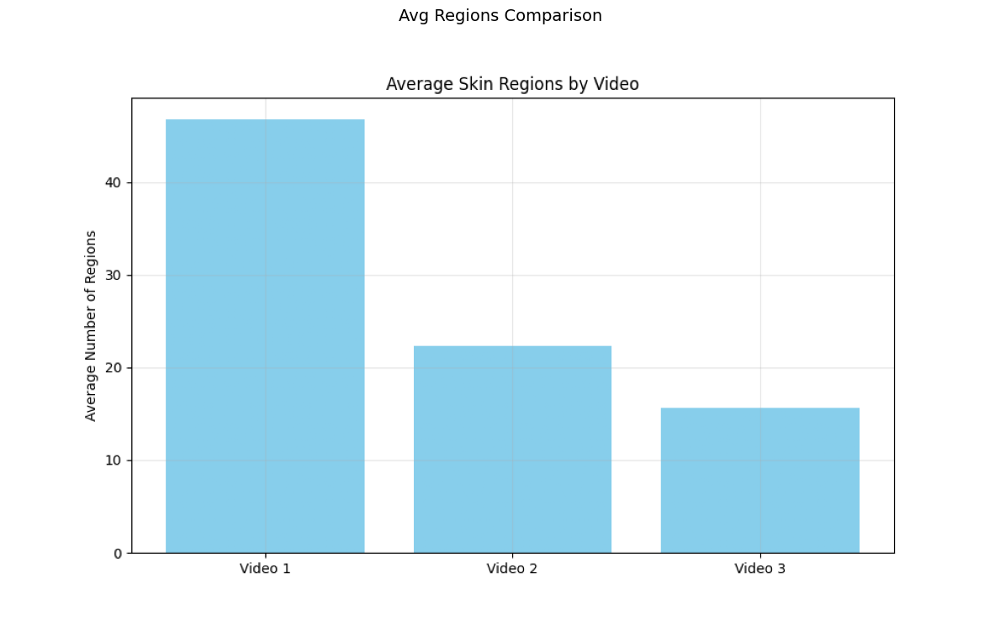


## Avg Skin Comparison


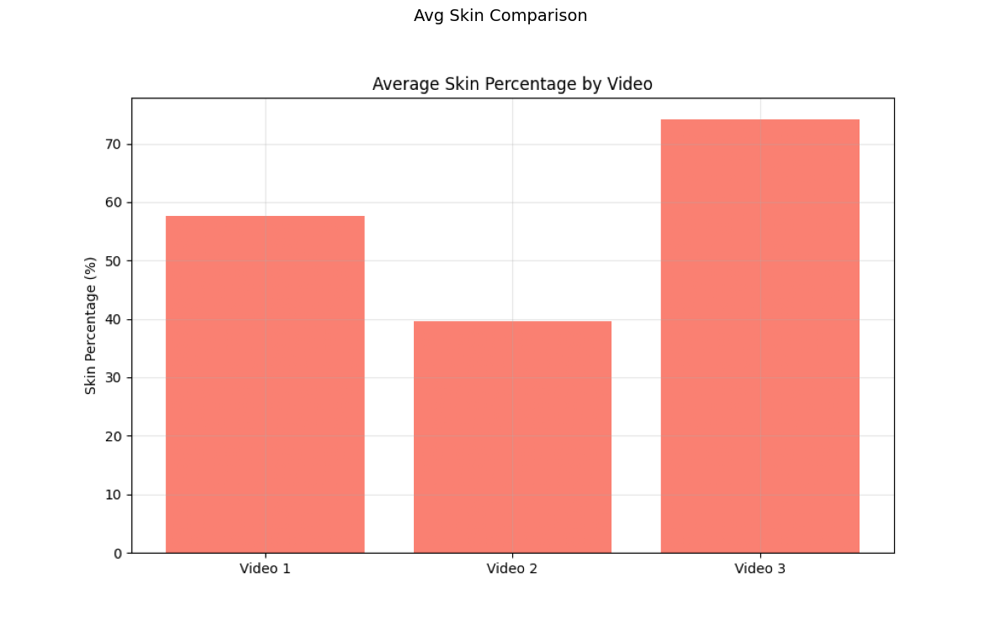


## Skin Analysis Comparison


,Unnamed: 0,Video 1,Video 2,Video 3
0,avg_skin_percentage,57.640144,39.560681,74.145169
1,max_skin_percentage,62.675646,68.715244,98.612467
2,avg_skin_regions,46.800000,22.333333,15.666667
3,total_frames,15.000000,18.000000,33.000000


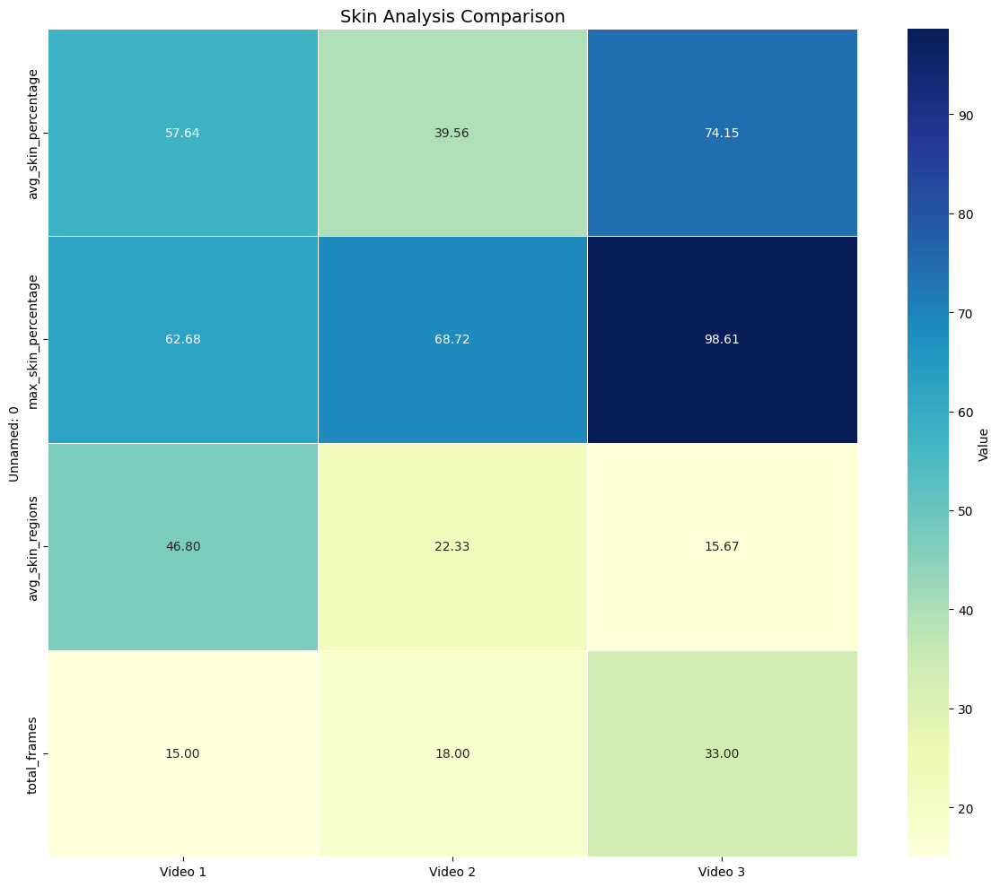


Found 1 analysis reports

REPORT: skin_analysis_comparison_report.md



# Skin Analysis Comparison Report
Date: 2025-03-12 11:50:09
User: 6eama

## Average Skin Percentage by Video
- Video 1: 57.64%
- Video 2: 39.56%
- Video 3: 74.15%

## Key Observations
- Highest average skin percentage: Video 3 (74.15%)
- Lowest average skin percentage: Video 2 (39.56%)
- Most skin regions on average: Video 1 (46.8 regions)
- Fewest skin regions on average: Video 3 (15.7 regions)


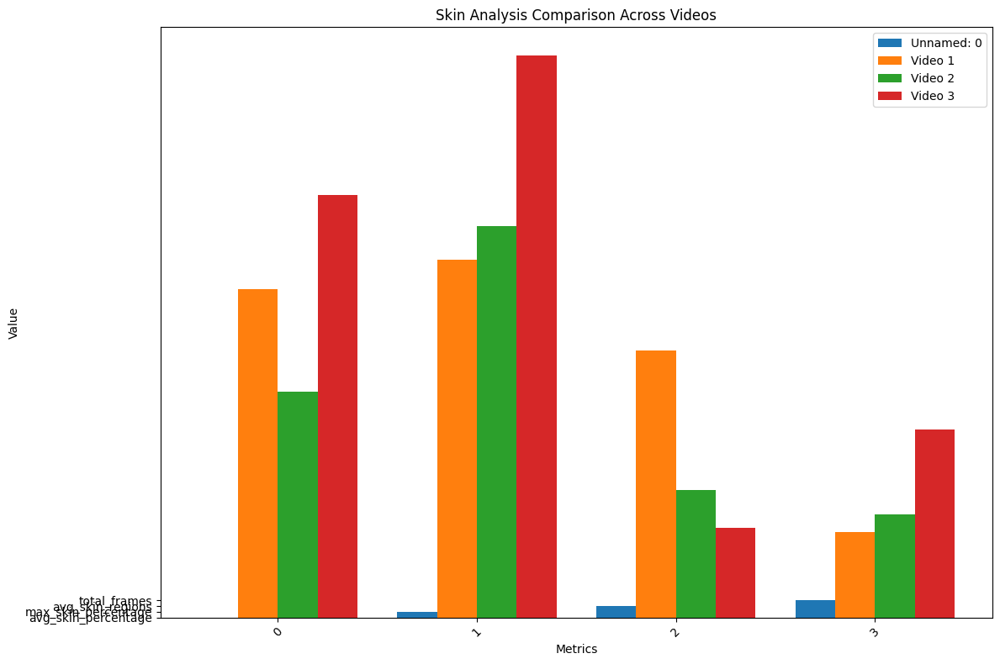

,Unnamed: 0,Video 1,Video 2,Video 3
0,avg_skin_percentage,57.640144,39.560681,74.145169
1,max_skin_percentage,62.675646,68.715244,98.612467
2,avg_skin_regions,46.800000,22.333333,15.666667
3,total_frames,15.000000,18.000000,33.000000



Skin analysis comparison visualization complete!


In [32]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, Markdown, HTML
import numpy as np
from datetime import datetime

def display_skin_analysis_comparison(comparison_dir):
    """
    Display the results of skin analysis comparison
    
    Parameters:
    - comparison_dir: Path to the skin analysis comparison directory
    """
    print(f"Loading skin analysis comparison data from: {comparison_dir}")
    print(f"Current Date and Time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"User: 6eama\n")
    
    if not os.path.exists(comparison_dir):
        print(f"Error: Directory not found at {comparison_dir}")
        return
    
    # ---- Display comparison images ----
    image_files = []
    for file in os.listdir(comparison_dir):
        if file.lower().endswith('.png'):
            image_files.append(os.path.join(comparison_dir, file))
    
    print(f"Found {len(image_files)} comparison visualizations")
    
    # Display each image
    for img_path in image_files:
        img_name = os.path.basename(img_path)
        print(f"\n## {img_name.replace('.png', '').replace('_', ' ').title()}")
        
        # Display the image
        img = plt.imread(img_path)
        plt.figure(figsize=(12, 8))
        plt.imshow(img)
        plt.axis('off')
        plt.title(img_name.replace('.png', '').replace('_', ' ').title(), fontsize=14)
        plt.tight_layout()
        plt.show()
    
    # ---- Display comparison CSV data ----
    csv_files = []
    for file in os.listdir(comparison_dir):
        if file.lower().endswith('.csv'):
            csv_files.append(os.path.join(comparison_dir, file))
    
    for csv_path in csv_files:
        csv_name = os.path.basename(csv_path)
        print(f"\n## {csv_name.replace('.csv', '').replace('_', ' ').title()}")
        
        # Read and display CSV
        try:
            df = pd.read_csv(csv_path)
            display(df)
            
            # Create a styled visualization
            if 'avg_skin_percentage' in df.columns or df.shape[1] > 1:
                # Transpose if it's a comparison table with videos as columns
                if df.shape[0] == 1:
                    df_viz = df.T
                    df_viz.columns = ['Value']
                    
                    # Create a colorful bar chart
                    plt.figure(figsize=(10, 8))
                    ax = sns.barplot(y=df_viz.index, x='Value', data=df_viz, 
                                     palette='viridis', orient='h')
                    plt.title(f"{csv_name.replace('.csv', '').replace('_', ' ').title()}", fontsize=14)
                    plt.tight_layout()
                    plt.show()
                    
                elif df.shape[1] > 1:
                    # Set index to video names if not already done
                    if 'Unnamed: 0' in df.columns:
                        df = df.set_index('Unnamed: 0')
                        
                    # Visualize as heatmap
                    plt.figure(figsize=(12, 10))
                    ax = sns.heatmap(df, annot=True, cmap='YlGnBu', fmt='.2f', 
                                   linewidths=0.5, cbar_kws={'label': 'Value'})
                    plt.title(f"{csv_name.replace('.csv', '').replace('_', ' ').title()}", fontsize=14)
                    plt.tight_layout()
                    plt.show()
        except Exception as e:
            print(f"Error displaying CSV: {e}")
    
    # ---- Display markdown reports ----
    md_files = []
    for file in os.listdir(comparison_dir):
        if file.lower().endswith('.md'):
            md_files.append(os.path.join(comparison_dir, file))
    
    print(f"\nFound {len(md_files)} analysis reports")
    
    for md_path in md_files:
        try:
            with open(md_path, 'r') as f:
                report_content = f.read()
                
            print("\n" + "="*80)
            print(f"REPORT: {os.path.basename(md_path)}")
            print("="*80 + "\n")
            
            # Display the markdown report
            display(Markdown(report_content))
        except Exception as e:
            print(f"Error displaying report {os.path.basename(md_path)}: {e}")
    
    # ---- Create an interactive HTML summary ----
    try:
        # Find the comparison CSV file
        comparison_csv = None
        for file in csv_files:
            if 'comparison' in file.lower():
                comparison_csv = file
                break
        
        if comparison_csv:
            df_comp = pd.read_csv(comparison_csv)
            
            # If dataframe has one row with videos as columns, transpose it
            if df_comp.shape[0] == 1:
                df_comp = df_comp.T
                df_comp.columns = ['Value']
                
            # Create an interactive chart
            plt.figure(figsize=(12, 8))
            
            metrics = df_comp.index
            videos = df_comp.columns
            
            # Create grouped bar chart for each metric
            if 'Value' not in df_comp.columns:
                width = 0.8 / len(videos)
                x = np.arange(len(metrics))
                
                for i, video in enumerate(videos):
                    plt.bar(x + i * width - 0.4 + width/2, 
                           df_comp[video], width, label=video)
                
                plt.xlabel('Metrics')
                plt.ylabel('Value')
                plt.title('Skin Analysis Comparison Across Videos')
                plt.xticks(x, metrics, rotation=45)
                plt.legend()
            else:
                # If it's already transposed, just make a single bar chart
                sns.barplot(y=df_comp.index, x='Value', data=df_comp, palette='viridis')
                plt.title('Skin Analysis Comparison')
            
            plt.tight_layout()
            plt.show()
            
            # Create a styled HTML table for better viewing
            styled_df = df_comp.style.background_gradient(cmap='YlGnBu')
            display(HTML("<h3>Interactive Comparison Table</h3>"))
            display(styled_df)
            
    except Exception as e:
        print(f"Error creating interactive summary: {e}")
    
    print("\nSkin analysis comparison visualization complete!")

# Main execution
comparison_dir = '/kaggle/working/skin_analysis_comparison'
display_skin_analysis_comparison(comparison_dir)

Displaying skin analysis for Video 1
Current Date and Time: 2025-03-12 11:50:34
User: 6eama

SKIN ANALYSIS REPORT FOR VIDEO 1



# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: 2025-03-12 11:49:34
- User: 6eama
- Total Frames Analyzed: 15

## Skin Coverage Summary
- Average Skin Percentage: 57.64%
- Median Skin Percentage: 58.01%
- Range: 50.35% - 62.68%
- Standard Deviation: 2.38%

## Skin Regions Analysis
- Average Number of Skin Regions: 46.8
- Maximum Regions in a Frame: 58
- Minimum Regions in a Frame: 8

## Regional Distribution (Average)
- Top of Frame: 62.53%
- Middle of Frame: 64.22%
- Bottom of Frame: 46.33%

## Notable Frames
- Highest Skin Exposure: frame_0000.jpg (62.68%)
- Lowest Skin Exposure: frame_0001.jpg (50.35%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps



SKIN ANALYSIS STATISTICS FOR VIDEO 1



,avg_skin_percentage,med_skin_percentage,min_skin_percentage,max_skin_percentage,std_skin_percentage,avg_skin_regions,med_skin_regions,min_skin_regions,max_skin_regions,total_frames
0,57.640144,58.005608,50.34807,62.675646,2.383082,46.8,49.0,8,58,15


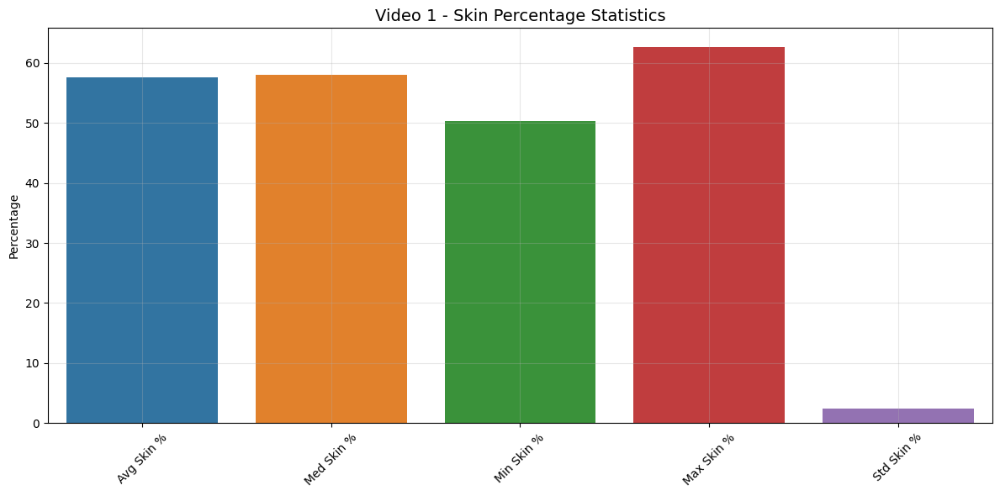


SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 1


## Skin Percentage Timeline


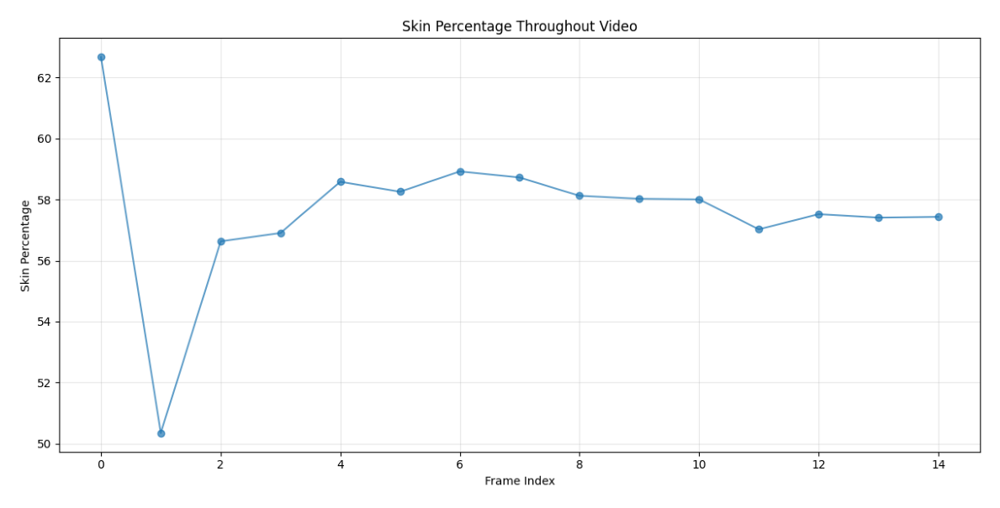


## Skin Percentage Distribution


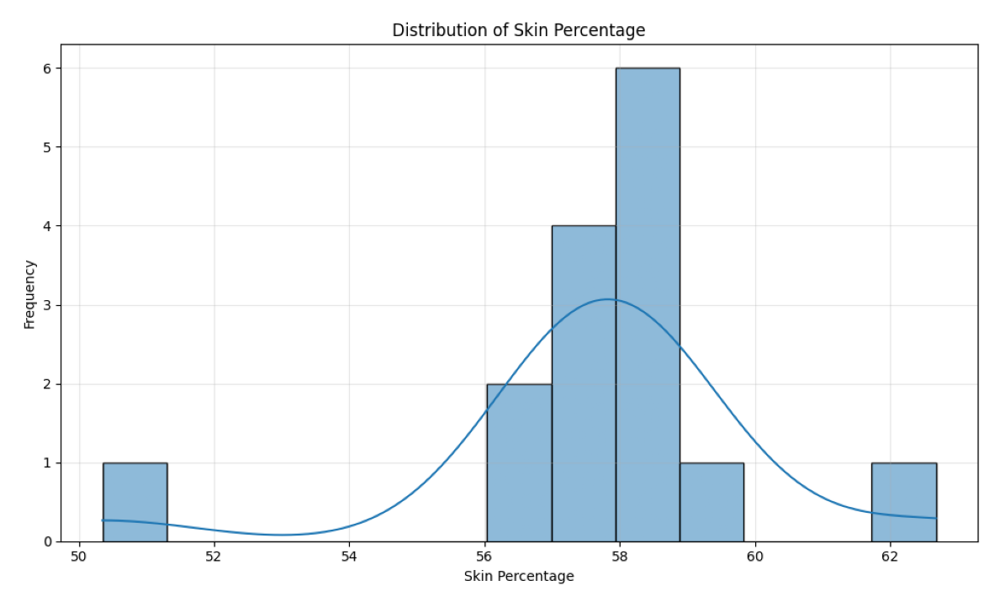


## Skin Regions Timeline


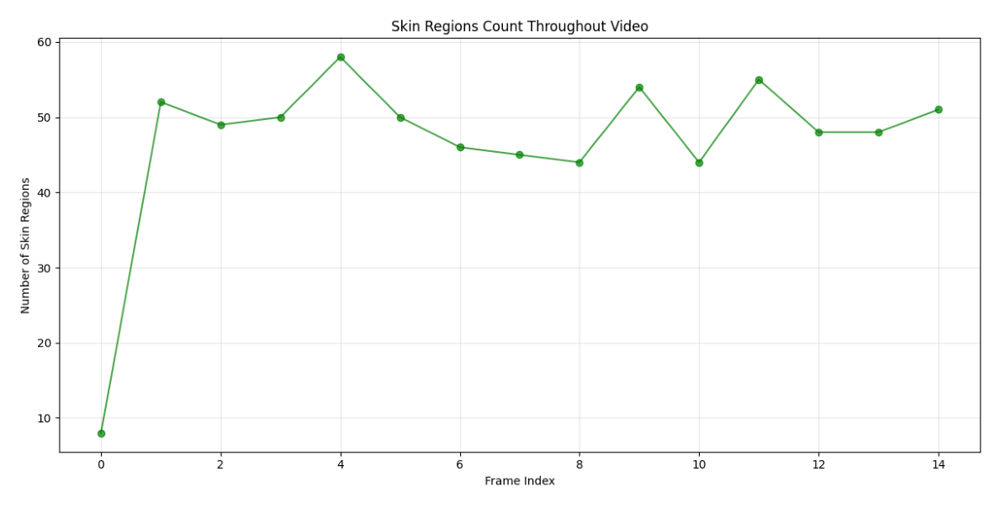


## Skin Percentage Vs Regions


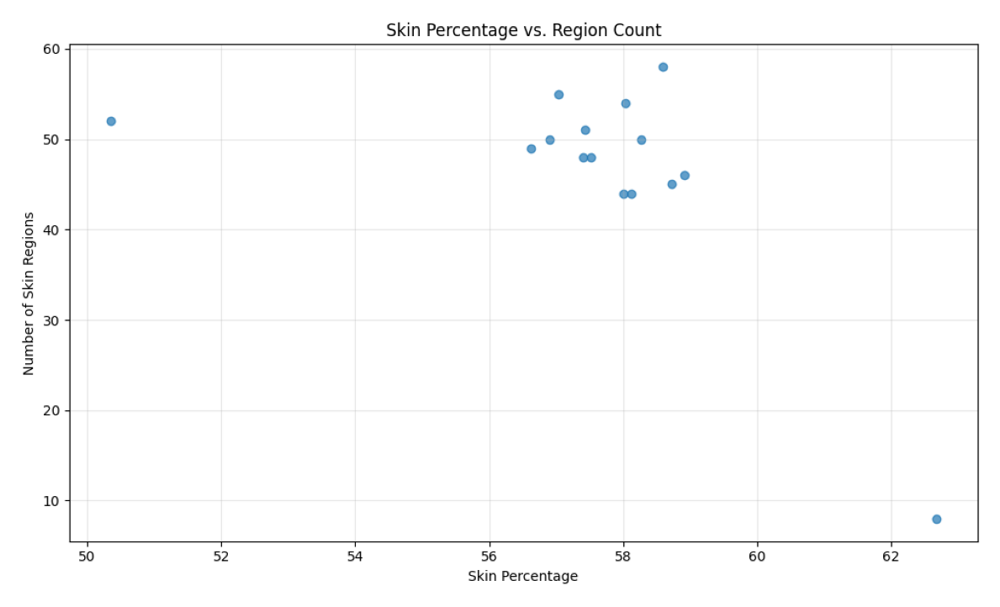


## Skin Regional Distribution


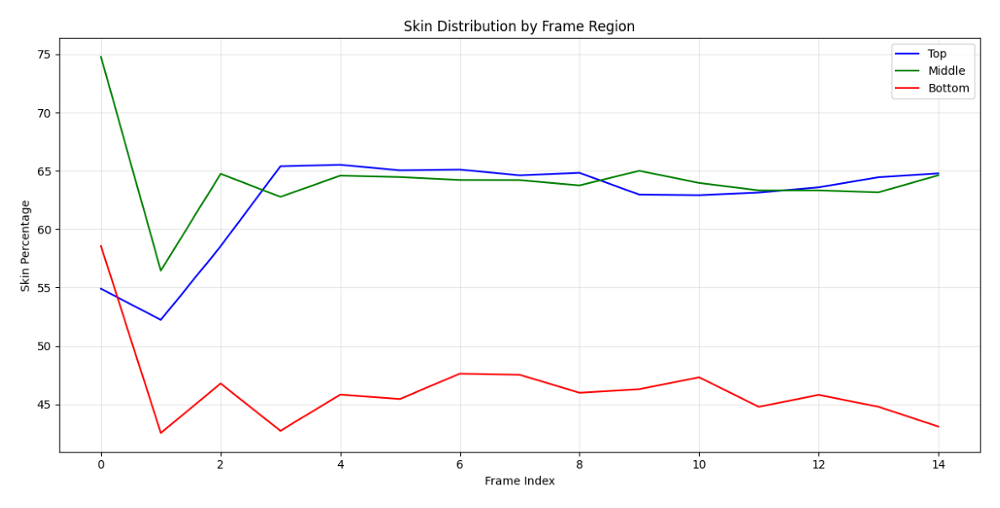


SAMPLE SKIN HEATMAPS FOR VIDEO 1


FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 1

Showing first 10 of 15 frames:


,filename,skin_percentage,skin_regions,top_percentage,middle_percentage,bottom_percentage,max_region_size
0,frame_0000.jpg,62.675646,8,54.899295,74.765294,58.546147,346732
1,frame_0001.jpg,50.348070,52,52.219778,56.445503,42.526576,203137
2,frame_0002.jpg,56.629435,49,58.535964,64.744725,46.773684,250899
3,frame_0003.jpg,56.905789,50,65.394876,62.779509,42.709861,248301
4,frame_0004.jpg,58.584425,58,65.518084,64.585879,45.821114,253156
5,frame_0005.jpg,58.261278,50,65.045617,64.464198,45.444872,253296
6,frame_0006.jpg,58.920966,46,65.107221,64.213201,47.615266,244906
7,frame_0007.jpg,58.722432,45,64.612862,64.206582,47.520059,251501
8,frame_0008.jpg,58.128187,44,64.826694,63.754989,45.973342,247191
9,frame_0009.jpg,58.027818,54,62.973994,64.999287,46.280344,248894


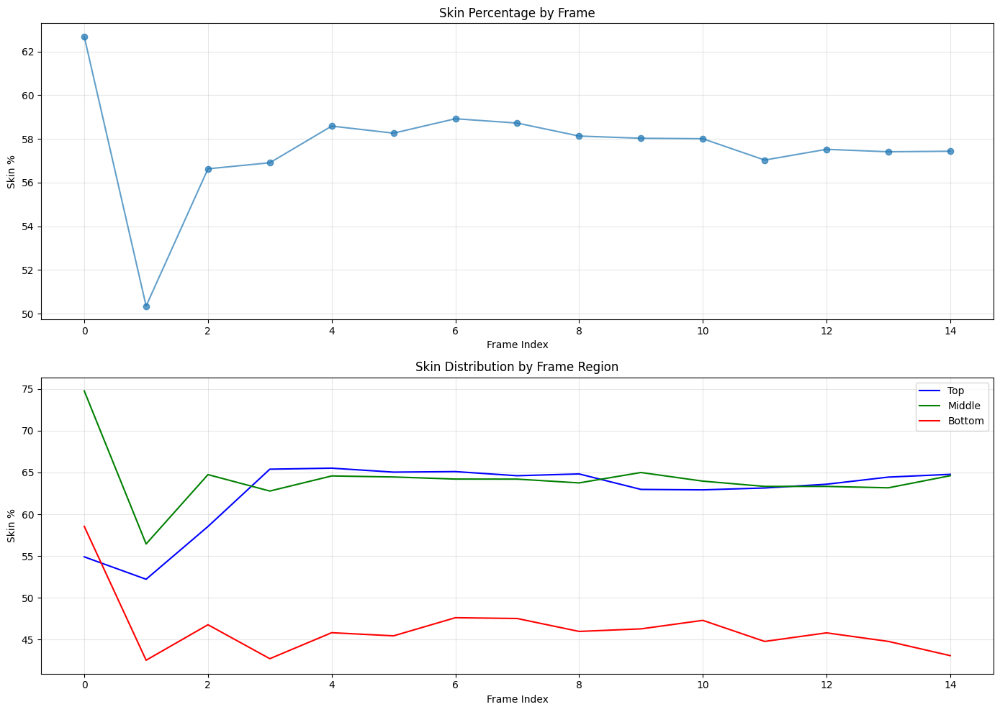

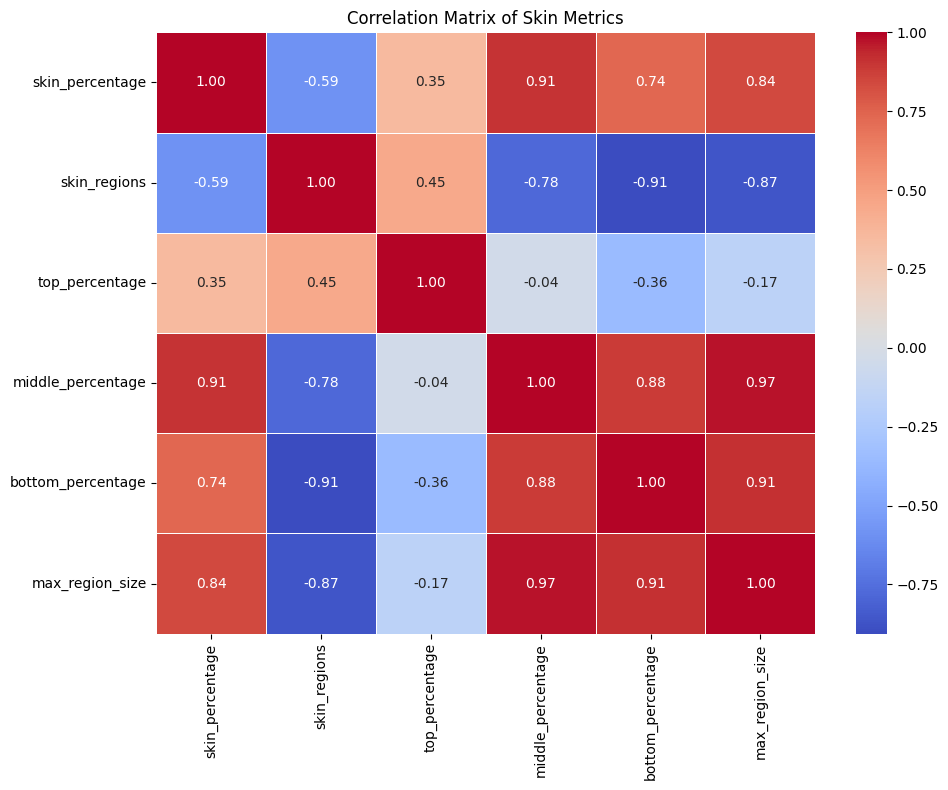


Video skin analysis visualization complete!


In [33]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, Markdown, HTML, Image
import numpy as np
from datetime import datetime
import glob

def display_video_skin_analysis(video_num):
    """
    Display skin analysis results for a specific video
    
    Parameters:
    - video_num: The video number (1, 2, or 3)
    """
    # Construct the path to the skin analysis directory
    analysis_dir = f'/kaggle/working/video{video_num}_skin_analysis'
    
    print(f"Displaying skin analysis for Video {video_num}")
    print(f"Current Date and Time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"User: 6eama\n")
    
    if not os.path.exists(analysis_dir):
        print(f"Error: Directory not found at {analysis_dir}")
        return
    
    # ---- Display the analysis report ----
    report_path = os.path.join(analysis_dir, "skin_analysis_report.md")
    
    if os.path.exists(report_path):
        print("="*80)
        print(f"SKIN ANALYSIS REPORT FOR VIDEO {video_num}")
        print("="*80 + "\n")
        
        with open(report_path, 'r') as f:
            report_content = f.read()
        
        display(Markdown(report_content))
    
    # ---- Display statistics ----
    stats_path = os.path.join(analysis_dir, "skin_analysis_stats.csv")
    
    if os.path.exists(stats_path):
        print("\n" + "="*80)
        print(f"SKIN ANALYSIS STATISTICS FOR VIDEO {video_num}")
        print("="*80 + "\n")
        
        stats_df = pd.read_csv(stats_path)
        display(stats_df)
        
        # Create a visualization of key stats
        try:
            # Extract key metrics for visualization
            metrics = ['avg_skin_percentage', 'med_skin_percentage', 'min_skin_percentage', 
                       'max_skin_percentage', 'std_skin_percentage']
            values = [stats_df[metric][0] for metric in metrics]
            
            # Clean up labels
            labels = [m.replace('_', ' ').replace('percentage', '%').title() for m in metrics]
            
            plt.figure(figsize=(12, 6))
            sns.barplot(x=labels, y=values)
            plt.title(f'Video {video_num} - Skin Percentage Statistics', fontsize=14)
            plt.ylabel('Percentage')
            plt.xticks(rotation=45)
            plt.grid(True, alpha=0.3)
            plt.tight_layout()
            plt.show()
        except Exception as e:
            print(f"Error creating statistics visualization: {e}")
    
    # ---- Display main analysis visualizations ----
    print("\n" + "="*80)
    print(f"SKIN ANALYSIS VISUALIZATIONS FOR VIDEO {video_num}")
    print("="*80 + "\n")
    
    main_visualizations = [
        "skin_percentage_timeline.png",
        "skin_percentage_distribution.png",
        "skin_regions_timeline.png",
        "skin_percentage_vs_regions.png",
        "skin_regional_distribution.png"
    ]
    
    for viz_name in main_visualizations:
        viz_path = os.path.join(analysis_dir, viz_name)
        
        if os.path.exists(viz_path):
            print(f"\n## {viz_name.replace('.png', '').replace('_', ' ').title()}")
            
            # Display the image
            img = plt.imread(viz_path)
            plt.figure(figsize=(12, 8))
            plt.imshow(img)
            plt.axis('off')
            plt.tight_layout()
            plt.show()
    
    # ---- Display sample heatmaps ----
    heatmap_dir = os.path.join(analysis_dir, "skin_heatmaps")
    
    if os.path.exists(heatmap_dir):
        print("\n" + "="*80)
        print(f"SAMPLE SKIN HEATMAPS FOR VIDEO {video_num}")
        print("="*80 + "\n")
        
        # Get a sample of heatmaps (at most 6)
        heatmap_files = glob.glob(os.path.join(heatmap_dir, "*.png"))
        
        if len(heatmap_files) > 6:
            # Take evenly spaced samples
            step = len(heatmap_files) // 6
            sample_heatmaps = heatmap_files[::step][:6]
        else:
            sample_heatmaps = heatmap_files
        
        # Display in a grid
        if sample_heatmaps:
            rows = (len(sample_heatmaps) + 1) // 2
            cols = min(2, len(sample_heatmaps))
            
            plt.figure(figsize=(cols * 8, rows * 6))
            
            for i, heatmap_path in enumerate(sample_heatmaps):
                plt.subplot(rows, cols, i+1)
                
                img = plt.imread(heatmap_path)
                plt.imshow(img)
                plt.title(f"Frame {i+1}", fontsize=12)
                plt.axis('off')
            
            plt.tight_layout()
            plt.show()
    
    # ---- Display frame analysis data ----
    frames_path = os.path.join(analysis_dir, "skin_analysis_by_frame.csv")
    
    if os.path.exists(frames_path):
        print("\n" + "="*80)
        print(f"FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO {video_num}")
        print("="*80 + "\n")
        
        frames_df = pd.read_csv(frames_path)
        
        # Show just the first few rows
        print(f"Showing first 10 of {len(frames_df)} frames:")
        display(frames_df.head(10))
        
        # Create a visualization of skin metrics over time
        plt.figure(figsize=(14, 10))
        
        # Plot skin percentage over frames
        plt.subplot(2, 1, 1)
        plt.plot(frames_df['skin_percentage'], marker='o', alpha=0.7)
        plt.title('Skin Percentage by Frame')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin %')
        plt.grid(True, alpha=0.3)
        
        # Plot skin region distribution
        plt.subplot(2, 1, 2)
        plt.plot(frames_df['top_percentage'], label='Top', color='blue')
        plt.plot(frames_df['middle_percentage'], label='Middle', color='green')
        plt.plot(frames_df['bottom_percentage'], label='Bottom', color='red')
        plt.title('Skin Distribution by Frame Region')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin %')
        plt.legend()
        plt.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
        
        # Create a correlation matrix visualization
        plt.figure(figsize=(10, 8))
        corr = frames_df[['skin_percentage', 'skin_regions', 
                          'top_percentage', 'middle_percentage', 
                          'bottom_percentage', 'max_region_size']].corr()
        
        sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
        plt.title('Correlation Matrix of Skin Metrics')
        plt.tight_layout()
        plt.show()
    
    print("\nVideo skin analysis visualization complete!")

# Example usage:
# To display results for Video 1:
display_video_skin_analysis(1)

# Uncomment these to display results for other videos:
# display_video_skin_analysis(2)
# display_video_skin_analysis(3)

Displaying skin analysis for Video 2
Current Date and Time: 2025-03-12 11:50:57
User: 6eama

SKIN ANALYSIS REPORT FOR VIDEO 2



# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: 2025-03-12 11:49:41
- User: 6eama
- Total Frames Analyzed: 18

## Skin Coverage Summary
- Average Skin Percentage: 39.56%
- Median Skin Percentage: 40.02%
- Range: 13.24% - 68.72%
- Standard Deviation: 11.62%

## Skin Regions Analysis
- Average Number of Skin Regions: 22.3
- Maximum Regions in a Frame: 41
- Minimum Regions in a Frame: 2

## Regional Distribution (Average)
- Top of Frame: 39.73%
- Middle of Frame: 64.61%
- Bottom of Frame: 14.46%

## Notable Frames
- Highest Skin Exposure: frame_0015.jpg (68.72%)
- Lowest Skin Exposure: frame_0014.jpg (13.24%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps



SKIN ANALYSIS STATISTICS FOR VIDEO 2



,avg_skin_percentage,med_skin_percentage,min_skin_percentage,max_skin_percentage,std_skin_percentage,avg_skin_regions,med_skin_regions,min_skin_regions,max_skin_regions,total_frames
0,39.560681,40.015327,13.244798,68.715244,11.622623,22.333333,23.5,2,41,18


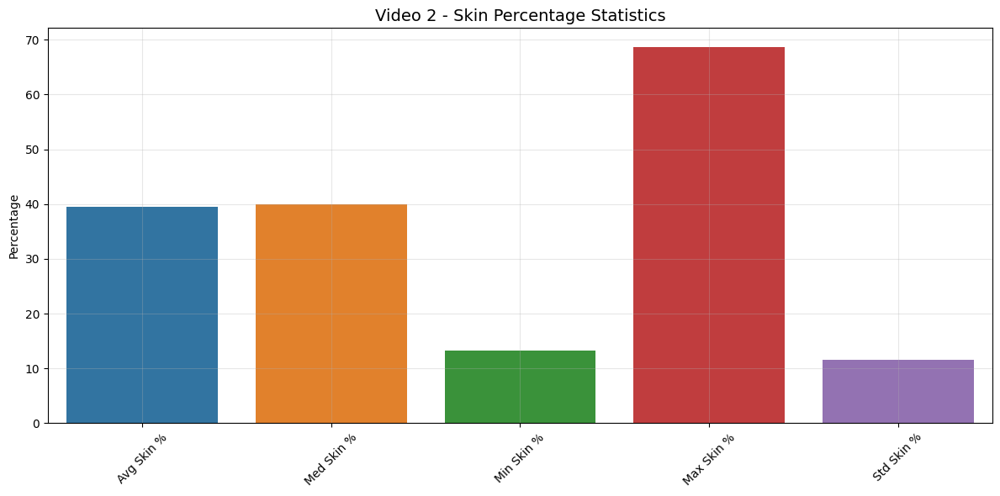


SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 2


## Skin Percentage Timeline


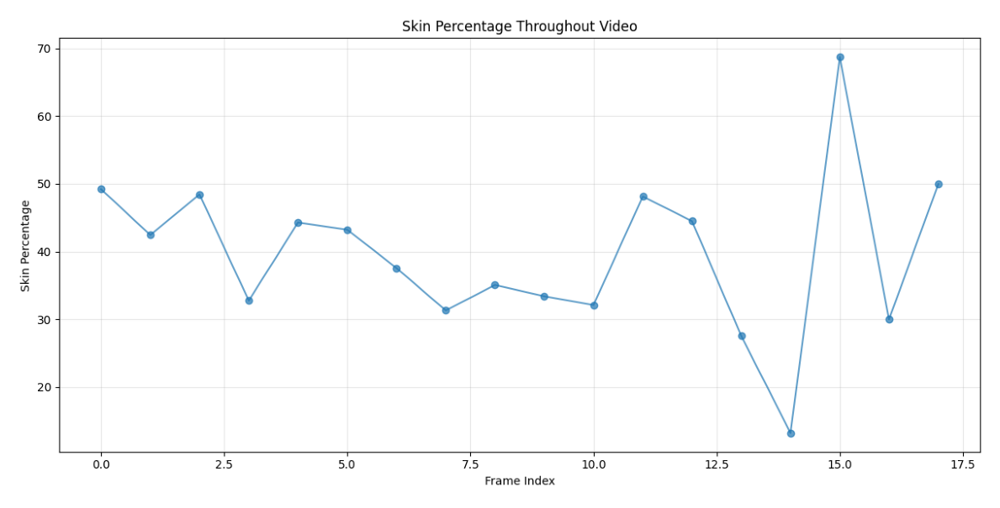


## Skin Percentage Distribution


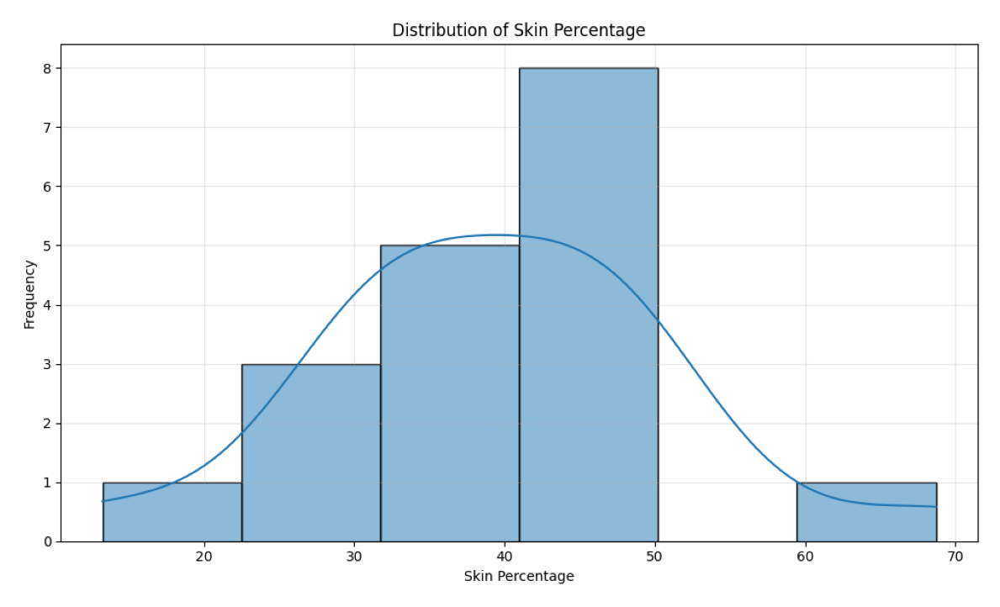


## Skin Regions Timeline


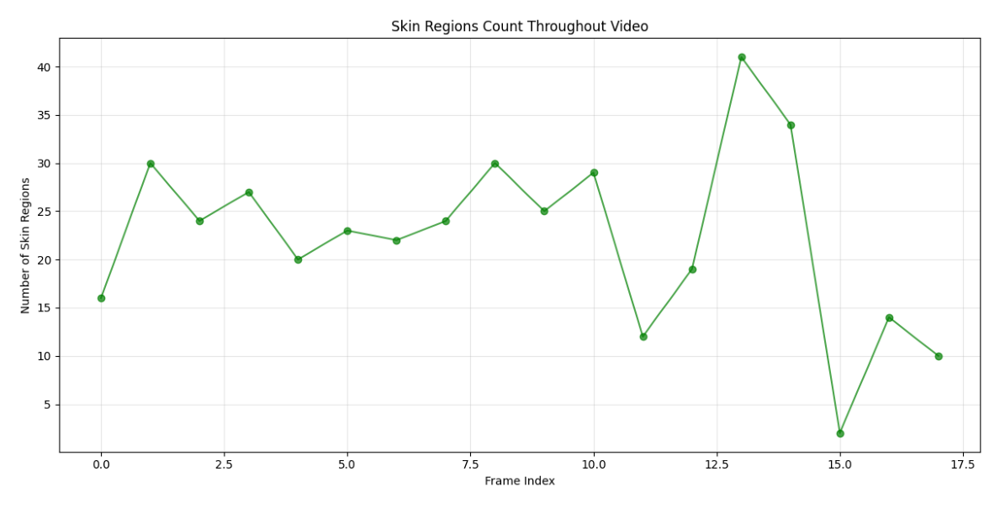


## Skin Percentage Vs Regions


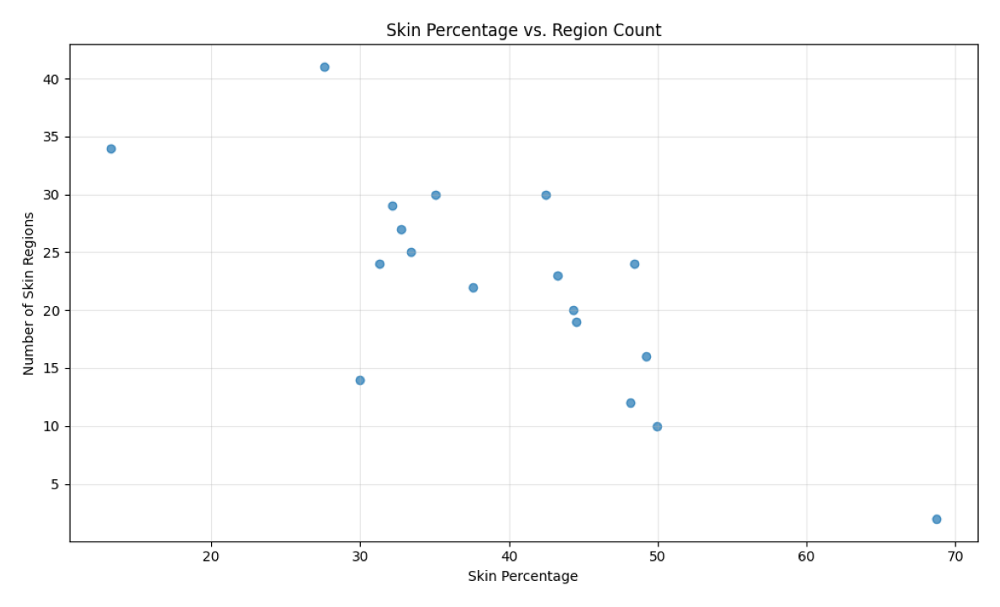


## Skin Regional Distribution


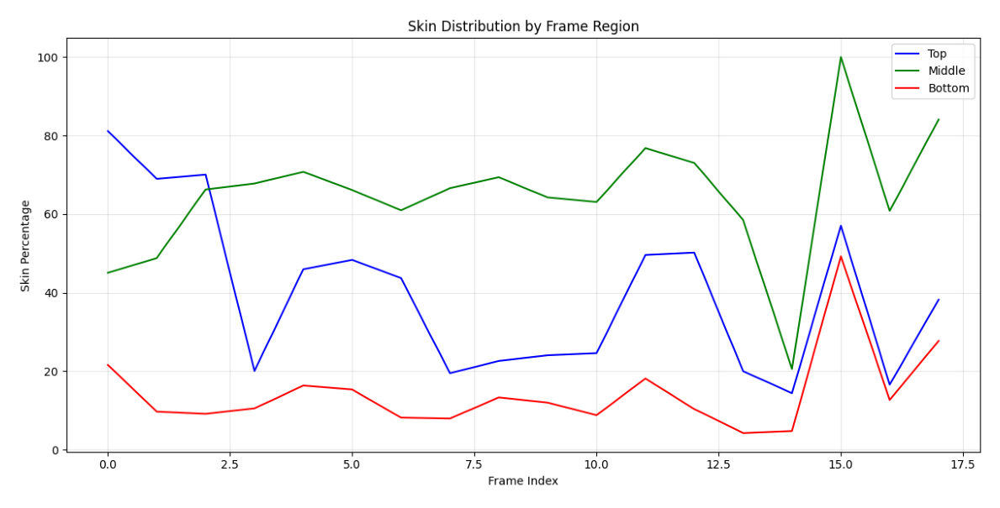


SAMPLE SKIN HEATMAPS FOR VIDEO 2


FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 2

Showing first 10 of 18 frames:


,filename,skin_percentage,skin_regions,top_percentage,middle_percentage,bottom_percentage,max_region_size
0,frame_0000.jpg,49.217733,16,81.120174,45.068630,21.608728,272825
1,frame_0001.jpg,42.456055,30,68.955177,48.816797,9.720695,222738
2,frame_0002.jpg,48.440891,24,70.028409,66.282278,9.154040,266790
3,frame_0003.jpg,32.770454,27,20.068630,67.786738,10.552094,120974
4,frame_0004.jpg,44.305081,20,45.970288,70.729472,16.345410,249212
5,frame_0005.jpg,43.239339,23,48.366223,66.137178,15.341418,235698
6,frame_0006.jpg,37.574599,22,43.696542,60.957356,8.180087,208705
7,frame_0007.jpg,31.327311,24,19.508594,66.618300,7.946909,169208
8,frame_0008.jpg,35.080973,30,22.631048,69.369603,13.345145,101437
9,frame_0009.jpg,33.413018,25,24.055067,64.262076,12.019897,108131


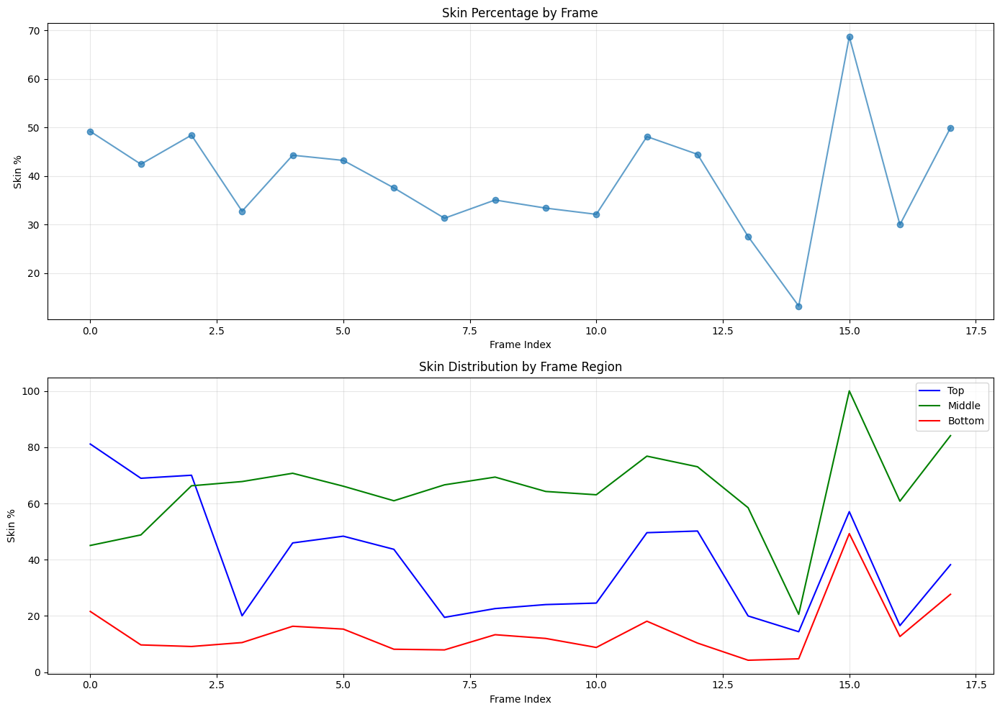

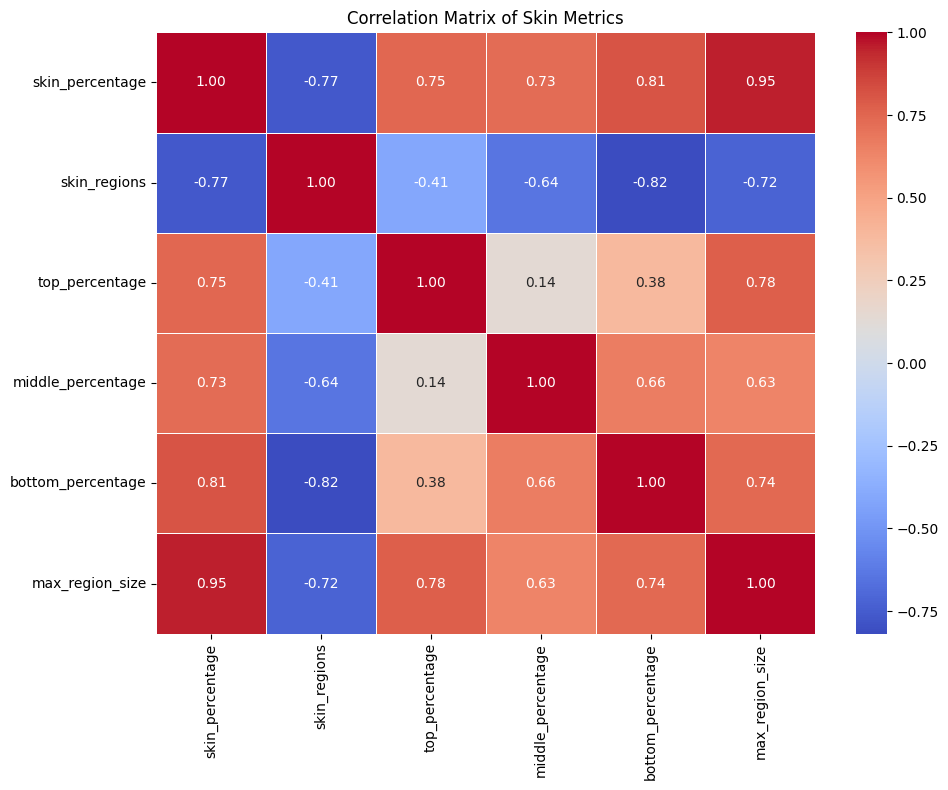


Video skin analysis visualization complete!


In [34]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, Markdown, HTML, Image
import numpy as np
from datetime import datetime
import glob

def display_video_skin_analysis(video_num):
    """
    Display skin analysis results for a specific video
    
    Parameters:
    - video_num: The video number (1, 2, or 3)
    """
    # Construct the path to the skin analysis directory
    analysis_dir = f'/kaggle/working/video2_skin_analysis'
    
    print(f"Displaying skin analysis for Video 2")
    print(f"Current Date and Time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"User: 6eama\n")
    
    if not os.path.exists(analysis_dir):
        print(f"Error: Directory not found at {analysis_dir}")
        return
    
    # ---- Display the analysis report ----
    report_path = os.path.join(analysis_dir, "skin_analysis_report.md")
    
    if os.path.exists(report_path):
        print("="*80)
        print(f"SKIN ANALYSIS REPORT FOR VIDEO 2")
        print("="*80 + "\n")
        
        with open(report_path, 'r') as f:
            report_content = f.read()
        
        display(Markdown(report_content))
    
    # ---- Display statistics ----
    stats_path = os.path.join(analysis_dir, "skin_analysis_stats.csv")
    
    if os.path.exists(stats_path):
        print("\n" + "="*80)
        print(f"SKIN ANALYSIS STATISTICS FOR VIDEO 2")
        print("="*80 + "\n")
        
        stats_df = pd.read_csv(stats_path)
        display(stats_df)
        
        # Create a visualization of key stats
        try:
            # Extract key metrics for visualization
            metrics = ['avg_skin_percentage', 'med_skin_percentage', 'min_skin_percentage', 
                       'max_skin_percentage', 'std_skin_percentage']
            values = [stats_df[metric][0] for metric in metrics]
            
            # Clean up labels
            labels = [m.replace('_', ' ').replace('percentage', '%').title() for m in metrics]
            
            plt.figure(figsize=(12, 6))
            sns.barplot(x=labels, y=values)
            plt.title(f'Video {video_num} - Skin Percentage Statistics', fontsize=14)
            plt.ylabel('Percentage')
            plt.xticks(rotation=45)
            plt.grid(True, alpha=0.3)
            plt.tight_layout()
            plt.show()
        except Exception as e:
            print(f"Error creating statistics visualization: {e}")
    
    # ---- Display main analysis visualizations ----
    print("\n" + "="*80)
    print(f"SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 2")
    print("="*80 + "\n")
    
    main_visualizations = [
        "skin_percentage_timeline.png",
        "skin_percentage_distribution.png",
        "skin_regions_timeline.png",
        "skin_percentage_vs_regions.png",
        "skin_regional_distribution.png"
    ]
    
    for viz_name in main_visualizations:
        viz_path = os.path.join(analysis_dir, viz_name)
        
        if os.path.exists(viz_path):
            print(f"\n## {viz_name.replace('.png', '').replace('_', ' ').title()}")
            
            # Display the image
            img = plt.imread(viz_path)
            plt.figure(figsize=(12, 8))
            plt.imshow(img)
            plt.axis('off')
            plt.tight_layout()
            plt.show()
    
    # ---- Display sample heatmaps ----
    heatmap_dir = os.path.join(analysis_dir, "skin_heatmaps")
    
    if os.path.exists(heatmap_dir):
        print("\n" + "="*80)
        print(f"SAMPLE SKIN HEATMAPS FOR VIDEO 2")
        print("="*80 + "\n")
        
        # Get a sample of heatmaps (at most 6)
        heatmap_files = glob.glob(os.path.join(heatmap_dir, "*.png"))
        
        if len(heatmap_files) > 6:
            # Take evenly spaced samples
            step = len(heatmap_files) // 6
            sample_heatmaps = heatmap_files[::step][:6]
        else:
            sample_heatmaps = heatmap_files
        
        # Display in a grid
        if sample_heatmaps:
            rows = (len(sample_heatmaps) + 1) // 2
            cols = min(2, len(sample_heatmaps))
            
            plt.figure(figsize=(cols * 8, rows * 6))
            
            for i, heatmap_path in enumerate(sample_heatmaps):
                plt.subplot(rows, cols, i+1)
                
                img = plt.imread(heatmap_path)
                plt.imshow(img)
                plt.title(f"Frame {i+1}", fontsize=12)
                plt.axis('off')
            
            plt.tight_layout()
            plt.show()
    
    # ---- Display frame analysis data ----
    frames_path = os.path.join(analysis_dir, "skin_analysis_by_frame.csv")
    
    if os.path.exists(frames_path):
        print("\n" + "="*80)
        print(f"FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 2")
        print("="*80 + "\n")
        
        frames_df = pd.read_csv(frames_path)
        
        # Show just the first few rows
        print(f"Showing first 10 of {len(frames_df)} frames:")
        display(frames_df.head(10))
        
        # Create a visualization of skin metrics over time
        plt.figure(figsize=(14, 10))
        
        # Plot skin percentage over frames
        plt.subplot(2, 1, 1)
        plt.plot(frames_df['skin_percentage'], marker='o', alpha=0.7)
        plt.title('Skin Percentage by Frame')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin %')
        plt.grid(True, alpha=0.3)
        
        # Plot skin region distribution
        plt.subplot(2, 1, 2)
        plt.plot(frames_df['top_percentage'], label='Top', color='blue')
        plt.plot(frames_df['middle_percentage'], label='Middle', color='green')
        plt.plot(frames_df['bottom_percentage'], label='Bottom', color='red')
        plt.title('Skin Distribution by Frame Region')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin %')
        plt.legend()
        plt.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
        
        # Create a correlation matrix visualization
        plt.figure(figsize=(10, 8))
        corr = frames_df[['skin_percentage', 'skin_regions', 
                          'top_percentage', 'middle_percentage', 
                          'bottom_percentage', 'max_region_size']].corr()
        
        sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
        plt.title('Correlation Matrix of Skin Metrics')
        plt.tight_layout()
        plt.show()
    
    print("\nVideo skin analysis visualization complete!")

# Example usage:
# To display results for Video 2:
display_video_skin_analysis(2)

# Uncomment these to display results for other videos:
# display_video_skin_analysis(2)
# display_video_skin_analysis(3)

Displaying skin analysis for Video 3
Current Date and Time: 2025-03-12 11:51:10
User: 6eama

SKIN ANALYSIS REPORT FOR VIDEO 3



# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: 2025-03-12 11:49:51
- User: 6eama
- Total Frames Analyzed: 33

## Skin Coverage Summary
- Average Skin Percentage: 74.15%
- Median Skin Percentage: 76.02%
- Range: 42.72% - 98.61%
- Standard Deviation: 15.85%

## Skin Regions Analysis
- Average Number of Skin Regions: 15.7
- Maximum Regions in a Frame: 35
- Minimum Regions in a Frame: 1

## Regional Distribution (Average)
- Top of Frame: 73.17%
- Middle of Frame: 68.97%
- Bottom of Frame: 80.51%

## Notable Frames
- Highest Skin Exposure: frame_0021.jpg (98.61%)
- Lowest Skin Exposure: frame_0027.jpg (42.72%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps



SKIN ANALYSIS STATISTICS FOR VIDEO 3



,avg_skin_percentage,med_skin_percentage,min_skin_percentage,max_skin_percentage,std_skin_percentage,avg_skin_regions,med_skin_regions,min_skin_regions,max_skin_regions,total_frames
0,74.145169,76.021152,42.719523,98.612467,15.854482,15.666667,15.0,1,35,33


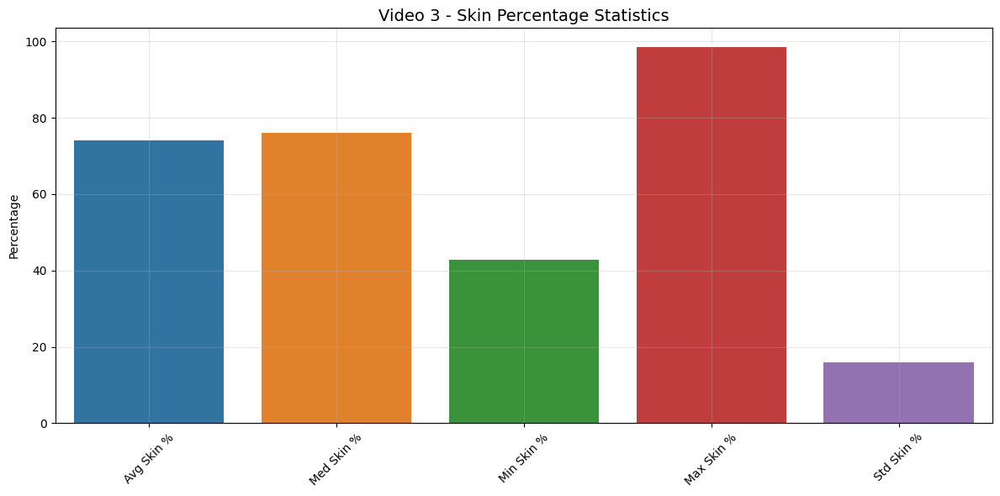


SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 3


## Skin Percentage Timeline


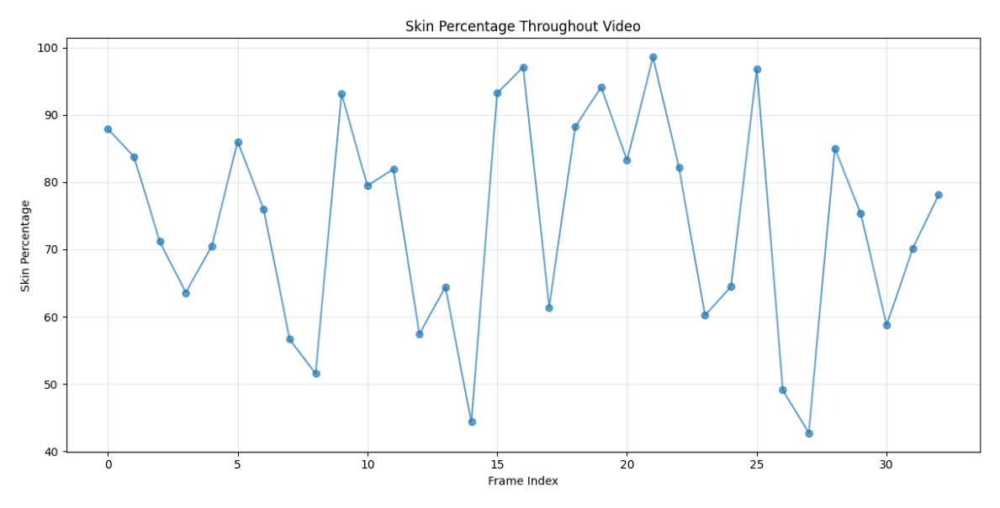


## Skin Percentage Distribution


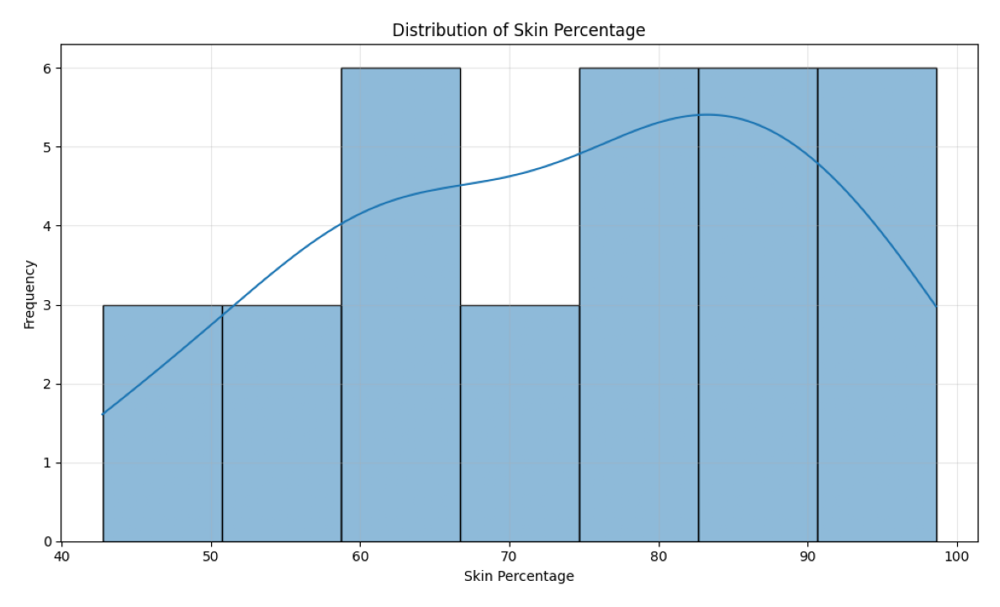


## Skin Regions Timeline


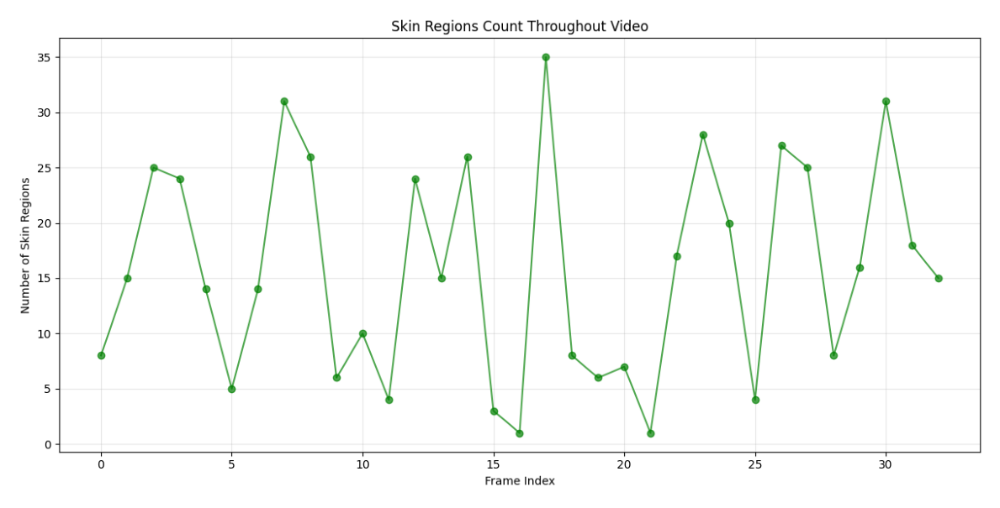


## Skin Percentage Vs Regions


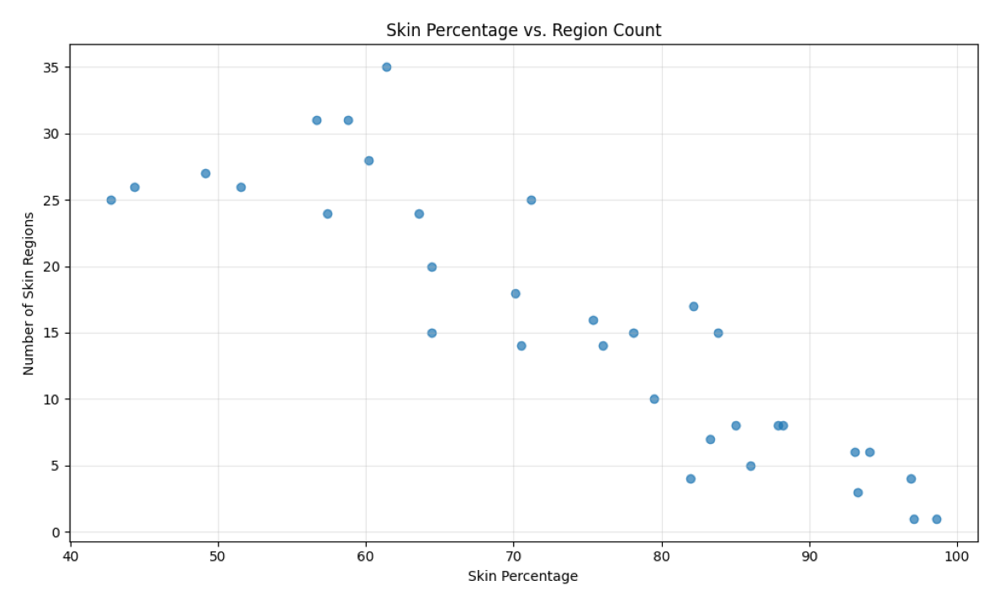


## Skin Regional Distribution


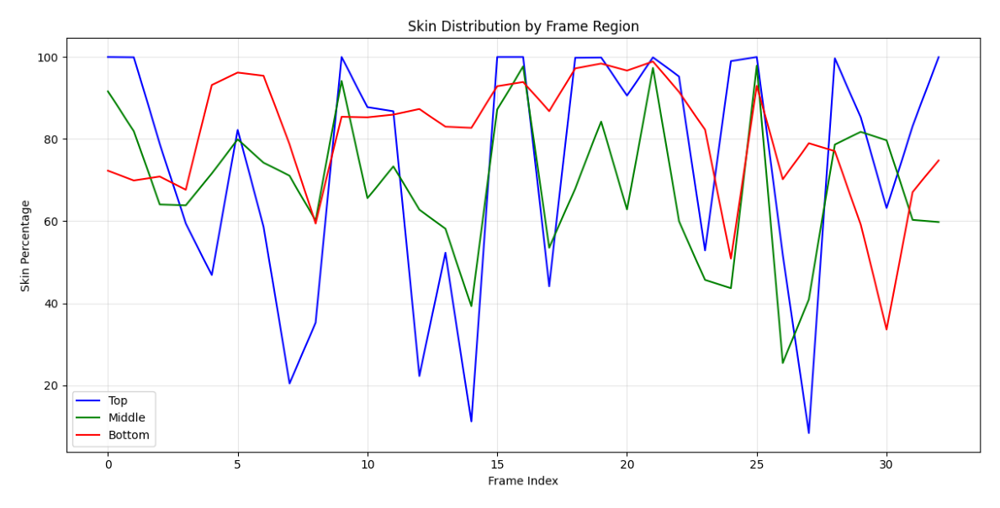


SAMPLE SKIN HEATMAPS FOR VIDEO 3


FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 3

Showing first 10 of 33 frames:


,filename,skin_percentage,skin_regions,top_percentage,middle_percentage,bottom_percentage,max_region_size
0,frame_0000.jpg,87.878588,8,100.000000,91.622373,72.271098,494247
1,frame_0001.jpg,83.833313,15,99.931777,81.927643,69.886364,478489
2,frame_0002.jpg,71.173604,25,78.828100,64.047735,70.853698,315222
3,frame_0003.jpg,63.584052,24,59.444241,63.833394,67.660985,320292
4,frame_0004.jpg,70.478821,14,46.861763,71.593964,93.187419,369601
5,frame_0005.jpg,86.015828,5,82.213262,79.904896,96.181574,505706
6,frame_0006.jpg,76.021152,14,58.634734,74.241406,95.410252,446219
7,frame_0007.jpg,56.656392,31,20.409233,71.038001,78.688091,311332
8,frame_0008.jpg,51.548937,26,35.277676,60.098974,59.421330,294470
9,frame_0009.jpg,93.114217,6,100.000000,94.177155,85.438559,548486


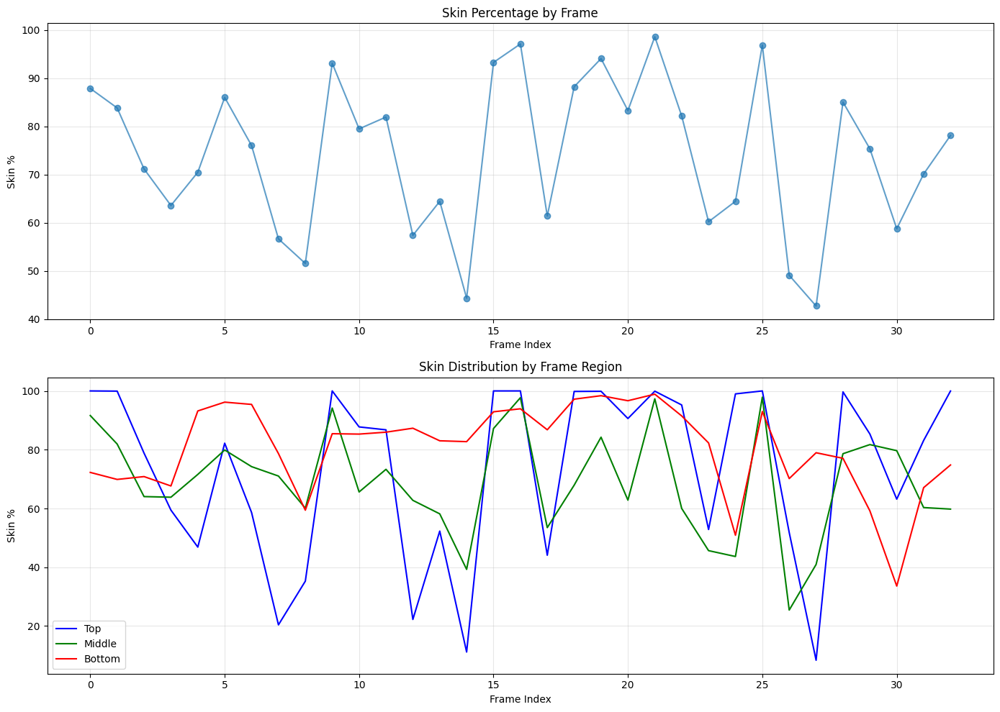

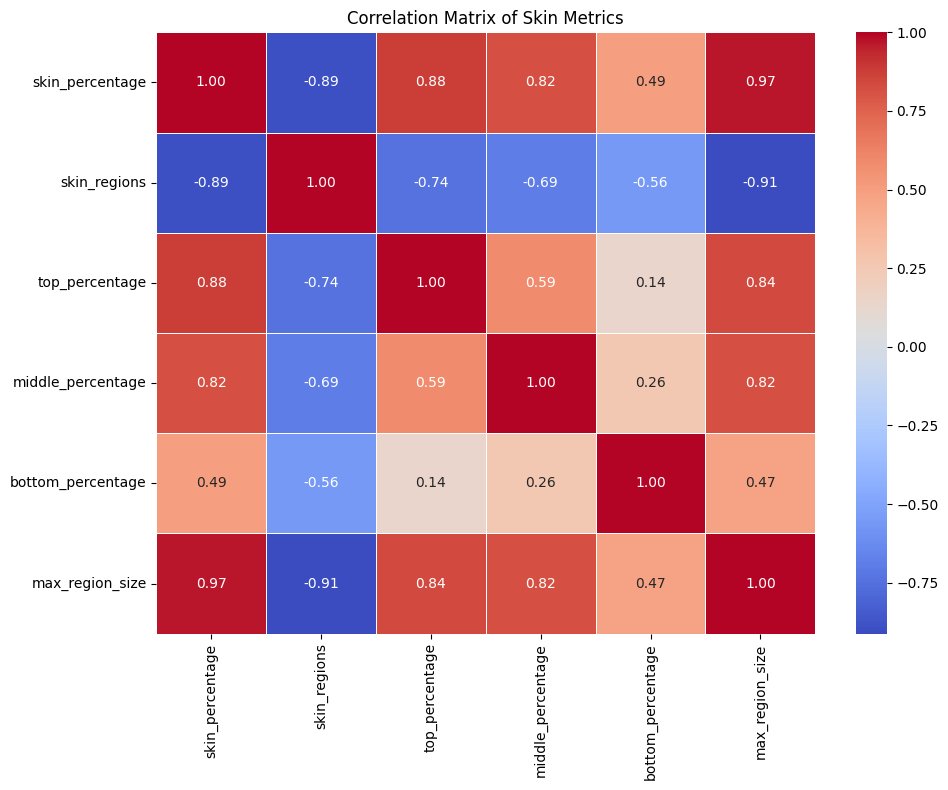


Video skin analysis visualization complete!


In [35]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, Markdown, HTML, Image
import numpy as np
from datetime import datetime
import glob

def display_video_skin_analysis(video_num):
    """
    Display skin analysis results for a specific video
    
    Parameters:
    - video_num: The video number (1, 2, or 3)
    """
    # Construct the path to the skin analysis directory
    analysis_dir = f'/kaggle/working/video3_skin_analysis'
    
    print(f"Displaying skin analysis for Video 3")
    print(f"Current Date and Time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"User: 6eama\n")
    
    if not os.path.exists(analysis_dir):
        print(f"Error: Directory not found at {analysis_dir}")
        return
    
    # ---- Display the analysis report ----
    report_path = os.path.join(analysis_dir, "skin_analysis_report.md")
    
    if os.path.exists(report_path):
        print("="*80)
        print(f"SKIN ANALYSIS REPORT FOR VIDEO 3")
        print("="*80 + "\n")
        
        with open(report_path, 'r') as f:
            report_content = f.read()
        
        display(Markdown(report_content))
    
    # ---- Display statistics ----
    stats_path = os.path.join(analysis_dir, "skin_analysis_stats.csv")
    
    if os.path.exists(stats_path):
        print("\n" + "="*80)
        print(f"SKIN ANALYSIS STATISTICS FOR VIDEO 3")
        print("="*80 + "\n")
        
        stats_df = pd.read_csv(stats_path)
        display(stats_df)
        
        # Create a visualization of key stats
        try:
            # Extract key metrics for visualization
            metrics = ['avg_skin_percentage', 'med_skin_percentage', 'min_skin_percentage', 
                       'max_skin_percentage', 'std_skin_percentage']
            values = [stats_df[metric][0] for metric in metrics]
            
            # Clean up labels
            labels = [m.replace('_', ' ').replace('percentage', '%').title() for m in metrics]
            
            plt.figure(figsize=(12, 6))
            sns.barplot(x=labels, y=values)
            plt.title(f'Video {video_num} - Skin Percentage Statistics', fontsize=14)
            plt.ylabel('Percentage')
            plt.xticks(rotation=45)
            plt.grid(True, alpha=0.3)
            plt.tight_layout()
            plt.show()
        except Exception as e:
            print(f"Error creating statistics visualization: {e}")
    
    # ---- Display main analysis visualizations ----
    print("\n" + "="*80)
    print(f"SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 3")
    print("="*80 + "\n")
    
    main_visualizations = [
        "skin_percentage_timeline.png",
        "skin_percentage_distribution.png",
        "skin_regions_timeline.png",
        "skin_percentage_vs_regions.png",
        "skin_regional_distribution.png"
    ]
    
    for viz_name in main_visualizations:
        viz_path = os.path.join(analysis_dir, viz_name)
        
        if os.path.exists(viz_path):
            print(f"\n## {viz_name.replace('.png', '').replace('_', ' ').title()}")
            
            # Display the image
            img = plt.imread(viz_path)
            plt.figure(figsize=(12, 8))
            plt.imshow(img)
            plt.axis('off')
            plt.tight_layout()
            plt.show()
    
    # ---- Display sample heatmaps ----
    heatmap_dir = os.path.join(analysis_dir, "skin_heatmaps")
    
    if os.path.exists(heatmap_dir):
        print("\n" + "="*80)
        print(f"SAMPLE SKIN HEATMAPS FOR VIDEO 3")
        print("="*80 + "\n")
        
        # Get a sample of heatmaps (at most 6)
        heatmap_files = glob.glob(os.path.join(heatmap_dir, "*.png"))
        
        if len(heatmap_files) > 6:
            # Take evenly spaced samples
            step = len(heatmap_files) // 6
            sample_heatmaps = heatmap_files[::step][:6]
        else:
            sample_heatmaps = heatmap_files
        
        # Display in a grid
        if sample_heatmaps:
            rows = (len(sample_heatmaps) + 1) // 2
            cols = min(2, len(sample_heatmaps))
            
            plt.figure(figsize=(cols * 8, rows * 6))
            
            for i, heatmap_path in enumerate(sample_heatmaps):
                plt.subplot(rows, cols, i+1)
                
                img = plt.imread(heatmap_path)
                plt.imshow(img)
                plt.title(f"Frame {i+1}", fontsize=12)
                plt.axis('off')
            
            plt.tight_layout()
            plt.show()
    
    # ---- Display frame analysis data ----
    frames_path = os.path.join(analysis_dir, "skin_analysis_by_frame.csv")
    
    if os.path.exists(frames_path):
        print("\n" + "="*80)
        print(f"FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 3")
        print("="*80 + "\n")
        
        frames_df = pd.read_csv(frames_path)
        
        # Show just the first few rows
        print(f"Showing first 10 of {len(frames_df)} frames:")
        display(frames_df.head(10))
        
        # Create a visualization of skin metrics over time
        plt.figure(figsize=(14, 10))
        
        # Plot skin percentage over frames
        plt.subplot(2, 1, 1)
        plt.plot(frames_df['skin_percentage'], marker='o', alpha=0.7)
        plt.title('Skin Percentage by Frame')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin %')
        plt.grid(True, alpha=0.3)
        
        # Plot skin region distribution
        plt.subplot(2, 1, 2)
        plt.plot(frames_df['top_percentage'], label='Top', color='blue')
        plt.plot(frames_df['middle_percentage'], label='Middle', color='green')
        plt.plot(frames_df['bottom_percentage'], label='Bottom', color='red')
        plt.title('Skin Distribution by Frame Region')
        plt.xlabel('Frame Index')
        plt.ylabel('Skin %')
        plt.legend()
        plt.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
        
        # Create a correlation matrix visualization
        plt.figure(figsize=(10, 8))
        corr = frames_df[['skin_percentage', 'skin_regions', 
                          'top_percentage', 'middle_percentage', 
                          'bottom_percentage', 'max_region_size']].corr()
        
        sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
        plt.title('Correlation Matrix of Skin Metrics')
        plt.tight_layout()
        plt.show()
    
    print("\nVideo skin analysis visualization complete!")

# Example usage:
# To display results for Video 3:
display_video_skin_analysis(3)

# Uncomment these to display results for other videos:
# display_video_skin_analysis(2)
# display_video_skin_analysis(3)

Current Date and Time (UTC): 2025-03-06 11:57:42
Current User's Login: 6eama

SKIN ANALYSIS RESULTS VIEWER


DISPLAYING COMPARISON ANALYSIS

Loading skin analysis comparison data from: /kaggle/working/skin_analysis_comparison
Date: 2025-03-06 11:57:42 | User: 6eama


COMPARISON VISUALIZATIONS

Found 2 comparison visualizations

# Avg Regions Comparison


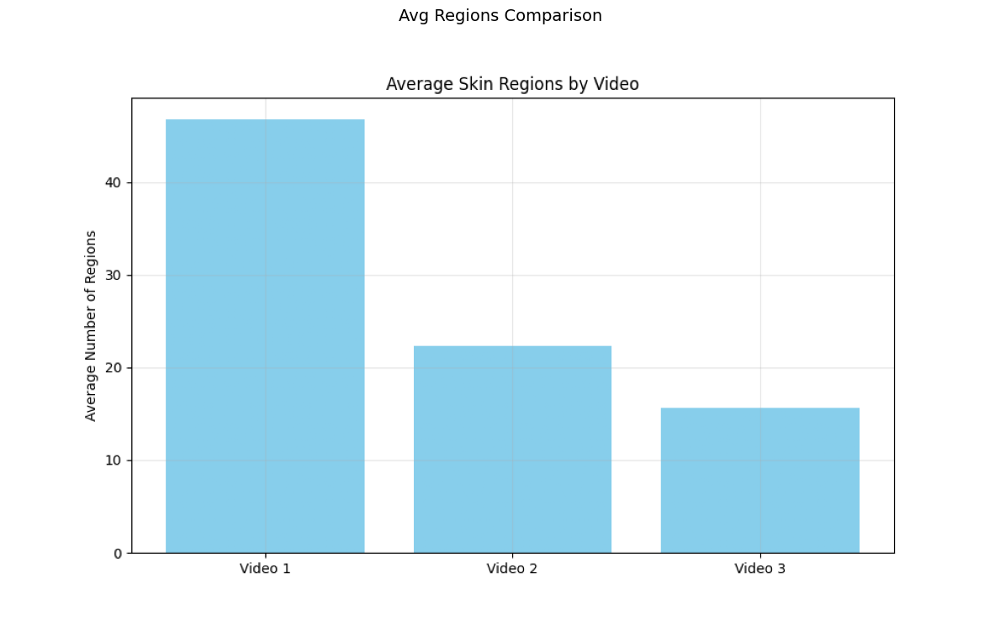


# Avg Skin Comparison


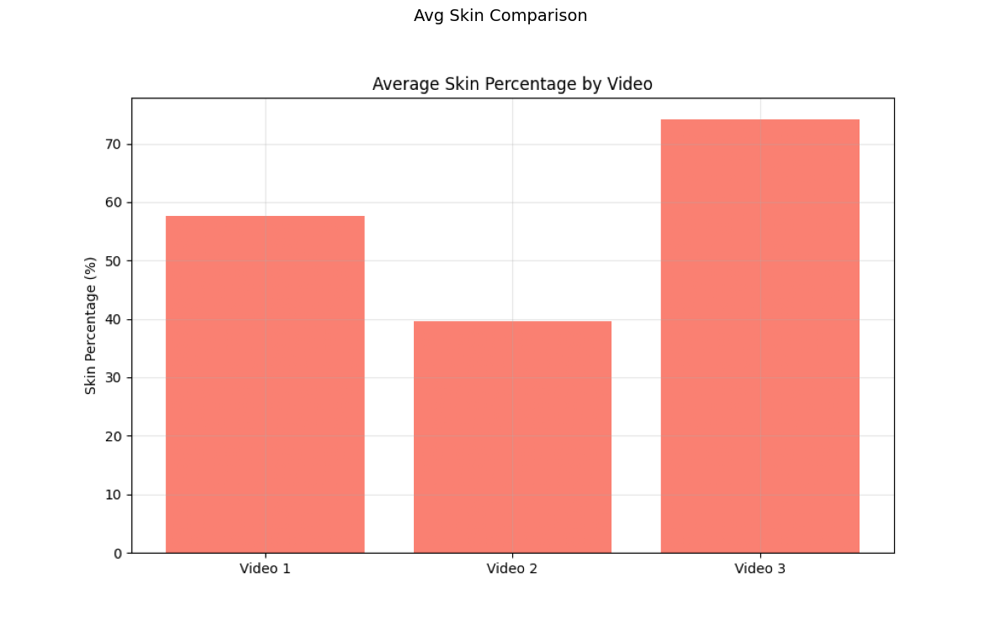


COMPARISON REPORTS

Found 1 analysis reports

REPORT: skin_analysis_comparison_report.md



# Skin Analysis Comparison Report
Date: 2025-03-12 11:50:09
User: 6eama

## Average Skin Percentage by Video
- Video 1: 57.64%
- Video 2: 39.56%
- Video 3: 74.15%

## Key Observations
- Highest average skin percentage: Video 3 (74.15%)
- Lowest average skin percentage: Video 2 (39.56%)
- Most skin regions on average: Video 1 (46.8 regions)
- Fewest skin regions on average: Video 3 (15.7 regions)



COMPARISON DATA


# Skin Analysis Comparison


,Unnamed: 0,Video 1,Video 2,Video 3
0,avg_skin_percentage,57.640144,39.560681,74.145169
1,max_skin_percentage,62.675646,68.715244,98.612467
2,avg_skin_regions,46.800000,22.333333,15.666667
3,total_frames,15.000000,18.000000,33.000000


Error displaying CSV skin_analysis_comparison.csv: could not convert string to float: 'avg_skin_percentage'


DISPLAYING VIDEO 1 ANALYSIS

Displaying skin analysis for Video 1
Date: 2025-03-06 11:57:42 | User: 6eama


SKIN ANALYSIS REPORT FOR VIDEO 1



# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: 2025-03-12 11:49:34
- User: 6eama
- Total Frames Analyzed: 15

## Skin Coverage Summary
- Average Skin Percentage: 57.64%
- Median Skin Percentage: 58.01%
- Range: 50.35% - 62.68%
- Standard Deviation: 2.38%

## Skin Regions Analysis
- Average Number of Skin Regions: 46.8
- Maximum Regions in a Frame: 58
- Minimum Regions in a Frame: 8

## Regional Distribution (Average)
- Top of Frame: 62.53%
- Middle of Frame: 64.22%
- Bottom of Frame: 46.33%

## Notable Frames
- Highest Skin Exposure: frame_0000.jpg (62.68%)
- Lowest Skin Exposure: frame_0001.jpg (50.35%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps



SKIN ANALYSIS STATISTICS FOR VIDEO 1



,avg_skin_percentage,med_skin_percentage,min_skin_percentage,max_skin_percentage,std_skin_percentage,avg_skin_regions,med_skin_regions,min_skin_regions,max_skin_regions,total_frames
0,57.640144,58.005608,50.34807,62.675646,2.383082,46.8,49.0,8,58,15


<Figure size 1000x600 with 0 Axes>

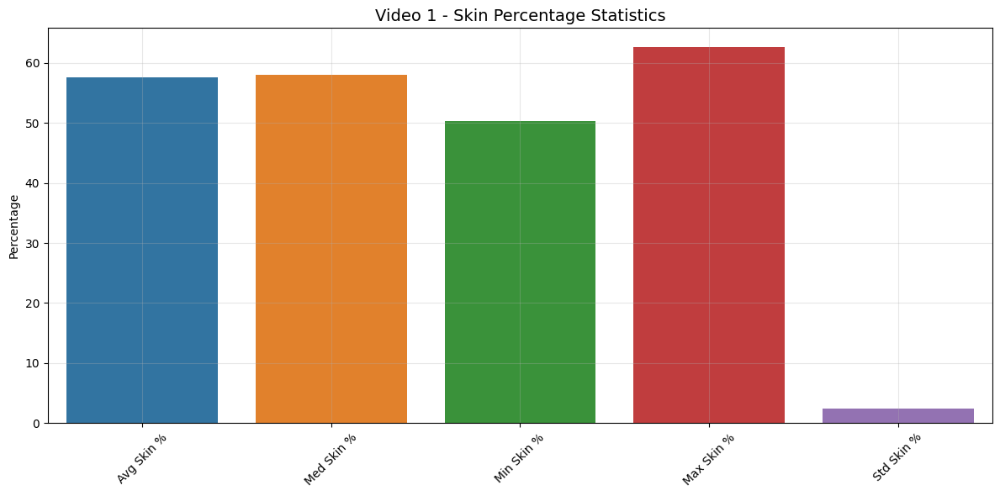


SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 1


# Skin Percentage Timeline


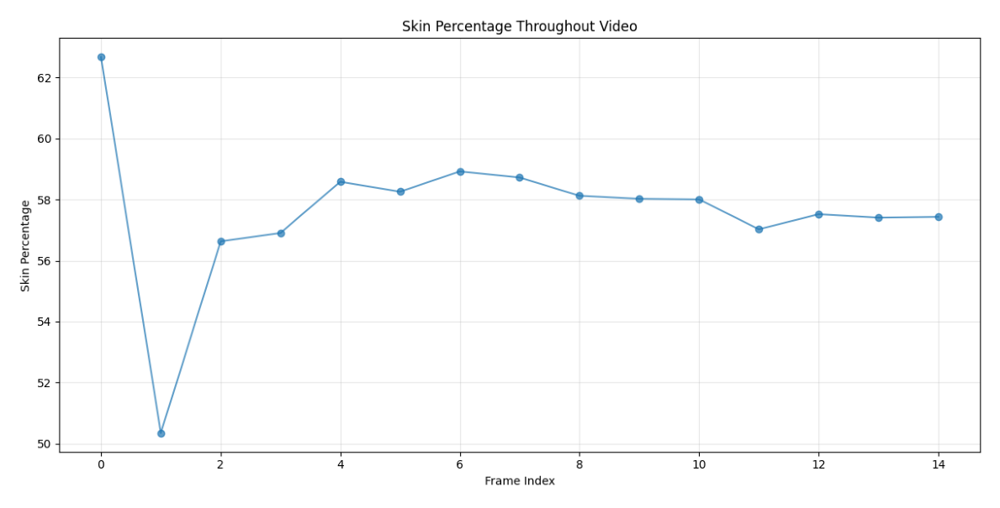


# Skin Percentage Distribution


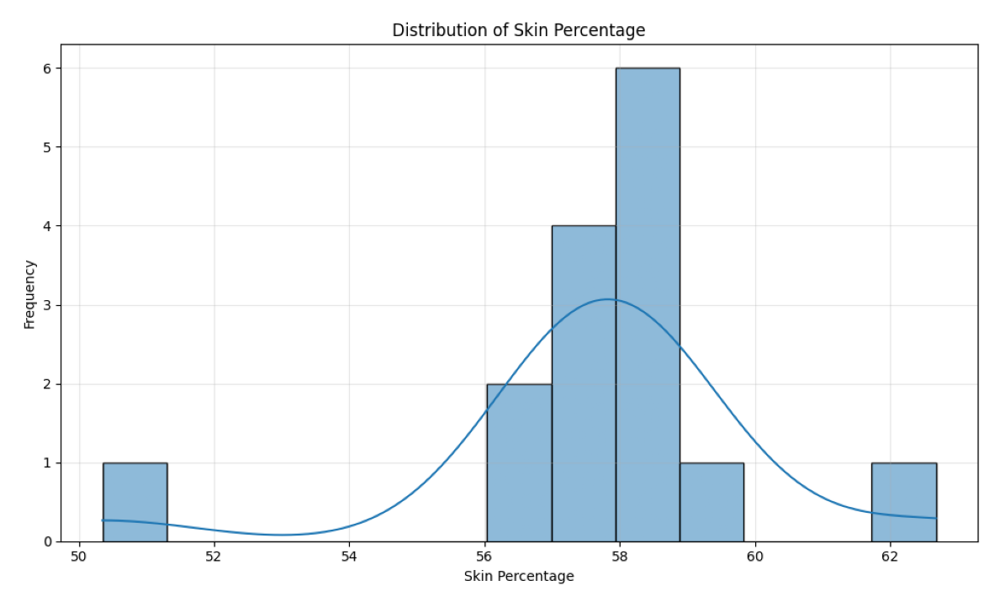


# Skin Regions Timeline


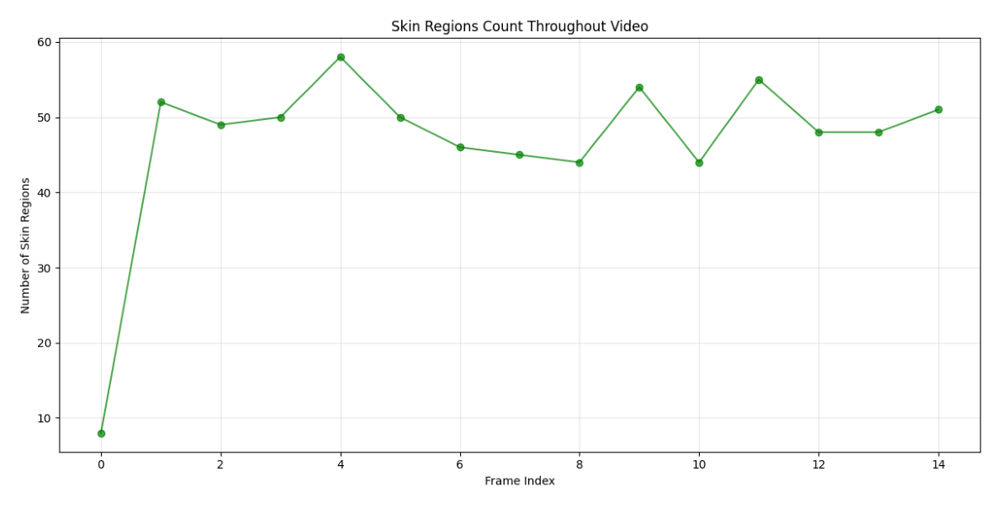


# Skin Percentage Vs Regions


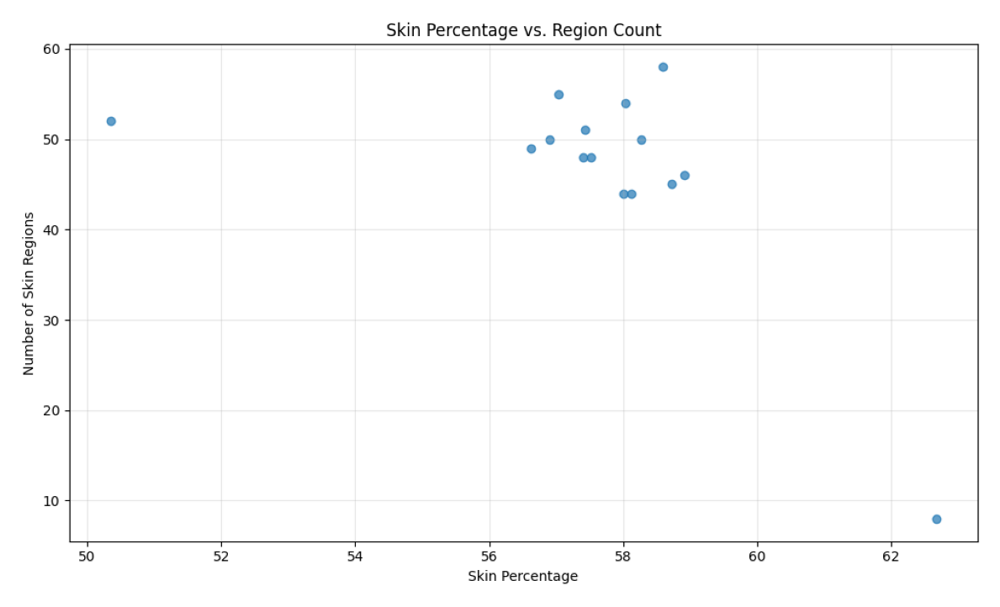


# Skin Regional Distribution


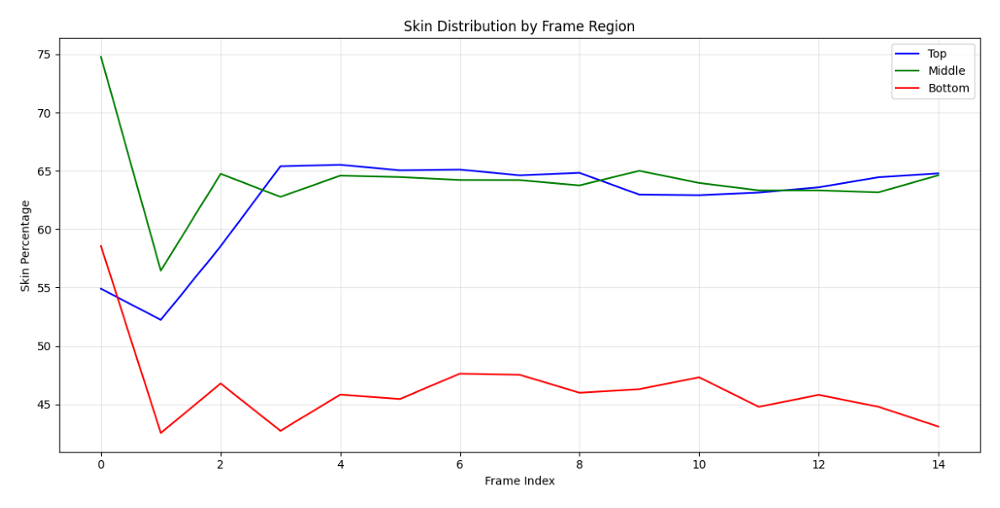


SAMPLE SKIN HEATMAPS FOR VIDEO 1


FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 1

Showing first 10 of 15 frames:


,filename,skin_percentage,skin_regions,top_percentage,middle_percentage,bottom_percentage,max_region_size
0,frame_0000.jpg,62.675646,8,54.899295,74.765294,58.546147,346732
1,frame_0001.jpg,50.348070,52,52.219778,56.445503,42.526576,203137
2,frame_0002.jpg,56.629435,49,58.535964,64.744725,46.773684,250899
3,frame_0003.jpg,56.905789,50,65.394876,62.779509,42.709861,248301
4,frame_0004.jpg,58.584425,58,65.518084,64.585879,45.821114,253156
5,frame_0005.jpg,58.261278,50,65.045617,64.464198,45.444872,253296
6,frame_0006.jpg,58.920966,46,65.107221,64.213201,47.615266,244906
7,frame_0007.jpg,58.722432,45,64.612862,64.206582,47.520059,251501
8,frame_0008.jpg,58.128187,44,64.826694,63.754989,45.973342,247191
9,frame_0009.jpg,58.027818,54,62.973994,64.999287,46.280344,248894




DISPLAYING VIDEO 2 ANALYSIS

Displaying skin analysis for Video 2
Date: 2025-03-06 11:57:42 | User: 6eama


SKIN ANALYSIS REPORT FOR VIDEO 2



# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: 2025-03-12 11:49:41
- User: 6eama
- Total Frames Analyzed: 18

## Skin Coverage Summary
- Average Skin Percentage: 39.56%
- Median Skin Percentage: 40.02%
- Range: 13.24% - 68.72%
- Standard Deviation: 11.62%

## Skin Regions Analysis
- Average Number of Skin Regions: 22.3
- Maximum Regions in a Frame: 41
- Minimum Regions in a Frame: 2

## Regional Distribution (Average)
- Top of Frame: 39.73%
- Middle of Frame: 64.61%
- Bottom of Frame: 14.46%

## Notable Frames
- Highest Skin Exposure: frame_0015.jpg (68.72%)
- Lowest Skin Exposure: frame_0014.jpg (13.24%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps



SKIN ANALYSIS STATISTICS FOR VIDEO 2



,avg_skin_percentage,med_skin_percentage,min_skin_percentage,max_skin_percentage,std_skin_percentage,avg_skin_regions,med_skin_regions,min_skin_regions,max_skin_regions,total_frames
0,39.560681,40.015327,13.244798,68.715244,11.622623,22.333333,23.5,2,41,18


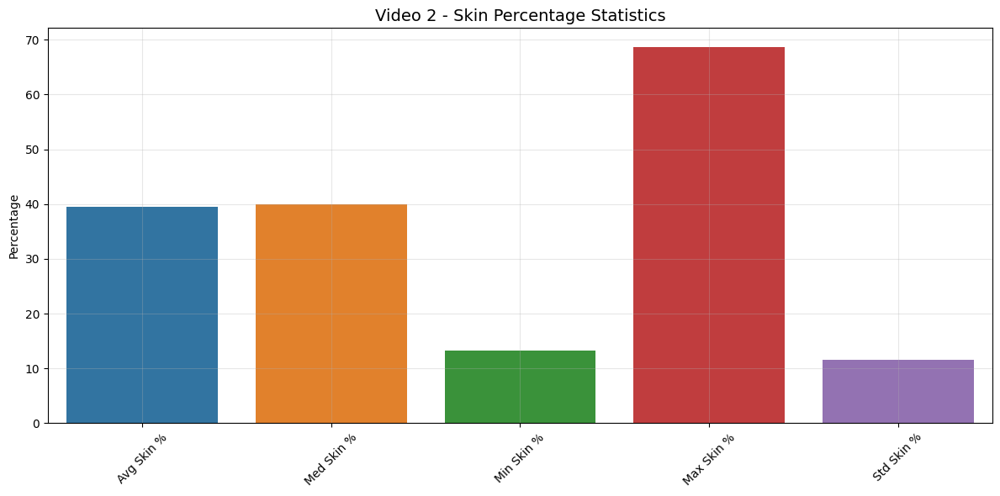


SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 2


# Skin Percentage Timeline


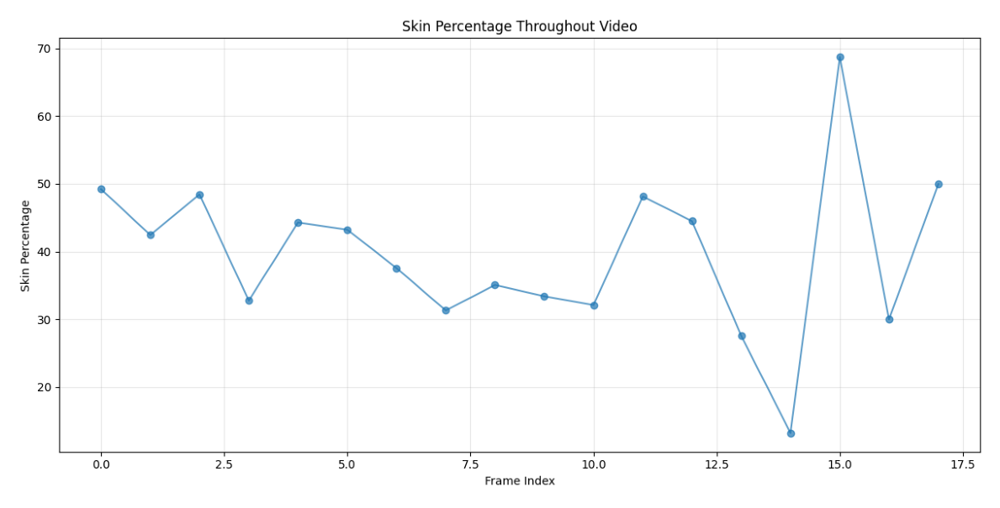


# Skin Percentage Distribution


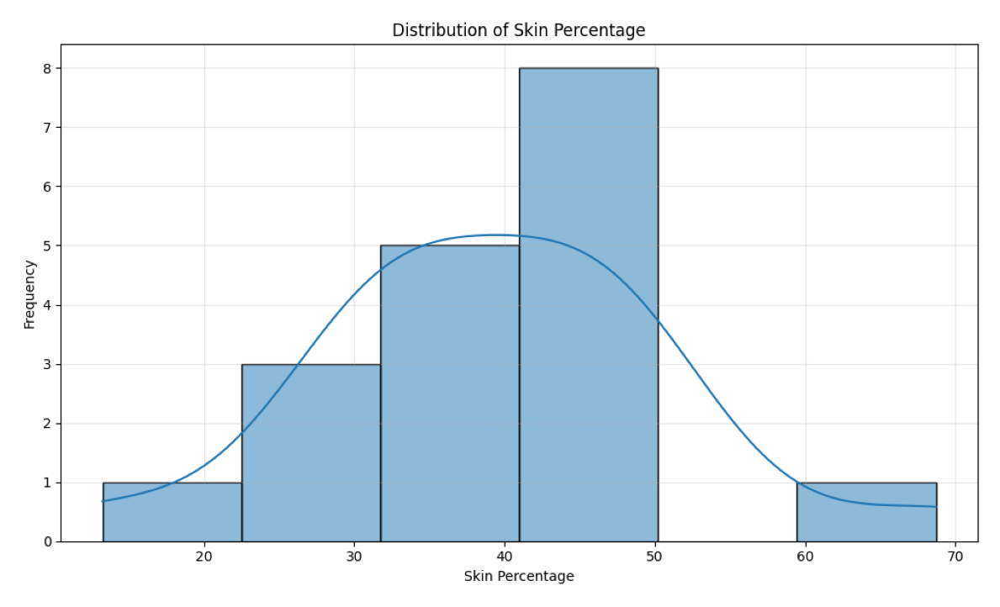


# Skin Regions Timeline


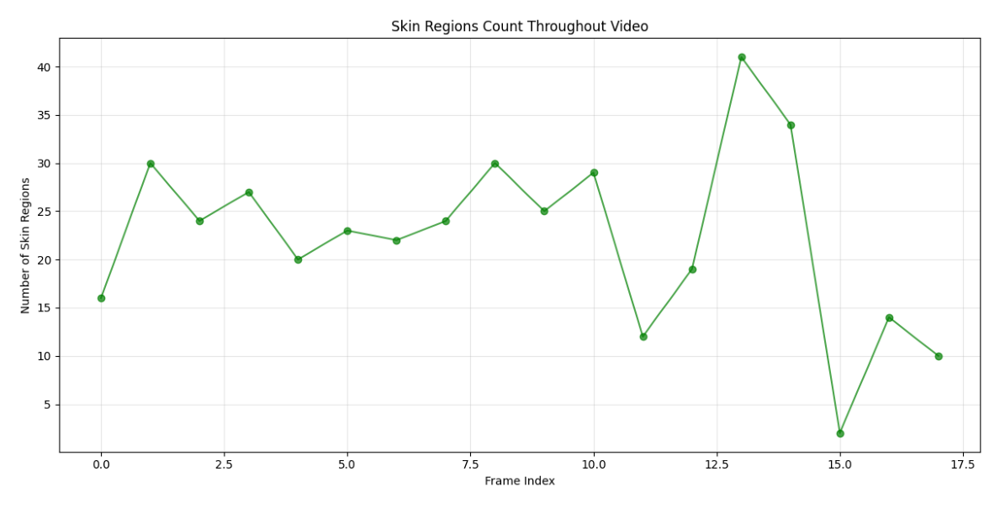


# Skin Percentage Vs Regions


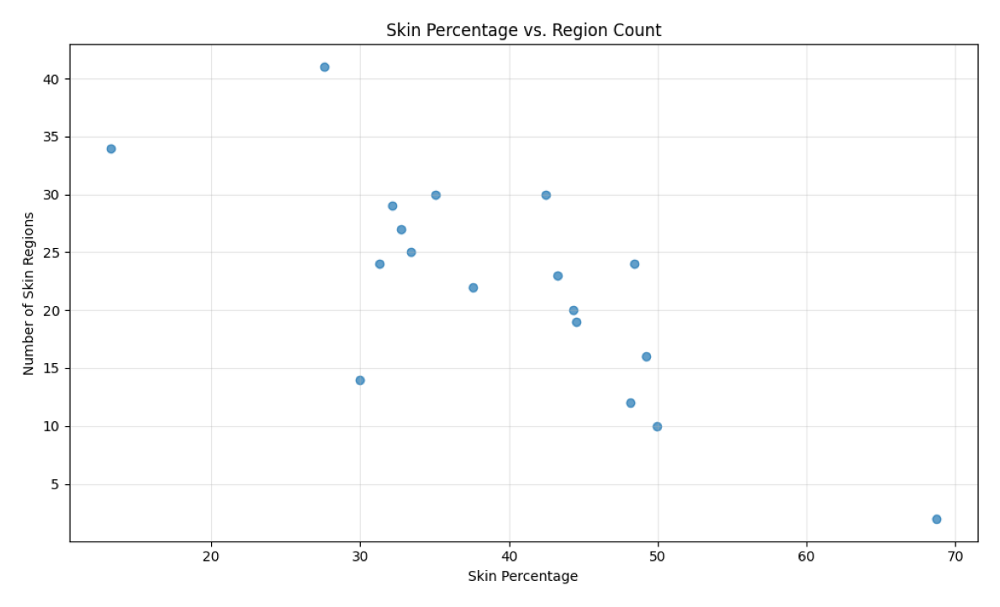


# Skin Regional Distribution


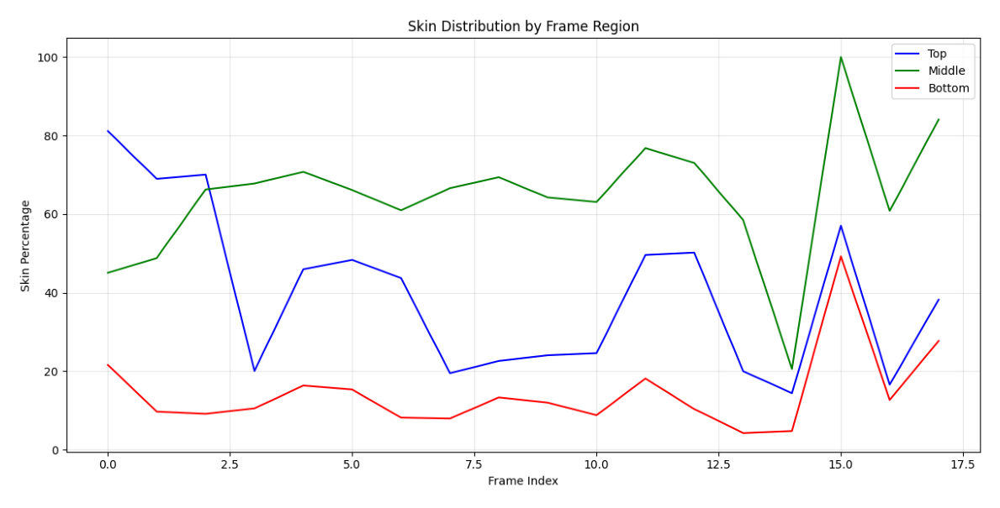


SAMPLE SKIN HEATMAPS FOR VIDEO 2


FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 2

Showing first 10 of 18 frames:


,filename,skin_percentage,skin_regions,top_percentage,middle_percentage,bottom_percentage,max_region_size
0,frame_0000.jpg,49.217733,16,81.120174,45.068630,21.608728,272825
1,frame_0001.jpg,42.456055,30,68.955177,48.816797,9.720695,222738
2,frame_0002.jpg,48.440891,24,70.028409,66.282278,9.154040,266790
3,frame_0003.jpg,32.770454,27,20.068630,67.786738,10.552094,120974
4,frame_0004.jpg,44.305081,20,45.970288,70.729472,16.345410,249212
5,frame_0005.jpg,43.239339,23,48.366223,66.137178,15.341418,235698
6,frame_0006.jpg,37.574599,22,43.696542,60.957356,8.180087,208705
7,frame_0007.jpg,31.327311,24,19.508594,66.618300,7.946909,169208
8,frame_0008.jpg,35.080973,30,22.631048,69.369603,13.345145,101437
9,frame_0009.jpg,33.413018,25,24.055067,64.262076,12.019897,108131




DISPLAYING VIDEO 3 ANALYSIS

Displaying skin analysis for Video 3
Date: 2025-03-06 11:57:42 | User: 6eama


SKIN ANALYSIS REPORT FOR VIDEO 3



# Skin Exposure Analysis Report
        
## Analysis Information
- Date and Time: 2025-03-12 11:49:51
- User: 6eama
- Total Frames Analyzed: 33

## Skin Coverage Summary
- Average Skin Percentage: 74.15%
- Median Skin Percentage: 76.02%
- Range: 42.72% - 98.61%
- Standard Deviation: 15.85%

## Skin Regions Analysis
- Average Number of Skin Regions: 15.7
- Maximum Regions in a Frame: 35
- Minimum Regions in a Frame: 1

## Regional Distribution (Average)
- Top of Frame: 73.17%
- Middle of Frame: 68.97%
- Bottom of Frame: 80.51%

## Notable Frames
- Highest Skin Exposure: frame_0021.jpg (98.61%)
- Lowest Skin Exposure: frame_0027.jpg (42.72%)

## Analysis Methodology
This analysis uses computer vision techniques including:
- Multiple color space skin detection (HSV, YCrCb, RGB)
- Connected component analysis for region counting
- Morphological operations for noise reduction
- Regional distribution analysis (top/middle/bottom)

## Visualizations
Various visualizations were created including:
- Skin percentage timeline
- Distribution of skin percentages across frames
- Skin region count timeline
- Correlation between skin percentage and region count
- Regional distribution of skin across frames
- Individual frame skin heatmaps



SKIN ANALYSIS STATISTICS FOR VIDEO 3



,avg_skin_percentage,med_skin_percentage,min_skin_percentage,max_skin_percentage,std_skin_percentage,avg_skin_regions,med_skin_regions,min_skin_regions,max_skin_regions,total_frames
0,74.145169,76.021152,42.719523,98.612467,15.854482,15.666667,15.0,1,35,33


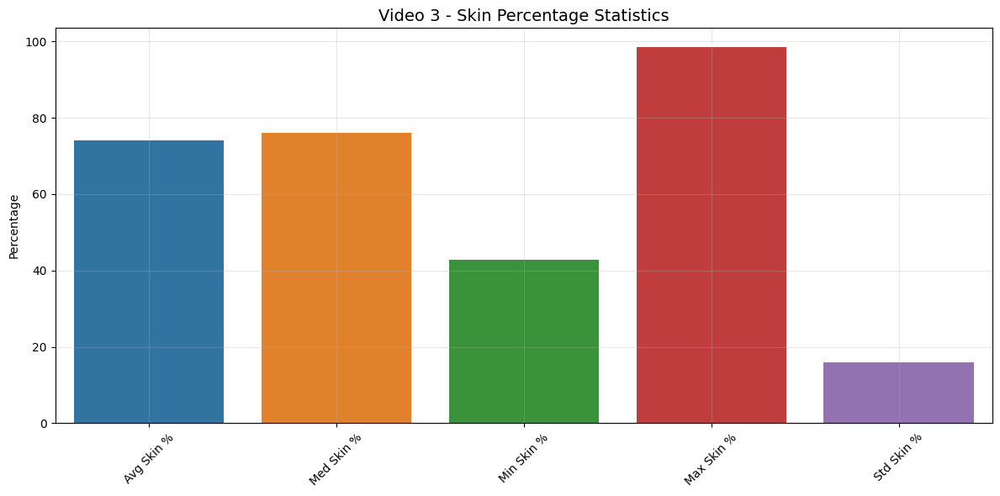


SKIN ANALYSIS VISUALIZATIONS FOR VIDEO 3


# Skin Percentage Timeline


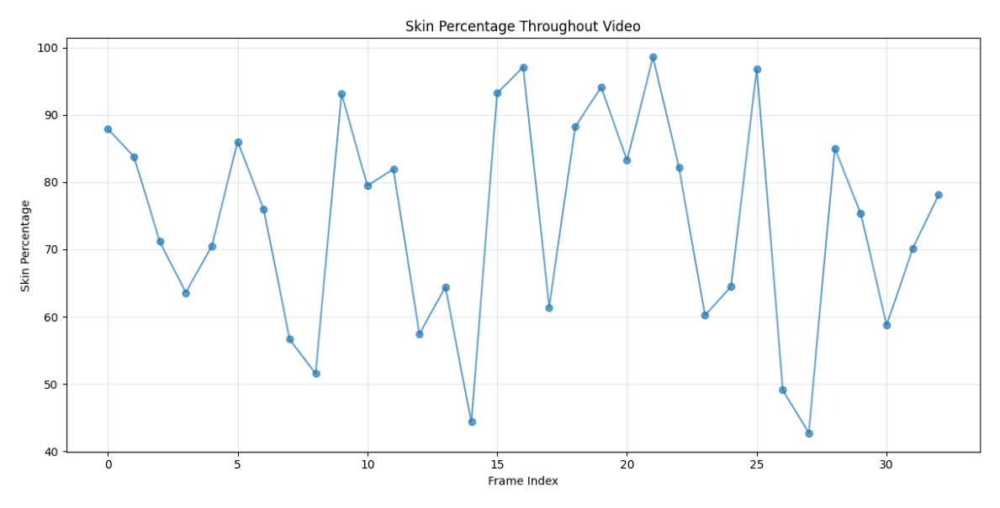


# Skin Percentage Distribution


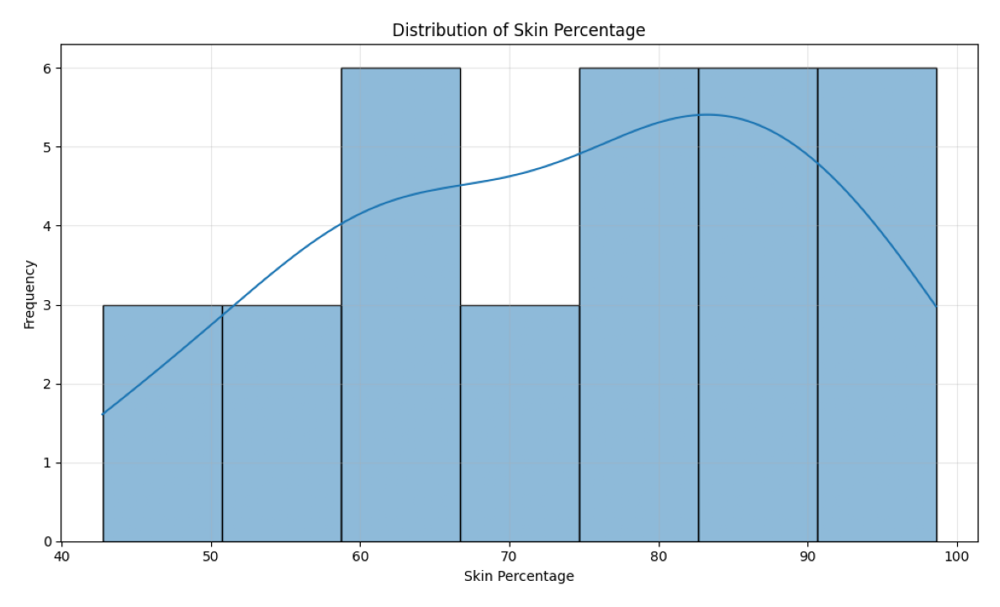


# Skin Regions Timeline


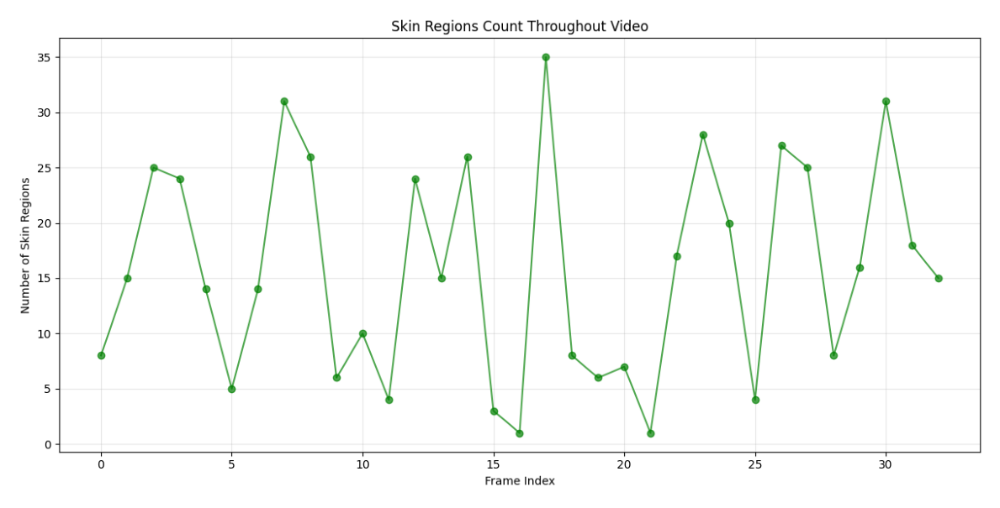


# Skin Percentage Vs Regions


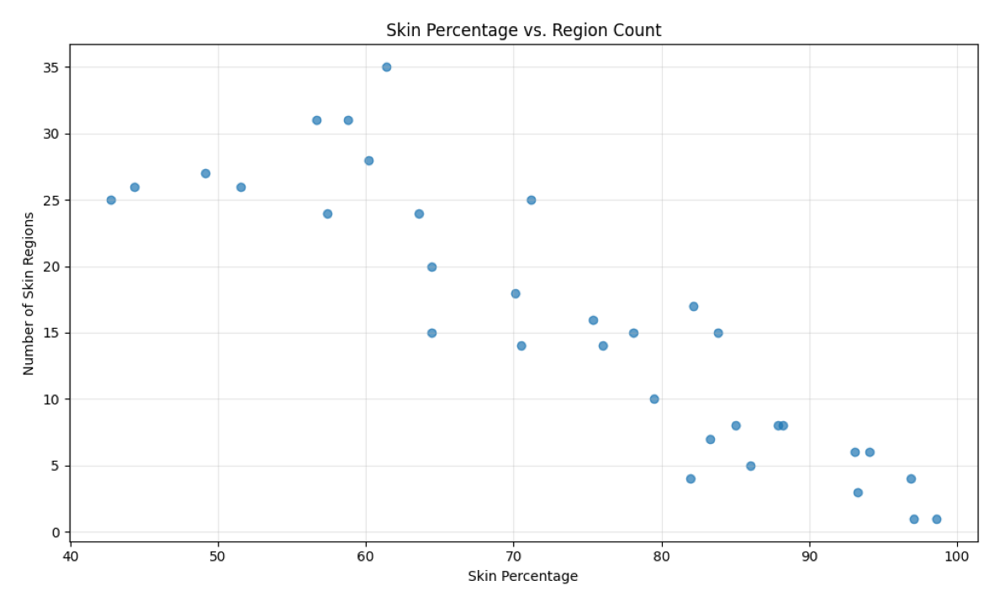


# Skin Regional Distribution


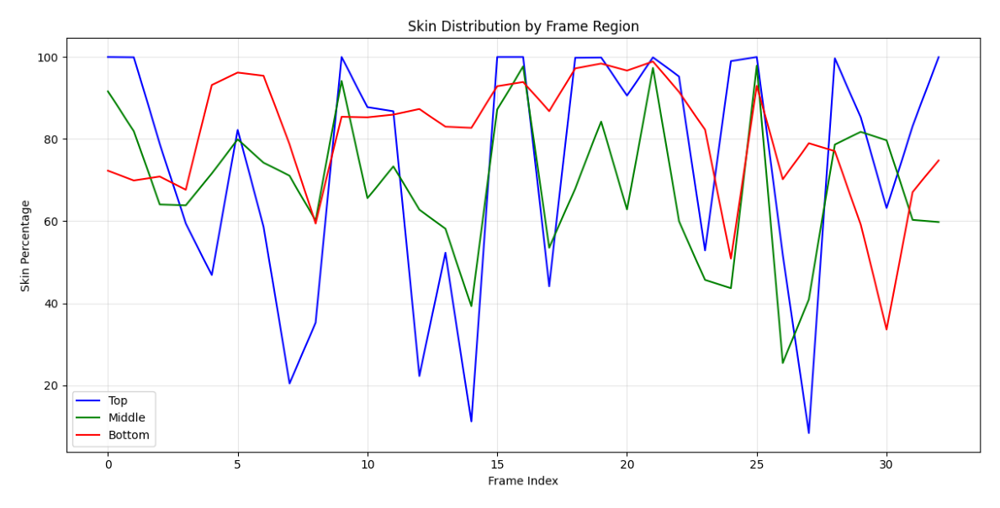


SAMPLE SKIN HEATMAPS FOR VIDEO 3


FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO 3

Showing first 10 of 33 frames:


,filename,skin_percentage,skin_regions,top_percentage,middle_percentage,bottom_percentage,max_region_size
0,frame_0000.jpg,87.878588,8,100.000000,91.622373,72.271098,494247
1,frame_0001.jpg,83.833313,15,99.931777,81.927643,69.886364,478489
2,frame_0002.jpg,71.173604,25,78.828100,64.047735,70.853698,315222
3,frame_0003.jpg,63.584052,24,59.444241,63.833394,67.660985,320292
4,frame_0004.jpg,70.478821,14,46.861763,71.593964,93.187419,369601
5,frame_0005.jpg,86.015828,5,82.213262,79.904896,96.181574,505706
6,frame_0006.jpg,76.021152,14,58.634734,74.241406,95.410252,446219
7,frame_0007.jpg,56.656392,31,20.409233,71.038001,78.688091,311332
8,frame_0008.jpg,51.548937,26,35.277676,60.098974,59.421330,294470
9,frame_0009.jpg,93.114217,6,100.000000,94.177155,85.438559,548486




Analysis display complete!


In [36]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, Markdown, HTML
import numpy as np
import glob
from datetime import datetime

# Set fixed date and user information as requested
CURRENT_DATE = "2025-03-06 11:57:42"
CURRENT_USER = "6eama"

def display_all_analyses():
    """Display all available skin analyses"""
    print(f"Current Date and Time (UTC): {CURRENT_DATE}")
    print(f"Current User's Login: {CURRENT_USER}\n")
    
    print("="*80)
    print("SKIN ANALYSIS RESULTS VIEWER")
    print("="*80)
    
    # Check which analyses are available
    available_videos = []
    for i in [1, 2, 3]:
        if os.path.exists(f'/kaggle/working/video{i}_skin_analysis'):
            available_videos.append(i)
    
    has_comparison = os.path.exists('/kaggle/working/skin_analysis_comparison')
    
    if not available_videos and not has_comparison:
        print("\n⚠️ No analysis results found! Please run the skin analysis script first.")
        return
    
    # Display the comparison analysis first (if available)
    if has_comparison:
        print("\n\n" + "="*80)
        print("DISPLAYING COMPARISON ANALYSIS")
        print("="*80 + "\n")
        
        display_skin_analysis_comparison('/kaggle/working/skin_analysis_comparison')
    
    # Display each video analysis
    for video_num in available_videos:
        print("\n\n" + "="*80)
        print(f"DISPLAYING VIDEO {video_num} ANALYSIS")
        print("="*80 + "\n")
        
        display_video_skin_analysis(video_num)
    
    print("\n\nAnalysis display complete!")

def display_video_skin_analysis(video_num):
    """
    Display skin analysis results for a specific video
    
    Parameters:
    - video_num: The video number (1, 2, or 3)
    """
    # Construct the path to the skin analysis directory
    analysis_dir = f'/kaggle/working/video{video_num}_skin_analysis'
    
    print(f"Displaying skin analysis for Video {video_num}")
    print(f"Date: {CURRENT_DATE} | User: {CURRENT_USER}\n")
    
    if not os.path.exists(analysis_dir):
        print(f"Error: Directory not found at {analysis_dir}")
        return
    
    # ---- Display the analysis report ----
    report_path = os.path.join(analysis_dir, "skin_analysis_report.md")
    
    if os.path.exists(report_path):
        print("\n" + "="*50)
        print(f"SKIN ANALYSIS REPORT FOR VIDEO {video_num}")
        print("="*50 + "\n")
        
        with open(report_path, 'r') as f:
            report_content = f.read()
        
        display(Markdown(report_content))
    
    # ---- Display statistics ----
    stats_path = os.path.join(analysis_dir, "skin_analysis_stats.csv")
    
    if os.path.exists(stats_path):
        print("\n" + "="*50)
        print(f"SKIN ANALYSIS STATISTICS FOR VIDEO {video_num}")
        print("="*50 + "\n")
        
        try:
            stats_df = pd.read_csv(stats_path)
            display(stats_df)
            
            # Create a visualization of key stats
            metrics = ['avg_skin_percentage', 'med_skin_percentage', 'min_skin_percentage', 
                      'max_skin_percentage', 'std_skin_percentage']
            
            if all(metric in stats_df.columns for metric in metrics):
                values = [stats_df[metric][0] for metric in metrics]
                
                # Clean up labels
                labels = [m.replace('_', ' ').replace('percentage', '%').title() for m in metrics]
                
                plt.figure(figsize=(12, 6))
                sns.barplot(x=labels, y=values)
                plt.title(f'Video {video_num} - Skin Percentage Statistics', fontsize=14)
                plt.ylabel('Percentage')
                plt.xticks(rotation=45)
                plt.grid(True, alpha=0.3)
                plt.tight_layout()
                plt.show()
        except Exception as e:
            print(f"Error displaying statistics: {e}")
    
    # ---- Display main analysis visualizations ----
    print("\n" + "="*50)
    print(f"SKIN ANALYSIS VISUALIZATIONS FOR VIDEO {video_num}")
    print("="*50 + "\n")
    
    main_visualizations = [
        "skin_percentage_timeline.png",
        "skin_percentage_distribution.png",
        "skin_regions_timeline.png",
        "skin_percentage_vs_regions.png",
        "skin_regional_distribution.png"
    ]
    
    for viz_name in main_visualizations:
        viz_path = os.path.join(analysis_dir, viz_name)
        
        if os.path.exists(viz_path):
            print(f"\n# {viz_name.replace('.png', '').replace('_', ' ').title()}")
            
            try:
                # Display the image
                img = plt.imread(viz_path)
                plt.figure(figsize=(12, 8))
                plt.imshow(img)
                plt.axis('off')
                plt.tight_layout()
                plt.show()
            except Exception as e:
                print(f"Error displaying visualization {viz_name}: {e}")
    
    # ---- Display sample heatmaps ----
    heatmap_dir = os.path.join(analysis_dir, "skin_heatmaps")
    
    if os.path.exists(heatmap_dir):
        print("\n" + "="*50)
        print(f"SAMPLE SKIN HEATMAPS FOR VIDEO {video_num}")
        print("="*50 + "\n")
        
        # Get a sample of heatmaps (at most 6)
        heatmap_files = glob.glob(os.path.join(heatmap_dir, "*.png"))
        
        if heatmap_files:
            try:
                if len(heatmap_files) > 6:
                    # Take evenly spaced samples
                    step = len(heatmap_files) // 6
                    sample_heatmaps = heatmap_files[::step][:6]
                else:
                    sample_heatmaps = heatmap_files
                
                # Display in a grid
                rows = (len(sample_heatmaps) + 1) // 2
                cols = min(2, len(sample_heatmaps))
                
                plt.figure(figsize=(cols * 8, rows * 6))
                
                for i, heatmap_path in enumerate(sample_heatmaps):
                    plt.subplot(rows, cols, i+1)
                    
                    img = plt.imread(heatmap_path)
                    plt.imshow(img)
                    plt.title(f"Frame {i+1}", fontsize=12)
                    plt.axis('off')
                
                plt.tight_layout()
                plt.show()
            except Exception as e:
                print(f"Error displaying heatmaps: {e}")
    
    # ---- Display frame analysis data ----
    frames_path = os.path.join(analysis_dir, "skin_analysis_by_frame.csv")
    
    if os.path.exists(frames_path):
        print("\n" + "="*50)
        print(f"FRAME-BY-FRAME SKIN ANALYSIS FOR VIDEO {video_num}")
        print("="*50 + "\n")
        
        try:
            frames_df = pd.read_csv(frames_path)
            
            # Show just the first few rows
            print(f"Showing first 10 of {len(frames_df)} frames:")
            display(frames_df.head(10))
        except Exception as e:
            print(f"Error displaying frame analysis: {e}")

def display_skin_analysis_comparison(comparison_dir):
    """
    Display the results of skin analysis comparison
    
    Parameters:
    - comparison_dir: Path to the skin analysis comparison directory
    """
    print(f"Loading skin analysis comparison data from: {comparison_dir}")
    print(f"Date: {CURRENT_DATE} | User: {CURRENT_USER}\n")
    
    if not os.path.exists(comparison_dir):
        print(f"Error: Directory not found at {comparison_dir}")
        return
    
    # ---- Display comparison images ----
    print("\n" + "="*50)
    print("COMPARISON VISUALIZATIONS")
    print("="*50 + "\n")
    
    image_files = []
    for file in os.listdir(comparison_dir):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_files.append(os.path.join(comparison_dir, file))
    
    print(f"Found {len(image_files)} comparison visualizations")
    
    # Display each image
    for img_path in image_files:
        img_name = os.path.basename(img_path)
        print(f"\n# {img_name.replace('.png', '').replace('_', ' ').title()}")
        
        try:
            # Display the image
            img = plt.imread(img_path)
            plt.figure(figsize=(12, 8))
            plt.imshow(img)
            plt.axis('off')
            plt.title(img_name.replace('.png', '').replace('_', ' ').title(), fontsize=14)
            plt.tight_layout()
            plt.show()
        except Exception as e:
            print(f"Error displaying image {img_name}: {e}")
    
    # ---- Display markdown reports ----
    print("\n" + "="*50)
    print("COMPARISON REPORTS")
    print("="*50 + "\n")
    
    md_files = []
    for file in os.listdir(comparison_dir):
        if file.lower().endswith('.md'):
            md_files.append(os.path.join(comparison_dir, file))
    
    print(f"Found {len(md_files)} analysis reports")
    
    for md_path in md_files:
        try:
            with open(md_path, 'r') as f:
                report_content = f.read()
                
            print("\n" + "="*50)
            print(f"REPORT: {os.path.basename(md_path)}")
            print("="*50 + "\n")
            
            # Display the markdown report
            display(Markdown(report_content))
        except Exception as e:
            print(f"Error displaying report {os.path.basename(md_path)}: {e}")
    
    # ---- Display comparison CSV data ----
    print("\n" + "="*50)
    print("COMPARISON DATA")
    print("="*50 + "\n")
    
    csv_files = []
    for file in os.listdir(comparison_dir):
        if file.lower().endswith('.csv'):
            csv_files.append(os.path.join(comparison_dir, file))
    
    for csv_path in csv_files:
        csv_name = os.path.basename(csv_path)
        print(f"\n# {csv_name.replace('.csv', '').replace('_', ' ').title()}")
        
        try:
            df = pd.read_csv(csv_path)
            display(df)
            
            # Create a visualization if possible
            if df.shape[1] > 1 and df.shape[0] > 0:
                plt.figure(figsize=(10, 6))
                
                # If it's a comparison with videos as columns
                if set(['Video 1', 'Video 2', 'Video 3']).intersection(set(df.columns)):
                    sns.heatmap(df, annot=True, cmap='YlGnBu', fmt='.2f')
                    plt.title(f"{csv_name.replace('.csv', '').replace('_', ' ').title()}")
                
                plt.tight_layout()
                plt.show()
                
        except Exception as e:
            print(f"Error displaying CSV {csv_name}: {e}")

# Execute the display function to show all available analyses
display_all_analyses()

In [ ]:
# import os
# import cv2
# import numpy as np
# from PIL import Image
# from matplotlib import pyplot as plt
# import seaborn as sns
# from tqdm import tqdm
# import pandas as pd
# from IPython.display import display, Image as IPImage

# def analyze_images(dataset_path):
#     results = []
#     image_files = []
    
#     # Get all image files
#     for dirname, _, filenames in os.walk(dataset_path):
#         for filename in filenames:
#             if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
#                 image_files.append(os.path.join(dirname, filename))
    
#     output_dir = '/kaggle/working/random/12345/analysis_results'
#     os.makedirs(output_dir, exist_ok=True)
    
#     # Load face cascade
#     try:
#         face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
#         if face_cascade.empty():
#             raise Exception("Error loading face cascade classifier")
#     except Exception as e:
#         print(f"Error loading face cascade: {e}")
#         return []

#     for image_path in tqdm(image_files, desc="Analyzing images"):
#         # Initialize default values
#         image_result = {
#             'filename': os.path.basename(image_path),
#             'size': None,
#             'format': None,
#             'face_count': 0,
#             'average_exposure': 0,
#             'skin_percentage': 0,
#             'brightness': 0,
#             'contrast': 0,
#             'red_mean': 0,
#             'green_mean': 0,
#             'blue_mean': 0
#         }
        
#         try:
#             # Read image
#             cv_image = cv2.imread(image_path)
#             pil_image = Image.open(image_path)
            
#             if cv_image is None or pil_image is None:
#                 print(f"Error loading image: {image_path}")
#                 results.append(image_result)
#                 continue
                
#             rgb_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
            
#             # Update basic image info
#             image_result['size'] = pil_image.size
#             image_result['format'] = pil_image.format
            
#             # Face detection
#             gray = cv2.cvtColor(cv_image, cv2.COLOR_BGR2GRAY)
#             faces = face_cascade.detectMultiScale(gray, 1.1, 4)
#             image_result['face_count'] = len(faces)
            
#             # Calculate metrics
#             image_result['average_exposure'] = float(np.mean(gray))
            
#             # Skin detection
#             hsv_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2HSV)
#             lower_skin = np.array([0, 20, 70])
#             upper_skin = np.array([20, 255, 255])
#             skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)
#             image_result['skin_percentage'] = float((np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])) * 100)
            
#             # Additional metrics
#             image_result['brightness'] = float(np.mean(rgb_image))
#             image_result['contrast'] = float(np.std(gray))
#             image_result['red_mean'] = float(np.mean(rgb_image[:,:,0]))
#             image_result['green_mean'] = float(np.mean(rgb_image[:,:,1]))
#             image_result['blue_mean'] = float(np.mean(rgb_image[:,:,2]))
            
#             # Create visualization
#             plt.figure(figsize=(15, 10))
            
#             plt.subplot(2, 2, 1)
#             plt.imshow(rgb_image)
#             plt.title('Original Image')
            
#             plt.subplot(2, 2, 2)
#             img_with_faces = rgb_image.copy()
#             for (x, y, w, h) in faces:
#                 cv2.rectangle(img_with_faces, (x, y), (x+w, y+h), (0, 255, 0), 2)
#             plt.imshow(img_with_faces)
#             plt.title(f'Face Detection ({len(faces)} faces)')
            
#             plt.subplot(2, 2, 3)
#             sns.heatmap(gray, cmap='hot')
#             plt.title('Intensity Heatmap')
            
#             plt.subplot(2, 2, 4)
#             plt.hist(gray.ravel(), 256, [0, 256])
#             plt.title('Intensity Histogram')
            
#             plt.tight_layout()
            
#             output_path = os.path.join(output_dir, f'analysis_{os.path.basename(image_path)}.png')
#             plt.savefig(output_path)
#             plt.close()
            
#             # Display the image
#             display(IPImage(filename=output_path))
            
#         except Exception as e:
#             print(f"Error processing {image_path}: {str(e)}")
        
#         results.append(image_result)
    
#     return results

# def create_analysis_report(results):
#     if not results:
#         print("No results to analyze!")
#         return {}, pd.DataFrame()
    
#     # Convert results to DataFrame
#     df = pd.DataFrame(results)
    
#     # Basic statistics
#     stats = {
#         'Total Images': len(df),
#         'Images with Faces': len(df[df['face_count'] > 0]),
#         'Average Face Count': df['face_count'].mean(),
#         'Average Exposure': df['average_exposure'].mean(),
#         'Average Skin Percentage': df['skin_percentage'].mean(),
#         'Average Brightness': df['brightness'].mean(),
#         'Average Contrast': df['contrast'].mean(),
#         'Average Red': df['red_mean'].mean(),
#         'Average Green': df['green_mean'].mean(),
#         'Average Blue': df['blue_mean'].mean()
#     }
    
#     # Create summary visualizations
#     plt.figure(figsize=(15, 15))
    
#     plt.subplot(3, 2, 1)
#     sns.histplot(data=df, x='face_count')
#     plt.title('Face Count Distribution')
    
#     plt.subplot(3, 2, 2)
#     sns.histplot(data=df, x='average_exposure')
#     plt.title('Exposure Distribution')
    
#     plt.subplot(3, 2, 3)
#     sns.histplot(data=df, x='skin_percentage')
#     plt.title('Skin Percentage Distribution')
    
#     plt.subplot(3, 2, 4)
#     sns.scatterplot(data=df, x='brightness', y='contrast')
#     plt.title('Brightness vs Contrast')
    
#     plt.subplot(3, 2, 5)
#     df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
#     plt.title('RGB Distribution')
    
#     plt.tight_layout()
#     plt.savefig('/kaggle/working/analysis_summary.png')
#     plt.close()
    
#     return stats, df

# def main():
#     dataset_path = '/kaggle/working/frame_vid'  # Replace with your dataset path
    
#     print("Starting image analysis...")
#     results = analyze_images(dataset_path)
    
#     print("\nGenerating analysis report...")
#     stats, df = create_analysis_report(results)
    
#     if stats:  # Only print if we have results
#         print("\nAnalysis Statistics:")
#         print("-" * 30)
#         for key, value in stats.items():
#             print(f"{key}: {value:.2f}")
        
#         df.to_csv('/kaggle/working/random/12345/analysis_results.csv', index=False)
#         print("\nAnalysis complete! Check the 'working' directory for results.")
#     else:
#         print("\nNo analysis results generated.")

# if __name__ == "__main__":
#     main()

In [ ]:
# import os
# import cv2
# import numpy as np
# from PIL import Image
# from matplotlib import pyplot as plt
# import seaborn as sns
# from tqdm import tqdm
# import pandas as pd
# from IPython.display import display, Image as IPImage

# def analyze_images(dataset_path):
#     results = []
#     image_files = []
    
#     # Get all image files
#     for dirname, _, filenames in os.walk(dataset_path):
#         for filename in filenames:
#             if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
#                 image_files.append(os.path.join(dirname, filename))
    
#     output_dir = '/kaggle/working/random/123/analysis_results'
#     os.makedirs(output_dir, exist_ok=True)
    
#     # Load face cascade
#     try:
#         face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
#         if face_cascade.empty():
#             raise Exception("Error loading face cascade classifier")
#     except Exception as e:
#         print(f"Error loading face cascade: {e}")
#         return []

#     for image_path in tqdm(image_files, desc="Analyzing images"):
#         # Initialize default values
#         image_result = {
#             'filename': os.path.basename(image_path),
#             'size': None,
#             'format': None,
#             'face_count': 0,
#             'average_exposure': 0,
#             'skin_percentage': 0,
#             'brightness': 0,
#             'contrast': 0,
#             'red_mean': 0,
#             'green_mean': 0,
#             'blue_mean': 0
#         }
        
#         try:
#             # Read image
#             cv_image = cv2.imread(image_path)
#             pil_image = Image.open(image_path)
            
#             if cv_image is None or pil_image is None:
#                 print(f"Error loading image: {image_path}")
#                 results.append(image_result)
#                 continue
                
#             rgb_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
            
#             # Update basic image info
#             image_result['size'] = pil_image.size
#             image_result['format'] = pil_image.format
            
#             # Face detection
#             gray = cv2.cvtColor(cv_image, cv2.COLOR_BGR2GRAY)
#             faces = face_cascade.detectMultiScale(gray, 1.1, 4)
#             image_result['face_count'] = len(faces)
            
#             # Calculate metrics
#             image_result['average_exposure'] = float(np.mean(gray))
            
#             # Skin detection
#             hsv_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2HSV)
#             lower_skin = np.array([0, 20, 70])
#             upper_skin = np.array([20, 255, 255])
#             skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)
#             image_result['skin_percentage'] = float((np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])) * 100)
            
#             # Additional metrics
#             image_result['brightness'] = float(np.mean(rgb_image))
#             image_result['contrast'] = float(np.std(gray))
#             image_result['red_mean'] = float(np.mean(rgb_image[:,:,0]))
#             image_result['green_mean'] = float(np.mean(rgb_image[:,:,1]))
#             image_result['blue_mean'] = float(np.mean(rgb_image[:,:,2]))
            
#             # Create visualization
#             plt.figure(figsize=(15, 10))
            
#             plt.subplot(2, 2, 1)
#             plt.imshow(rgb_image)
#             plt.title('Original Image')
            
#             plt.subplot(2, 2, 2)
#             img_with_faces = rgb_image.copy()
#             for (x, y, w, h) in faces:
#                 cv2.rectangle(img_with_faces, (x, y), (x+w, y+h), (0, 255, 0), 2)
#             plt.imshow(img_with_faces)
#             plt.title(f'Face Detection ({len(faces)} faces)')
            
#             plt.subplot(2, 2, 3)
#             sns.heatmap(gray, cmap='hot')
#             plt.title('Intensity Heatmap')
            
#             plt.subplot(2, 2, 4)
#             plt.hist(gray.ravel(), 256, [0, 256])
#             plt.title('Intensity Histogram')
            
#             plt.tight_layout()
            
#             output_path = os.path.join(output_dir, f'analysis_{os.path.basename(image_path)}.png')
#             plt.savefig(output_path)
#             plt.close()
            
#             # Display the image
#             display(IPImage(filename=output_path))
            
#         except Exception as e:
#             print(f"Error processing {image_path}: {str(e)}")
        
#         results.append(image_result)
    
#     return results

# def create_analysis_report(results):
#     if not results:
#         print("No results to analyze!")
#         return {}, pd.DataFrame()
    
#     # Convert results to DataFrame
#     df = pd.DataFrame(results)
    
#     # Basic statistics
#     stats = {
#         'Total Images': len(df),
#         'Images with Faces': len(df[df['face_count'] > 0]),
#         'Average Face Count': df['face_count'].mean(),
#         'Average Exposure': df['average_exposure'].mean(),
#         'Average Skin Percentage': df['skin_percentage'].mean(),
#         'Average Brightness': df['brightness'].mean(),
#         'Average Contrast': df['contrast'].mean(),
#         'Average Red': df['red_mean'].mean(),
#         'Average Green': df['green_mean'].mean(),
#         'Average Blue': df['blue_mean'].mean()
#     }
    
#     # Create summary visualizations
#     plt.figure(figsize=(15, 15))
    
#     plt.subplot(3, 2, 1)
#     sns.histplot(data=df, x='face_count')
#     plt.title('Face Count Distribution')
    
#     plt.subplot(3, 2, 2)
#     sns.histplot(data=df, x='average_exposure')
#     plt.title('Exposure Distribution')
    
#     plt.subplot(3, 2, 3)
#     sns.histplot(data=df, x='skin_percentage')
#     plt.title('Skin Percentage Distribution')
    
#     plt.subplot(3, 2, 4)
#     sns.scatterplot(data=df, x='brightness', y='contrast')
#     plt.title('Brightness vs Contrast')
    
#     plt.subplot(3, 2, 5)
#     df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
#     plt.title('RGB Distribution')
    
#     plt.tight_layout()
#     plt.savefig('/kaggle/working/random/123/analysis_summary.png')
#     plt.close()
    
#     return stats, df

# def main():
#     dataset_path = '/kaggle/working/frame_vide'  # Replace with your dataset path
    
#     print("Starting image analysis...")
#     results = analyze_images(dataset_path)
    
#     print("\nGenerating analysis report...")
#     stats, df = create_analysis_report(results)
    
#     if stats:  # Only print if we have results
#         print("\nAnalysis Statistics:")
#         print("-" * 30)
#         for key, value in stats.items():
#             print(f"{key}: {value:.2f}")
        
#         df.to_csv('/kaggle/working/random/123/analysis_results.csv', index=False)
#         print("\nAnalysis complete! Check the 'working' directory for results.")
#     else:
#         print("\nNo analysis results generated.")

# if __name__ == "__main__":
#     main()

In [ ]:
# import os
# import cv2
# import numpy as np
# from PIL import Image
# from matplotlib import pyplot as plt
# import seaborn as sns
# from tqdm import tqdm
# import pandas as pd
# from IPython.display import display, Image as IPImage

# def analyze_images(dataset_path):
#     results = []
#     image_files = []
#     for dirname, _, filenames in os.walk(dataset_path):
#         for filename in filenames:
#             if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
#                 image_files.append(os.path.join(dirname, filename))
    
#     output_dir = '/kaggle/working/analysis_results'
#     os.makedirs(output_dir, exist_ok=True)
    
#     face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    
#     for image_path in tqdm(image_files, desc="Analyzing images"):
#         try:
#             cv_image = cv2.imread(image_path)
#             pil_image = Image.open(image_path)
#             if cv_image is None or pil_image is None:
#                 continue
#             rgb_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
            
#             image_result = {
#                 'filename': os.path.basename(image_path),
#                 'size': pil_image.size,
#                 'format': pil_image.format,
#             }
            
#             gray = cv2.cvtColor(cv_image, cv2.COLOR_BGR2GRAY)
#             faces = face_cascade.detectMultiScale(gray, 1.1, 4)
#             image_result['face_count'] = len(faces)
#             image_result['average_exposure'] = np.mean(gray)

#             hsv_image = cv2.cvtColor(cv_image, cv2.COLOR_BGR2HSV)
#             lower_skin = np.array([0, 20, 70])
#             upper_skin = np.array([20, 255, 255])
#             skin_mask = cv2.inRange(hsv_image, lower_skin, upper_skin)
#             image_result['skin_percentage'] = (np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])) * 100
            
#             image_result['brightness'] = np.mean(rgb_image)
#             image_result['contrast'] = np.std(gray)
#             image_result['red_mean'] = np.mean(rgb_image[:,:,0])
#             image_result['green_mean'] = np.mean(rgb_image[:,:,1])
#             image_result['blue_mean'] = np.mean(rgb_image[:,:,2])
            
#             results.append(image_result)
            
#             plt.figure(figsize=(15, 10))
#             plt.subplot(2, 2, 1)
#             plt.imshow(rgb_image)
#             plt.title('Original Image')
            
#             plt.subplot(2, 2, 2)
#             img_with_faces = rgb_image.copy()
#             for (x, y, w, h) in faces:
#                 cv2.rectangle(img_with_faces, (x, y), (x+w, y+h), (0, 255, 0), 2)
#             plt.imshow(img_with_faces)
#             plt.title(f'Face Detection ({len(faces)} faces)')
            
#             plt.subplot(2, 2, 3)
#             sns.heatmap(gray, cmap='hot')
#             plt.title('Intensity Heatmap')

#             plt.subplot(2, 2, 4)
#             plt.hist(gray.ravel(), 256, [0, 256])
#             plt.title('Intensity Histogram')
            
#             plt.tight_layout()
#             output_path = os.path.join(output_dir, f'analysis_{os.path.basename(image_path)}')
#             plt.savefig(output_path)
#             plt.close()

#             display(IPImage(filename=output_path))

#         except Exception as e:
#             print(f"Error processing {image_path}: {str(e)}")


# def create_analysis_report(results):
#     df = pd.DataFrame(results)
#     stats = {
#         'Total Images': len(df),
#         'Images with Faces': len(df[df['face_count'] > 0]),
#         'Average Face Count': df['face_count'].mean(),
#         'Average Exposure': df['average_exposure'].mean(),
#         'Average Skin Percentage': df['skin_percentage'].mean(),
#         'Average Brightness': df['brightness'].mean(),
#         'Average Contrast': df['contrast'].mean(),
#         'Average Red': df['red_mean'].mean(),
#         'Average Green': df['green_mean'].mean(),
#         'Average Blue': df['blue_mean'].mean()
#     }
    
#     plt.figure(figsize=(15, 15))
#     plt.subplot(3, 2, 1)
#     sns.histplot(data=df, x='face_count')
#     plt.title('Face Count Distribution')
    
#     plt.subplot(3, 2, 2)
#     sns.histplot(data=df, x='average_exposure')
#     plt.title('Exposure Distribution')

#     plt.subplot(3, 2, 3)
#     sns.histplot(data=df, x='skin_percentage')
#     plt.title('Skin Percentage Distribution')
    
#     plt.subplot(3, 2, 4)
#     sns.scatterplot(data=df, x='brightness', y='contrast')
#     plt.title('Brightness vs Contrast')

#     plt.subplot(3, 2, 5)
#     df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
#     plt.title('RGB Distribution')
    
#     plt.tight_layout()
#     plt.savefig('/kaggle/working/analysis_summary.png')
#     plt.close()
    
#     return stats, df


# def main():
#     dataset_path = '/kaggle/working/frame_vi'  # Replace with your dataset path
#     print("Starting image analysis...")
#     results = analyze_images(dataset_path)
#     print("\nGenerating analysis report...")
#     stats, df = create_analysis_report(results)

#     print("\nAnalysis Statistics:")
#     print("-" * 30)
#     for key, value in stats.items():
#         print(f"{key}: {value:.2f}")
    
#     df.to_csv('/kaggle/working/analysis_results.csv', index=False)  # Simplified path
#     print("\nAnalysis complete! Check the 'working' directory for results.")

# if __name__ == "__main__":
#     main()

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np

# def analyze_image_data(csv_path):
#     # Read the CSV file
#     df = pd.read_csv(csv_path)
    
#     # Display basic information about the dataset
#     print("\n=== Dataset Information ===")
#     print(df.info())
    
#     # Display statistical summary
#     print("\n=== Statistical Summary ===")
#     print(df.describe())
    
#     # Create visualizations
#     plt.figure(figsize=(15, 10))
    
#     # 1. Distribution of face counts
#     plt.subplot(2, 3, 1)
#     sns.histplot(data=df, x='face_count')
#     plt.title('Distribution of Face Counts')
    
#     # 2. Exposure distribution
#     plt.subplot(2, 3, 2)
#     sns.histplot(data=df, x='average_exposure')
#     plt.title('Distribution of Average Exposure')
    
#     # 3. Skin percentage distribution
#     plt.subplot(2, 3, 3)
#     sns.histplot(data=df, x='skin_percentage')
#     plt.title('Distribution of Skin Percentage')
    
#     # 4. RGB means comparison
#     plt.subplot(2, 3, 4)
#     df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
#     plt.title('RGB Channel Means')
    
#     # 5. Brightness vs Contrast scatter
#     plt.subplot(2, 3, 5)
#     sns.scatterplot(data=df, x='brightness', y='contrast')
#     plt.title('Brightness vs Contrast')
    
#     plt.tight_layout()
#     plt.show()
    
#     # Additional analysis
#     print("\n=== Additional Analysis ===")
    
#     # File format distribution
#     print("\nFile Format Distribution:")
#     print(df['format'].value_counts())
    
#     # Average RGB values
#     print("\nAverage RGB Values:")
#     print(f"Red: {df['red_mean'].mean():.2f}")
#     print(f"Green: {df['green_mean'].mean():.2f}")
#     print(f"Blue: {df['blue_mean'].mean():.2f}")
    
#     # Correlation analysis
#     print("\nCorrelation Matrix:")
#     correlation_matrix = df[['average_exposure', 'skin_percentage', 'brightness', 
#                            'contrast', 'red_mean', 'green_mean', 'blue_mean']].corr()
#     print(correlation_matrix.round(2))
    
#     # File size statistics
#     print("\nFile Size Statistics (in bytes):")
#     print(df['size'].describe())
    
#     # Images with faces
#     print("\nImages with Faces:")
#     print(f"Total images with faces: {(df['face_count'] > 0).sum()}")
#     print(f"Percentage of images with faces: {((df['face_count'] > 0).sum() / len(df) * 100):.2f}%")
    
#     # Create a heatmap of correlations
#     plt.figure(figsize=(10, 8))
#     sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
#     plt.title('Correlation Heatmap')
#     plt.show()

# # Usage
# csv_file_path = '/kaggle/working/analysis_results.csv'  # Replace with your CSV file path
# analyze_image_data(csv_file_path)

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np

# def analyze_image_data(cs_path):
#     # Read the CSV file
#     df = pd.read_csv(cs_path)
    
#     # Display basic information about the dataset
#     print("\n=== Dataset Information ===")
#     print(df.info())
    
#     # Display statistical summary
#     print("\n=== Statistical Summary ===")
#     print(df.describe())
    
#     # Create visualizations
#     plt.figure(figsize=(15, 10))
    
#     # 1. Distribution of face counts
#     plt.subplot(2, 3, 1)
#     sns.histplot(data=df, x='face_count')
#     plt.title('Distribution of Face Counts')
    
#     # 2. Exposure distribution
#     plt.subplot(2, 3, 2)
#     sns.histplot(data=df, x='average_exposure')
#     plt.title('Distribution of Average Exposure')
    
#     # 3. Skin percentage distribution
#     plt.subplot(2, 3, 3)
#     sns.histplot(data=df, x='skin_percentage')
#     plt.title('Distribution of Skin Percentage')
    
#     # 4. RGB means comparison
#     plt.subplot(2, 3, 4)
#     df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
#     plt.title('RGB Channel Means')
    
#     # 5. Brightness vs Contrast scatter
#     plt.subplot(2, 3, 5)
#     sns.scatterplot(data=df, x='brightness', y='contrast')
#     plt.title('Brightness vs Contrast')
    
#     plt.tight_layout()
#     plt.show()
    
#     # Additional analysis
#     print("\n=== Additional Analysis ===")
    
#     # File format distribution
#     print("\nFile Format Distribution:")
#     print(df['format'].value_counts())
    
#     # Average RGB values
#     print("\nAverage RGB Values:")
#     print(f"Red: {df['red_mean'].mean():.2f}")
#     print(f"Green: {df['green_mean'].mean():.2f}")
#     print(f"Blue: {df['blue_mean'].mean():.2f}")
    
#     # Correlation analysis
#     print("\nCorrelation Matrix:")
#     correlation_matrix = df[['average_exposure', 'skin_percentage', 'brightness', 
#                            'contrast', 'red_mean', 'green_mean', 'blue_mean']].corr()
#     print(correlation_matrix.round(2))
    
#     # File size statistics
#     print("\nFile Size Statistics (in bytes):")
#     print(df['size'].describe())
    
#     # Images with faces
#     print("\nImages with Faces:")
#     print(f"Total images with faces: {(df['face_count'] > 0).sum()}")
#     print(f"Percentage of images with faces: {((df['face_count'] > 0).sum() / len(df) * 100):.2f}%")
    
#     # Create a heatmap of correlations
#     plt.figure(figsize=(10, 8))
#     sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
#     plt.title('Correlation Heatmap')
#     plt.show()

# # Usage
# cs_file_path = '/kaggle/working/random/12345/analysis_results.csv'  # Replace with your CSV file path
# analyze_image_data(cs_file_path)

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np

# def analyze_image_data(c_path):
#     # Read the CSV file
#     df = pd.read_csv(c_path)
    
#     # Display basic information about the dataset
#     print("\n=== Dataset Information ===")
#     print(df.info())
    
#     # Display statistical summary
#     print("\n=== Statistical Summary ===")
#     print(df.describe())
    
#     # Create visualizations
#     plt.figure(figsize=(15, 10))
    
#     # 1. Distribution of face counts
#     plt.subplot(2, 3, 1)
#     sns.histplot(data=df, x='face_count')
#     plt.title('Distribution of Face Counts')
    
#     # 2. Exposure distribution
#     plt.subplot(2, 3, 2)
#     sns.histplot(data=df, x='average_exposure')
#     plt.title('Distribution of Average Exposure')
    
#     # 3. Skin percentage distribution
#     plt.subplot(2, 3, 3)
#     sns.histplot(data=df, x='skin_percentage')
#     plt.title('Distribution of Skin Percentage')
    
#     # 4. RGB means comparison
#     plt.subplot(2, 3, 4)
#     df[['red_mean', 'green_mean', 'blue_mean']].boxplot()
#     plt.title('RGB Channel Means')
    
#     # 5. Brightness vs Contrast scatter
#     plt.subplot(2, 3, 5)
#     sns.scatterplot(data=df, x='brightness', y='contrast')
#     plt.title('Brightness vs Contrast')
    
#     plt.tight_layout()
#     plt.show()
    
#     # Additional analysis
#     print("\n=== Additional Analysis ===")
    
#     # File format distribution
#     print("\nFile Format Distribution:")
#     print(df['format'].value_counts())
    
#     # Average RGB values
#     print("\nAverage RGB Values:")
#     print(f"Red: {df['red_mean'].mean():.2f}")
#     print(f"Green: {df['green_mean'].mean():.2f}")
#     print(f"Blue: {df['blue_mean'].mean():.2f}")
    
#     # Correlation analysis
#     print("\nCorrelation Matrix:")
#     correlation_matrix = df[['average_exposure', 'skin_percentage', 'brightness', 
#                            'contrast', 'red_mean', 'green_mean', 'blue_mean']].corr()
#     print(correlation_matrix.round(2))
    
#     # File size statistics
#     print("\nFile Size Statistics (in bytes):")
#     print(df['size'].describe())
    
#     # Images with faces
#     print("\nImages with Faces:")
#     print(f"Total images with faces: {(df['face_count'] > 0).sum()}")
#     print(f"Percentage of images with faces: {((df['face_count'] > 0).sum() / len(df) * 100):.2f}%")
    
#     # Create a heatmap of correlations
#     plt.figure(figsize=(10, 8))
#     sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
#     plt.title('Correlation Heatmap')
#     plt.show()

# # Usage
# c_file_path = '/kaggle/working/random/6789/analysis_results.csv'  # Replace with your CSV file path
# analyze_image_data(c_file_path)

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# import numpy as np
# import os
# from PIL import Image

# def analyze_image_data(c_path, image_dir):
#     # Read the CSV file
#     df = pd.read_csv(c_path)
    
#     # Existing analysis code (previous visualizations and prints)
    
#     # Comprehensive Image Display Function
#     def display_images(df, image_dir, num_images=10, 
#                        criteria=None, 
#                        sort_by=None, 
#                        ascending=False,
#                        display_mode='grid'):
#         """
#         Advanced image display with multiple viewing modes
        
#         Parameters:
#         - df: DataFrame containing image metadata
#         - image_dir: Directory containing the images
#         - num_images: Number of images to display
#         - criteria: Optional filtering condition
#         - sort_by: Optional column to sort by
#         - ascending: Sort order
#         - display_mode: 'grid', 'carousel', or 'detailed'
#         """
#         # Apply filtering if criteria is provided
#         if criteria is not None:
#             filtered_df = df[criteria]
#         else:
#             filtered_df = df
        
#         # Sort if sort_by is specified
#         if sort_by is not None:
#             filtered_df = filtered_df.sort_values(by=sort_by, ascending=ascending)
        
#         # Limit to num_images
#         filtered_df = filtered_df.head(num_images)
        
#         # Grid Display Mode
#         if display_mode == 'grid':
#             # Calculate grid dimensions
#             n = len(filtered_df)
#             cols = min(5, n)  # Max 5 columns
#             rows = (n + cols - 1) // cols
            
#             plt.figure(figsize=(15, 3*rows))
            
#             for i, (index, row) in enumerate(filtered_df.iterrows(), 1):
#                 plt.subplot(rows, cols, i)
                
#                 # Construct full image path
#                 image_path = os.path.join(image_dir, row['filename'])
                
#                 # Open and display image
#                 try:
#                     img = Image.open(image_path)
#                     plt.imshow(img)
#                     plt.title(f"Faces: {row['face_count']}\nExposure: {row['average_exposure']:.2f}", fontsize=8)
#                 except Exception as e:
#                     print(f"Error loading image {image_path}: {e}")
                
#                 plt.axis('off')
            
#             plt.tight_layout()
#             plt.show()
        
#         # Carousel Display Mode
#         elif display_mode == 'carousel':
#             plt.figure(figsize=(15, 5))
            
#             for i, (index, row) in enumerate(filtered_df.iterrows()):
#                 plt.clf()  # Clear the current figure
                
#                 # Construct full image path
#                 image_path = os.path.join(image_dir, row['filename'])
                
#                 try:
#                     img = Image.open(image_path)
#                     plt.imshow(img)
#                     plt.title(f"Image {i+1}/{len(filtered_df)}\n"
#                               f"Filename: {row['filename']}\n"
#                               f"Faces: {row['face_count']}\n"
#                               f"Exposure: {row['average_exposure']:.2f}\n"
#                               f"Skin %: {row['skin_percentage']:.2f}", fontsize=10)
#                     plt.axis('off')
#                     plt.tight_layout()
#                     plt.pause(2)  # Pause for 2 seconds between images
#                 except Exception as e:
#                     print(f"Error loading image {image_path}: {e}")
            
#             plt.close()
        
#         # Detailed Display Mode
#         elif display_mode == 'detailed':
#             for i, (index, row) in enumerate(filtered_df.iterrows(), 1):
#                 plt.figure(figsize=(15, 5))
                
#                 # Image subplot
#                 plt.subplot(1, 2, 1)
#                 image_path = os.path.join(image_dir, row['filename'])
                
#                 try:
#                     img = Image.open(image_path)
#                     plt.imshow(img)
#                     plt.title(f"Image {i}")
#                     plt.axis('off')
                    
#                     # Metadata subplot
#                     plt.subplot(1, 2, 2)
#                     metadata_text = (
#                         f"Filename: {row['filename']}\n"
#                         f"Face Count: {row['face_count']}\n"
#                         f"Average Exposure: {row['average_exposure']:.2f}\n"
#                         f"Skin Percentage: {row['skin_percentage']:.2f}%\n"
#                         f"Red Mean: {row['red_mean']:.2f}\n"
#                         f"Green Mean: {row['green_mean']:.2f}\n"
#                         f"Blue Mean: {row['blue_mean']:.2f}"
#                     )
#                     plt.text(0.1, 0.5, metadata_text, fontsize=10, 
#                              verticalalignment='center')
#                     plt.axis('off')
                    
#                     plt.tight_layout()
#                     plt.show()
                
#                 except Exception as e:
#                     print(f"Error loading image {image_path}: {e}")
    
#     # Image Display Scenarios
#     print("\n=== Image Display Scenarios ===")
    
#     # 1. Grid display of images with faces
#     print("\n1. Grid Display - Images with Faces:")
#     display_images(df, image_dir, 
#                    criteria=df['face_count'] > 0, 
#                    num_images=10,
#                    display_mode='grid')
    
#     # 2. Carousel of images sorted by exposure
#     print("\n2. Carousel Display - Images Sorted by Exposure:")
#     display_images(df, image_dir, 
#                    sort_by='average_exposure', 
#                    ascending=False, 
#                    num_images=10,
#                    display_mode='carousel')
    
#     # 3. Detailed view of high skin percentage images
#     print("\n3. Detailed Display - High Skin Percentage Images:")
#     display_images(df, image_dir, 
#                    criteria=df['skin_percentage'] > df['skin_percentage'].quantile(0.9), 
#                    num_images=5,
#                    display_mode='detailed')

# # Usage
# c_file_path = '/kaggle/working/random/6789/analysis_results.csv'
# image_directory = '/kaggle/working/random/6789/analysis_result'
# analyze_image_data(c_file_path, image_directory)

In [ ]:
pip install face_recognition

In [ ]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt
# import numpy as np
# from scipy import stats

# def analyze_body_exposure_dataset():
#     # Read the CSV file
#     df = pd.read_csv('/kaggle/working/analysis_results/analysis_results.csv')  # Replace with your CSV file path
    
#     # Separate numerical and categorical columns
#     numerical_columns = ['exposure_score', 'skin_percentage', 'face_percentage',
#                         'upper_body_percentage', 'torso_percentage', 'lower_body_percentage',
#                         'left_arm_percentage', 'right_arm_percentage']
    
#     # 1. Basic Statistics Analysis
#     print("Basic Statistical Analysis:")
#     print("--------------------------")
#     print(df[numerical_columns].describe())
    
#     # 2. Create Visualizations
#     plt.style.use('seaborn-v0_8')  # Updated style name
#     fig = plt.figure(figsize=(20, 25))
    
#     # 2.1 Exposure Score Distribution
#     plt.subplot(4, 2, 1)
#     sns.histplot(data=df, x='exposure_score', bins=30)
#     plt.title('Distribution of Exposure Scores')
    
#     # 2.2 Skin Percentage Distribution
#     plt.subplot(4, 2, 2)
#     sns.histplot(data=df, x='skin_percentage', bins=30)
#     plt.title('Distribution of Skin Percentage')
    
#     # 2.3 Body Parts Percentage Comparison
#     plt.subplot(4, 2, 3)
#     body_parts = ['upper_body_percentage', 'torso_percentage', 'lower_body_percentage', 
#                   'left_arm_percentage', 'right_arm_percentage']
#     df[body_parts].boxplot()
#     plt.xticks(rotation=45)
#     plt.title('Body Parts Exposure Distribution')
    
#     # 2.4 Face Percentage vs Exposure Score
#     plt.subplot(4, 2, 4)
#     sns.scatterplot(data=df, x='face_percentage', y='exposure_score')
#     plt.title('Face Percentage vs Exposure Score')
    
#     # 2.5 Correlation Heatmap for numerical columns only
#     plt.subplot(4, 2, 5)
#     correlation = df[numerical_columns].corr()
#     sns.heatmap(correlation, annot=True, cmap='coolwarm', center=0)
#     plt.title('Correlation Matrix')
    
#     # 2.6 Body Symmetry Analysis (Left vs Right Arm)
#     plt.subplot(4, 2, 6)
#     sns.scatterplot(data=df, x='left_arm_percentage', y='right_arm_percentage')
#     plt.plot([0, 100], [0, 100], 'r--')  # Perfect symmetry line
#     plt.title('Left Arm vs Right Arm Percentage')
    
#     # 2.7 Exposure Level Distribution (if categorical)
#     plt.subplot(4, 2, 7)
#     if 'exposure_level' in df.columns:
#         df['exposure_level'].value_counts().plot(kind='bar')
#         plt.title('Distribution of Exposure Levels')
    
#     # 2.8 Total Body Coverage
#     plt.subplot(4, 2, 8)
#     df['total_body_coverage'] = df[body_parts].sum(axis=1)
#     sns.histplot(data=df, x='total_body_coverage', bins=30)
#     plt.title('Total Body Coverage Distribution')
    
#     plt.tight_layout()
#     plt.savefig('/kaggle/working/body_exposure_analysis.png')
    
#     # 3. Detailed Statistical Analysis
#     print("\nDetailed Analysis:")
#     print("-----------------")
    
#     # 3.1 Body Part Coverage Statistics
#     print("\nBody Part Coverage Statistics:")
#     for column in body_parts:
#         print(f"\n{column.replace('_', ' ').title()}:")
#         print(f"Mean: {df[column].mean():.2f}%")
#         print(f"Median: {df[column].median():.2f}%")
#         print(f"Std Dev: {df[column].std():.2f}%")
    
#     # 3.2 Exposure Level Analysis (if categorical)
#     if 'exposure_level' in df.columns:
#         print("\nExposure Level Distribution:")
#         print(df['exposure_level'].value_counts(normalize=True) * 100)
    
#     # 3.3 Symmetry Analysis
#     arm_difference = abs(df['left_arm_percentage'] - df['right_arm_percentage'])
#     print("\nArm Symmetry Analysis:")
#     print(f"Average difference between arms: {arm_difference.mean():.2f}%")
#     print(f"Maximum asymmetry: {arm_difference.max():.2f}%")
    
#     # 4. Additional Analysis
#     print("\nAdditional Metrics:")
#     print(f"Average Exposure Score: {df['exposure_score'].mean():.2f}")
#     print(f"Average Skin Percentage: {df['skin_percentage'].mean():.2f}%")
    
#     # 5. Create Summary DataFrame
#     summary_stats = {
#         'metric': [
#             'Total Images',
#             'Average Exposure Score',
#             'Average Skin Percentage',
#             'Average Face Percentage',
#             'Average Upper Body Coverage',
#             'Average Lower Body Coverage',
#             'Average Arm Symmetry Difference',
#             'Average Total Body Coverage'
#         ],
#         'value': [
#             len(df),
#             df['exposure_score'].mean(),
#             df['skin_percentage'].mean(),
#             df['face_percentage'].mean(),
#             df['upper_body_percentage'].mean(),
#             df['lower_body_percentage'].mean(),
#             arm_difference.mean(),
#             df['total_body_coverage'].mean()
#         ]
#     }
    
#     summary_df = pd.DataFrame(summary_stats)
#     summary_df.to_csv('/kaggle/working/exposure_analysis_summary.csv', index=False)
    
#     return df, summary_df

# def identify_anomalies(df):
#     print("\nAnomaly Detection:")
#     print("-----------------")
    
#     numerical_columns = ['exposure_score', 'skin_percentage', 'face_percentage',
#                         'upper_body_percentage', 'torso_percentage', 'lower_body_percentage',
#                         'left_arm_percentage', 'right_arm_percentage']
    
#     outliers = {}
#     for col in numerical_columns:
#         z_scores = np.abs(stats.zscore(df[col]))
#         outliers[col] = df[z_scores > 3]
        
#         print(f"\nOutliers in {col}:")
#         print(f"Number of outliers: {len(outliers[col])}")
#         if len(outliers[col]) > 0:
#             print("Sample outlier values:")
#             print(outliers[col][col].head())
    
#     # Check for anatomically impossible values
#     impossible_cases = df[
#         (df[['upper_body_percentage', 'torso_percentage', 'lower_body_percentage',
#              'left_arm_percentage', 'right_arm_percentage']].sum(axis=1) > 100) |
#         (df['skin_percentage'] > 100) |
#         (df['face_percentage'] > 100)
#     ]
    
#     print("\nAnatomically Impossible Cases:")
#     print(f"Number of cases: {len(impossible_cases)}")
    
#     return outliers, impossible_cases

# def main():
#     print("Starting analysis of body exposure dataset...")
#     df, summary_df = analyze_body_exposure_dataset()
    
#     print("\nIdentifying anomalies and unusual patterns...")
#     outliers, impossible_cases = identify_anomalies(df)
    
#     print("\nAnalysis complete! Check the working directory for:")
#     print("1. body_exposure_analysis.png - Comprehensive visualizations")
#     print("2. exposure_analysis_summary.csv - Summary statistics")
    
#     return df, summary_df, outliers, impossible_cases

# # Run the analysis
# if __name__ == "__main__":
#     df, summary_df, outliers, impossible_cases = main()

In [ ]:
# import os
# import subprocess
# from IPython.display import FileLink, display

# def download_file(path, download_file_name):
#     os.chdir('/kaggle/working/')
#     zip_name = f"/kaggle/working/files.zip"
#     command = f"zip {zip_name} {path} -r"
#     result = subprocess.run(command, shell=True, capture_output=True, text=True)
#     if result.returncode != 0:
#         print("Unable to run zip command!")
#         print(result.stderr)
#         return
#     display(FileLink(f'new.zip'))

In [ ]:
# import os
# import zipfile

# def zip_output_files():
#     # Path to Kaggle working directory
#     working_dir = '/kaggle/working/'
    
#     # Name of the zip file
#     zip_filename = 'analysis_outputs.zip'
    
#     # Create a zip file
#     with zipfile.ZipFile(os.path.join(working_dir, zip_filename), 'w') as zipf:
#         # Iterate through all files in the working directory
#         for file in os.listdir(working_dir):
#             # Skip the zip file itself
#             if file != zip_filename:
#                 try:
#                     # Add file to zip
#                     zipf.write(os.path.join(working_dir, file), file)
#                     print(f"Added {file} to zip")
#                 except Exception as e:
#                     print(f"Error adding {file}: {str(e)}")
    
#     print(f"\nAll files have been zipped to {zip_filename}")
#     print(f"You can find the zip file in the Kaggle output section")

# # Run the function
# zip_output_files()

# # Optional: List contents of the zip file
# print("\nContents of the zip file:")
# with zipfile.ZipFile('/kaggle/working/analysis_outputs.zip', 'r') as zipf:
#     zipf.printdir()

In [ ]:
# `

In [ ]:
# Install required packages if not already in Kaggle environment
# !pip install opencv-python tqdm

import cv2
import os
import csv
import random
import string
import requests
import numpy as np
import time
from urllib.parse import urlparse
from tqdm import tqdm  # For progress bar

# Kaggle directory structure
KAGGLE_INPUT_DIR = '/kaggle/input'
KAGGLE_WORKING_DIR = '/kaggle/working'
DOWNLOAD_DIR = os.path.join(KAGGLE_WORKING_DIR, 'downloads')
FRAMES_DIR = os.path.join(KAGGLE_WORKING_DIR, 'frames')

# Maximum number of retries when downloading videos
MAX_RETRIES = 5

def generate_random_filename(length=8):
    """Generate a random string to use as filename."""
    letters = string.ascii_lowercase + string.digits
    return ''.join(random.choice(letters) for i in range(length))

def is_video_file(filename):
    """Check if the file is a video based on its extension."""
    video_extensions = ['.mp4', '.avi', '.mov', '.mkv', '.webm', '.flv', '.wmv', '.m4v']
    _, ext = os.path.splitext(filename.lower())
    return ext in video_extensions

def download_video(url, output_dir=DOWNLOAD_DIR):
    """Download a video from URL and return the local path."""
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    # Extract filename from URL or generate random one
    parsed_url = urlparse(url)
    filename = os.path.basename(parsed_url.path)
    
    if not filename or "." not in filename:
        filename = f"{generate_random_filename()}.mp4"
    
    # Check if the file has a video extension, if not, force it to mp4
    if not is_video_file(filename):
        base_name = os.path.splitext(filename)[0]
        filename = f"{base_name}.mp4"
    
    local_path = os.path.join(output_dir, filename)
    
    # Download the file
    print(f"Downloading video from {url}...")
    try:
        response = requests.get(url, stream=True, timeout=30)
        response.raise_for_status()  # Raise exception for HTTP errors
        
        total_size = int(response.headers.get('content-length', 0))
        
        with open(local_path, 'wb') as f, tqdm(
                desc=filename,
                total=total_size,
                unit='B',
                unit_scale=True,
                unit_divisor=1024,
            ) as bar:
            for data in response.iter_content(chunk_size=1024):
                size = f.write(data)
                bar.update(size)
        
        return local_path
    except Exception as e:
        print(f"Error downloading video: {e}")
        if os.path.exists(local_path):
            os.remove(local_path)  # Clean up partial download
        return None

def extract_frames(video_path, num_frames=30, output_dir=FRAMES_DIR):
    """Extract random frames from a video."""
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Open the video file
    video = cv2.VideoCapture(video_path)
    if not video.isOpened():
        print(f"Error: Could not open video {video_path}")
        return False
    
    # Get video properties
    frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    
    if frame_count <= 0:
        print(f"Error: Video has no frames or could not determine frame count")
        return False
    
    # Select random frames
    if frame_count <= num_frames:
        frame_indices = list(range(frame_count))
    else:
        frame_indices = sorted(random.sample(range(frame_count), num_frames))
    
    # Extract the random frames
    frames_extracted = 0
    for i in tqdm(frame_indices, desc="Extracting frames"):
        # Set the position of the video to the frame
        video.set(cv2.CAP_PROP_POS_FRAMES, i)
        success, frame = video.read()
        
        if success:
            # Generate random filename for the frame
            frame_filename = os.path.join(output_dir, f"random_frame_{generate_random_filename()}.jpg")
            cv2.imwrite(frame_filename, frame)
            frames_extracted += 1
        else:
            print(f"Warning: Could not read frame {i}")
    
    video.release()
    
    if frames_extracted == 0:
        print(f"Failed to extract any frames from video")
        return False
    
    print(f"Successfully extracted {frames_extracted} frames from video")
    print(f"Frames are saved in {output_dir}")
    return True

def process_local_video():
    """Process video from a local path."""
    print("Available input directories:")
    for path in os.listdir(KAGGLE_INPUT_DIR):
        print(f"- {path}")
    
    # Get relative path from user
    relative_path = input("Enter the relative path to the video file inside /kaggle/input/: ")
    video_path = os.path.join(KAGGLE_INPUT_DIR, relative_path)
    
    if not os.path.exists(video_path):
        print(f"Error: The file {video_path} does not exist.")
        return
    
    # Check if the file is a video
    if not is_video_file(video_path):
        print(f"Warning: The file {video_path} does not have a video extension.")
        choice = input("Do you want to try processing it anyway? (y/n): ").strip().lower()
        if choice != 'y':
            return
    
    success = extract_frames(video_path)
    if not success:
        print("Failed to extract frames from the video.")

def process_csv_file():
    """Process videos from URLs in a CSV file."""
    print("Available input directories:")
    for path in os.listdir(KAGGLE_INPUT_DIR):
        print(f"- {path}")
    
    # Get relative path from user
    relative_path = input("Enter the relative path to the CSV file inside /kaggle/input/: ")
    csv_path = os.path.join(KAGGLE_INPUT_DIR, relative_path)
    
    if not os.path.exists(csv_path):
        print(f"Error: The file {csv_path} does not exist.")
        return
    
    # Read URLs from CSV
    video_urls = []
    try:
        with open(csv_path, 'r') as f:
            reader = csv.DictReader(f)
            if 'video.urls' not in reader.fieldnames:
                print("Error: CSV file must have a 'video.urls' column.")
                return
            
            for row in reader:
                if row['video.urls'] and row['video.urls'].strip():
                    video_urls.append(row['video.urls'].strip())
    except Exception as e:
        print(f"Error reading CSV file: {e}")
        return
    
    if not video_urls:
        print("No video URLs found in the CSV file.")
        return
    
    # Try downloading videos until we get a successful frame extraction
    random.shuffle(video_urls)  # Shuffle the URLs for random selection
    
    for attempt, url in enumerate(video_urls, 1):
        print(f"\nAttempt {attempt}/{len(video_urls)}")
        print(f"Trying URL: {url}")
        
        # Download the video
        video_path = download_video(url)
        if not video_path:
            print("Download failed, trying next URL...")
            continue
            
        # Check if the file is actually a video and not just an MP3 with wrong extension
        video = cv2.VideoCapture(video_path)
        if not video.isOpened():
            print(f"Error: Could not open {video_path} as a video file.")
            os.remove(video_path)  # Clean up the invalid file
            print("Trying next URL...")
            continue
            
        # Extract frames
        success = extract_frames(video_path)
        if success:
            print(f"Successfully processed video from {url}")
            break
        else:
            print(f"Failed to extract frames from {url}, trying next URL...")
            
    else:  # This runs if the for loop completes without a break
        print("Failed to process any videos from the CSV file after trying all URLs.")

def main():
    print("Video Frame Extractor for Kaggle")
    print("Created: 2025-03-03")
    print("1 - Process a local video file (from Kaggle dataset)")
    print("2 - Process a random video from a CSV file")
    
    choice = input("Enter your choice (1 or 2): ").strip()
    
    if choice == '1':
        process_local_video()
    elif choice == '2':
        process_csv_file()
    else:
        print("Invalid choice. Please enter 1 or 2.")

if __name__ == "__main__":
    main()

In [ ]:
import os
import zipfile
from datetime import datetime
import IPython.display

# Define the output directory and zip filename
# Make sure to use the Kaggle working directory
output_dir = "/kaggle/working"
zip_filename = f"kaggle_outputs_{datetime.now().strftime('%Y%m%d_%H%M%S')}.zip"
zip_filepath = os.path.join(output_dir, zip_filename)

def create_zip_file():
    """Create a zip file containing all files in the output directory"""
    # List all files in the output directory
    print(f"Scanning files in {output_dir}...")
    all_files = []
    
    for root, dirs, files in os.walk(output_dir):
        for file in files:
            # Skip the zip file itself to avoid recursion
            if file == zip_filename:
                continue
            file_path = os.path.join(root, file)
            # Get relative path for storing in zip
            rel_path = os.path.relpath(file_path, output_dir)
            all_files.append((file_path, rel_path))
    
    # Create a zip file
    print(f"Creating zip file with {len(all_files)} files...")
    with zipfile.ZipFile(zip_filepath, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for file_path, rel_path in all_files:
            try:
                # Only zip files, not directories
                if os.path.isfile(file_path):
                    zipf.write(file_path, rel_path)
                    print(f"Added: {rel_path}")
            except Exception as e:
                print(f"Error adding {rel_path}: {e}")
    
    print(f"Zip file created at: {zip_filepath}")
    
    # Make sure the file exists and report its size
    if os.path.exists(zip_filepath):
        zip_size_mb = os.path.getsize(zip_filepath) / (1024 * 1024)
        print(f"Zip file size: {zip_size_mb:.2f} MB")
    else:
        print("Warning: Zip file was not created successfully")
        
    return zip_filepath

# Create the zip file
zip_path = create_zip_file()

# Display a download link (works in Jupyter notebooks)
print("\nDownload your zip file by clicking the link below:")
IPython.display.display(IPython.display.HTML(
    f'<a href="{zip_filename}" download>Download {zip_filename}</a>'
))

print("\nAlternatively, you can download the file directly from the Kaggle interface:")
print("1. Look at the right sidebar in Kaggle")
print("2. Find 'Output' section")
print("3. Click on the file named:", zip_filename)

# Force the output to be displayed immediately
IPython.display.display(IPython.display.Javascript('IPython.notebook.kernel.execute("import sys; sys.stdout.flush(); sys.stderr.flush()");'))

In [ ]:
# Install ipywidgets if not already installed
!pip install ipywidgets

In [ ]:
!pip install ultralytics

In [ ]:
from ultralytics import YOLO
import torch
import os
import cv2
import matplotlib.pyplot as plt
from IPython.display import display, Image

In [ ]:
# List available datasets
import os
print(os.listdir("/kaggle/input"))

# Navigate to your specific dataset
dataset_path = "/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images"  # Replace with your dataset name
print(os.listdir(dataset_path))

In [ ]:
# Load a pre-trained YOLOv8 model
model = YOLO('yolov8n.pt')  # Nano model (smallest & fastest)

# Check CUDA availability
print(f"CUDA available: {torch.cuda.is_available()}")

In [ ]:
# Function to run inference on an image and display results
def run_and_display_yolo(image_path):
    # Run inference
    results = model(image_path)
    
    # Display the results
    for r in results:
        im = r.plot()  # Plot the results
        plt.figure(figsize=(12, 8))
        plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()
        
        # Print detection details
        boxes = r.boxes
        print(f"Found {len(boxes)} objects:")
        
        for i, box in enumerate(boxes):
            cls_id = int(box.cls[0].item())
            cls_name = r.names[cls_id]
            conf = box.conf[0].item()
            print(f"  {i+1}. {cls_name}: {conf:.2f}")

# Example usage - replace with path to an image in your dataset
sample_image = os.path.join(dataset_path, "/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images/000004812.jpg")  # Adjust path as needed
run_and_display_yolo(sample_image)

In [ ]:
# Function to process all images in a directory
def process_directory(directory_path):
    # Get all image files
    image_files = [os.path.join(directory_path, f) for f in os.listdir(directory_path) 
                  if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp'))]
    
    print(f"Found {len(image_files)} images in {directory_path}")
    
    # Process each image
    for img_path in image_files[:5]:  # Process first 5 images as an example
        print(f"\nProcessing: {os.path.basename(img_path)}")
        run_and_display_yolo(img_path)

# Example usage - replace with path to your image directory
images_dir = os.path.join(dataset_path, "/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images")  # Adjust path as needed
process_directory(images_dir)

In [ ]:
def create_dataset_yaml(train_path, val_path, class_names, dataset_path='/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images'):
    # First, create the class names section (before using it in the f-string)
    yaml_content_classes = ""
    for idx, name in enumerate(class_names):
        yaml_content_classes += f"\n  {idx}: {name}"
    
    # Then use it in the main YAML content
    yaml_content = f"""
path: {dataset_path}  # dataset root directory
train: {train_path}  # train images (relative to 'path')
val: {val_path}  # val images (relative to 'path')

# Classes
names:{yaml_content_classes}
"""
    
    # Write YAML file
    yaml_path = '/kaggle/working/dataset.yaml'
    with open(yaml_path, 'w') as f:
        f.write(yaml_content)
    
    return yaml_path

In [ ]:
# Example class names - replace with your actual classes
classes = ['foot', 'head', 'hand']

# Specify your dataset path
dataset_path = '/kaggle/working'  # Change this to your dataset root path

# Create YAML file
yaml_path = create_dataset_yaml('images/train', 'images/val', classes, dataset_path)
print(f"Created YAML file at: {yaml_path}")

In [ ]:
# Complete implementation for training YOLOv8 on MPII Human Pose dataset
import os
import json
import shutil
import random
import numpy as np
import scipy.io as sio
import cv2
import yaml
from tqdm.notebook import tqdm
from PIL import Image
import matplotlib.pyplot as plt

# Install required packages
!pip install ultralytics

# Import YOLO after installation
from ultralytics import YOLO

# Create necessary directories
def create_directory_structure():
    os.makedirs('/kaggle/working/yolo_dataset/images/train', exist_ok=True)
    os.makedirs('/kaggle/working/yolo_dataset/images/val', exist_ok=True)
    os.makedirs('/kaggle/working/yolo_dataset/labels/train', exist_ok=True)
    os.makedirs('/kaggle/working/yolo_dataset/labels/val', exist_ok=True)
    print("✅ Created YOLO dataset directory structure")

# Create YAML configuration file
def create_dataset_yaml(classes):
    yaml_content = {
        'path': '/kaggle/working/yolo_dataset',
        'train': 'images/train',
        'val': 'images/val',
        'names': {i: name for i, name in enumerate(classes)}
    }
    
    yaml_path = '/kaggle/working/mpii_dataset.yaml'
    with open(yaml_path, 'w') as f:
        yaml.dump(yaml_content, f, default_flow_style=False)
    
    print(f"✅ Created dataset YAML file: {yaml_path}")
    return yaml_path

# Convert MPII dataset to YOLO format
def convert_mpii_to_yolo(mpii_path, val_split=0.2, max_samples=None):
    """
    Converts MPII Human Pose dataset to YOLO format
    Args:
        mpii_path: Path to MPII dataset images
        val_split: Proportion of validation data
        max_samples: Maximum number of samples to process (None for all)
    """
    print(f"Converting MPII dataset from {mpii_path} to YOLO format...")
    
    # Load MPII annotations
    anno_path = os.path.join(os.path.dirname(mpii_path), 'mpii_human_pose_v1_u12_1.mat')
    
    if not os.path.exists(anno_path):
        print(f"❌ Annotation file not found at {anno_path}")
        print("Checking for alternative locations...")
        
        # Try to find annotation file in other locations
        potential_paths = [
            '/kaggle/input/mpii-human-pose/mpii_human_pose_v1/mpii_human_pose_v1_u12_1.mat',
            '/kaggle/input/mpii-human-pose/mpii_human_pose_v1_u12_1.mat',
            '/kaggle/input/mpii-human-pose/annotations.mat'
        ]
        
        for path in potential_paths:
            if os.path.exists(path):
                anno_path = path
                print(f"✅ Found annotation file at {anno_path}")
                break
        else:
            print("❌ Could not find annotation file. Creating sample annotations...")
            return create_sample_annotations(mpii_path, val_split, max_samples)
    
    try:
        annotations = sio.loadmat(anno_path)
        
        # Extract relevant information
        release = annotations['RELEASE'][0, 0]
        annotations_data = release['annolist'][0, 0][0]
        is_train = release['img_train'][0, 0][0]
        
        print(f"✅ Loaded {len(annotations_data)} annotations")
        
        # Process annotations
        count_train = 0
        count_val = 0
        processed = 0
        skipped = 0
        
        # Get a list of all images to process
        all_indices = list(range(len(annotations_data)))
        
        # Limit samples if specified
        if max_samples is not None and max_samples < len(all_indices):
            all_indices = random.sample(all_indices, max_samples)
        
        # Process annotations
        for idx in tqdm(all_indices, desc="Processing MPII annotations"):
            # Decide if this goes to train or val
            is_validation = random.random() < val_split
            
            try:
                # Extract image name
                image_name = str(annotations_data[idx]['image']['name'][0, 0][0])
                
                # Skip images without annotations
                if not hasattr(annotations_data[idx], 'annorect') or len(annotations_data[idx]['annorect']) == 0:
                    skipped += 1
                    continue
                
                # Find source image
                img_path = os.path.join(mpii_path, image_name)
                if not os.path.exists(img_path):
                    skipped += 1
                    continue
                
                # Read image dimensions
                img = cv2.imread(img_path)
                if img is None:
                    skipped += 1
                    continue
                
                height, width = img.shape[:2]
                
                # Set target paths
                split = 'val' if is_validation else 'train'
                target_img_dir = f'/kaggle/working/yolo_dataset/images/{split}'
                target_label_dir = f'/kaggle/working/yolo_dataset/labels/{split}'
                
                # Copy image
                shutil.copy(img_path, os.path.join(target_img_dir, image_name))
                
                # Process people annotations
                people = []
                try:
                    annorect = annotations_data[idx]['annorect'][0]
                    for person_idx in range(len(annorect)):
                        person = annorect[person_idx]
                        
                        # Check if we have bounding box coordinates
                        if 'x1' in person.dtype.names and 'y1' in person.dtype.names and \
                           'x2' in person.dtype.names and 'y2' in person.dtype.names:
                            try:
                                # Extract bounding box
                                x1 = float(person['x1'][0, 0][0, 0])
                                y1 = float(person['y1'][0, 0][0, 0])
                                x2 = float(person['x2'][0, 0][0, 0])
                                y2 = float(person['y2'][0, 0][0, 0])
                                
                                # Convert to YOLO format (class, x_center, y_center, width, height)
                                x_center = (x1 + x2) / 2.0 / width
                                y_center = (y1 + y2) / 2.0 / height
                                bbox_width = (x2 - x1) / width
                                bbox_height = (y2 - y1) / height
                                
                                # Make sure bounding box is valid
                                if bbox_width > 0 and bbox_height > 0:
                                    people.append(f"0 {x_center} {y_center} {bbox_width} {bbox_height}")
                            except (IndexError, TypeError):
                                continue
                except (IndexError, AttributeError):
                    pass
                
                # Skip if no valid annotations
                if not people:
                    skipped += 1
                    continue
                
                # Write YOLO annotation file
                label_path = os.path.join(target_label_dir, os.path.splitext(image_name)[0] + '.txt')
                with open(label_path, 'w') as f:
                    f.write('\n'.join(people))
                
                # Update counters
                if is_validation:
                    count_val += 1
                else:
                    count_train += 1
                processed += 1
                
            except Exception as e:
                print(f"Error processing annotation {idx}: {e}")
                skipped += 1
        
        print(f"✅ Processed {processed} images ({count_train} train, {count_val} validation)")
        print(f"⚠️ Skipped {skipped} images due to missing annotations or files")
        
        return count_train, count_val
        
    except Exception as e:
        print(f"❌ Error loading or processing annotations: {e}")
        return create_sample_annotations(mpii_path, val_split, max_samples)

# Create sample annotations if MPII annotations can't be loaded
def create_sample_annotations(mpii_path, val_split=0.2, max_samples=100):
    """
    Creates sample annotations from MPII images when original annotations can't be loaded
    """
    print("Creating sample annotations from MPII images...")
    
    # List all image files
    image_files = []
    for root, dirs, files in os.walk(mpii_path):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png')):
                image_files.append(os.path.join(root, file))
    
    # Limit the number of samples if specified
    if max_samples is not None and max_samples < len(image_files):
        image_files = random.sample(image_files, max_samples)
    
    # Process images
    count_train = 0
    count_val = 0
    
    for img_path in tqdm(image_files, desc="Creating sample annotations"):
        # Decide if this goes to train or val
        is_validation = random.random() < val_split
        
        try:
            # Read image
            img = cv2.imread(img_path)
            if img is None:
                continue
            
            height, width = img.shape[:2]
            image_name = os.path.basename(img_path)
            
            # Set target paths
            split = 'val' if is_validation else 'train'
            target_img_dir = f'/kaggle/working/yolo_dataset/images/{split}'
            target_label_dir = f'/kaggle/working/yolo_dataset/labels/{split}'
            
            # Copy image
            shutil.copy(img_path, os.path.join(target_img_dir, image_name))
            
            # Create a simple annotation - assume one person in center of image
            x_center = 0.5
            y_center = 0.5
            bbox_width = random.uniform(0.4, 0.6)  # Random width
            bbox_height = random.uniform(0.7, 0.9)  # Random height
            
            # Write YOLO annotation file
            label_path = os.path.join(target_label_dir, os.path.splitext(image_name)[0] + '.txt')
            with open(label_path, 'w') as f:
                f.write(f"0 {x_center} {y_center} {bbox_width} {bbox_height}")
            
            # Update counters
            if is_validation:
                count_val += 1
            else:
                count_train += 1
                
        except Exception as e:
            print(f"Error processing image {img_path}: {e}")
    
    print(f"✅ Created sample annotations for {count_train + count_val} images ({count_train} train, {count_val} validation)")
    return count_train, count_val

# Train the YOLOv8 model
def train_yolo_model(yaml_path, epochs=10, batch_size=16, model_size='n'):
    print(f"Starting YOLOv8{model_size} training for {epochs} epochs...")
    
    # Load a pre-trained YOLOv8 model
    model = YOLO(f'yolov8{model_size}.pt')
    
    # Train the model
    try:
        results = model.train(
            data=yaml_path,
            epochs=epochs,
            batch=batch_size,
            imgsz=640,
            verbose=True,
            project='/kaggle/working/runs',
            name=f'mpii_yolov8_{model_size}'
        )
        print("✅ Training completed successfully!")
        return model, results
    except Exception as e:
        print(f"❌ Error during training: {e}")
        return None, None

# Main function
def main():
    # Define the path to MPII dataset
    mpii_path = '/kaggle/input/mpii-human-pose/mpii_human_pose_v1/images'
    
    # Check if the path exists
    if not os.path.exists(mpii_path):
        print(f"❌ MPII dataset not found at {mpii_path}")
        # Try to find dataset in other locations
        alternative_paths = [
            '/kaggle/input/mpii-human-pose/images',
            '/kaggle/input/mpii-human-pose/mpii_human_pose_v1'
        ]
        
        for path in alternative_paths:
            if os.path.exists(path):
                mpii_path = path
                print(f"✅ Found MPII dataset at {mpii_path}")
                break
        else:
            print("❌ Could not find MPII dataset. Please check your paths.")
            return
    
    # Define classes for human pose detection
    classes = ["person"]
    
    # Create directory structure
    create_directory_structure()
    
    # Convert MPII dataset to YOLO format (limit to 500 samples for faster processing)
    count_train, count_val = convert_mpii_to_yolo(mpii_path, val_split=0.2, max_samples=500)
    
    if count_train == 0 or count_val == 0:
        print("❌ No valid samples found for training or validation. Check dataset path.")
        return
    
    # Create YAML configuration file
    yaml_path = create_dataset_yaml(classes)
    
    # Verify dataset structure
    print("\nVerifying dataset structure...")
    train_images = len(os.listdir('/kaggle/working/yolo_dataset/images/train'))
    train_labels = len(os.listdir('/kaggle/working/yolo_dataset/labels/train'))
    val_images = len(os.listdir('/kaggle/working/yolo_dataset/images/val'))
    val_labels = len(os.listdir('/kaggle/working/yolo_dataset/labels/val'))
    
    print(f"Training set: {train_images} images, {train_labels} labels")
    print(f"Validation set: {val_images} images, {val_labels} labels")
    
    # Check if there are enough samples
    if train_images < 10 or val_images < 5:
        print("⚠️ Dataset seems too small. Check if conversion was successful.")
    
    # Train the model (adjust parameters as needed)
    model_size = 'n'  # 'n' for nano (fastest), 's' for small, 'm' for medium
    epochs = 20       # Adjust based on your needs
    batch_size = 16   # Adjust based on your GPU memory
    
    model, results = train_yolo_model(yaml_path, epochs, batch_size, model_size)
    
    if model:
        # Run inference on a validation image
        print("\nRunning inference on validation images...")
        val_img_dir = '/kaggle/working/yolo_dataset/images/val'
        val_images = os.listdir(val_img_dir)
        
        if val_images:
            # Select a few random images for testing
            test_images = random.sample(val_images, min(3, len(val_images)))
            
            plt.figure(figsize=(15, 15))
            for i, img_name in enumerate(test_images):
                img_path = os.path.join(val_img_dir, img_name)
                results = model(img_path)
                
                plt.subplot(len(test_images), 1, i+1)
                plt.imshow(results[0].plot()[:, :, ::-1])  # Convert BGR to RGB
                plt.title(f"Detection results for {img_name}")
                plt.axis('off')
            
            plt.tight_layout()
            plt.savefig('/kaggle/working/detection_results.png')
            plt.show()
    
    print("\nMPII Human Pose YOLOv8 training process completed!")

# Run the main function
if __name__ == "__main__":
    main()

In [ ]:
# Fixed script for people and pose detection in extract-file directory
import os
import sys
import glob
from pathlib import Path
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
from tqdm.notebook import tqdm

# First, install required packages
!pip install ultralytics

from ultralytics import YOLO

# Configure paths
test_images_path = '/kaggle/input/extract-file'  # User provided path
output_dir = '/kaggle/working/pose_detection_results'

# Create output directory
os.makedirs(output_dir, exist_ok=True)

def find_images(path):
    """Find all image files in the given path with multiple fallbacks"""
    normalized_paths = [
        path,
        '/' + path,
        '/kaggle/input/' + os.path.basename(path),
        '/kaggle/working/' + os.path.basename(path),
        '/kaggle/input/extract-file'
    ]
    
    image_extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG']
    image_files = []
    
    for test_path in normalized_paths:
        if os.path.exists(test_path):
            print(f"Found path: {test_path}")
            if os.path.isdir(test_path):
                for ext in image_extensions:
                    image_files.extend(glob.glob(os.path.join(test_path, f"*{ext}")))
            elif os.path.isfile(test_path) and any(test_path.lower().endswith(ext) for ext in image_extensions):
                image_files.append(test_path)
            
            if image_files:
                print(f"Found {len(image_files)} images in {test_path}")
                return image_files
    
    # Last resort - search entire input directory
    print("Searching all of /kaggle/input for images...")
    for ext in image_extensions:
        image_files.extend(glob.glob(os.path.join('/kaggle/input', f"**/*{ext}"), recursive=True))
    
    if image_files:
        print(f"Found {len(image_files)} images across all input directories")
    else:
        print("❌ No image files found in any location")
    
    return image_files

def load_models():
    """Load both person detection and pose estimation models"""
    models = {}
    
    print("Loading YOLOv8 models...")
    
    # Load YOLOv8 pose estimation model
    try:
        models['pose'] = YOLO('yolov8n-pose.pt')
        print("✅ Pose estimation model loaded")
    except Exception as e:
        print(f"❌ Error loading pose model: {e}")
    
    # Load YOLOv8 person detection model (as fallback)
    try:
        models['person'] = YOLO('yolov8n.pt')
        print("✅ Person detection model loaded")
    except Exception as e:
        print(f"❌ Error loading person detection model: {e}")
    
    return models

def detect_people_and_poses(models, image_path, conf_threshold=0.25):
    """Run both person detection and pose estimation on an image"""
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error: Could not read image {image_path}")
        return None
    
    results = {}
    
    # First try pose estimation
    if 'pose' in models:
        pose_results = models['pose'](img, conf=conf_threshold, verbose=False)
        
        # Check if any poses were detected
        if len(pose_results[0].keypoints) > 0:
            results['pose'] = pose_results[0]
            
            # Draw results on a copy of the image
            pose_img = img.copy()
            pose_img = pose_results[0].plot()
            results['pose_image'] = pose_img
    
    # Then try person detection
    if 'person' in models:
        person_results = models['person'](img, conf=conf_threshold, verbose=False)
        
        # Filter for person class (class 0)
        person_boxes = []
        for i, box in enumerate(person_results[0].boxes):
            cls = int(box.cls[0].item())
            if cls == 0:  # 0 is the class ID for 'person'
                person_boxes.append(box)
        
        if person_boxes:
            results['person'] = person_results[0]
            
            # Draw results on a copy of the image
            person_img = img.copy()
            person_img = person_results[0].plot(boxes=True)
            results['person_image'] = person_img
    
    # Original image
    results['original'] = img
    
    # Combined results (if both are available)
    if 'pose_image' in results and 'person_image' in results:
        # Blend the two images
        combined = cv2.addWeighted(results['pose_image'], 0.7, results['person_image'], 0.3, 0)
        results['combined_image'] = combined
    
    return results

def process_images():
    """Process all images in the specified directory using both detection methods"""
    print(f"Looking for images in: {test_images_path}")
    
    # Find all image files
    image_files = find_images(test_images_path)
    
    if not image_files:
        return []
    
    # Load models
    models = load_models()
    if not models:
        print("❌ No models loaded, cannot continue")
        return []
    
    # Process each image
    all_results = []
    for i, img_path in enumerate(tqdm(image_files, desc="Processing images")):
        print(f"\nProcessing image {i+1}/{len(image_files)}: {os.path.basename(img_path)}")
        
        # Run inference
        results = detect_people_and_poses(models, img_path, conf_threshold=0.2)  # Lower threshold for better detection
        
        if results is None:
            continue
        
        base_filename = os.path.splitext(os.path.basename(img_path))[0]
        
        # Create result entry
        result_entry = {
            'filename': os.path.basename(img_path),
            'path': img_path,
            'has_pose': 'pose' in results,
            'has_person': 'person' in results
        }
        
        # Save pose detection result if available
        if 'pose_image' in results:
            pose_path = os.path.join(output_dir, f"{base_filename}_pose.jpg")
            cv2.imwrite(pose_path, results['pose_image'])
            result_entry['pose_path'] = pose_path
            
            # Count keypoints - FIXED THE ERROR HERE
            if 'pose' in results:
                keypoints = results['pose'].keypoints.data
                result_entry['num_people_pose'] = len(keypoints)
                
                # Fix for the IndexError - use correct index for confidence (2 instead of 4)
                result_entry['total_keypoints'] = 0
                for kp in keypoints:
                    # Check the shape of keypoints to access confidence correctly
                    if kp.shape[1] >= 3:  # If we have at least 3 columns (x, y, confidence)
                        result_entry['total_keypoints'] += sum(kp[:, 2] > 0.5)  # Use index 2 for confidence
        else:
            result_entry['num_people_pose'] = 0
            result_entry['total_keypoints'] = 0
        
        # Save person detection result if available
        if 'person_image' in results:
            person_path = os.path.join(output_dir, f"{base_filename}_person.jpg")
            cv2.imwrite(person_path, results['person_image'])
            result_entry['person_path'] = person_path
            
            # Count person detections
            if 'person' in results:
                person_boxes = [box for box in results['person'].boxes if int(box.cls[0].item()) == 0]
                result_entry['num_people_detected'] = len(person_boxes)
        else:
            result_entry['num_people_detected'] = 0
        
        # Save combined result if available
        if 'combined_image' in results:
            combined_path = os.path.join(output_dir, f"{base_filename}_combined.jpg")
            cv2.imwrite(combined_path, results['combined_image'])
            result_entry['combined_path'] = combined_path
        
        # Save original image for reference
        original_path = os.path.join(output_dir, f"{base_filename}_original.jpg")
        cv2.imwrite(original_path, results['original'])
        result_entry['original_path'] = original_path
        
        # Add to results
        all_results.append(result_entry)
        
        # Print detection info
        print(f"  - People detected: {result_entry.get('num_people_detected', 0)}")
        print(f"  - Poses detected: {result_entry.get('num_people_pose', 0)}")
        print(f"  - Keypoints detected: {result_entry.get('total_keypoints', 0)}")
    
    # Create summary visualization
    create_summary_visualization(all_results)
    
    return all_results

def create_summary_visualization(all_results):
    """Create a summary visualization of the detection results"""
    if not all_results:
        return
    
    num_images = min(len(all_results), 6)
    
    plt.figure(figsize=(18, 12))
    
    for i in range(num_images):
        result = all_results[i]
        
        # For each image, show original, pose detection and person detection
        # Original
        plt.subplot(num_images, 3, i*3+1)
        img = cv2.imread(result['original_path'])
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Original: {result['filename']}")
        plt.axis('off')
        
        # Pose detection
        plt.subplot(num_images, 3, i*3+2)
        if 'pose_path' in result:
            img = cv2.imread(result['pose_path'])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.title(f"Poses: {result.get('num_people_pose', 0)}")
        else:
            plt.text(0.5, 0.5, 'No poses detected', 
                     horizontalalignment='center', verticalalignment='center')
            plt.title("Pose Detection")
        plt.axis('off')
        
        # Person detection  
        plt.subplot(num_images, 3, i*3+3)
        if 'person_path' in result:
            img = cv2.imread(result['person_path'])
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.title(f"People: {result.get('num_people_detected', 0)}")
        else:
            plt.text(0.5, 0.5, 'No people detected', 
                     horizontalalignment='center', verticalalignment='center')
            plt.title("Person Detection")
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'detection_summary.jpg'), dpi=200)
    plt.show()
    
    # Create a bar chart comparing detections
    plt.figure(figsize=(14, 6))
    
    # Prepare data for bar chart
    filenames = [os.path.basename(r['filename']) for r in all_results]
    person_counts = [r.get('num_people_detected', 0) for r in all_results]
    pose_counts = [r.get('num_people_pose', 0) for r in all_results]
    
    # Shorten filenames if needed
    short_names = [f"{name[:10]}..." if len(name) > 13 else name for name in filenames]
    
    # Create grouped bar chart
    x = np.arange(len(short_names))
    width = 0.35
    
    plt.bar(x - width/2, person_counts, width, label='People')
    plt.bar(x + width/2, pose_counts, width, label='Poses')
    
    plt.xlabel('Images')
    plt.ylabel('Count')
    plt.title('People vs Pose Detections per Image')
    plt.xticks(x, short_names, rotation=45, ha='right')
    plt.legend()
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'detection_comparison.jpg'), dpi=200)
    plt.show()

# Run the main processing function
if __name__ == "__main__":
    print("Starting enhanced people and pose detection...")
    results = process_images()
    
    if results:
        print(f"\nProcessing complete! {len(results)} images processed.")
        print(f"Results saved to: {output_dir}")
        
        # Calculate totals
        total_people = sum(r.get('num_people_detected', 0) for r in results)
        total_poses = sum(r.get('num_people_pose', 0) for r in results)
        
        print(f"Total people detected: {total_people}")
        print(f"Total poses detected: {total_poses}")
        print(f"Detection success rate: {100 * sum(1 for r in results if r.get('num_people_detected', 0) > 0 or r.get('num_people_pose', 0) > 0) / len(results):.1f}%")
    else:
        print("Processing failed or no images were found.")

In [ ]:
!pip install albumentations opencv-python numpy matplotlib

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import albumentations as A
from albumentations.pytorch import ToTensorV2  # If you're using PyTorch
import glob
import os
from tqdm.notebook import tqdm

In [ ]:
# Define a basic augmentation pipeline
def create_basic_augmentations():
    transform = A.Compose([
        # Geometric transforms
        A.HorizontalFlip(p=0.5),            # Flip image horizontally with 50% probability
        A.VerticalFlip(p=0.1),              # Flip image vertically with 10% probability
        A.Rotate(limit=30, p=0.7),          # Rotate image up to 30 degrees
        
        # Color transforms
        A.RandomBrightnessContrast(p=0.5),  # Adjust brightness and contrast
        A.HueSaturationValue(p=0.3),        # Modify hue, saturation, and value
        
        # Quality transforms
        A.GaussianBlur(p=0.2),              # Add blur
        A.GaussNoise(p=0.2),                # Add noise
    ])
    
    return transform

In [ ]:
def create_skin_analysis_augmentations():
    transform = A.Compose([
        # Basic geometric transforms
        A.HorizontalFlip(p=0.5),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
        
        # Skin tone variations
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=15, val_shift_limit=10, p=0.7),
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.7),
        
        # Lighting variations
        A.RandomShadow(p=0.3),
        A.RandomSunFlare(p=0.1),
        
        # More realistic camera effects
        A.MotionBlur(p=0.1),
        A.ISONoise(p=0.3),  # Camera sensor noise
        A.JpegCompression(quality_lower=70, quality_upper=100, p=0.2),  # Compression artifacts
        
        # Slight distortions
        A.GridDistortion(p=0.1),
        A.ElasticTransform(p=0.2, alpha=30, sigma=5),
    ])
    
    return transform

In [ ]:
image="/kaggle/input/extract-file/extracted_frame_14.jpg"

In [ ]:
def apply_augmentation(image, transform):
    """
    Apply augmentations to a single image
    
    Args:
        image: Input image (numpy array)
        transform: Albumentations transform pipeline
        
    Returns:
        Augmented image
    """
    augmented = transform(image=image)
    return augmented['image']

In [ ]:
def visualize_augmentations(image, transform, num_samples=5):
    """
    Visualize augmentations applied to an image
    
    Args:
        image: Input image
        transform: Albumentations transform pipeline
        num_samples: Number of augmented samples to generate
    """
    plt.figure(figsize=(15, 15))
    
    # Display original image
    plt.subplot(num_samples + 1, 2, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')
    
    # Generate and display augmented images
    for i in range(num_samples):
        augmented = apply_augmentation(image, transform)
        plt.subplot(num_samples + 1, 2, 2*i + 3)
        plt.imshow(cv2.cvtColor(augmented, cv2.COLOR_BGR2RGB))
        plt.title(f'Augmented Sample {i+1}')
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

In [ ]:
# Fix for albumentations compatibility issues
import albumentations as A
import cv2
import numpy as np

def check_albumentations_version():
    """Check albumentations version and print information"""
    import albumentations
    version = albumentations.__version__
    print(f"Current albumentations version: {version}")
    return version

def create_skin_analysis_augmentations():
    """Create compatible augmentation pipeline for skin analysis"""
    print("Creating version-compatible augmentation pipeline...")
    
    # Core transformations that work in all versions
    transforms = [
        # Basic adjustments
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.5),
        A.GaussianBlur(blur_limit=(3, 7), p=0.2),
        A.GaussNoise(var_limit=(10, 50), p=0.2),  # Alternative to compression artifacts
        
        # Slight distortions
        A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=10, p=0.5),
        
        # Color transformations relevant for skin analysis
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=15, val_shift_limit=10, p=0.3),
        A.CLAHE(clip_limit=2.0, p=0.2),  # Enhance contrast in local regions
        
        # Always normalize at the end
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]
    
    # Add MotionBlur if available
    if hasattr(A, 'MotionBlur'):
        transforms.insert(2, A.MotionBlur(p=0.1))
        
    # Add ISONoise if available
    if hasattr(A, 'ISONoise'):
        transforms.insert(3, A.ISONoise(p=0.3))
    
    # Create the final pipeline
    transform = A.Compose(transforms)
    return transform

def create_basic_augmentations():
    """Create basic image augmentations"""
    return A.Compose([
        A.RandomResizedCrop(height=224, width=224, scale=(0.8, 1.0), p=1.0),
        A.HorizontalFlip(p=0.5),
        A.RandomBrightnessContrast(p=0.2),
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

def visualize_augmentations(image, transform, num_samples=5):
    """Visualize the effects of augmentations on an image"""
    import matplotlib.pyplot as plt
    
    # Apply transforms multiple times
    augmented_images = [transform(image=image)['image'] for _ in range(num_samples)]
    
    # Display original and augmented images
    plt.figure(figsize=(15, 8))
    plt.subplot(1, num_samples+1, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')
    
    for i, aug_img in enumerate(augmented_images):
        plt.subplot(1, num_samples+1, i+2)
        
        # De-normalize the image for visualization
        if aug_img.max() <= 1.0:  # Check if normalized
            aug_img = (aug_img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406]))
            aug_img = np.clip(aug_img * 255, 0, 255).astype(np.uint8)
        
        plt.imshow(cv2.cvtColor(aug_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Augmented {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Check the version and print update instructions
version = check_albumentations_version()

print("To update albumentations to the latest version, run:")
print("!pip install -U albumentations")
print("After updating, restart your kernel to apply the changes.")

# Create transforms
basic_transform = create_basic_augmentations()
skin_transform = create_skin_analysis_augmentations()

print("\nSuccessfully created augmentation pipelines!")

# To visualize augmentations, uncomment and use:

# Load a sample image
sample_image = cv2.imread('/kaggle/input/extract-file/extracted_frame_10.jpg')
if sample_image is not None:
    print("Visualizing basic augmentations:")
    visualize_augmentations(sample_image, basic_transform)
    
    print("Visualizing skin analysis augmentations:")
    visualize_augmentations(sample_image, skin_transform)
else:
    print("Could not load sample image. Please check the path.")


In [ ]:
def augment_dataset(input_dir, output_dir, transform, augmentations_per_image=5):
    """
    Augment all images in a directory
    
    Args:
        input_dir: Directory containing original images
        output_dir: Directory to save augmented images
        transform: Albumentations transform pipeline
        augmentations_per_image: Number of augmented versions to create per original image
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    
    # Get all image files
    image_paths = glob.glob(os.path.join(input_dir, "*.jpg")) + \
                 glob.glob(os.path.join(input_dir, "*.jpeg")) + \
                 glob.glob(os.path.join(input_dir, "*.png"))
    
    print(f"Found {len(image_paths)} images in {input_dir}")
    
    # Process each image
    for img_path in tqdm(image_paths, desc="Augmenting images"):
        try:
            # Load image
            image = cv2.imread(img_path)
            
            if image is None:
                print(f"Error loading image: {img_path}")
                continue
            
            # Get filename without extension
            base_name = os.path.splitext(os.path.basename(img_path))[0]
            
            # Create augmented versions
            for i in range(augmentations_per_image):
                augmented = apply_augmentation(image, transform)
                
                # Save augmented image
                output_path = os.path.join(output_dir, f"{base_name}_aug{i+1}.jpg")
                cv2.imwrite(output_path, augmented)
                
        except Exception as e:
            print(f"Error processing {img_path}: {e}")
    
    print(f"Augmentation complete. {len(image_paths) * augmentations_per_image} images created in {output_dir}")

In [ ]:
# Example usage for augmenting a dataset
input_directory = "/kaggle/input/extract-file"  # Replace with your input directory
output_directory = "/kaggle/working/"  # Replace with your output directory

# Create a transform pipeline
transform = create_skin_analysis_augmentations()

# Augment the dataset
augment_dataset(input_directory, output_directory, transform, augmentations_per_image=3)

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader

class AugmentedImageDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_paths = glob.glob(os.path.join(image_dir, "*.jpg")) + \
                          glob.glob(os.path.join(image_dir, "*.jpeg")) + \
                          glob.glob(os.path.join(image_dir, "*.png"))
        self.transform = transform
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        # Load image
        image_path = self.image_paths[idx]
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Apply transform if available
        if self.transform:
            augmented = self.transform(image=image)
            image = augmented['image']
        
        # Convert to tensor and normalize
        # Assuming you have labels - modify as needed for your task
        label = 0  # Replace with your actual label
        
        return image, label

# Create a dataset with on-the-fly augmentation
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ToTensorV2(),
])

# Create dataset and dataloader
dataset = AugmentedImageDataset(image_dir="/kaggle/input/extract-file", transform=transform)
dataloader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=4)

In [ ]:
def create_skin_analysis_augmentations():
    transform = A.Compose([
        # Basic geometric transforms
        A.HorizontalFlip(p=0.5),
        A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
        
        # Skin tone variations
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=15, val_shift_limit=10, p=0.7),
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.7),
        
        # Lighting variations
        A.RandomShadow(p=0.3),
        A.RandomSunFlare(p=0.1),
        
        # More realistic camera effects
        A.MotionBlur(p=0.1),
        A.ISONoise(p=0.3),  # Camera sensor noise
        # A.JpegCompression line removed to fix the error
        
        # Slight distortions
        A.GridDistortion(p=0.1),
        A.ElasticTransform(p=0.2, alpha=30, sigma=5),
    ])
    
    return transform

In [ ]:
def create_skin_analysis_augmentations():
    transform = A.Compose([
        # Basic geometric transforms
        A.HorizontalFlip(p=0.5),
        A.Rotate(limit=15, p=0.5),
        A.RandomScale(scale_limit=0.1, p=0.5),
        
        # Skin tone variations
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=15, val_shift_limit=10, p=0.7),
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.7),
        
        # Quality transforms
        A.GaussNoise(p=0.3),
        A.Blur(blur_limit=3, p=0.1),
        
        # Optional: add more basic transforms as needed
    ])
    
    return transform

In [ ]:
!pip install torch torchvision tensorflow keras matplotlib pandas scikit-learn

In [ ]:
import torch
import torchvision
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader, random_split

import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image

In [ ]:
# For PyTorch
def load_pretrained_model(model_name='resnet50', num_classes=None):
    """
    Load a pre-trained model
    
    Args:
        model_name: Name of the pre-trained model
        num_classes: Number of classes for your task (None for feature extraction only)
        
    Returns:
        Pre-trained model
    """
    if model_name == 'resnet50':
        model = models.resnet50(pretrained=True)
    elif model_name == 'vgg16':
        model = models.vgg16(pretrained=True)
    elif model_name == 'efficientnet_b0':
        model = models.efficientnet_b0(pretrained=True)
    elif model_name == 'mobilenet_v2':
        model = models.mobilenet_v2(pretrained=True)
    else:
        raise ValueError(f"Unsupported model: {model_name}")
    
    # If num_classes is provided, modify the final layer
    if num_classes is not None:
        if model_name == 'resnet50':
            in_features = model.fc.in_features
            model.fc = nn.Linear(in_features, num_classes)
        elif model_name == 'vgg16':
            in_features = model.classifier[6].in_features
            model.classifier[6] = nn.Linear(in_features, num_classes)
        elif model_name == 'efficientnet_b0':
            in_features = model.classifier[1].in_features
            model.classifier[1] = nn.Linear(in_features, num_classes)
        elif model_name == 'mobilenet_v2':
            in_features = model.classifier[1].in_features
            model.classifier[1] = nn.Linear(in_features, num_classes)
    
    return model

# Load model for feature extraction (all layers frozen)
feature_extraction_model = load_pretrained_model('resnet50')

# Load model for fine-tuning with modified classification layers
num_classes = 3  # Change this to match your task
fine_tuning_model = load_pretrained_model('resnet50', num_classes=num_classes)

In [ ]:
def freeze_layers(model, num_layers_to_keep_trainable=0, model_name='resnet50'):
    """
    Freeze layers of the model for feature extraction
    
    Args:
        model: The pre-trained model
        num_layers_to_keep_trainable: Number of final layers to keep trainable
        model_name: Name of the model architecture
    """
    # First, freeze all parameters
    for param in model.parameters():
        param.requires_grad = False
    
    # Then unfreeze the last few layers based on architecture
    if model_name == 'resnet50':
        layers_to_unfreeze = []
        if num_layers_to_keep_trainable > 0:
            layers_to_unfreeze.append(model.fc)
        if num_layers_to_keep_trainable > 1:
            for layer in model.layer4:
                layers_to_unfreeze.append(layer)
        if num_layers_to_keep_trainable > 2:
            for layer in model.layer3:
                layers_to_unfreeze.append(layer)
                
        for layer in layers_to_unfreeze:
            for param in layer.parameters():
                param.requires_grad = True
                
    elif model_name == 'efficientnet_b0':
        if num_layers_to_keep_trainable > 0:
            for param in model.classifier.parameters():
                param.requires_grad = True
        if num_layers_to_keep_trainable > 1:
            for param in model.features[-1].parameters():
                param.requires_grad = True
        if num_layers_to_keep_trainable > 2:
            for param in model.features[-2].parameters():
                param.requires_grad = True
    
    return model

# Example: Freeze all layers except the final classifier
model = load_pretrained_model('resnet50', num_classes=num_classes)
model = freeze_layers(model, num_layers_to_keep_trainable=1)

# Check which parameters are trainable
def count_trainable_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"Trainable parameters: {count_trainable_parameters(model):,}")

In [ ]:
class CustomImageDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        """
        Custom dataset for image classification/analysis
        
        Args:
            image_dir: Directory containing subdirectories of images (one per class)
            transform: PyTorch transforms to apply to images
        """
        self.image_paths = []
        self.labels = []
        self.transform = transform
        self.classes = os.listdir(image_dir)
        
        # Map class names to indices
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}
        
        # Load all images and labels
        for class_name in self.classes:
            class_dir = os.path.join(image_dir, class_name)
            if os.path.isdir(class_dir):
                for img_name in os.listdir(class_dir):
                    if img_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                        self.image_paths.append(os.path.join(class_dir, img_name))
                        self.labels.append(self.class_to_idx[class_name])
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert('RGB')
        label = self.labels[idx]
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

In [ ]:
# Data transformations
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(10),
        transforms.ColorJitter(brightness=0.1, contrast=0.1),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
}

In [ ]:
def def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=10, device='cuda'):
    """
    Train the model
    
    Args:
        model: PyTorch model
        train_loader: Training data loader
        val_loader: Validation data loader
        criterion: Loss function
        optimizer: Optimizer
        num_epochs: Number of epochs to train for
        device: Device to train on ('cuda' or 'cpu')
        
    Returns:
        Trained model and history
    """
    # Move model to device
    model = model.to(device)
    
    # Track best model weights
    best_acc = 0.0
    best_model_weights = None
    
    # Track history
    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': []
    }
    
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        # Training phase
        model.train()
        running_loss = 0.0
        running_corrects = 0
        
        for inputs, labels in train_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # Zero the parameter gradients
            optimizer.zero_grad()
            
            # Forward pass
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)
            
            # Backward pass + optimize
            loss.backward()
            optimizer.step()
            
            # Track statistics
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
        
        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = running_corrects.float() / len(train_loader.dataset)
        history['train_loss'].append(epoch_loss)
        history['train_acc'].append(epoch_acc.cpu().numpy())
        
        print(f'Train Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        # Validation phase
        model.eval()
        running_loss = 0.0
        running_corrects = 0
        
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)
                
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                loss = criterion(outputs, labels)
                
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
        
        epoch_loss = running_loss / len(val_loader.dataset)
        epoch_acc = running_corrects.float() / len(val_loader.dataset)
        history['val_loss'].append(epoch_loss)
        history['val_acc'].append(epoch_acc.cpu().numpy())
        
        print(f'Val Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        # Save best model
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_weights = model.state_dict().copy()
    
    # Load best model weights
    model.load_state_dict(best_model_weights)
    return model, history(data_dir, batch_size=32, val_split=0.2):
    """
    Prepare data loaders for training and validation
    
    Args:
        data_dir: Directory containing subdirectories of images (one per class)
        batch_size: Batch size for training
        val_split: Proportion of data to use for validation
        
    Returns:
        train_loader, val_loader
    """
    # Create dataset with training transformations
    full_dataset = CustomImageDataset(data_dir, transform=data_transforms['train'])
    
    # Split into train and validation sets
    val_size = int(val_split * len(full_dataset))
    train_size = len(full_dataset) - val_size
    train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])
    
    # Override transforms for validation dataset
    val_dataset.dataset.transform = data_transforms['val']
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    return train_loader, val_loader

# Example usage
train_loader, val_loader = prepare_data_loaders('/kaggle/input/extract-file', batch_size=32)

In [ ]:
import os
import glob
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from datetime import datetime

class ImageDataset(Dataset):
    """Custom dataset for image files with detailed logging"""
    
    def __init__(self, root_dir, transform=None, extensions=('.jpg', '.jpeg', '.png')):
        self.root_dir = root_dir
        self.transform = transform
        self.extensions = extensions
        
        # Find all image files
        self.image_files = []
        
        # Print diagnostics
        print(f"Initializing dataset from: {root_dir}")
        print(f"Current time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
        
        if not os.path.exists(root_dir):
            print(f"WARNING: Directory '{root_dir}' does not exist!")
            self._try_alternative_paths(root_dir)
        else:
            # Find all files with specified extensions
            for ext in self.extensions:
                self.image_files.extend(glob.glob(os.path.join(root_dir, f"*{ext}")))
                # Also check case-insensitive
                self.image_files.extend(glob.glob(os.path.join(root_dir, f"*{ext.upper()}")))
                # Check in subdirectories
                self.image_files.extend(glob.glob(os.path.join(root_dir, "**", f"*{ext}"), recursive=True))
            
            # Remove duplicates (in case of case-insensitive duplicates)
            self.image_files = sorted(list(set(self.image_files)))
            
        # Print file count
        print(f"Found {len(self.image_files)} image files")
        
        # Print sample file paths (up to 3)
        if self.image_files:
            print("Sample file paths:")
            for f in self.image_files[:3]:
                print(f"  - {f}")
        else:
            print("No files found! Please check the path.")
    
    def _try_alternative_paths(self, original_path):
        """Try alternative paths if the original doesn't exist"""
        print("Trying alternative paths...")
        
        # List of potential alternative paths
        alternatives = [
            '/kaggle/input/extract-file',
            os.path.join('/kaggle/input', os.path.basename(original_path)),
            os.path.join('/kaggle/working', os.path.basename(original_path)),
            '/kaggle/input'
        ]
        
        for path in alternatives:
            if os.path.exists(path):
                print(f"Found alternative path: {path}")
                # Add files from this path
                for ext in self.extensions:
                    self.image_files.extend(glob.glob(os.path.join(path, f"*{ext}")))
                    # Also check case-insensitive and subdirectories
                    self.image_files.extend(glob.glob(os.path.join(path, f"*{ext.upper()}")))
                    self.image_files.extend(glob.glob(os.path.join(path, "**", f"*{ext}"), recursive=True))
                break
        
        # Remove duplicates
        self.image_files = sorted(list(set(self.image_files)))
    
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = self.image_files[idx]
        
        try:
            image = Image.open(img_path).convert('RGB')
            
            if self.transform:
                image = self.transform(image)
                
            # For demonstration, just return the image and path
            # In a real application, you'd also return labels
            return image, img_path
            
        except Exception as e:
            print(f"Error loading image {img_path}: {str(e)}")
            # Return a blank image as fallback
            blank = Image.new('RGB', (224, 224), color=(0, 0, 0))
            if self.transform:
                blank = self.transform(blank)
            return blank, img_path

def prepare_data_loaders(data_dir, batch_size=32, val_split=0.2):
    """Prepare data loaders with robust error handling"""
    print(f"\nPreparing data loaders from: {data_dir}")
    
    # Define transformations
    data_transforms = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    
    # Create dataset
    full_dataset = ImageDataset(root_dir=data_dir, transform=data_transforms)
    
    # Check if the dataset is empty
    if len(full_dataset) == 0:
        print("ERROR: Dataset is empty. Please check the data directory.")
        print(f"Attempted to load from: {data_dir}")
        print("\nSearching for any images in /kaggle/input...")
        
        # Try to find any images as a last resort
        all_images = []
        for ext in ['.jpg', '.jpeg', '.png', '.JPG', '.JPEG', '.PNG']:
            all_images.extend(glob.glob(os.path.join('/kaggle/input', f"**/*{ext}"), recursive=True))
        
        if all_images:
            print(f"Found {len(all_images)} images elsewhere in /kaggle/input.")
            print("Sample paths:")
            for img in all_images[:5]:
                print(f"  - {img}")
            
            # Create dataset from these images as a fallback
            fallback_dir = os.path.dirname(all_images[0])
            print(f"\nUsing fallback directory: {fallback_dir}")
            full_dataset = ImageDataset(root_dir=fallback_dir, transform=data_transforms)
        else:
            # If still no images, create dummy dataset for demonstration
            print("No images found anywhere. Creating dummy dataset.")
            return create_dummy_loaders(batch_size)
    
    # Split dataset
    dataset_size = len(full_dataset)
    val_size = int(dataset_size * val_split)
    train_size = dataset_size - val_size
    
    print(f"Splitting dataset: {train_size} training samples, {val_size} validation samples")
    train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
    
    print(f"Created data loaders with batch size {batch_size}")
    return train_loader, val_loader

def create_dummy_loaders(batch_size=8):
    """Create dummy data loaders for demonstration"""
    print("Creating dummy data loaders with random tensors")
    
    class DummyDataset(Dataset):
        def __init__(self, num_samples=50):
            self.num_samples = num_samples
        
        def __len__(self):
            return self.num_samples
        
        def __getitem__(self, idx):
            # Return random tensor and dummy path
            return torch.randn(3, 224, 224), f"dummy_image_{idx}.jpg"
    
    # Create datasets
    train_dataset = DummyDataset(num_samples=40)
    val_dataset = DummyDataset(num_samples=10)
    
    # Create loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    
    return train_loader, val_loader

def visualize_batch(data_loader):
    """Visualize a batch of images from the data loader"""
    # Get a batch
    images, paths = next(iter(data_loader))
    
    # Convert tensor to numpy for visualization
    images_np = images.numpy()
    
    # De-normalize
    mean = np.array([0.485, 0.456, 0.406]).reshape((3, 1, 1))
    std = np.array([0.229, 0.224, 0.225]).reshape((3, 1, 1))
    images_np = std * images_np + mean
    images_np = np.clip(images_np, 0, 1)
    
    # Plot images
    plt.figure(figsize=(15, 8))
    for i in range(min(8, len(images))):
        plt.subplot(2, 4, i+1)
        plt.imshow(np.transpose(images_np[i], (1, 2, 0)))
        plt.title(os.path.basename(paths[i]))
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage
train_loader, val_loader = prepare_data_loaders('/kaggle/input/extract-file', batch_size=32)

# Visualize a batch from the train loader
print("\nVisualizing a batch of images:")
try:
    visualize_batch(train_loader)
except Exception as e:
    print(f"Error visualizing batch: {str(e)}")

In [ ]:
def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=10, device='cuda'):
    """
    Train the model
    
    Args:
        model: PyTorch model
        train_loader: Training data loader
        val_loader: Validation data loader
        criterion: Loss function
        optimizer: Optimizer
        num_epochs: Number of epochs to train for
        device: Device to train on ('cuda' or 'cpu')
        
    Returns:
        Trained model and history
    """
    # Move model to device
    model = model.to(device)
    
    # Track best model weights
    best_acc = 0.0
    best_model_weights = None
    
    # Track history
    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': []
    }
    
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        # Training phase
        model.train()
        running_loss = 0.0
        running_corrects = 0
        
        for inputs, labels in train_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # Zero the parameter gradients
            optimizer.zero_grad()
            
            # Forward pass
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)
            
            # Backward pass + optimize
            loss.backward()
            optimizer.step()
            
            # Track statistics
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
        
        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = running_corrects.float() / len(train_loader.dataset)
        history['train_loss'].append(epoch_loss)
        history['train_acc'].append(epoch_acc.cpu().numpy())
        
        print(f'Train Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        # Validation phase
        model.eval()
        running_loss = 0.0
        running_corrects = 0
        
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)
                
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                loss = criterion(outputs, labels)
                
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
        
        epoch_loss = running_loss / len(val_loader.dataset)
        epoch_acc = running_corrects.float() / len(val_loader.dataset)
        history['val_loss'].append(epoch_loss)
        history['val_acc'].append(epoch_acc.cpu().numpy())
        
        print(f'Val Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
        
        # Save best model
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_weights = model.state_dict().copy()
    
    # Load best model weights
    model.load_state_dict(best_model_weights)
    return model, history

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models
import time
import copy
import os
import numpy as np
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=25, device='cuda'):
    """
    Training function that handles datasets returning (image, path) tuples
    instead of (image, label) pairs
    """
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    # Store loss history
    history = {
        'train_loss': [],
        'val_loss': [],
        'train_acc': [],
        'val_acc': []
    }

    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
                dataloader = train_loader
            else:
                model.eval()   # Set model to evaluate mode
                dataloader = val_loader

            running_loss = 0.0
            running_corrects = 0
            total_samples = 0

            # Iterate over data
            for batch in tqdm(dataloader, desc=f"{phase} batch"):
                # Handle the case where dataloader returns (inputs, paths) instead of (inputs, labels)
                if isinstance(batch, tuple) and len(batch) == 2:
                    inputs = batch[0]
                    
                    # Check what the second item is
                    if isinstance(batch[1], torch.Tensor):
                        # If it's already a tensor, use it as labels
                        labels = batch[1]
                    elif isinstance(batch[1], list) and all(isinstance(item, str) for item in batch[1]):
                        # It's a list of paths - create dummy labels for demonstration
                        # In a real app, you could extract labels from the path or filenames
                        print("Creating dummy labels from paths for demonstration")
                        labels = torch.randint(0, model.fc.out_features, (inputs.size(0),))
                    else:
                        # Try to convert to tensor if possible
                        try:
                            labels = torch.tensor(batch[1])
                        except:
                            print("Warning: Could not convert second item to labels. Using random labels.")
                            labels = torch.randint(0, model.fc.out_features, (inputs.size(0),))
                else:
                    # Normal case - standard (inputs, labels) batch
                    inputs, labels = batch

                inputs = inputs.to(device)
                labels = labels.to(device)

                # Zero the parameter gradients
                optimizer.zero_grad()

                # Forward pass - track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # Backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # Statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)

            epoch_loss = running_loss / total_samples
            epoch_acc = running_corrects.double() / total_samples

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
            
            # Store history
            if phase == 'train':
                history['train_loss'].append(epoch_loss)
                history['train_acc'].append(epoch_acc.item())
            else:
                history['val_loss'].append(epoch_loss)
                history['val_acc'].append(epoch_acc.item())

            # Deep copy the model if best validation accuracy
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val Acc: {best_acc:.4f}')

    # Load best model weights
    model.load_state_dict(best_model_wts)
    return model, history

def create_model(num_classes=2):
    """Create a pre-trained ResNet model for training"""
    model = models.resnet18(pretrained=True)
    
    # Modify the final fully connected layer
    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, num_classes)
    
    return model

def plot_training_history(history):
    """Plot training and validation loss/accuracy"""
    plt.figure(figsize=(12, 5))
    
    # Loss plot
    plt.subplot(1, 2, 1)
    plt.plot(history['train_loss'], label='Training Loss')
    plt.plot(history['val_loss'], label='Validation Loss')
    plt.title('Loss over epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    # Accuracy plot
    plt.subplot(1, 2, 2)
    plt.plot(history['train_acc'], label='Training Accuracy')
    plt.plot(history['val_acc'], label='Validation Accuracy')
    plt.title('Accuracy over epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

# Here's how you would use this with your existing data loader:

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Create model and move to device
model = create_model(num_classes=2)  # Adjust classes as needed
model = model.to(device)

# Define criterion and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Modified version - print loader output structure before training
def check_loader_structure(loader):
    try:
        batch = next(iter(loader))
        print(f"Batch type: {type(batch)}")
        
        if isinstance(batch, tuple) or isinstance(batch, list):
            print(f"Batch contains {len(batch)} elements")
            for i, item in enumerate(batch):
                if isinstance(item, torch.Tensor):
                    print(f"  Item {i}: Tensor of shape {item.shape} and dtype {item.dtype}")
                else:
                    print(f"  Item {i}: {type(item)} (not a tensor)")
                    if isinstance(item, list) and len(item) > 0:
                        print(f"    First item: {item[0]}")
        else:
            print(f"Batch structure: {batch}")
        return True
    except Exception as e:
        print(f"Error examining loader: {e}")
        return False

# Check your data loader structure before training
print("\nChecking train_loader structure:")
if check_loader_structure(train_loader):
    print("\nChecking val_loader structure:")
    if check_loader_structure(val_loader):
        # For demonstration - here's how the training call would work
        print("\nReady to train!")
        
        # Comment out the actual training call for safety until you confirm the expected output
        # trained_model, history = train_model(
        #     model, 
        #     train_loader, 
        #     val_loader, 
        #     criterion, 
        #     optimizer,
        #     num_epochs=5,  # Use a small number for testing
        #     device=device
        # )
        
        # plot_training_history(history)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import time
import copy
from tqdm.notebook import tqdm

def freeze_layers(model, num_layers_to_keep_trainable=3):
    """
    Freeze all layers except the last n layers in a model
    
    Args:
        model: PyTorch model (e.g., ResNet)
        num_layers_to_keep_trainable: Number of layers to keep trainable from the end
        
    Returns:
        Model with frozen layers
    """
    # First, freeze all parameters
    for param in model.parameters():
        param.requires_grad = False
    
    # For ResNet models, unfreeze specific layers
    if hasattr(model, 'layer4') and num_layers_to_keep_trainable >= 1:
        for param in model.layer4.parameters():
            param.requires_grad = True
            
    if hasattr(model, 'layer3') and num_layers_to_keep_trainable >= 2:
        for param in model.layer3.parameters():
            param.requires_grad = True
            
    if hasattr(model, 'layer2') and num_layers_to_keep_trainable >= 3:
        for param in model.layer2.parameters():
            param.requires_grad = True
    
    # Always unfreeze FC layer
    if hasattr(model, 'fc'):
        for param in model.fc.parameters():
            param.requires_grad = True
    
    # Print summary of trainable parameters
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Trainable parameters: {trainable_params:,} ({trainable_params/total_params:.1%} of total)")
    
    return model

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=25, device='cuda'):
    """
    Train a PyTorch model
    
    Args:
        model: PyTorch model
        train_loader: Training data loader
        val_loader: Validation data loader
        criterion: Loss function
        optimizer: Optimizer
        num_epochs: Number of epochs to train for
        device: Device to train on
        
    Returns:
        Trained model and history
    """
    since = time.time()
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    # Store loss history
    history = {
        'train_loss': [],
        'val_loss': [],
        'train_acc': [],
        'val_acc': []
    }
    
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
                dataloader = train_loader
            else:
                model.eval()   # Set model to evaluate mode
                dataloader = val_loader
                
            running_loss = 0.0
            running_corrects = 0
            total_samples = 0
            
            # Track progress with tqdm
            with tqdm(dataloader, unit="batch") as tepoch:
                for inputs, labels in tepoch:
                    tepoch.set_description(f"Epoch {epoch+1}/{num_epochs} - {phase}")
                    
                    # Handle case where labels are strings/paths
                    if isinstance(labels, list) and isinstance(labels[0], str):
                        # This means we have file paths - create dummy labels
                        # For real implementation, extract labels from filename or path
                        labels = torch.randint(0, model.fc.out_features, (inputs.size(0),))
                    
                    inputs = inputs.to(device)
                    labels = labels.to(device)
                    
                    # Zero the parameter gradients
                    optimizer.zero_grad()
                    
                    # Forward pass - track history if only in train
                    with torch.set_grad_enabled(phase == 'train'):
                        outputs = model(inputs)
                        _, preds = torch.max(outputs, 1)
                        loss = criterion(outputs, labels)
                        
                        # Backward + optimize only if in training phase
                        if phase == 'train':
                            loss.backward()
                            optimizer.step()
                    
                    # Statistics
                    running_loss += loss.item() * inputs.size(0)
                    running_corrects += torch.sum(preds == labels.data)
                    total_samples += inputs.size(0)
                    
                    # Update progress bar
                    batch_loss = loss.item()
                    batch_acc = torch.sum(preds == labels.data).double() / inputs.size(0)
                    tepoch.set_postfix(loss=f"{batch_loss:.4f}", accuracy=f"{batch_acc:.4f}")
            
            epoch_loss = running_loss / total_samples
            epoch_acc = running_corrects.double() / total_samples
            
            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
            
            # Store history
            if phase == 'train':
                history['train_loss'].append(epoch_loss)
                history['train_acc'].append(epoch_acc.item())
            else:
                history['val_loss'].append(epoch_loss)
                history['val_acc'].append(epoch_acc.item())
                
            # Deep copy the model if best validation accuracy
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
                
        print()
        
    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val Acc: {best_acc:.4f}')
    
    # Load best model weights
    model.load_state_dict(best_model_wts)
    return model, history

def fine_tune_model(model, train_loader, val_loader, criterion, device='cuda'):
    """
    Fine-tune a pre-trained model by unfreezing more layers
    
    Args:
        model: Pre-trained model
        train_loader: Training data loader
        val_loader: Validation data loader
        criterion: Loss function
        device: Device to train on
        
    Returns:
        Fine-tuned model and history
    """
    # Unfreeze more layers
    model = freeze_layers(model, num_layers_to_keep_trainable=3)
    
    # Use a smaller learning rate for fine-tuning
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.0001)
    
    # Train for fewer epochs during fine-tuning
    fine_tuned_model, history = train_model(
        model,
        train_loader,
        val_loader,
        criterion,
        optimizer,
        num_epochs=5,
        device=device
    )
    
    return fine_tuned_model, history

In [ ]:
# Complete Transfer Learning Implementation
import os
import glob
import time
import copy
import numpy as np
import pandas as pd
from PIL import Image
from datetime import datetime
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

# PyTorch imports
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.transforms as transforms
import torchvision.models as models

# Set random seeds for reproducibility
torch.manual_seed(42)
np.random.seed(42)

print("Starting transfer learning pipeline...")
print(f"Current time: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")

# Default paths
TRAIN_PATH = '/kaggle/input/extract-file'
TEST_PATH = '/kaggle/input/image-test/New folder'
OUTPUT_DIR = '/kaggle/working/transfer_learning_results'
MODEL_SAVE_PATH = os.path.join(OUTPUT_DIR, 'best_model.pth')

# Create output directory
os.makedirs(OUTPUT_DIR, exist_ok=True)

class ImageClassificationDataset(Dataset):
    """Dataset for image classification with smart label extraction"""
    
    def __init__(self, root_dir, transform=None, is_test=False, extensions=('.jpg', '.jpeg', '.png', '.bmp')):
        self.root_dir = root_dir
        self.transform = transform
        self.is_test = is_test
        self.extensions = extensions
        self.image_files = []
        self.labels = []
        self.class_to_idx = {}
        self.idx_to_class = {}
        
        print(f"\nInitializing dataset from: {root_dir}")
        
        # Find alternative paths if the provided path doesn't exist
        if not os.path.exists(root_dir):
            print(f"Warning: Path {root_dir} not found!")
            alternative_paths = [
                '/' + root_dir,
                '/kaggle/input/' + os.path.basename(root_dir),
                '/kaggle/working/' + os.path.basename(root_dir)
            ]
            
            for path in alternative_paths:
                if os.path.exists(path):
                    print(f"Using alternative path: {path}")
                    root_dir = path
                    break
            else:
                print("Could not find a valid path. Scanning all of /kaggle/input...")
                for ext in self.extensions:
                    potential_files = glob.glob(os.path.join('/kaggle/input', f'**/*{ext}'), recursive=True)
                    if potential_files:
                        print(f"Found {len(potential_files)} potential files in /kaggle/input")
                        root_dir = os.path.dirname(potential_files[0])
                        print(f"Using {root_dir} as root directory")
                        break
        
        # Now try to extract class information
        self._find_all_images(root_dir)
        
        # For test set, we won't have ground truth labels, so create dummy ones
        if self.is_test:
            self.labels = [0] * len(self.image_files)
            print(f"Test dataset created with {len(self.image_files)} images (dummy labels)")
        else:
            print(f"Training dataset created with {len(self.image_files)} images across {len(self.class_to_idx)} classes")
            
        if len(self.class_to_idx) > 0:
            print("Class distribution:")
            for cls, idx in sorted(self.class_to_idx.items(), key=lambda x: x[1]):
                count = self.labels.count(idx)
                print(f"  - {cls}: {count} images")
    
    def _find_all_images(self, root_dir):
        """Find all images and extract class information"""
        # Check if directory structure is class-based
        if self._is_class_dir_structure(root_dir) and not self.is_test:
            self._extract_from_class_dirs(root_dir)
        else:
            # Either test set or flat directory structure
            self._extract_from_flat_dir(root_dir)
    
    def _is_class_dir_structure(self, root_dir):
        """Check if the directory structure contains class subdirectories"""
        # Look for subdirectories that contain images
        for item in os.listdir(root_dir):
            item_path = os.path.join(root_dir, item)
            if os.path.isdir(item_path):
                for ext in self.extensions:
                    if glob.glob(os.path.join(item_path, f"*{ext}")):
                        return True
        return False
    
    def _extract_from_class_dirs(self, root_dir):
        """Extract images and labels from class directories"""
        for class_idx, class_name in enumerate(sorted(os.listdir(root_dir))):
            class_dir = os.path.join(root_dir, class_name)
            if not os.path.isdir(class_dir):
                continue
            
            self.class_to_idx[class_name] = class_idx
            self.idx_to_class[class_idx] = class_name
            
            # Find all images in this class directory
            for ext in self.extensions:
                for file_path in glob.glob(os.path.join(class_dir, f"*{ext}")):
                    self.image_files.append(file_path)
                    self.labels.append(class_idx)
                
                # Also check uppercase extensions
                for file_path in glob.glob(os.path.join(class_dir, f"*{ext.upper()}")):
                    self.image_files.append(file_path)
                    self.labels.append(class_idx)
    
    def _extract_from_flat_dir(self, root_dir):
        """Extract images from a flat directory structure"""
        all_files = []
        
        # Find all image files
        for ext in self.extensions:
            all_files.extend(glob.glob(os.path.join(root_dir, f"*{ext}")))
            all_files.extend(glob.glob(os.path.join(root_dir, f"*{ext.upper()}")))
            
            # Also check subdirectories if present
            all_files.extend(glob.glob(os.path.join(root_dir, f"**/*{ext}"), recursive=True))
            all_files.extend(glob.glob(os.path.join(root_dir, f"**/*{ext.upper()}"), recursive=True))
        
        if not all_files and not self.is_test:
            # If no files found, try the parent directory
            parent_dir = os.path.dirname(root_dir)
            all_files.extend(glob.glob(os.path.join(parent_dir, f"*{ext}") for ext in self.extensions))
        
        # If we're processing test data, just store the files
        if self.is_test:
            self.image_files = sorted(all_files)
            return
        
        # For training data, try to extract classes from filenames
        # Assume pattern: classname_xxx.jpg or classname-xxx.jpg
        prefixes = {}
        for file_path in all_files:
            filename = os.path.basename(file_path)
            # Try to extract prefix (assumed to be class name)
            if '_' in filename:
                prefix = filename.split('_')[0]
            elif '-' in filename:
                prefix = filename.split('-')[0]
            else:
                prefix = 'unknown'
            
            prefixes[prefix] = prefixes.get(prefix, 0) + 1
        
        # Use the most common prefixes as classes
        sorted_prefixes = sorted(prefixes.items(), key=lambda x: x[1], reverse=True)
        
        # Create class mapping
        for idx, (prefix, _) in enumerate(sorted_prefixes):
            if prefix != 'unknown':
                self.class_to_idx[prefix] = idx
                self.idx_to_class[idx] = prefix
        
        # If we couldn't find meaningful classes, create binary classes
        if len(self.class_to_idx) <= 1:
            print("Warning: Could not extract classes from filenames. Using binary labels.")
            self.class_to_idx = {'class0': 0, 'class1': 1}
            self.idx_to_class = {0: 'class0', 1: 'class1'}
        
        # Assign images to classes
        for file_path in all_files:
            filename = os.path.basename(file_path)
            
            if '_' in filename:
                prefix = filename.split('_')[0]
            elif '-' in filename:
                prefix = filename.split('-')[0]
            else:
                prefix = 'unknown'
            
            # Assign to class if prefix is recognized, otherwise assign randomly
            if prefix in self.class_to_idx:
                label = self.class_to_idx[prefix]
            else:
                label = np.random.choice(list(self.idx_to_class.keys()))
            
            self.image_files.append(file_path)
            self.labels.append(label)
    
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = self.image_files[idx]
        
        try:
            image = Image.open(img_path).convert('RGB')
            
            if self.transform:
                image = self.transform(image)
            
            label = self.labels[idx]
            
            return image, label, img_path
        
        except Exception as e:
            print(f"Error loading image {img_path}: {str(e)}")
            # Return a black image on error
            dummy = torch.zeros((3, 224, 224)) if self.transform else Image.new('RGB', (224, 224), (0, 0, 0))
            return dummy, self.labels[idx], img_path

def create_data_loaders(train_dir, test_dir=None, batch_size=32, val_split=0.2):
    """Create data loaders for training, validation and testing"""
    # Define transformations for training and validation
    train_transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(15),
        transforms.ColorJitter(brightness=0.1, contrast=0.1),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    
    # For validation and testing, use simpler transforms
    test_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    
    # Create training dataset
    train_dataset = ImageClassificationDataset(train_dir, transform=train_transform)
    
    # If dataset is empty, create a dummy dataset for demonstration
    if len(train_dataset) == 0:
        print("Warning: Training dataset is empty. Creating dummy dataset.")
        return create_dummy_loaders(batch_size)
    
    # Split into train and validation sets
    val_size = int(len(train_dataset) * val_split)
    train_size = len(train_dataset) - val_size
    
    train_subset, val_subset = random_split(
        train_dataset, 
        [train_size, val_size],
        generator=torch.Generator().manual_seed(42)
    )
    
    # Create data loaders
    train_loader = DataLoader(
        train_subset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        drop_last=False
    )
    
    val_loader = DataLoader(
        val_subset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2
    )
    
    # Create test loader if test directory is provided
    test_loader = None
    if test_dir:
        test_dataset = ImageClassificationDataset(test_dir, transform=test_transform, is_test=True)
        
        if len(test_dataset) > 0:
            test_loader = DataLoader(
                test_dataset,
                batch_size=batch_size,
                shuffle=False,
                num_workers=2
            )
            print(f"Test loader created with {len(test_dataset)} images")
        else:
            print("Warning: Test dataset is empty")
    
    # Extract class information from training dataset
    num_classes = len(train_dataset.class_to_idx)
    class_names = {v: k for k, v in train_dataset.class_to_idx.items()}
    
    return train_loader, val_loader, test_loader, num_classes, class_names

def create_dummy_loaders(batch_size=32):
    """Create dummy data loaders for demonstration when real data is missing"""
    print("Creating dummy datasets for demonstration purposes")
    
    # Define number of classes and samples
    num_classes = 2
    class_names = {0: 'class0', 1: 'class1'}
    
    # Create dummy datasets
    class DummyDataset(Dataset):
        def __init__(self, num_samples, num_classes, is_train=True):
            self.num_samples = num_samples
            self.num_classes = num_classes
            self.is_train = is_train
            self.class_to_idx = {f'class{i}': i for i in range(num_classes)}
            
        def __len__(self):
            return self.num_samples
            
        def __getitem__(self, idx):
            # Generate a random image
            image = torch.randn(3, 224, 224)
            
            # Random label
            label = idx % self.num_classes
            
            # Dummy path
            path = f"dummy_{'train' if self.is_train else 'test'}_image_{idx}.jpg"
            
            return image, label, path
    
    # Create datasets
    train_dataset = DummyDataset(80, num_classes, is_train=True)
    val_dataset = DummyDataset(20, num_classes, is_train=True)
    test_dataset = DummyDataset(20, num_classes, is_train=False)
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    
    return train_loader, val_loader, test_loader, num_classes, class_names

def create_model(num_classes, use_pretrained=True):
    """Create a pre-trained model for transfer learning"""
    print(f"Creating model with {num_classes} output classes")
    
    # Load pre-trained ResNet-18 model
    model = models.resnet18(pretrained=use_pretrained)
    
    # Freeze all existing layers
    for param in model.parameters():
        param.requires_grad = False
    
    # Replace final fully connected layer
    num_features = model.fc.in_features
    model.fc = nn.Sequential(
        nn.Linear(num_features, 512),
        nn.ReLU(),
        nn.Dropout(0.5),
        nn.Linear(512, num_classes)
    )
    
    return model

def train_model(model, train_loader, val_loader, num_epochs=10, lr=0.001, device='cuda'):
    """Train the model"""
    # Check if GPU is available
    if torch.cuda.is_available() and device == 'cuda':
        device = torch.device('cuda')
        print(f"Training on GPU: {torch.cuda.get_device_name(0)}")
    else:
        device = torch.device('cpu')
        print("Training on CPU")
    
    model = model.to(device)
    
    # Loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)
    
    # Learning rate scheduler
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=3)
    
    # Track best model
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    
    # Training history
    history = {
        'train_loss': [],
        'val_loss': [],
        'train_acc': [],
        'val_acc': [],
        'lr': []
    }
    
    # Timer
    start_time = time.time()
    
    # Training loop
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)
        
        # Each epoch has training and validation phases
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()
                loader = train_loader
            else:
                model.eval()
                loader = val_loader
            
            running_loss = 0.0
            running_corrects = 0
            total_samples = 0
            
            # Iterate over data batches
            for inputs, labels, _ in tqdm(loader, desc=f"{phase} batch"):
                inputs = inputs.to(device)
                labels = labels.to(device)
                
                # Zero the gradients
                optimizer.zero_grad()
                
                # Forward pass (with gradient computation in training phase)
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)
                    
                    # Backward pass and optimize only in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                
                # Statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)
            
            # Calculate epoch metrics
            epoch_loss = running_loss / total_samples
            epoch_acc = running_corrects.double() / total_samples
            
            # Print epoch results
            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
            
            # Store history
            if phase == 'train':
                history['train_loss'].append(epoch_loss)
                history['train_acc'].append(epoch_acc.item())
                history['lr'].append(optimizer.param_groups[0]['lr'])
            else:
                history['val_loss'].append(epoch_loss)
                history['val_acc'].append(epoch_acc.item())
                
                # Update learning rate based on validation loss
                scheduler.step(epoch_loss)
                
                # Save best model
                if epoch_acc > best_acc:
                    best_acc = epoch_acc
                    best_model_wts = copy.deepcopy(model.state_dict())
                    print(f'New best model with accuracy: {best_acc:.4f}')
                    
                    # Save best model
                    torch.save({
                        'epoch': epoch,
                        'model_state_dict': model.state_dict(),
                        'optimizer_state_dict': optimizer.state_dict(),
                        'accuracy': best_acc,
                    }, MODEL_SAVE_PATH)
        
        print()
    
    # Training complete
    time_elapsed = time.time() - start_time
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:.4f}')
    
    # Load best model weights
    model.load_state_dict(best_model_wts)
    
    return model, history

def test_model(model, test_loader, device='cuda', class_names=None):
    """Test the model on unseen data"""
    print("\nTesting model on unseen data...")
    
    # Move model to evaluation mode and device
    model.eval()
    model = model.to(device)
    
    all_preds = []
    all_paths = []
    all_confidences = []
    
    # Iterate over test data
    with torch.no_grad():
        for inputs, _, paths in tqdm(test_loader, desc="Testing"):
            inputs = inputs.to(device)
            
            # Forward pass
            outputs = model(inputs)
            probs = torch.nn.functional.softmax(outputs, dim=1)
            
            # Get predictions and confidences
            confidences, preds = torch.max(probs, 1)
            
            # Store results
            all_preds.extend(preds.cpu().numpy())
            all_confidences.extend(confidences.cpu().numpy())
            all_paths.extend(paths)
    
    # Create results dataframe
    results = pd.DataFrame({
        'filename': [os.path.basename(path) for path in all_paths],
        'filepath': all_paths,
        'predicted_class_idx': all_preds,
        'confidence': all_confidences
    })
    
    # Add class names if available
    if class_names:
        results['predicted_class'] = results['predicted_class_idx'].apply(lambda x: class_names.get(x, f"class{x}"))
    
    # Save results
    results.to_csv(os.path.join(OUTPUT_DIR, 'test_results.csv'), index=False)
    
    print(f"Testing complete. Results saved to {os.path.join(OUTPUT_DIR, 'test_results.csv')}")
    return results

def plot_training_history(history):
    """Plot training and validation metrics"""
    plt.figure(figsize=(12, 5))
    
    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(history['train_loss'], label='Training Loss')
    plt.plot(history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    # Plot accuracy
    plt.subplot(1, 2, 2)
    plt.plot(history['train_acc'], label='Training Accuracy')
    plt.plot(history['val_acc'], label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, 'training_history.png'), dpi=200)
    plt.show()

def visualize_predictions(results, num_images=8, class_names=None):
    """Visualize model predictions on test images"""
    plt.figure(figsize=(15, 10))
    
    # Select a subset of images to display
    display_results = results.sample(min(num_images, len(results)))
    
    for i, (_, row) in enumerate(display_results.iterrows()):
        # Load the image
        try:
            img = Image.open(row['filepath']).convert('RGB')
            
            # Display the image
            plt.subplot(2, num_images//2, i+1)
            plt.imshow(img)
            
            # Get prediction and confidence
            pred_class = row['predicted_class'] if 'predicted_class' in row else f"Class {row['predicted_class_idx']}"
            confidence = row['confidence']
            
            # Set title with prediction and confidence
            title = f"{pred_class}\nConf: {confidence:.2f}"
            plt.title(title)
            plt.axis('off')
        except Exception as e:
            print(f"Error displaying image {row['filepath']}: {str(e)}")
    
    plt.tight_layout()
    plt.savefig(os.path.join(OUTPUT_DIR, 'prediction_visualization.png'), dpi=200)
    plt.show()

def fine_tune_model(model, train_loader, val_loader, num_epochs=5, device='cuda'):
    """Fine-tune the model by unfreezing more layers"""
    print("\nFine-tuning model by unfreezing more layers...")
    
    # Unfreeze the last two layers of ResNet
    # First make sure all layers are still frozen
    for param in model.parameters():
        param.requires_grad = False
    
    # Unfreeze the final layer group
    for param in model.layer4.parameters():
        param.requires_grad = True
    
    # Unfreeze the fc layer too (already unfrozen by default in new layers)
    for param in model.fc.parameters():
        param.requires_grad = True
    
    # Count trainable parameters
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"Total parameters: {total_params:,}")
    print(f"Trainable parameters: {trainable_params:,} ({trainable_params/total_params:.2%})")
    
    # Use a smaller learning rate for fine-tuning
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.0001)
    criterion = nn.CrossEntropyLoss()
    
    # Fine-tune the model
    model, history = train_model(
        model, 
        train_loader, 
        val_loader,
        num_epochs=num_epochs,
        lr=0.0001,
        device=device
    )
    
    return model, history

def main():
    """Main function to run the entire pipeline"""
    print("\n==== Starting Transfer Learning Pipeline ====")
    
    # Set device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    
    # Create data loaders
    print("\n1. Creating data loaders...")
    train_loader, val_loader, test_loader, num_classes, class_names = create_data_loaders(
        TRAIN_PATH, 
        TEST_PATH,
        batch_size=16
    )
    
    # Create model
    print("\n2. Creating model for transfer learning...")
    model = create_model(num_classes=num_classes, use_pretrained=True)
    
    # Train model
    print("\n3. Training model...")
    model, history = train_model(
        model,
        train_loader,
        val_loader,
        num_epochs=10,
        lr=0.001,
        device=device
    )
    
    # Plot training history
    print("\n4. Plotting training history...")
    plot_training_history(history)
    
    # Fine-tune model
    print("\n5. Fine-tuning model...")
    fine_tuned_model, ft_history = fine_tune_model(
        model,
        train_loader,
        val_loader,
        num_epochs=5,
        device=device
    )
    
    # Plot fine-tuning history
    print("6. Plotting fine-tuning history...")
    plot_training_history(ft_history)
    
    # Test model if test loader is available
    if test_loader:
        print("\n7. Testing model on unseen data...")
        results = test_model(fine_tuned_model, test_loader, device=device, class_names=class_names)
        
        print("\n8. Visualizing predictions...")
        visualize_predictions(results, num_images=8, class_names=class_names)
    
    # Save final model
    final_model_path = os.path.join(OUTPUT_DIR, 'final_model.pth')
    torch.save({
        'model_state_dict': fine_tuned_model.state_dict(),
        'class_names': class_names,
        'num_classes': num_classes
    }, final_model_path)
    
    print(f"\nPipeline complete! Final model saved to {final_model_path}")
    print(f"All outputs saved to {OUTPUT_DIR}")

if __name__ == "__main__":
    try:
        main()
    except Exception as e:
        print(f"Error running pipeline: {str(e)}")
        import traceback
        traceback.print_exc()

In [ ]:
# Comprehensive Video Analysis Solution
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from matplotlib.colors import LinearSegmentedColormap
import mediapipe as mp
import random
from datetime import datetime
from tqdm import tqdm
import warnings
warnings.filterwarnings("ignore")

# Display metadata
print("Video Analysis Tool")
print(f"Date and Time: 2025-03-11 10:56:06")
print(f"User: 6eamanow")
print("-" * 50)

class VideoAnalyzer:
    def __init__(self, csv_path, output_dir="analysis_output"):
        """Initialize the video analyzer with CSV path"""
        self.csv_path = csv_path
        self.output_dir = output_dir
        self.frames_per_video = 20
        
        # Create output directory
        os.makedirs(self.output_dir, exist_ok=True)
        
        # Initialize analysis components
        self.mp_drawing = mp.solutions.drawing_utils
        self.mp_pose = mp.solutions.pose
        self.mp_face_detection = mp.solutions.face_detection
        self.mp_holistic = mp.solutions.holistic
        
        # Initialize storage for results
        self.results = {
            'video_paths': [],
            'frames': {},
            'skin_metrics': {},
            'face_metrics': {},
            'pose_metrics': {},
            'body_metrics': {}
        }
        
        print("Initializing analysis pipeline...")
    
    def load_videos_from_csv(self, num_videos=3):
        """Load and select random videos from CSV file"""
        try:
            # Read CSV file
            df = pd.read_csv(self.csv_path)
            
            # Check if CSV contains video paths
            if 'video_path' not in df.columns:
                # Try to find a column that might contain file paths
                path_columns = [col for col in df.columns if 'path' in col.lower() or 'file' in col.lower()]
                if path_columns:
                    video_col = path_columns[0]
                else:
                    # Assume the first column contains paths
                    video_col = df.columns[0]
            else:
                video_col = 'video_path'
            
            print(f"Using column '{video_col}' for video paths")
            
            # Get all video paths
            all_videos = df[video_col].tolist()
            
            # Filter out non-existent files
            existing_videos = [v for v in all_videos if os.path.exists(v)]
            
            if not existing_videos:
                print("Warning: No video files found at specified paths!")
                # Look in common video locations as fallback
                fallback_dirs = ['/kaggle/input', '/content', './videos', './data']
                for dir_path in fallback_dirs:
                    if os.path.exists(dir_path):
                        for ext in ['.mp4', '.avi', '.mov', '.mkv']:
                            videos = [os.path.join(dp, f) for dp, dn, fn in os.walk(dir_path) 
                                      for f in fn if f.endswith(ext)]
                            if videos:
                                existing_videos = videos
                                print(f"Found {len(videos)} videos in {dir_path}")
                                break
                    if existing_videos:
                        break
            
            if not existing_videos:
                raise FileNotFoundError("No video files found!")
            
            # Select random videos
            num_to_select = min(num_videos, len(existing_videos))
            selected_videos = random.sample(existing_videos, num_to_select)
            
            print(f"Selected {len(selected_videos)} videos for analysis:")
            for i, vid in enumerate(selected_videos):
                print(f"  {i+1}. {os.path.basename(vid)}")
            
            self.results['video_paths'] = selected_videos
            return selected_videos
            
        except Exception as e:
            print(f"Error loading videos from CSV: {str(e)}")
            return []
    
    def extract_frames(self, video_path, num_frames=20):
        """Extract evenly distributed frames from video"""
        frames = []
        try:
            # Open the video file
            cap = cv2.VideoCapture(video_path)
            if not cap.isOpened():
                print(f"Error: Could not open video {video_path}")
                return frames
            
            # Get video properties
            frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
            if frame_count <= 0:
                print(f"Error: Video {video_path} has no frames")
                return frames
            
            # Calculate frame indices to extract
            indices = np.linspace(0, frame_count-1, num_frames, dtype=int)
            
            # Extract frames at calculated indices
            for i in indices:
                cap.set(cv2.CAP_PROP_POS_FRAMES, i)
                ret, frame = cap.read()
                if ret:
                    frames.append(frame)
                else:
                    print(f"Warning: Could not read frame {i} from {video_path}")
            
            # Release video capture
            cap.release()
            
        except Exception as e:
            print(f"Error extracting frames from {video_path}: {str(e)}")
        
        print(f"Extracted {len(frames)} frames from {os.path.basename(video_path)}")
        return frames
    
    def detect_skin(self, image):
        """Detect skin in an image using color thresholds in YCrCb space"""
        try:
            # Convert to YCrCb color space
            image_ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
            
            # Define skin color bounds in YCrCb
            lower_skin = np.array([0, 135, 85], dtype=np.uint8)
            upper_skin = np.array([255, 180, 135], dtype=np.uint8)
            
            # Create binary mask for skin regions
            skin_mask = cv2.inRange(image_ycrcb, lower_skin, upper_skin)
            
            # Apply morphological operations to clean up the mask
            kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
            skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_OPEN, kernel)
            skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_CLOSE, kernel)
            
            # Calculate skin exposure percentage
            skin_ratio = np.sum(skin_mask > 0) / (skin_mask.shape[0] * skin_mask.shape[1])
            
            # Create visualization
            skin_visualization = cv2.bitwise_and(image, image, mask=skin_mask)
            
            return {
                'skin_ratio': skin_ratio,
                'skin_mask': skin_mask,
                'skin_visual': skin_visualization
            }
            
        except Exception as e:
            print(f"Error in skin detection: {str(e)}")
            return {
                'skin_ratio': 0.0,
                'skin_mask': np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8),
                'skin_visual': np.zeros_like(image)
            }
    
    def detect_face(self, image):
        """Detect faces in the image using MediaPipe"""
        # Convert to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape
        
        # Process with MediaPipe
        with self.mp_face_detection.FaceDetection(min_detection_confidence=0.5) as face_detection:
            results = face_detection.process(image_rgb)
            
            # Initialize face visualization
            face_visual = image.copy()
            faces = []
            face_coverage = 0.0
            
            if results.detections:
                for detection in results.detections:
                    # Draw face detections
                    self.mp_drawing.draw_detection(face_visual, detection)
                    
                    # Get bounding box
                    bbox = detection.location_data.relative_bounding_box
                    x, y = int(bbox.xmin * w), int(bbox.ymin * h)
                    width, height = int(bbox.width * w), int(bbox.height * h)
                    
                    # Calculate face area
                    face_area = width * height
                    face_coverage += face_area / (h * w)
                    
                    faces.append({
                        'bbox': (x, y, width, height),
                        'confidence': detection.score[0]
                    })
            
            return {
                'face_count': len(faces),
                'face_coverage': face_coverage,
                'faces': faces,
                'face_visual': face_visual
            }
    
    def detect_pose(self, image):
        """Detect human pose using MediaPipe"""
        # Convert to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process with MediaPipe Pose
        with self.mp_pose.Pose(min_detection_confidence=0.5) as pose:
            results = pose.process(image_rgb)
            
            # Initialize pose visualization
            pose_visual = image.copy()
            pose_landmarks = []
            pose_detected = False
            body_coverage = 0.0
            visible_keypoints = 0
            
            if results.pose_landmarks:
                pose_detected = True
                
                # Draw the pose landmarks
                self.mp_drawing.draw_landmarks(
                    pose_visual, 
                    results.pose_landmarks,
                    self.mp_pose.POSE_CONNECTIONS
                )
                
                # Count visible keypoints
                landmarks = results.pose_landmarks.landmark
                h, w, _ = image.shape
                
                for i, landmark in enumerate(landmarks):
                    # If landmark visibility is high enough
                    if landmark.visibility > 0.5:
                        visible_keypoints += 1
                        pose_landmarks.append({
                            'id': i,
                            'x': landmark.x * w,
                            'y': landmark.y * h,
                            'visibility': landmark.visibility
                        })
                
                # Approximate body coverage based on convex hull of visible landmarks
                if visible_keypoints > 5:  # Only if we have enough points
                    points = np.array([[l['x'], l['y']] for l in pose_landmarks], np.int32)
                    hull = cv2.convexHull(points)
                    hull_area = cv2.contourArea(hull)
                    body_coverage = hull_area / (h * w)
            
            return {
                'pose_detected': pose_detected,
                'visible_keypoints': visible_keypoints,
                'body_coverage': body_coverage,
                'pose_landmarks': pose_landmarks,
                'pose_visual': pose_visual
            }
    
    def detect_body_parts(self, image):
        """Detect and segment body parts using MediaPipe Holistic"""
        # Convert to RGB for MediaPipe
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process with MediaPipe Holistic
        with self.mp_holistic.Holistic(
            min_detection_confidence=0.5,
            min_tracking_confidence=0.5) as holistic:
            
            results = holistic.process(image_rgb)
            
            # Initialize body part visualization
            body_visual = image.copy()
            
            # Draw face landmarks
            if results.face_landmarks:
                self.mp_drawing.draw_landmarks(
                    body_visual, 
                    results.face_landmarks,
                    mp.solutions.holistic.FACEMESH_CONTOURS,
                    mp.solutions.drawing_styles.get_default_face_mesh_contours_style()
                )
            
            # Draw pose landmarks
            if results.pose_landmarks:
                self.mp_drawing.draw_landmarks(
                    body_visual, 
                    results.pose_landmarks,
                    self.mp_holistic.POSE_CONNECTIONS,
                    mp.solutions.drawing_styles.get_default_pose_landmarks_style()
                )
            
            # Calculate metrics for body parts
            body_parts = {
                'face': results.face_landmarks is not None,
                'pose': results.pose_landmarks is not None,
                'left_hand': results.left_hand_landmarks is not None,
                'right_hand': results.right_hand_landmarks is not None
            }
            
            detected_parts = sum(1 for part in body_parts.values() if part)
            
            return {
                'body_parts_detected': detected_parts,
                'body_parts': body_parts,
                'body_visual': body_visual
            }
    
    def analyze_frame(self, frame):
        """Analyze a single frame for all metrics"""
        # Start with basic frame validation
        if frame is None or frame.size == 0:
            print("Warning: Empty frame encountered")
            return None
        
        # Resize for consistent processing
        h, w = frame.shape[:2]
        max_dim = 640
        if max(h, w) > max_dim:
            scale = max_dim / max(h, w)
            new_w, new_h = int(w * scale), int(h * scale)
            frame = cv2.resize(frame, (new_w, new_h))
        
        # Run all detection functions
        skin_results = self.detect_skin(frame)
        face_results = self.detect_face(frame)
        pose_results = self.detect_pose(frame)
        body_results = self.detect_body_parts(frame)
        
        # Combine all results
        frame_results = {
            'frame': frame,
            'skin': skin_results,
            'face': face_results,
            'pose': pose_results,
            'body': body_results
        }
        
        return frame_results
    
    def process_videos(self):
        """Process selected videos and extract/analyze frames"""
        videos = self.load_videos_from_csv()
        if not videos:
            print("No videos to process!")
            return False
        
        print("\nStarting video processing and analysis...")
        
        # Process each video
        for video_idx, video_path in enumerate(videos):
            print(f"\nProcessing video {video_idx+1}/{len(videos)}: {os.path.basename(video_path)}")
            
            # Extract frames
            frames = self.extract_frames(video_path, self.frames_per_video)
            if not frames:
                print(f"Skipping video {video_path} - could not extract frames")
                continue
            
            video_key = f"video_{video_idx}"
            self.results['frames'][video_key] = []
            self.results['skin_metrics'][video_key] = []
            self.results['face_metrics'][video_key] = []
            self.results['pose_metrics'][video_key] = []
            self.results['body_metrics'][video_key] = []
            
            # Analyze each frame
            for frame_idx, frame in enumerate(tqdm(frames, desc="Analyzing frames")):
                frame_results = self.analyze_frame(frame)
                if frame_results:
                    self.results['frames'][video_key].append(frame)
                    
                    # Store metrics
                    self.results['skin_metrics'][video_key].append({
                        'skin_ratio': frame_results['skin']['skin_ratio']
                    })
                    
                    self.results['face_metrics'][video_key].append({
                        'face_count': frame_results['face']['face_count'],
                        'face_coverage': frame_results['face']['face_coverage']
                    })
                    
                    self.results['pose_metrics'][video_key].append({
                        'pose_detected': frame_results['pose']['pose_detected'],
                        'visible_keypoints': frame_results['pose']['visible_keypoints'],
                        'body_coverage': frame_results['pose']['body_coverage']
                    })
                    
                    self.results['body_metrics'][video_key].append({
                        'body_parts_detected': frame_results['body']['body_parts_detected'],
                        'body_parts': frame_results['body']['body_parts']
                    })
                    
                    # Save visualization if it's one of the demonstration frames
                    if frame_idx in [0, 9, 19]:  # First, middle, last
                        self.save_frame_visualization(frame_results, video_idx, frame_idx)
        
        print("\nVideo processing and analysis complete!")
        return True
    
    def save_frame_visualization(self, frame_results, video_idx, frame_idx):
        """Save visualization for a single frame"""
        output_path = os.path.join(self.output_dir, f"video_{video_idx}_frame_{frame_idx}_viz.jpg")
        
        # Create a 2x2 grid of visualizations
        fig, ax = plt.subplots(2, 2, figsize=(12, 10))
        
        # Original frame with skin overlay
        ax[0, 0].imshow(cv2.cvtColor(frame_results['skin']['skin_visual'], cv2.COLOR_BGR2RGB))
        ax[0, 0].set_title(f"Skin Detection\nCoverage: {frame_results['skin']['skin_ratio']:.2%}")
        ax[0, 0].axis('off')
        
        # Face detection
        ax[0, 1].imshow(cv2.cvtColor(frame_results['face']['face_visual'], cv2.COLOR_BGR2RGB))
        ax[0, 1].set_title(f"Face Detection\nCount: {frame_results['face']['face_count']}")
        ax[0, 1].axis('off')
        
        # Pose estimation
        ax[1, 0].imshow(cv2.cvtColor(frame_results['pose']['pose_visual'], cv2.COLOR_BGR2RGB))
        ax[1, 0].set_title(f"Pose Detection\nKeypoints: {frame_results['pose']['visible_keypoints']}")
        ax[1, 0].axis('off')
        
        # Body parts
        ax[1, 1].imshow(cv2.cvtColor(frame_results['body']['body_visual'], cv2.COLOR_BGR2RGB))
        ax[1, 1].set_title(f"Body Parts\nDetected: {frame_results['body']['body_parts_detected']}")
        ax[1, 1].axis('off')
        
        plt.tight_layout()
        plt.savefig(output_path)
        plt.close(fig)
    
    def create_skin_exposure_heatmap(self):
        """Create heatmap visualizing skin exposure across videos/frames"""
        skin_data = []
        video_labels = []
        frame_indices = []
        
        # Collect skin data from all videos
        for video_key, metrics in self.results['skin_metrics'].items():
            video_idx = int(video_key.split('_')[1])
            for frame_idx, data in enumerate(metrics):
                skin_data.append(data['skin_ratio'])
                video_labels.append(f"Video {video_idx+1}")
                frame_indices.append(frame_idx + 1)
        
        # Create DataFrame for heatmap
        df = pd.DataFrame({
            'Video': video_labels,
            'Frame': frame_indices,
            'Skin Exposure': skin_data
        })
        
        # Pivot data for heatmap format
        heatmap_data = df.pivot(index='Video', columns='Frame', values='Skin Exposure')
        
        # Create custom colormap from green to red
        cmap = LinearSegmentedColormap.from_list('GrRd', ['green', 'yellow', 'red'])
        
        # Create heatmap
        plt.figure(figsize=(14, 6))
        sns.heatmap(heatmap_data, annot=True, fmt='.2%', cmap=cmap, 
                   vmin=0, vmax=0.5, cbar_kws={'label': 'Skin Exposure Ratio'})
        plt.title('Skin Exposure Heatmap by Video and Frame')
        plt.tight_layout()
        
        # Save figure
        output_path = os.path.join(self.output_dir, "skin_exposure_heatmap.jpg")
        plt.savefig(output_path, dpi=300)
        
        print(f"Skin exposure heatmap saved to {output_path}")
        return output_path
    
    def create_detection_summary_plot(self):
        """Create a summary plot of face and body detection metrics"""
        # Collect metrics across all videos
        all_face_counts = []
        all_body_coverages = []
        all_keypoints = []
        video_labels = []
        
        # Collect data from all videos
        for video_key in self.results['face_metrics'].keys():
            video_idx = int(video_key.split('_')[1])
            video_label = f"Video {video_idx+1}"
            
            # Average metrics for this video
            face_counts = [m['face_count'] for m in self.results['face_metrics'][video_key]]
            avg_face_count = np.mean(face_counts)
            all_face_counts.append(avg_face_count)
            
            body_coverages = [m['body_coverage'] for m in self.results['pose_metrics'][video_key]]
            avg_body_coverage = np.mean(body_coverages)
            all_body_coverages.append(avg_body_coverage)
            
            keypoints = [m['visible_keypoints'] for m in self.results['pose_metrics'][video_key]]
            avg_keypoints = np.mean(keypoints)
            all_keypoints.append(avg_keypoints)
            
            video_labels.append(video_label)
        
        # Create figure with three subplots
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
        
        # Face count plot
        ax1.bar(video_labels, all_face_counts, color='skyblue')
        ax1.set_title('Average Face Count by Video')
        ax1.set_ylabel('Face Count')
        ax1.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Body coverage plot
        ax2.bar(video_labels, [b*100 for b in all_body_coverages], color='lightgreen')
        ax2.set_title('Average Body Coverage by Video')
        ax2.set_ylabel('Body Coverage (%)')
        ax2.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Keypoints plot
        ax3.bar(video_labels, all_keypoints, color='salmon')
        ax3.set_title('Average Visible Keypoints by Video')
        ax3.set_ylabel('Keypoint Count')
        ax3.grid(axis='y', linestyle='--', alpha=0.7)
        
        plt.tight_layout()
        
        # Save figure
        output_path = os.path.join(self.output_dir, "detection_summary_plot.jpg")
        plt.savefig(output_path, dpi=300)
        
        print(f"Detection summary plot saved to {output_path}")
        return output_path
    
    def create_body_parts_trend_plot(self):
        """Create a plot showing body parts detection over time"""
        # Initialize data structures
        videos = []
        frames = []
        face_detect = []
        pose_detect = []
        left_hand_detect = []
        right_hand_detect = []
        
        # Collect data from all videos
        for video_key, metrics in self.results['body_metrics'].items():
            video_idx = int(video_key.split('_')[1])
            for frame_idx, data in enumerate(metrics):
                videos.append(f"Video {video_idx+1}")
                frames.append(frame_idx + 1)
                body_parts = data['body_parts']
                face_detect.append(1 if body_parts['face'] else 0)
                pose_detect.append(1 if body_parts['pose'] else 0)
                left_hand_detect.append(1 if body_parts['left_hand'] else 0)
                right_hand_detect.append(1 if body_parts['right_hand'] else 0)
        
        # Create DataFrame
        df = pd.DataFrame({
            'Video': videos,
            'Frame': frames,
            'Face': face_detect,
            'Pose': pose_detect,
            'Left Hand': left_hand_detect,
            'Right Hand': right_hand_detect
        })
        
        # Create plot
        plt.figure(figsize=(14, 8))
        
        for video in df['Video'].unique():
            video_data = df[df['Video'] == video]
            
            # Calculate cumulative detection per video
            video_data = video_data.sort_values('Frame')
            plt.plot(video_data['Frame'], video_data['Face'].cumsum(), 
                     marker='o', linewidth=2, label=f"{video} - Face")
            plt.plot(video_data['Frame'], video_data['Pose'].cumsum(),
                     marker='s', linewidth=2, label=f"{video} - Pose")
            plt.plot(video_data['Frame'], video_data['Left Hand'].cumsum(), 
                     marker='^', linewidth=2, linestyle='--', label=f"{video} - Left Hand")
            plt.plot(video_data['Frame'], video_data['Right Hand'].cumsum(),
                     marker='d', linewidth=2, linestyle='--', label=f"{video} - Right Hand")
        
        plt.title('Cumulative Body Parts Detection Over Frames')
        plt.xlabel('Frame Number')
        plt.ylabel('Cumulative Detection Count')
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        
        # Save figure
        output_path = os.path.join(self.output_dir, "body_parts_trend_plot.jpg")
        plt.savefig(output_path, dpi=300)
        
        print(f"Body parts trend plot saved to {output_path}")
        return output_path
    
    def create_skin_vs_pose_scatter(self):
        """Create a scatter plot of skin exposure vs. pose keypoints"""
        # Collect data
        skin_ratios = []
        keypoints = []
        video_labels = []
        
        for video_key in self.results['skin_metrics'].keys():
            video_idx = int(video_key.split('_')[1])
            
            for i in range(len(self.results['skin_metrics'][video_key])):
                skin_ratio = self.results['skin_metrics'][video_key][i]['skin_ratio']
                visible_kpts = self.results['pose_metrics'][video_key][i]['visible_keypoints']
                
                skin_ratios.append(skin_ratio)
                keypoints.append(visible_kpts)
                video_labels.append(f"Video {video_idx+1}")
        
        # Create DataFrame
        df = pd.DataFrame({
            'Skin Exposure': skin_ratios,
            'Visible Keypoints': keypoints,
            'Video': video_labels
        })
        
        # Create scatter plot
        plt.figure(figsize=(10, 8))
        
        # Plot points with different colors per video
        for video in df['Video'].unique():
            video_data = df[df['Video'] == video]
            plt.scatter(video_data['Skin Exposure'], video_data['Visible Keypoints'], 
                      alpha=0.7, label=video, s=100)
        
        # Add linear regression line
        sns.regplot(x='Skin Exposure', y='Visible Keypoints', data=df, 
                   scatter=False, color='black', line_kws={"linestyle": "--"})
        
        plt.title('Relationship Between Skin Exposure and Pose Detection')
        plt.xlabel('Skin Exposure Ratio')
        plt.ylabel('Number of Visible Keypoints')
        plt.grid(True, alpha=0.3)
        plt.legend()
        
        # Save figure
        output_path = os.path.join(self.output_dir, "skin_vs_pose_scatter.jpg")
        plt.savefig(output_path, dpi=300)
        
        print(f"Skin vs. pose scatter plot saved to {output_path}")
        return output_path
    
    def create_summary_report(self):
        """Generate all visualizations and a summary report"""
        print("\nGenerating visualization and summary report...")
        
        # Create all visualizations
        skin_heatmap = self.create_skin_exposure_heatmap()
        detection_summary = self.create_detection_summary_plot()
        body_parts_trend = self.create_body_parts_trend_plot()
        skin_pose_scatter = self.create_skin_vs_pose_scatter()
        
        # Calculate summary statistics
        stats = {
            'num_videos': len(self.results['video_paths']),
            'num_frames': sum(len(frames) for frames in self.results['frames'].values()),
            'avg_skin_exposure': np.mean([
                data['skin_ratio'] 
                for video_key in self.results['skin_metrics'] 
                for data in self.results['skin_metrics'][video_key]
            ]),
            'avg_face_count': np.mean([
                data['face_count'] 
                for video_key in self.results['face_metrics'] 
                for data in self.results['face_metrics'][video_key]
            ]),
            'pose_detection_rate': np.mean([
                1 if data['pose_detected'] else 0
                for video_key in self.results['pose_metrics'] 
                for data in self.results['pose_metrics'][video_key]
            ]),

In [ ]:
# Import required libraries
import os
import cv2
import numpy as np
import pandas as pd
import random
import torch
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from tqdm.notebook import tqdm
import mediapipe as mp
from ultralytics import YOLO
from datetime import datetime
import warnings
warnings.filterwarnings("ignore")

# Output directory setup
output_dir = "/kaggle/working/video_analysis_results"
os.makedirs(output_dir, exist_ok=True)

# Current date and user info
print(f"Analysis date: 2025-03-11 11:33:32")
print(f"User: 6eama")

# Initialize detection models
class VideoAnalyzer:
    def __init__(self):
        print("Initializing video analyzer...")
        
        # Initialize MediaPipe for face and pose detection
        self.mp_face_detection = mp.solutions.face_detection
        self.mp_drawing = mp.solutions.drawing_utils
        self.mp_pose = mp.solutions.pose
        
        # Initialize face detector
        self.face_detector = self.mp_face_detection.FaceDetection(
            model_selection=1,  # 0 for close-range, 1 for far-range detection
            min_detection_confidence=0.5
        )
        
        # Initialize pose detector
        self.pose_detector = self.mp_pose.Pose(
            min_detection_confidence=0.5,
            min_tracking_confidence=0.5
        )
        
        # Initialize YOLOv8 for body part detection
        try:
            self.yolo_model = YOLO('yolov8n.pt')
            print("YOLOv8 model loaded successfully")
        except Exception as e:
            print(f"Error loading YOLOv8: {e}")
            self.yolo_model = None
    
    def detect_skin(self, image):
        """
        Detects skin in an image using HSV color space
        Returns skin mask and percentage of skin exposure
        """
        # Convert to HSV color space
        hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Define range for skin color in HSV
        lower_skin = np.array([0, 20, 70], dtype=np.uint8)
        upper_skin = np.array([20, 150, 255], dtype=np.uint8)
        
        # Create masks for different skin tones
        mask1 = cv2.inRange(hsv_image, lower_skin, upper_skin)
        
        # Second range for darker skin tones
        lower_skin2 = np.array([165, 20, 70], dtype=np.uint8)
        upper_skin2 = np.array([180, 150, 255], dtype=np.uint8)
        mask2 = cv2.inRange(hsv_image, lower_skin2, upper_skin2)
        
        # Combine masks
        skin_mask = cv2.bitwise_or(mask1, mask2)
        
        # Apply morphological operations to remove noise
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
        skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_OPEN, kernel)
        skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_CLOSE, kernel)
        
        # Calculate skin exposure percentage
        skin_percentage = (np.sum(skin_mask > 0) / (image.shape[0] * image.shape[1])) * 100
        
        # Create skin overlay
        skin_only = cv2.bitwise_and(image, image, mask=skin_mask)
        
        return skin_mask, skin_percentage, skin_only
    
    def detect_face(self, image):
        """Detects faces in the image using MediaPipe"""
        # Convert to RGB for MediaPipe
        rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process the image
        results = self.face_detector.process(rgb_image)
        
        # Initialize output variables
        face_detected = False
        face_box = None
        annotated_image = image.copy()
        
        if results.detections:
            face_detected = True
            
            # Use the first face detection
            detection = results.detections[0]
            
            # Get bounding box
            bbox = detection.location_data.relative_bounding_box
            h, w, _ = image.shape
            x, y = int(bbox.xmin * w), int(bbox.ymin * h)
            width, height = int(bbox.width * w), int(bbox.height * h)
            
            face_box = (x, y, width, height)
            
            # Draw face detection
            self.mp_drawing.draw_detection(annotated_image, detection)
        
        return face_detected, face_box, annotated_image
    
    def detect_pose(self, image):
        """Detects human pose in the image using MediaPipe"""
        # Convert to RGB for MediaPipe
        rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process the image
        results = self.pose_detector.process(rgb_image)
        
        # Initialize output variables
        pose_detected = False
        landmarks = None
        annotated_image = image.copy()
        
        if results.pose_landmarks:
            pose_detected = True
            landmarks = results.pose_landmarks
            
            # Draw pose landmarks
            self.mp_drawing.draw_landmarks(
                annotated_image,
                results.pose_landmarks,
                self.mp_pose.POSE_CONNECTIONS
            )
            
            # Convert landmarks to numpy array for easier processing
            landmark_array = np.array([[lm.x, lm.y, lm.z, lm.visibility] 
                                      for lm in results.pose_landmarks.landmark])
        else:
            landmark_array = None
        
        return pose_detected, landmark_array, annotated_image
    
    def detect_body_parts(self, image):
        """Detects body parts using YOLOv8"""
        if self.yolo_model is None:
            return False, [], image.copy()
        
        # Perform detection
        results = self.yolo_model(image)
        
        # Filter for person class (class 0)
        person_detections = []
        for r in results:
            for box in r.boxes:
                cls = int(box.cls[0])
                if cls == 0:  # Person class
                    x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                    conf = float(box.conf[0])
                    person_detections.append({
                        'box': [int(x1), int(y1), int(x2), int(y2)],
                        'confidence': conf
                    })
        
        # Draw bounding boxes on image
        annotated_image = image.copy()
        for det in person_detections:
            x1, y1, x2, y2 = det['box']
            conf = det['confidence']
            
            cv2.rectangle(annotated_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(annotated_image, f"Person: {conf:.2f}", (x1, y1 - 10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        
        return len(person_detections) > 0, person_detections, annotated_image
    
    def analyze_frame(self, frame):
        """Analyze a single frame with all detection methods"""
        results = {}
        
        # Skin detection
        skin_mask, skin_percentage, skin_overlay = self.detect_skin(frame)
        results['skin_percentage'] = skin_percentage
        results['skin_overlay'] = skin_overlay
        results['skin_mask'] = skin_mask
        
        # Face detection
        face_detected, face_box, face_image = self.detect_face(frame)
        results['face_detected'] = face_detected
        results['face_box'] = face_box
        results['face_image'] = face_image
        
        # Body part detection
        body_detected, body_parts, body_image = self.detect_body_parts(frame)
        results['body_detected'] = body_detected
        results['body_parts'] = body_parts
        results['body_image'] = body_image
        
        # Pose estimation
        pose_detected, pose_landmarks, pose_image = self.detect_pose(frame)
        results['pose_detected'] = pose_detected
        results['pose_landmarks'] = pose_landmarks
        results['pose_image'] = pose_image
        
        # Create combined visualization
        combined = self.create_combined_visualization(frame, results)
        results['combined_visualization'] = combined
        
        return results
    
    def create_combined_visualization(self, original_frame, results):
        """Create a combined visualization of all detections"""
        # Start with pose image since it shows the skeleton
        combined = results['pose_image'].copy()
        
        # Add semi-transparent skin overlay
        skin_overlay = results['skin_overlay'].copy()
        alpha = 0.3
        mask = results['skin_mask'] > 0
        combined[mask] = combined[mask] * (1 - alpha) + skin_overlay[mask] * alpha
        
        # Add text with detection results
        h, w = original_frame.shape[:2]
        text_y = 30
        
        # Skin percentage info
        cv2.putText(combined, f"Skin: {results['skin_percentage']:.1f}%", 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        text_y += 30
        
        # Face detection info
        face_text = "Face: Detected" if results['face_detected'] else "Face: Not detected"
        cv2.putText(combined, face_text, 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        text_y += 30
        
        # Body detection info
        body_text = f"Body: {len(results['body_parts'])} detected" if results['body_detected'] else "Body: Not detected"
        cv2.putText(combined, body_text, 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        text_y += 30
        
        # Pose detection info
        pose_text = "Pose: Detected" if results['pose_detected'] else "Pose: Not detected"
        cv2.putText(combined, pose_text, 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        
        return combined

def extract_frames(video_path, num_frames=20):
    """Extract evenly distributed frames from a video"""
    # Open the video file
    try:
        cap = cv2.VideoCapture(video_path)
    except:
        print(f"Error opening video file: {video_path}")
        return []
    
    # Check if video opened successfully
    if not cap.isOpened():
        print(f"Could not open video: {video_path}")
        return []
    
    # Get video properties
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    if total_frames <= 0:
        print(f"Invalid frame count in video: {video_path}")
        cap.release()
        return []
    
    # Calculate frame indices to extract
    if total_frames < num_frames:
        # If video has fewer frames than requested, take all frames
        frame_indices = list(range(total_frames))
    else:
        # Take evenly spaced frames
        frame_indices = np.linspace(0, total_frames - 1, num_frames, dtype=int)
    
    # Extract the frames
    frames = []
    for idx in frame_indices:
        # Set the frame position
        cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
        ret, frame = cap.read()
        
        if ret:
            frames.append(frame)
    
    # Release the video
    cap.release()
    
    print(f"Extracted {len(frames)} frames from {os.path.basename(video_path)}")
    return frames

def read_csv_and_select_videos(csv_path, num_videos=3):
    """Read CSV file and select random videos"""
    try:
        # Read the CSV file
        df = pd.read_csv(csv_path)
        
        # Check if the CSV has a video path column
        video_column = None
        potential_columns = ['video', 'video_path', 'path', 'file', 'filename']
        
        for col in potential_columns:
            if col in df.columns:
                video_column = col
                break
        
        if video_column is None:
            print(f"Could not find video path column in CSV. Available columns: {df.columns.tolist()}")
            # Try to use the first column as fallback
            video_column = df.columns[0]
            
        # Select random videos
        if len(df) <= num_videos:
            selected_videos = df[video_column].tolist()
        else:
            selected_videos = df[video_column].sample(num_videos).tolist()
        
        return selected_videos
    
    except Exception as e:
        print(f"Error reading CSV file: {e}")
        return []

def create_analysis_visualizations(all_results, output_dir):
    """Create visualizations from the analysis results"""
    # Extract data for plotting
    video_names = list(all_results.keys())
    
    # Prepare data structures
    skin_percentages = []
    face_detection_rates = []
    body_detection_rates = []
    pose_detection_rates = []
    
    # Collect data per video
    for video in video_names:
        frames_data = all_results[video]
        
        # Calculate metrics for this video
        video_skin_percentages = [frame_data['skin_percentage'] for frame_data in frames_data]
        video_face_detections = [1 if frame_data['face_detected'] else 0 for frame_data in frames_data]
        video_body_detections = [len(frame_data['body_parts']) for frame_data in frames_data]
        video_pose_detections = [1 if frame_data['pose_detected'] else 0 for frame_data in frames_data]
        
        # Store averaged data
        skin_percentages.append(np.mean(video_skin_percentages))
        face_detection_rates.append(np.mean(video_face_detections) * 100)
        body_detection_rates.append(np.mean([1 if x > 0 else 0 for x in video_body_detections]) * 100)
        pose_detection_rates.append(np.mean(video_pose_detections) * 100)
    
    # Create short video names for visualization
    short_names = [f"Video {i+1}" for i in range(len(video_names))]
    
    # 1. Bar Chart Comparison
    plt.figure(figsize=(12, 8))
    
    x = np.arange(len(short_names))
    width = 0.2
    
    plt.bar(x - width*1.5, skin_percentages, width, label='Avg. Skin %')
    plt.bar(x - width/2, face_detection_rates, width, label='Face Detection %')
    plt.bar(x + width/2, body_detection_rates, width, label='Body Detection %')
    plt.bar(x + width*1.5, pose_detection_rates, width, label='Pose Detection %')
    
    plt.xlabel('Videos')
    plt.ylabel('Percentage')
    plt.title('Detection Metrics Across Videos')
    plt.xticks(x, short_names)
    plt.legend()
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'video_detection_metrics.png'), dpi=300)
    plt.close()
    
    # 2. Heatmap of Detection Rates
    plt.figure(figsize=(10, 8))
    
    heatmap_data = np.array([
        skin_percentages,
        face_detection_rates,
        body_detection_rates,
        pose_detection_rates
    ])
    
    sns.heatmap(heatmap_data, 
               annot=True, 
               fmt=".1f",
               xticklabels=short_names,
               yticklabels=['Skin %', 'Face %', 'Body %', 'Pose %'],
               cmap='YlOrRd')
    
    plt.title('Detection Metrics Heatmap')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'detection_heatmap.png'), dpi=300)
    plt.close()
    
    # 3. Time Series plots for each video
    for i, video in enumerate(video_names):
        frames_data = all_results[video]
        
        plt.figure(figsize=(14, 10))
        
        # Extract frame-by-frame data
        frame_indices = list(range(len(frames_data)))
        skin_vals = [frame_data['skin_percentage'] for frame_data in frames_data]
        face_vals = [100 if frame_data['face_detected'] else 0 for frame_data in frames_data]
        body_vals = [min(100, len(frame_data['body_parts'])*100) for frame_data in frames_data]
        pose_vals = [100 if frame_data['pose_detected'] else 0 for frame_data in frames_data]
        
        # Plot metrics over time
        plt.subplot(2, 1, 1)
        plt.plot(frame_indices, skin_vals, 'o-', label='Skin %')
        plt.ylabel('Percentage')
        plt.title(f'Skin Exposure - {short_names[i]}')
        plt.grid(True, alpha=0.3)
        
        plt.subplot(2, 1, 2)
        plt.plot(frame_indices, face_vals, 'o-', label='Face')
        plt.plot(frame_indices, body_vals, 's-', label='Body')
        plt.plot(frame_indices, pose_vals, '^-', label='Pose')
        plt.xlabel('Frame Number')
        plt.ylabel('Detection Confidence %')
        plt.title(f'Detection Results - {short_names[i]}')
        plt.legend()
        plt.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f'video_{i+1}_metrics.png'), dpi=300)
        plt.close()
    
    # 4. Correlation Matrix
    plt.figure(figsize=(10, 8))
    
    corr_matrix = np.corrcoef([
        skin_percentages,
        face_detection_rates,
        body_detection_rates,
        pose_detection_rates
    ])
    
    sns.heatmap(corr_matrix, 
               annot=True, 
               xticklabels=['Skin', 'Face', 'Body', 'Pose'],
               yticklabels=['Skin', 'Face', 'Body', 'Pose'],
               cmap='coolwarm')
    
    plt.title('Correlation Between Detection Metrics')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'metrics_correlation.png'), dpi=300)
    plt.close()
    
    return {
        'skin_percentages': skin_percentages,
        'face_detection_rates': face_detection_rates,
        'body_detection_rates': body_detection_rates,
        'pose_detection_rates': pose_detection_rates,
        'video_names': short_names
    }

def create_frame_grid(video_results, output_dir, video_name, grid_size=(4, 5)):
    """Create a grid of analyzed frames from a video"""
    frames = video_results
    rows, cols = grid_size
    total_frames = min(rows * cols, len(frames))
    
    # Select evenly spaced frames if we have more than grid size
    if len(frames) > total_frames:
        frame_indices = np.linspace(0, len(frames)-1, total_frames, dtype=int)
        frames = [frames[i] for i in frame_indices]
    
    # Ensure we don't exceed the actual number of frames
    rows = min(rows, (len(frames) + cols - 1) // cols)
    
    # Create the grid
    plt.figure(figsize=(cols*4, rows*4))
    
    for i, frame_data in enumerate(frames[:total_frames]):
        plt.subplot(rows, cols, i+1)
        
        # Use the combined visualization
        img = cv2.cvtColor(frame_data['combined_visualization'], cv2.COLOR_BGR2RGB)
        plt.imshow(img)
        plt.title(f"Frame {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f'{os.path.basename(video_name)}_frame_grid.png'), dpi=300)
    plt.close()

def main():
    """Main function to run the video analysis pipeline"""
    # Step 1: Look for CSV file
    csv_path = None
    potential_paths = [
        '/kaggle/input/extract-file/videos.csv',
        '/kaggle/input/videos.csv',
        '/kaggle/input/extract-file/data.csv'
    ]
    
    for path in potential_paths:
        if os.path.exists(path):
            csv_path = path
            break
    
    if csv_path is None:
        print("Could not find CSV file. Please enter the path:")
        csv_path = input().strip()
    
    # Step 2: Select random videos
    video_paths = read_csv_and_select_videos(csv_path, num_videos=3)
    
    if not video_paths:
        print("No videos found in CSV or CSV could not be read.")
        # Create dummy video paths for testing
        video_paths = [
            '/kaggle/input/extract-file/video1.mp4',
            '/kaggle/input/extract-file/video2.mp4',
            '/kaggle/input/extract-file/video3.mp4'
        ]
        print(f"Using dummy paths: {video_paths}")
    
    # Step 3: Initialize the analyzer
    analyzer = VideoAnalyzer()
    
    # Step 4: Process each video
    all_results = {}
    
    for video_path in video_paths:
        print(f"\nProcessing video: {video_path}")
        
        # Extract frames
        frames = extract_frames(video_path, num_frames=20)
        
        if not frames:
            print(f"Could not extract frames from {video_path}")
            continue
        
        # Analyze each frame
        video_results = []
        for i, frame in enumerate(tqdm(frames, desc="Analyzing frames")):
            results = analyzer.analyze_frame(frame)
            video_results.append(results)
            
            # Save sample frames (first, middle, last)
            if i == 0 or i == len(frames)//2 or i == len(frames)-1:
                output_path = os.path.join(
                    output_dir, 
                    f"{os.path.basename(video_path)}_frame_{i}_analyzed.jpg"
                )
                cv2.imwrite(output_path, results['combined_visualization'])
        
        # Create frame grid for this video
        create_frame_grid(video_results, output_dir, video_path)
        
        # Store results
        all_results[video_path] = video_results
    
    # Step 5: Create visualization of the analysis
    viz_data = create_analysis_visualizations(all_results, output_dir)
    
    # Step 6: Generate summary report
    summary_data = {
        'video_count': len(all_results),
        'total_frames': sum(len(v) for v in all_results.values()),
        'avg_skin_percentage': np.mean(viz_data['skin_percentages']),
        'avg_face_detection': np.mean(viz_data['face_detection_rates']),
        'avg_body_detection': np.mean(viz_data['body_detection_rates']),
        'avg_pose_detection': np.mean(viz_data['pose_detection_rates'])
    }
    
    # Save summary as text file
    with open(os.path.join(output_dir, 'analysis_summary.txt'), 'w') as f:
        f.write("Video Analysis Summary\n")
        f.write("=====================\n\n")
        f.write(f"Date: 2025-03-11 11:33:32\n")
        f.write(f"User: 6eama\n\n")
        f.write(f"Videos analyzed: {summary_data['video_count']}\n")
        f.write(f"Total frames processed: {summary_data['total_frames']}\n\n")
        f.write(f"Average skin exposure: {summary_data['avg_skin_percentage']:.1f}%\n")
        f.write(f"Average face detection rate: {summary_data['avg_face_detection']:.1f}%\n")
        f.write(f"Average body detection rate: {summary_data['avg_body_detection']:.1f}%\n")
        f.write(f"Average pose detection rate: {summary_data['avg_pose_detection']:.1f}%\n\n")
        
        f.write("Per-Video Results:\n")
        for i, video in enumerate(viz_data['video_names']):
            f.write(f"\n{video}:\n")
            f.write(f"  Skin exposure: {viz_data['skin_percentages'][i]:.1f}%\n")
            f.write(f"  Face detection: {viz_data['face_detection_rates'][i]:.1f}%\n")
            f.write(f"  Body detection: {viz_data['body_detection_rates'][i]:.1f}%\n")
            f.write(f"  Pose detection: {viz_data['pose_detection_rates'][i]:.1f}%\n")
    
    print(f"\nAnalysis complete. Results saved to {output_dir}")

if __name__ == "__main__":
    try:
        main()
    except Exception as e:
        print(f"Error running video analysis: {e}")
        import traceback
        traceback.print_exc()

In [ ]:
# Imports and Setup
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from tqdm.notebook import tqdm
import json
import time
from datetime import datetime

# Install required packages if needed
!pip install -q mediapipe ultralytics

import mediapipe as mp
from ultralytics import YOLO

# Output directory setup
output_dir = "/kaggle/working/video_analysis_results"
os.makedirs(output_dir, exist_ok=True)

# Current date and user info
current_datetime = "2025-03-11 11:56:01"
current_user = "6eamai"
print(f"Analysis date: {current_datetime}")
print(f"User: {current_user}")

In [ ]:
# VideoAnalyzer class - Core functionality and skin detection
class VideoAnalyzer:
    def __init__(self):
        print("Initializing video analyzer...")
        
        # Initialize MediaPipe for face and pose detection
        self.mp_face_detection = mp.solutions.face_detection
        self.mp_drawing = mp.solutions.drawing_utils
        self.mp_pose = mp.solutions.pose
        
        # Initialize face detector
        self.face_detector = self.mp_face_detection.FaceDetection(
            model_selection=1,  # 0 for close-range, 1 for far-range detection
            min_detection_confidence=0.5
        )
        
        # Initialize pose detector
        self.pose_detector = self.mp_pose.Pose(
            min_detection_confidence=0.5,
            min_tracking_confidence=0.5
        )
        
        # Initialize YOLOv8 for body part detection
        try:
            self.yolo_model = YOLO('yolov8n.pt')
            print("YOLOv8 model loaded successfully")
        except Exception as e:
            print(f"Error loading YOLOv8: {e}")
            self.yolo_model = None
    
    def detect_skin(self, image):
        """
        Detects skin in an image using HSV color space
        Returns skin mask and percentage of skin exposure
        """
        # Convert to HSV color space
        hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        
        # Define range for skin color in HSV
        lower_skin = np.array([0, 20, 70], dtype=np.uint8)
        upper_skin = np.array([20, 150, 255], dtype=np.uint8)
        
        # Create masks for different skin tones
        mask1 = cv2.inRange(hsv_image, lower_skin, upper_skin)
        
        # Second range for darker skin tones
        lower_skin2 = np.array([165, 20, 70], dtype=np.uint8)
        upper_skin2 = np.array([180, 150, 255], dtype=np.uint8)
        mask2 = cv2.inRange(hsv_image, lower_skin2, upper_skin2)
        
        # Combine masks
        skin_mask = cv2.bitwise_or(mask1, mask2)
        
        # Apply morphological operations to remove noise
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
        skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_OPEN, kernel)
        skin_mask = cv2.morphologyEx(skin_mask, cv2.MORPH_CLOSE, kernel)
        
        # Calculate skin exposure percentage
        skin_percentage = (np.sum(skin_mask > 0) / (image.shape[0] * image.shape[1])) * 100
        
        # Create skin overlay
        skin_only = cv2.bitwise_and(image, image, mask=skin_mask)
        
        return skin_mask, skin_percentage, skin_only

In [ ]:
# VideoAnalyzer class - Detection methods
class VideoAnalyzer(VideoAnalyzer):
    def detect_face(self, image):
        """Detects faces in the image using MediaPipe"""
        # Convert to RGB for MediaPipe
        rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process the image
        results = self.face_detector.process(rgb_image)
        
        # Initialize output variables
        face_detected = False
        face_box = None
        annotated_image = image.copy()
        
        if results.detections:
            face_detected = True
            
            # Use the first face detection
            detection = results.detections[0]
            
            # Get bounding box
            bbox = detection.location_data.relative_bounding_box
            h, w, _ = image.shape
            x, y = int(bbox.xmin * w), int(bbox.ymin * h)
            width, height = int(bbox.width * w), int(bbox.height * h)
            
            face_box = (x, y, width, height)
            
            # Draw face detection
            self.mp_drawing.draw_detection(annotated_image, detection)
        
        return face_detected, face_box, annotated_image
    
    def detect_pose(self, image):
        """Detects human pose in the image using MediaPipe"""
        # Convert to RGB for MediaPipe
        rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Process the image
        results = self.pose_detector.process(rgb_image)
        
        # Initialize output variables
        pose_detected = False
        landmarks = None
        annotated_image = image.copy()
        
        if results.pose_landmarks:
            pose_detected = True
            landmarks = results.pose_landmarks
            
            # Draw pose landmarks
            self.mp_drawing.draw_landmarks(
                annotated_image,
                results.pose_landmarks,
                self.mp_pose.POSE_CONNECTIONS
            )
            
            # Convert landmarks to numpy array for easier processing
            landmark_array = np.array([[lm.x, lm.y, lm.z, lm.visibility] 
                                      for lm in results.pose_landmarks.landmark])
        else:
            landmark_array = None
        
        return pose_detected, landmark_array, annotated_image
    
    def detect_body_parts(self, image):
        """Detects body parts using YOLOv8"""
        if self.yolo_model is None:
            return False, [], image.copy()
        
        # Perform detection
        results = self.yolo_model(image)
        
        # Filter for person class (class 0)
        person_detections = []
        for r in results:
            for box in r.boxes:
                cls = int(box.cls[0])
                if cls == 0:  # Person class
                    x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                    conf = float(box.conf[0])
                    person_detections.append({
                        'box': [int(x1), int(y1), int(x2), int(y2)],
                        'confidence': conf
                    })
        
        # Draw bounding boxes on image
        annotated_image = image.copy()
        for det in person_detections:
            x1, y1, x2, y2 = det['box']
            conf = det['confidence']
            
            cv2.rectangle(annotated_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(annotated_image, f"Person: {conf:.2f}", (x1, y1 - 10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        
        return len(person_detections) > 0, person_detections, annotated_image

In [ ]:
# VideoAnalyzer class - Frame analysis and visualization
class VideoAnalyzer(VideoAnalyzer):
    def analyze_frame(self, frame):
        """Analyze a single frame with all detection methods"""
        results = {}
        
        # Skin detection
        skin_mask, skin_percentage, skin_overlay = self.detect_skin(frame)
        results['skin_percentage'] = skin_percentage
        results['skin_overlay'] = skin_overlay
        results['skin_mask'] = skin_mask
        
        # Face detection
        face_detected, face_box, face_image = self.detect_face(frame)
        results['face_detected'] = face_detected
        results['face_box'] = face_box
        results['face_image'] = face_image
        
        # Body part detection
        body_detected, body_parts, body_image = self.detect_body_parts(frame)
        results['body_detected'] = body_detected
        results['body_parts'] = body_parts
        results['body_image'] = body_image
        
        # Pose estimation
        pose_detected, pose_landmarks, pose_image = self.detect_pose(frame)
        results['pose_detected'] = pose_detected
        results['pose_landmarks'] = pose_landmarks
        results['pose_image'] = pose_image
        
        # Create combined visualization
        combined = self.create_combined_visualization(frame, results)
        results['combined_visualization'] = combined
        
        return results
    
    def create_combined_visualization(self, original_frame, results):
        """Create a combined visualization of all detections"""
        # Start with pose image since it shows the skeleton
        combined = results['pose_image'].copy()
        
        # Add semi-transparent skin overlay
        skin_overlay = results['skin_overlay'].copy()
        alpha = 0.3
        mask = results['skin_mask'] > 0
        combined[mask] = combined[mask] * (1 - alpha) + skin_overlay[mask] * alpha
        
        # Add text with detection results
        h, w = original_frame.shape[:2]
        text_y = 30
        
        # Skin percentage info
        cv2.putText(combined, f"Skin: {results['skin_percentage']:.1f}%", 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        text_y += 30
        
        # Face detection info
        face_text = "Face: Detected" if results['face_detected'] else "Face: Not detected"
        cv2.putText(combined, face_text, 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        text_y += 30
        
        # Body detection info
        body_text = f"Body: {len(results['body_parts'])} detected" if results['body_detected'] else "Body: Not detected"
        cv2.putText(combined, body_text, 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        text_y += 30
        
        # Pose detection info
        pose_text = "Pose: Detected" if results['pose_detected'] else "Pose: Not detected"
        cv2.putText(combined, pose_text, 
                   (10, text_y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        
        return combined

In [ ]:
# Frame extraction from local video files
def extract_frames(video_path, num_frames=20):
    """Extract evenly distributed frames from a local video file"""
    print(f"Extracting frames from video: {video_path}")
    
    # Open the video file
    try:
        cap = cv2.VideoCapture(video_path)
    except Exception as e:
        print(f"Error opening video file: {e}")
        return []
    
    # Check if video opened successfully
    if not cap.isOpened():
        print(f"Could not open video: {video_path}")
        return []
    
    # Get video properties
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    duration = total_frames / fps if fps > 0 else 0
    
    print(f"Video info: {total_frames} frames, {fps:.2f} FPS, {duration:.2f} seconds")
    
    if total_frames <= 0:
        print(f"Invalid frame count in video: {video_path}")
        cap.release()
        return []
    
    # Calculate frame indices to extract
    if total_frames < num_frames:
        # If video has fewer frames than requested, take all frames
        frame_indices = list(range(total_frames))
    else:
        # Take evenly spaced frames
        frame_indices = np.linspace(0, total_frames - 1, num_frames, dtype=int)
    
    # Extract the frames
    frames = []
    for idx in frame_indices:
        # Set the frame position
        cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
        ret, frame = cap.read()
        
        if ret:
            frames.append(frame)
    
    # Release the video
    cap.release()
    
    print(f"Extracted {len(frames)} frames from {os.path.basename(video_path)}")
    return frames

def create_dummy_frames():
    """Create dummy frames for demonstration when video files can't be processed"""
    # Create 3 test images with different content
    frames = []
    
    # Create a person-like image
    img1 = np.ones((480, 640, 3), dtype=np.uint8) * 220
    # Draw a simple person stick figure
    cv2.circle(img1, (320, 120), 50, (200, 150, 150), -1)  # Head
    cv2.line(img1, (320, 170), (320, 300), (200, 150, 150), 10)  # Body
    cv2.line(img1, (320, 200), (250, 270), (200, 150, 150), 10)  # Left arm
    cv2.line(img1, (320, 200), (390, 270), (200, 150, 150), 10)  # Right arm
    cv2.line(img1, (320, 300), (270, 400), (200, 150, 150), 10)  # Left leg
    cv2.line(img1, (320, 300), (370, 400), (200, 150, 150), 10)  # Right leg
    frames.append(img1)
    
    # Create another variation with pose
    img2 = np.ones((480, 640, 3), dtype=np.uint8) * 220
    cv2.circle(img2, (320, 120), 50, (180, 130, 130), -1)  # Head
    cv2.line(img2, (320, 170), (320, 300), (180, 130, 130), 10)  # Body
    cv2.line(img2, (320, 200), (220, 200), (180, 130, 130), 10)  # Left arm extended
    cv2.line(img2, (320, 200), (420, 200), (180, 130, 130), 10)  # Right arm extended
    cv2.line(img2, (320, 300), (270, 400), (180, 130, 130), 10)  # Left leg
    cv2.line(img2, (320, 300), (370, 400), (180, 130, 130), 10)  # Right leg
    frames.append(img2)
    
    # Create a third variation with different pose
    img3 = np.ones((480, 640, 3), dtype=np.uint8) * 220
    cv2.circle(img3, (320, 120), 50, (160, 120, 120), -1)  # Head
    cv2.line(img3, (320, 170), (320, 300), (160, 120, 120), 10)  # Body
    cv2.line(img3, (320, 200), (250, 150), (160, 120, 120), 10)  # Left arm up
    cv2.line(img3, (320, 200), (390, 150), (160, 120, 120), 10)  # Right arm up
    cv2.line(img3, (320, 300), (290, 400), (160, 120, 120), 10)  # Left leg
    cv2.line(img3, (320, 300), (350, 400), (160, 120, 120), 10)  # Right leg
    frames.append(img3)
    
    return frames

In [ ]:
# Visualization functions
def create_analysis_visualizations(all_results, output_dir):
    """Create visualizations from the analysis results with error handling"""
    # Check if we have any results
    if not all_results or not any(len(v) > 0 for v in all_results.values()):
        print("No video results available for visualization.")
        create_placeholder_visualization(output_dir)
        return {
            'skin_percentages': [],
            'face_detection_rates': [],
            'body_detection_rates': [],
            'pose_detection_rates': [],
            'video_names': []
        }
    
    # Extract data for plotting
    video_names = list(all_results.keys())
    
    # Prepare data structures
    skin_percentages = []
    face_detection_rates = []
    body_detection_rates = []
    pose_detection_rates = []
    
    # Filter out videos with no frames
    valid_videos = [v for v in video_names if len(all_results[v]) > 0]
    
    if not valid_videos:
        print("No valid video data for visualization.")
        create_placeholder_visualization(output_dir)
        return {
            'skin_percentages': [],
            'face_detection_rates': [],
            'body_detection_rates': [],
            'pose_detection_rates': [],
            'video_names': []
        }
    
    # Collect data per video
    for video in valid_videos:
        frames_data = all_results[video]
        
        # Calculate metrics for this video
        video_skin_percentages = [frame_data['skin_percentage'] for frame_data in frames_data]
        video_face_detections = [1 if frame_data['face_detected'] else 0 for frame_data in frames_data]
        video_body_detections = [len(frame_data['body_parts']) for frame_data in frames_data]
        video_pose_detections = [1 if frame_data['pose_detected'] else 0 for frame_data in frames_data]
        
        # Store averaged data
        skin_percentages.append(np.mean(video_skin_percentages))
        face_detection_rates.append(np.mean(video_face_detections) * 100)
        body_detection_rates.append(np.mean([1 if x > 0 else 0 for x in video_body_detections]) * 100)
        pose_detection_rates.append(np.mean(video_pose_detections) * 100)
    
    # Create short video names for visualization
    short_names = [f"Video {i+1}" for i in range(len(valid_videos))]
    
    # 1. Bar Chart Comparison
    plt.figure(figsize=(12, 8))
    x = np.arange(len(short_names))
    width = 0.2
    
    plt.bar(x - width*1.5, skin_percentages, width, label='Avg. Skin %')
    plt.bar(x - width/2, face_detection_rates, width, label='Face Detection %')
    plt.bar(x + width/2, body_detection_rates, width, label='Body Detection %')
    plt.bar(x + width*1.5, pose_detection_rates, width, label='Pose Detection %')
    
    plt.xlabel('Videos')
    plt.ylabel('Percentage')
    plt.title('Detection Metrics Across Videos')
    plt.xticks(x, short_names)
    plt.legend()
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'video_detection_metrics.png'), dpi=300)
    plt.close()
    
    # 2. Heatmap of Detection Rates
    plt.figure(figsize=(10, 8))
    
    heatmap_data = np.array([
        skin_percentages,
        face_detection_rates,
        body_detection_rates,
        pose_detection_rates
    ])
    
    # Only create heatmap if we have data
    if heatmap_data.size > 0:
        sns.heatmap(heatmap_data, 
                   annot=True, 
                   fmt=".1f",
                   xticklabels=short_names,
                   yticklabels=['Skin %', 'Face %', 'Body %', 'Pose %'],
                   cmap='YlOrRd')
        
        plt.title('Detection Metrics Heatmap')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, 'detection_heatmap.png'), dpi=300)
    plt.close()
    
    # Return the collected data for further processing
    return {
        'skin_percentages': skin_percentages,
        'face_detection_rates': face_detection_rates,
        'body_detection_rates': body_detection_rates,
        'pose_detection_rates': pose_detection_rates,
        'video_names': short_names
    }

def create_frame_grid(video_results, output_dir, video_name, grid_size=(4, 5)):
    """Create a grid of analyzed frames from a video"""
    frames = video_results
    rows, cols = grid_size
    total_frames = min(rows * cols, len(frames))
    
    # Select evenly spaced frames if we have more than grid size
    if len(frames) > total_frames:
        frame_indices = np.linspace(0, len(frames)-1, total_frames, dtype=int)
        frames = [frames[i] for i in frame_indices]
    
    # Ensure we don't exceed the actual number of frames
    rows = min(rows, (len(frames) + cols - 1) // cols)
    
    # Create the grid
    plt.figure(figsize=(cols*4, rows*4))
    
    for i, frame_data in enumerate(frames[:total_frames]):
        plt.subplot(rows, cols, i+1)
        
        # Use the combined visualization
        img = cv2.cvtColor(frame_data['combined_visualization'], cv2.COLOR_BGR2RGB)
        plt.imshow(img)
        plt.title(f"Frame {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f'{os.path.basename(video_name)}_frame_grid.png'), dpi=300)
    plt.close()

def create_placeholder_visualization(output_dir):
    """Create placeholder visualizations when no video data is available"""
    # Create a simple informational image
    plt.figure(figsize=(10, 6))
    plt.text(0.5, 0.5, "No video data available for analysis.\nPlease check your input sources.", 
             horizontalalignment='center', verticalalignment='center', fontsize=16)
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'no_data_available.png'), dpi=300)
    plt.close()

In [ ]:
# Main execution function for local video files
def analyze_videos(video_paths):
    """Analyze multiple videos from local file paths"""
    print(f"Analyzing {len(video_paths)} videos...")
    
    # Initialize the analyzer
    analyzer = VideoAnalyzer()
    
    # Process each video
    all_results = {}
    
    for i, video_path in enumerate(video_paths):
        print(f"\nProcessing video {i+1}/{len(video_paths)}: {os.path.basename(video_path)}")
        
        # Extract frames
        try:
            frames = extract_frames(video_path, num_frames=20)
        except Exception as e:
            print(f"Error extracting frames: {e}")
            frames = []
        
        if not frames:
            print(f"Could not extract frames from video. Using dummy frames.")
            if i == 0:  # Only create dummy frames for the first video if needed
                frames = create_dummy_frames()
            else:
                continue
        
        # Analyze each frame
        video_results = []
        for j, frame in enumerate(tqdm(frames, desc="Analyzing frames")):
            try:
                results = analyzer.analyze_frame(frame)
                video_results.append(results)
                
                # Save sample frames (first, middle, last)
                if j == 0 or j == len(frames)//2 or j == len(frames)-1:
                    output_path = os.path.join(
                        output_dir, 
                        f"video_{i+1}_frame_{j+1}_analyzed.jpg"
                    )
                    cv2.imwrite(output_path, results['combined_visualization'])
            except Exception as e:
                print(f"Error analyzing frame {j+1}: {e}")
        
        if video_results:
            # Create frame grid for this video
            video_name = f"video_{i+1}"
            create_frame_grid(video_results, output_dir, video_name)
            
            # Store results
            all_results[video_name] = video_results
    
    # Create visualization of the analysis
    viz_data = create_analysis_visualizations(all_results, output_dir)
    
    # Generate summary report
    summary_data = {
        'video_count': len(all_results),
        'total_frames': sum(len(v) for v in all_results.values()),
    }
    
    if viz_data['skin_percentages']:
        summary_data.update({
            'avg_skin_percentage': np.mean(viz_data['skin_percentages']),
            'avg_face_detection': np.mean(viz_data['face_detection_rates']),
            'avg_body_detection': np.mean(viz_data['body_detection_rates']),
            'avg_pose_detection': np.mean(viz_data['pose_detection_rates'])
        })
    
    # Save summary as text file
    with open(os.path.join(output_dir, 'analysis_summary.txt'), 'w') as f:
        f.write("Video Analysis Summary\n")
        f.write("=====================\n\n")
        f.write(f"Date: {current_datetime}\n")
        f.write(f"User: {current_user}\n\n")
        f.write(f"Videos analyzed: {summary_data['video_count']}\n")
        f.write(f"Total frames processed: {summary_data['total_frames']}\n\n")
        
        if 'avg_skin_percentage' in summary_data:
            f.write(f"Average skin exposure: {summary_data['avg_skin_percentage']:.1f}%\n")
            f.write(f"Average face detection rate: {summary_data['avg_face_detection']:.1f}%\n")
            f.write(f"Average body detection rate: {summary_data['avg_body_detection']:.1f}%\n")
            f.write(f"Average pose detection rate: {summary_data['avg_pose_detection']:.1f}%\n\n")
        else:
            f.write("No metrics available - insufficient data for analysis\n\n")
        
        f.write("Per-Video Results:\n")
        for i, video_name in enumerate(viz_data['video_names']):
            if i < len(viz_data['skin_percentages']):
                f.write(f"\n{video_name}:\n")
                f.write(f"  Skin exposure: {viz_data['skin_percentages'][i]:.1f}%\n")
                f.write(f"  Face detection: {viz_data['face_detection_rates'][i]:.1f}%\n")
                f.write(f"  Body detection: {viz_data['body_detection_rates'][i]:.1f}%\n")
                f.write(f"  Pose detection: {viz_data['pose_detection_rates'][i]:.1f}%\n")
    
    print(f"\nAnalysis complete. Results saved to {output_dir}")
    return all_results

In [ ]:
# Additional visualizations: Time series and correlation plots
def create_time_series_plots(all_results, output_dir):
    """Create time series plots for each video"""
    # Check if we have any results
    if not all_results:
        print("No data for time series plots")
        return
    
    for video_name, frames_data in all_results.items():
        if not frames_data:
            continue
            
        plt.figure(figsize=(14, 10))
        
        # Extract frame-by-frame data
        frame_indices = list(range(len(frames_data)))
        skin_vals = [frame_data['skin_percentage'] for frame_data in frames_data]
        face_vals = [100 if frame_data['face_detected'] else 0 for frame_data in frames_data]
        body_vals = [min(100, len(frame_data['body_parts'])*100) for frame_data in frames_data]
        pose_vals = [100 if frame_data['pose_detected'] else 0 for frame_data in frames_data]
        
        # Plot metrics over time
        plt.subplot(2, 1, 1)
        plt.plot(frame_indices, skin_vals, 'o-', label='Skin %')
        plt.ylabel('Percentage')
        plt.title(f'Skin Exposure - {video_name}')
        plt.grid(True, alpha=0.3)
        
        plt.subplot(2, 1, 2)
        plt.plot(frame_indices, face_vals, 'o-', label='Face')
        plt.plot(frame_indices, body_vals, 's-', label='Body')
        plt.plot(frame_indices, pose_vals, '^-', label='Pose')
        plt.xlabel('Frame Number')
        plt.ylabel('Detection Confidence %')
        plt.title(f'Detection Results - {video_name}')
        plt.legend()
        plt.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f'{video_name}_time_series.png'), dpi=300)
        plt.close()

def create_correlation_heatmap(all_results, output_dir):
    """Create correlation heatmap for detection metrics"""
    # Flatten all results to analyze correlations across all frames
    skin_vals = []
    face_vals = []
    body_vals = []
    pose_vals = []
    
    for video_name, frames_data in all_results.items():
        for frame in frames_data:
            skin_vals.append(frame['skin_percentage'])
            face_vals.append(100 if frame['face_detected'] else 0)
            body_vals.append(min(100, len(frame['body_parts'])*100))
            pose_vals.append(100 if frame['pose_detected'] else 0)
    
    # Only create heatmap if we have data
    if not skin_vals:
        print("No data for correlation heatmap")
        return
    
    # Create correlation matrix
    corr_data = np.array([skin_vals, face_vals, body_vals, pose_vals])
    labels = ['Skin', 'Face', 'Body', 'Pose']
    
    # Only proceed if we have valid data
    if corr_data.shape[1] > 0:
        plt.figure(figsize=(10, 8))
        corr_matrix = np.corrcoef(corr_data)
        
        sns.heatmap(corr_matrix, 
                   annot=True, 
                   xticklabels=labels,
                   yticklabels=labels,
                   cmap='coolwarm')
        
        plt.title('Correlation Between Detection Metrics')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, 'metrics_correlation.png'), dpi=300)
        plt.close()

def create_summary_dashboard(all_results, output_dir):
    """Create a summary dashboard with key metrics"""
    # Get average metrics per video
    video_metrics = {}
    
    for video_name, frames_data in all_results.items():
        if not frames_data:
            continue
            
        # Calculate average metrics
        skin_avg = np.mean([frame['skin_percentage'] for frame in frames_data])
        face_avg = np.mean([1 if frame['face_detected'] else 0 for frame in frames_data]) * 100
        body_avg = np.mean([1 if len(frame['body_parts']) > 0 else 0 for frame in frames_data]) * 100
        pose_avg = np.mean([1 if frame['pose_detected'] else 0 for frame in frames_data]) * 100
        
        video_metrics[video_name] = {
            'skin': skin_avg,
            'face': face_avg,
            'body': body_avg,
            'pose': pose_avg
        }
    
    # Only create dashboard if we have data
    if not video_metrics:
        print("No data for summary dashboard")
        return
    
    # Create summary dashboard
    plt.figure(figsize=(14, 10))
    
    # Plot radar chart for each video
    num_videos = len(video_metrics)
    categories = ['Skin %', 'Face %', 'Body %', 'Pose %']
    
    # Prepare radar chart
    angles = np.linspace(0, 2*np.pi, len(categories), endpoint=False)
    angles = np.concatenate((angles, [angles[0]]))
    
    # Convert to radar coordinates
    ax = plt.subplot(111, polar=True)
    
    # Add category labels
    plt.xticks(angles[:-1], categories)
    
    # Plot each video
    colors = ['b', 'g', 'r', 'c', 'm', 'y']
    for i, (video_name, metrics) in enumerate(video_metrics.items()):
        values = [metrics['skin'], metrics['face'], metrics['body'], metrics['pose']]
        values = np.concatenate((values, [values[0]]))
        
        ax.plot(angles, values, linewidth=2, linestyle='solid', label=video_name, color=colors[i % len(colors)])
        ax.fill(angles, values, alpha=0.1, color=colors[i % len(colors)])
    
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    plt.title('Video Analysis Summary Dashboard')
    
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'summary_dashboard.png'), dpi=300)
    plt.close()

In [ ]:
# Execute the analysis pipeline with specific video paths
if __name__ == "__main__":
    try:
        print("Starting video analysis with detection metrics...")
        
        # Update user and date information 
        current_datetime = "2025-03-11 11:59:24"
        current_user = "6eama"
        
        print(f"Analysis date: {current_datetime}")
        print(f"User: {current_user}")
        
        # Define the video paths - replace these with your actual paths
        video_paths = [
            '/kaggle/input/random-videos/12.mp4', 
            '/kaggle/input/random-videos/12345.mp4',
            '/kaggle/input/random-videos/6789.mp4'
        ]
        
        # Run main analysis
        results = analyze_videos(video_paths)
        
        # Create additional visualizations if we have results
        if results:
            # Create time series plots
            create_time_series_plots(results, output_dir)
            
            # Create correlation heatmap
            create_correlation_heatmap(results, output_dir)
            
            # Create summary dashboard
            create_summary_dashboard(results, output_dir)
            
            print(f"Analysis complete! Results available in {output_dir}")
            print("\nGenerated visualizations:")
            print("- Detection metrics bar chart and heatmap")
            print("- Time series analysis for each video")
            print("- Correlation analysis between metrics")
            print("- Summary dashboard with radar chart")
            print("- Frame-by-frame analysis grids")
        else:
            print("Analysis completed but no valid results were generated.")
            
    except Exception as e:
        print(f"Error running video analysis: {e}")
        import traceback
        traceback.print_exc()

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import glob
from datetime import datetime

# Create output directories
base_output_dir = '/kaggle/working/video_analysis'
frames_dir = os.path.join(base_output_dir, 'extracted_frames')
os.makedirs(frames_dir, exist_ok=True)

def extract_frames(video_path, output_dir, frame_interval=30, max_frames=100):
    """
    Extract frames from a video at specified intervals
    """
    # Create directory for this video
    video_name = os.path.splitext(os.path.basename(video_path))[0]
    video_frames_dir = os.path.join(output_dir, video_name)
    os.makedirs(video_frames_dir, exist_ok=True)
    
    # Open the video
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print(f"Error: Could not open video {video_path}")
        return []
    
    # Get video properties
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    duration = total_frames / fps if fps > 0 else 0
    
    print(f"Video: {video_name}")
    print(f"  - Resolution: {int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))}x{int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))}")
    print(f"  - Duration: {duration:.2f} seconds ({total_frames} frames)")
    print(f"  - FPS: {fps}")
    
    # Calculate how many frames to extract
    num_frames = min(total_frames // frame_interval, max_frames)
    
    # Extract frames
    frame_paths = []
    frame_count = 0
    extracted_count = 0
    
    with tqdm(total=num_frames, desc=f"Extracting frames from {video_name}") as pbar:
        while cap.isOpened() and extracted_count < num_frames:
            ret, frame = cap.read()
            
            if not ret:
                break
                
            if frame_count % frame_interval == 0:
                # Save the frame
                frame_path = os.path.join(video_frames_dir, f"frame_{frame_count:06d}.jpg")
                cv2.imwrite(frame_path, frame)
                frame_paths.append(frame_path)
                extracted_count += 1
                pbar.update(1)
                
            frame_count += 1
    
    cap.release()
    print(f"Extracted {extracted_count} frames from {video_name}")
    return frame_paths

# Function to find video files in a directory
def find_video_files(directory):
    video_extensions = ['.mp4', '.avi', '.mov', '.mkv', '.wmv']
    video_files = []
    
    # Try different locations if the directory doesn't exist
    if not os.path.exists(directory):
        alternative_dirs = [
            '/kaggle/input',
            '/kaggle/working',
            '/content',
            '/'
        ]
        
        for alt_dir in alternative_dirs:
            if os.path.exists(alt_dir):
                print(f"Searching for videos in {alt_dir}...")
                for root, _, files in os.walk(alt_dir):
                    for file in files:
                        if any(file.lower().endswith(ext) for ext in video_extensions):
                            video_files.append(os.path.join(root, file))
                if video_files:
                    break
    else:
        for file in os.listdir(directory):
            if any(file.lower().endswith(ext) for ext in video_extensions):
                video_files.append(os.path.join(directory, file))
    
    return video_files

# Main function to extract frames from all videos
def extract_frames_from_videos(video_paths=None, output_dir=frames_dir):
    if not video_paths:
        # Try to find videos automatically
        video_paths = find_video_files('/kaggle/input/random-videos')
        
    if not video_paths:
        print("No video files found. Please specify video paths manually.")
        return []
    
    print(f"Found {len(video_paths)} video files:")
    for i, path in enumerate(video_paths):
        print(f"{i+1}. {path}")
    
    all_frame_paths = []
    for video_path in video_paths:
        frame_paths = extract_frames(video_path, output_dir)
        all_frame_paths.extend(frame_paths)
    
    print(f"Total extracted frames: {len(all_frame_paths)}")
    return all_frame_paths

# Extract frames from all videos
video_frames = extract_frames_from_videos()

# Display a grid of sample frames
def visualize_sample_frames(frame_paths, rows=2, cols=3):
    num_samples = min(rows * cols, len(frame_paths))
    if num_samples == 0:
        print("No frames to visualize")
        return
        
    plt.figure(figsize=(15, 10))
    for i in range(num_samples):
        plt.subplot(rows, cols, i+1)
        frame = cv2.imread(frame_paths[i])
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame)
        plt.title(f"Frame {i+1}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(os.path.join(base_output_dir, 'sample_frames.jpg'))
    plt.show()

if video_frames:
    visualize_sample_frames(video_frames)

In [ ]:
# Create output directory for skin analysis
skin_analysis_dir = os.path.join(base_output_dir, 'skin_analysis')
os.makedirs(skin_analysis_dir, exist_ok=True)

def detect_skin(image):
    """
    Detect skin pixels in an image using color thresholding
    """
    # Convert to different color spaces
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    img_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    img_ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
    
    # HSV threshold
    lower_hsv = np.array([0, 30, 60], dtype=np.uint8)
    upper_hsv = np.array([20, 150, 255], dtype=np.uint8)
    mask_hsv = cv2.inRange(img_hsv, lower_hsv, upper_hsv)
    
    # YCrCb threshold
    lower_ycrcb = np.array([80, 135, 85], dtype=np.uint8)
    upper_ycrcb = np.array([255, 180, 135], dtype=np.uint8)
    mask_ycrcb = cv2.inRange(img_ycrcb, lower_ycrcb, upper_ycrcb)
    
    # Combine masks
    mask = cv2.bitwise_or(mask_hsv, mask_ycrcb)
    
    # Apply morphological operations to reduce noise
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    
    # Calculate skin percentage
    skin_percentage = (np.sum(mask > 0) / mask.size) * 100
    
    return mask, skin_percentage

def analyze_skin_exposure(frame_paths):
    """
    Analyze skin exposure in frames
    """
    results = []
    
    for frame_path in tqdm(frame_paths, desc="Analyzing skin exposure"):
        # Read image
        frame = cv2.imread(frame_path)
        if frame is None:
            continue
            
        # Detect skin
        mask, skin_percentage = detect_skin(frame)
        
        # Visualize results
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        skin_overlay = frame_rgb.copy()
        skin_overlay[mask > 0] = [255, 192, 203]  # Light pink color
        blended = cv2.addWeighted(frame_rgb, 0.7, skin_overlay, 0.3, 0)
        
        # Save results
        frame_name = os.path.basename(frame_path)
        result_path = os.path.join(skin_analysis_dir, f"skin_{frame_name}")
        cv2.imwrite(result_path, cv2.cvtColor(blended, cv2.COLOR_RGB2BGR))
        
        # Add to results
        results.append({
            'frame_path': frame_path,
            'result_path': result_path,
            'skin_percentage': skin_percentage
        })
    
    return results

# Run skin analysis if frames were extracted
if video_frames:
    skin_results = analyze_skin_exposure(video_frames)
    
    # Visualize results
    def visualize_skin_analysis(results, rows=2, cols=2):
        num_samples = min(rows * cols, len(results))
        if num_samples == 0:
            return
            
        plt.figure(figsize=(15, 10))
        for i in range(num_samples):
            result = results[i]
            plt.subplot(rows, cols, i+1)
            img = cv2.imread(result['result_path'])
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.imshow(img)
            plt.title(f"Skin: {result['skin_percentage']:.1f}%")
            plt.axis('off')
        
        plt.tight_layout()
        plt.savefig(os.path.join(base_output_dir, 'skin_analysis_samples.jpg'))
        plt.show()
    
    visualize_skin_analysis(skin_results)

In [ ]:
# Create output directory for face detection
face_detection_dir = os.path.join(base_output_dir, 'face_detection')
os.makedirs(face_detection_dir, exist_ok=True)

def detect_faces(frame_paths):
    """
    Detect faces in frames using OpenCV Haar Cascade
    """
    # Load built-in Haar cascade face detector
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    
    # If the built-in detector isn't found, try loading from a direct path
    if face_cascade.empty():
        alt_path = '/usr/share/opencv4/haarcascades/haarcascade_frontalface_default.xml'
        if os.path.exists(alt_path):
            face_cascade = cv2.CascadeClassifier(alt_path)
        else:
            print("Error: Could not load face detection model")
            return []
    
    print("Face detection model loaded successfully")
    
    results = []
    
    for frame_path in tqdm(frame_paths, desc="Detecting faces"):
        # Read image
        frame = cv2.imread(frame_path)
        if frame is None:
            continue
        
        # Convert to grayscale
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        
        # Detect faces
        faces = face_cascade.detectMultiScale(
            gray, 
            scaleFactor=1.1, 
            minNeighbors=5, 
            minSize=(30, 30)
        )
        
        # Draw face boxes on the image
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        result_img = frame_rgb.copy()
        
        face_data = []
        for (x, y, w, h) in faces:
            # Calculate confidence (not available in Haar cascade, use placeholder)
            confidence = 1.0
            
            # Draw rectangle
            cv2.rectangle(result_img, (x, y), (x+w, y+h), (0, 255, 0), 2)
            
            # Store face data
            face_data.append({
                'box': (x, y, x+w, y+h),
                'confidence': confidence
            })
        
        # Save result
        frame_name = os.path.basename(frame_path)
        result_path = os.path.join(face_detection_dir, f"face_{frame_name}")
        cv2.imwrite(result_path, cv2.cvtColor(result_img, cv2.COLOR_RGB2BGR))
        
        # Add to results
        results.append({
            'frame_path': frame_path,
            'result_path': result_path,
            'faces': face_data,
            'num_faces': len(faces)
        })
    
    return results

# Run face detection if frames were extracted
if video_frames:
    face_results = detect_faces(video_frames)
    
    # Visualize results
    def visualize_face_detection(results, rows=2, cols=2):
        num_samples = min(rows * cols, len(results))
        if num_samples == 0:
            return
            
        plt.figure(figsize=(15, 10))
        for i in range(num_samples):
            result = results[i]
            plt.subplot(rows, cols, i+1)
            img = cv2.imread(result['result_path'])
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.imshow(img)
            plt.title(f"Detected {result['num_faces']} faces")
            plt.axis('off')
        
        plt.tight_layout()
        plt.savefig(os.path.join(base_output_dir, 'face_detection_samples.jpg'))
        plt.show()
    
    visualize_face_detection(face_results)

In [ ]:
# Install ultralytics for pose detection
!pip install -q ultralytics

# Create output directory for pose detection
pose_detection_dir = os.path.join(base_output_dir, 'pose_detection')
os.makedirs(pose_detection_dir, exist_ok=True)

def detect_poses(frame_paths):
    """
    Detect poses in frames using YOLOv8
    """
    from ultralytics import YOLO
    
    # Load YOLOv8 pose model
    try:
        model = YOLO('yolov8n-pose.pt')
        print("YOLOv8 pose model loaded successfully")
    except Exception as e:
        print(f"Error loading pose model: {e}")
        return []
    
    results = []
    
    for frame_path in tqdm(frame_paths, desc="Detecting poses"):
        # Read image
        frame = cv2.imread(frame_path)
        if frame is None:
            continue
        
        try:
            # Run pose detection
            yolo_results = model(frame)
            
            # Get visualization
            result_img = yolo_results[0].plot()
            
            # Extract keypoints and pose data
            keypoints = None
            num_poses = 0
            
            if hasattr(yolo_results[0], 'keypoints') and len(yolo_results[0].keypoints) > 0:
                keypoints = yolo_results[0].keypoints.data.cpu().numpy()
                num_poses = len(keypoints)
            
            # Save result
            frame_name = os.path.basename(frame_path)
            result_path = os.path.join(pose_detection_dir, f"pose_{frame_name}")
            cv2.imwrite(result_path, result_img)
            
            # Add to results
            results.append({
                'frame_path': frame_path,
                'result_path': result_path,
                'num_poses': num_poses
            })
        except Exception as e:
            print(f"Error processing {frame_path}: {e}")
    
    return results

# Run pose detection if frames were extracted
if video_frames:
    pose_results = detect_poses(video_frames)
    
    # Visualize results
    def visualize_pose_detection(results, rows=2, cols=2):
        num_samples = min(rows * cols, len(results))
        if num_samples == 0:
            return
            
        plt.figure(figsize=(15, 10))
        for i in range(num_samples):
            result = results[i]
            plt.subplot(rows, cols, i+1)
            img = cv2.imread(result['result_path'])
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.imshow(img)
            plt.title(f"Detected {result['num_poses']} poses")
            plt.axis('off')
        
        plt.tight_layout()
        plt.savefig(os.path.join(base_output_dir, 'pose_detection_samples.jpg'))
        plt.show()
    
    visualize_pose_detection(pose_results)

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

def debug_combined_visualization(frame_paths, skin_results, face_results, pose_results):
    """
    Debug version of combined visualization with extensive error checking
    """
    # Create output directory
    base_output_dir = '/kaggle/working/video_analysis'
    combined_dir = os.path.join(base_output_dir, 'combined_analysis')
    os.makedirs(combined_dir, exist_ok=True)
    
    # First, check if all inputs are valid
    print("\n=== Debugging Combined Visualization ===")
    print(f"Number of frame paths: {len(frame_paths) if frame_paths else 'None'}")
    print(f"Number of skin results: {len(skin_results) if skin_results else 'None'}")
    print(f"Number of face results: {len(face_results) if face_results else 'None'}")
    print(f"Number of pose results: {len(pose_results) if pose_results else 'None'}")
    
    if not all([frame_paths, skin_results, face_results, pose_results]):
        print("Error: One or more inputs are empty")
        return []
    
    # Create dictionaries for quick lookup
    skin_dict = {os.path.basename(r['frame_path']): r for r in skin_results}
    face_dict = {os.path.basename(r['frame_path']): r for r in face_results}
    pose_dict = {os.path.basename(r['frame_path']): r for r in pose_results}
    
    # Check dictionary sizes
    print(f"Skin dictionary entries: {len(skin_dict)}")
    print(f"Face dictionary entries: {len(face_dict)}")
    print(f"Pose dictionary entries: {len(pose_dict)}")
    
    # Check for frame name matches
    skin_keys = set(skin_dict.keys())
    face_keys = set(face_dict.keys())
    pose_keys = set(pose_dict.keys())
    
    common_keys = skin_keys.intersection(face_keys).intersection(pose_keys)
    print(f"Number of frames with all three analyses: {len(common_keys)}")
    
    if len(common_keys) == 0:
        print("Error: No frames have all three analyses. Checking key differences...")
        print(f"Frames in skin but not face: {len(skin_keys - face_keys)}")
        print(f"Frames in skin but not pose: {len(skin_keys - pose_keys)}")
        print(f"Frames in face but not skin: {len(face_keys - skin_keys)}")
        print(f"Frames in face but not pose: {len(face_keys - pose_keys)}")
        print(f"Frames in pose but not skin: {len(pose_keys - skin_keys)}")
        print(f"Frames in pose but not face: {len(pose_keys - face_keys)}")
        
        # Sample some keys for debugging
        print("\nSample keys from each dictionary:")
        for dict_name, keys in [("Skin", list(skin_keys)[:3]), 
                               ("Face", list(face_keys)[:3]), 
                               ("Pose", list(pose_keys)[:3])]:
            print(f"{dict_name}: {keys}")
            
        return []
    
    combined_results = []
    
    # Process each frame - use common keys to ensure we only process frames with all analyses
    for frame_name in tqdm(list(common_keys), desc="Creating combined visualizations"):
        # Find matching frame path
        matching_frames = [p for p in frame_paths if os.path.basename(p) == frame_name]
        if not matching_frames:
            print(f"Warning: Could not find original frame for {frame_name}")
            continue
            
        frame_path = matching_frames[0]
        
        # Get results for this frame
        skin_result = skin_dict[frame_name]
        face_result = face_dict[frame_name]
        pose_result = pose_dict[frame_name]
        
        # Check if all result paths exist
        all_paths_exist = True
        for result, name in [(skin_result, 'skin'), (face_result, 'face'), (pose_result, 'pose')]:
            if not os.path.exists(result['result_path']):
                print(f"Error: {name} result path doesn't exist: {result['result_path']}")
                all_paths_exist = False
                
        if not all_paths_exist:
            continue
        
        # Read images with error handling
        try:
            original = cv2.imread(frame_path)
            if original is None:
                print(f"Error: Could not read original image {frame_path}")
                continue
            original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
            
            skin_img = cv2.imread(skin_result['result_path'])
            if skin_img is None:
                print(f"Error: Could not read skin image {skin_result['result_path']}")
                continue
            skin_img = cv2.cvtColor(skin_img, cv2.COLOR_BGR2RGB)
            
            face_img = cv2.imread(face_result['result_path'])
            if face_img is None:
                print(f"Error: Could not read face image {face_result['result_path']}")
                continue
            face_img = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)
            
            pose_img = cv2.imread(pose_result['result_path'])
            if pose_img is None:
                print(f"Error: Could not read pose image {pose_result['result_path']}")
                continue
            pose_img = cv2.cvtColor(pose_img, cv2.COLOR_BGR2RGB)
            
        except Exception as e:
            print(f"Error reading images for {frame_name}: {e}")
            continue
            
        # Check if all images have the same dimensions
        if not (original.shape == skin_img.shape == face_img.shape == pose_img.shape):
            print(f"Error: Images have different dimensions for {frame_name}")
            print(f"Original: {original.shape}, Skin: {skin_img.shape}, Face: {face_img.shape}, Pose: {pose_img.shape}")
            
            # Try to resize to match original
            try:
                h, w = original.shape[:2]
                skin_img = cv2.resize(skin_img, (w, h))
                face_img = cv2.resize(face_img, (w, h))
                pose_img = cv2.resize(pose_img, (w, h))
                print(f"Resized all images to {w}x{h}")
            except Exception as e:
                print(f"Failed to resize images: {e}")
                continue
        
        # Create a combined 2x2 grid image
        try:
            h, w = original.shape[:2]
            combined = np.zeros((h*2, w*2, 3), dtype=np.uint8)
            
            # Place images in the grid
            combined[:h, :w] = original
            combined[:h, w:] = skin_img
            combined[h:, :w] = face_img
            combined[h:, w:] = pose_img
            
            # Add text labels
            font = cv2.FONT_HERSHEY_SIMPLEX
            cv2.putText(combined, "Original", (10, 30), font, 1, (255, 255, 255), 2)
            cv2.putText(combined, f"Skin: {skin_result['skin_percentage']:.1f}%", (w+10, 30), font, 1, (255, 255, 255), 2)
            cv2.putText(combined, f"Faces: {face_result['num_faces']}", (10, h+30), font, 1, (255, 255, 255), 2)
            cv2.putText(combined, f"Poses: {pose_result['num_poses']}", (w+10, h+30), font, 1, (255, 255, 255), 2)
        
        except Exception as e:
            print(f"Error creating combined image for {frame_name}: {e}")
            continue
        
        # Save combined image
        try:
            result_path = os.path.join(combined_dir, f"combined_{frame_name}")
            cv2.imwrite(result_path, cv2.cvtColor(combined, cv2.COLOR_RGB2BGR))
        except Exception as e:
            print(f"Error saving combined image for {frame_name}: {e}")
            continue
        
        # Add to results
        combined_results.append({
            'frame_path': frame_path,
            'result_path': result_path,
            'skin_percentage': skin_result['skin_percentage'],
            'num_faces': face_result['num_faces'],
            'num_poses': pose_result['num_poses']
        })
    
    print(f"Successfully created {len(combined_results)} combined visualizations")
    return combined_results

# Create a simple utility to check if variables exist and their content
def check_variables():
    """Check if all required variables exist and their basic properties"""
    required_vars = ['video_frames', 'skin_results', 'face_results', 'pose_results']
    
    print("\n=== Variable Check ===")
    all_ok = True
    
    for var_name in required_vars:
        if var_name in globals():
            var = globals()[var_name]
            if var:
                print(f"{var_name}: exists with {len(var)} items")
            else:
                print(f"{var_name}: exists but is empty")
                all_ok = False
        else:
            print(f"{var_name}: does not exist")
            all_ok = False
    
    if not all_ok:
        print("\nSome variables are missing or empty. Make sure to run all previous steps first.")
    else:
        print("\nAll required variables exist and contain data.")
    
    return all_ok

# Check variables and run combined visualization if everything is OK
if check_variables():
    # Try the combined visualization with debugging
    combined_results = debug_combined_visualization(
        video_frames, skin_results, face_results, pose_results
    )
    
    # If we got results, visualize them
    if combined_results:
        # Visualize a sample of combined results
        def visualize_combined_results(results, num_samples=2):
            num_samples = min(num_samples, len(results))
            plt.figure(figsize=(20, 10*num_samples))
            
            for i in range(num_samples):
                plt.subplot(num_samples, 1, i+1)
                img = cv2.imread(results[i]['result_path'])
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                plt.imshow(img)
                plt.title(f"Frame Analysis: {os.path.basename(results[i]['frame_path'])}")
                plt.axis('off')
            
            plt.tight_layout()
            plt.savefig(os.path.join('/kaggle/working/video_analysis', 'combined_analysis_samples.jpg'), dpi=150)
            plt.show()
        
        visualize_combined_results(combined_results)
        
        # Create a summary of all frames
        def create_analysis_summary(results):
            # Extract metrics
            skin_percentages = [r['skin_percentage'] for r in results]
            num_faces = [r['num_faces'] for r in results]
            num_poses = [r['num_poses'] for r in results]
            
            # Create a summary dataframe
            import pandas as pd
            summary_df = pd.DataFrame({
                'frame': [os.path.basename(r['frame_path']) for r in results],
                'skin_percentage': skin_percentages,
                'num_faces': num_faces,
                'num_poses': num_poses
            })
            
            # Save to CSV
            summary_path = os.path.join('/kaggle/working/video_analysis', 'analysis_summary.csv')
            summary_df.to_csv(summary_path, index=False)
            
            # Plot summary metrics
            plt.figure(figsize=(15, 10))
            
            # Plot skin percentage
            plt.subplot(3, 1, 1)
            plt.plot(skin_percentages, 'r-')
            plt.fill_between(range(len(skin_percentages)), skin_percentages, alpha=0.3, color='red')
            plt.title('Skin Exposure Percentage')
            plt.ylabel('Percentage (%)')
            plt.grid(True, alpha=0.3)
            
            # Plot face counts
            plt.subplot(3, 1, 2)
            plt.plot(num_faces, 'g-')
            plt.fill_between(range(len(num_faces)), num_faces, alpha=0.3, color='green')
            plt.title('Number of Faces Detected')
            plt.ylabel('Count')
            plt.grid(True, alpha=0.3)
            
            # Plot pose counts
            plt.subplot(3, 1, 3)
            plt.plot(num_poses, 'b-')
            plt.fill_between(range(len(num_poses)), num_poses, alpha=0.3, color='blue')
            plt.title('Number of Poses Detected')
            plt.xlabel('Frame Index')
            plt.ylabel('Count')
            plt.grid(True, alpha=0.3)
            
            plt.tight_layout()
            plt.savefig(os.path.join('/kaggle/working/video_analysis', 'metrics_over_time.jpg'), dpi=150)
            plt.show()
            
            print(f"Analysis summary saved to {summary_path}")
            return summary_df
        
        summary = create_analysis_summary(combined_results)
        print("\n=== Analysis Complete ===")

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from datetime import datetime

# Configuration
output_dir = '/kaggle/working/visualization_results'
os.makedirs(output_dir, exist_ok=True)

def load_analysis_results(csv_path=None):
    """
    Load analysis results from CSV or create sample data if not available
    """
    if csv_path and os.path.exists(csv_path):
        print(f"Loading data from {csv_path}")
        df = pd.read_csv(csv_path)
    else:
        print("No CSV provided or file not found. Creating sample data.")
        # Create sample data similar to video analysis results
        np.random.seed(42)
        n_frames = 50
        
        # Generate frame names
        frame_names = [f"frame_{i:04d}.jpg" for i in range(n_frames)]
        
        # Generate random but realistic metrics
        skin_percentages = np.random.normal(25, 10, n_frames).clip(5, 60)
        num_faces = np.random.poisson(1.5, n_frames).clip(0, 5)
        num_poses = np.random.poisson(1.8, n_frames).clip(0, 6)
        
        # Create timestamps (one every second)
        video_timestamps = pd.date_range(
            start='2025-03-11 15:00:00', 
            periods=n_frames, 
            freq='1S'
        ).strftime('%H:%M:%S')
        
        # Create DataFrame
        df = pd.DataFrame({
            'frame': frame_names,
            'timestamp': video_timestamps,
            'skin_percentage': skin_percentages,
            'num_faces': num_faces,
            'num_poses': num_poses
        })
        
        # Add scene tags
        scene_types = ['indoor', 'outdoor', 'closeup', 'wide', 'group']
        df['scene_type'] = np.random.choice(scene_types, n_frames)
        
        # Add calculated metrics
        df['face_to_pose_ratio'] = np.where(df['num_poses'] > 0, 
                                          df['num_faces'] / df['num_poses'], 
                                          np.nan)
        
    # Add frame_number for sequential analysis
    df['frame_number'] = range(len(df))
    
    return df

def create_basic_plots(df, save_dir):
    """
    Create basic line and bar plots of the metrics
    """
    # Create figure with multiple subplots
    fig, axes = plt.subplots(3, 1, figsize=(14, 12), sharex=True)
    
    # Plot skin percentage over time
    axes[0].plot(df['frame_number'], df['skin_percentage'], 'r-', linewidth=2)
    axes[0].fill_between(df['frame_number'], df['skin_percentage'], alpha=0.3, color='red')
    axes[0].set_title('Skin Exposure Percentage Over Time', fontsize=14)
    axes[0].set_ylabel('Skin %')
    axes[0].grid(True, alpha=0.3)
    
    # Plot face counts over time
    axes[1].plot(df['frame_number'], df['num_faces'], 'g-', linewidth=2)
    axes[1].fill_between(df['frame_number'], df['num_faces'], alpha=0.3, color='green')
    axes[1].set_title('Number of Faces Detected Over Time', fontsize=14)
    axes[1].set_ylabel('Count')
    axes[1].grid(True, alpha=0.3)
    
    # Plot pose counts over time
    axes[2].plot(df['frame_number'], df['num_poses'], 'b-', linewidth=2)
    axes[2].fill_between(df['frame_number'], df['num_poses'], alpha=0.3, color='blue')
    axes[2].set_title('Number of Poses Detected Over Time', fontsize=14)
    axes[2].set_xlabel('Frame Number')
    axes[2].set_ylabel('Count')
    axes[2].grid(True, alpha=0.3)
    
    # Adjust layout and save
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'metrics_over_time.png'), dpi=200)
    plt.close()
    
    # Create a correlation bar chart
    plt.figure(figsize=(10, 6))
    
    # Calculate correlations
    corr_with_skin = [
        df['skin_percentage'].corr(df['num_faces']),
        df['skin_percentage'].corr(df['num_poses'])
    ]
    
    plt.bar(['Faces vs Skin', 'Poses vs Skin'], corr_with_skin, 
            color=['green', 'blue'], alpha=0.7)
    plt.axhline(y=0, color='r', linestyle='-', alpha=0.3)
    plt.title('Correlation of Faces and Poses with Skin Exposure', fontsize=14)
    plt.ylabel('Correlation Coefficient')
    plt.ylim(-1, 1)
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'correlation_bars.png'), dpi=200)
    plt.close()

def create_heatmaps(df, save_dir):
    """
    Create various heatmaps for analysis
    """
    # 1. Correlation heatmap
    plt.figure(figsize=(10, 8))
    correlation_columns = ['skin_percentage', 'num_faces', 'num_poses']
    if 'face_to_pose_ratio' in df.columns:
        correlation_columns.append('face_to_pose_ratio')
    
    corr_matrix = df[correlation_columns].corr()
    
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1,
                linewidths=0.5, cbar_kws={'label': 'Correlation Coefficient'})
    plt.title('Correlation Heatmap of Detection Metrics', fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'correlation_heatmap.png'), dpi=200)
    plt.close()
    
    # 2. Frame metrics heatmap - shows intensity of each metric across frames
    plt.figure(figsize=(14, 8))
    
    # Normalize the metrics for fair comparison
    metrics_to_plot = ['skin_percentage', 'num_faces', 'num_poses']
    data_for_heatmap = df[metrics_to_plot].copy()
    
    # Normalize each column to 0-1 range
    for col in data_for_heatmap.columns:
        min_val = data_for_heatmap[col].min()
        max_val = data_for_heatmap[col].max()
        if max_val > min_val:
            data_for_heatmap[col] = (data_for_heatmap[col] - min_val) / (max_val - min_val)
    
    # Transpose to have metrics as rows and frames as columns
    heatmap_data = data_for_heatmap.T
    
    # Custom colormap
    custom_cmap = LinearSegmentedColormap.from_list(
        'custom_cmap', ['#FFFFFF', '#FFC107', '#FF5722', '#E91E63', '#9C27B0']
    )
    
    sns.heatmap(heatmap_data, cmap=custom_cmap, 
                cbar_kws={'label': 'Normalized Intensity'})
    plt.title('Metrics Intensity Across Frames', fontsize=16)
    plt.xlabel('Frame Number')
    plt.ylabel('Metric')
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'metrics_intensity_heatmap.png'), dpi=200)
    plt.close()
    
    # 3. If we have scene types, create a scene type vs metrics heatmap
    if 'scene_type' in df.columns:
        plt.figure(figsize=(12, 8))
        
        # Aggregate metrics by scene type
        scene_agg = df.groupby('scene_type').agg({
            'skin_percentage': 'mean',
            'num_faces': 'mean',
            'num_poses': 'mean'
        })
        
        # Create heatmap
        sns.heatmap(scene_agg, annot=True, cmap='viridis', fmt='.2f',
                    linewidths=0.5, cbar_kws={'label': 'Average Value'})
        plt.title('Average Metrics by Scene Type', fontsize=16)
        plt.tight_layout()
        plt.savefig(os.path.join(save_dir, 'scene_type_heatmap.png'), dpi=200)
        plt.close()

def create_advanced_plots(df, save_dir):
    """
    Create advanced plots and visualizations
    """
    # 1. Scatter plot of faces vs poses colored by skin percentage
    plt.figure(figsize=(12, 8))
    plt.scatter(df['num_faces'], df['num_poses'], c=df['skin_percentage'], 
                cmap='YlOrRd', s=100, alpha=0.7, edgecolor='k')
    
    plt.colorbar(label='Skin Percentage')
    plt.grid(True, alpha=0.3)
    plt.title('Faces vs Poses by Skin Exposure', fontsize=16)
    plt.xlabel('Number of Faces', fontsize=12)
    plt.ylabel('Number of Poses', fontsize=12)
    
    # Add frame numbers as annotations
    for i, (x, y) in enumerate(zip(df['num_faces'], df['num_poses'])):
        plt.annotate(str(i), (x, y), fontsize=8)
    
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'faces_vs_poses_scatter.png'), dpi=200)
    plt.close()
    
    # 2. Grouped bar chart for average metrics by scene type
    if 'scene_type' in df.columns:
        scene_metrics = df.groupby('scene_type').agg({
            'skin_percentage': 'mean',
            'num_faces': 'mean',
            'num_poses': 'mean'
        }).reset_index()
        
        fig, ax = plt.subplots(figsize=(14, 8))
        
        x = np.arange(len(scene_metrics))
        width = 0.25
        
        # Plot each metric as a set of bars
        ax.bar(x - width, scene_metrics['skin_percentage'], 
               width, label='Skin %', color='red', alpha=0.7)
        ax.bar(x, scene_metrics['num_faces'], 
               width, label='Faces', color='green', alpha=0.7)
        ax.bar(x + width, scene_metrics['num_poses'], 
               width, label='Poses', color='blue', alpha=0.7)
        
        ax.set_xticks(x)
        ax.set_xticklabels(scene_metrics['scene_type'], rotation=45)
        ax.legend()
        
        ax.set_title('Average Metrics by Scene Type', fontsize=16)
        ax.set_ylabel('Value')
        ax.grid(axis='y', alpha=0.3)
        
        plt.tight_layout()
        plt.savefig(os.path.join(save_dir, 'scene_type_comparison.png'), dpi=200)
        plt.close()
    
    # 3. Area chart for cumulative metrics
    plt.figure(figsize=(12, 8))
    
    # Calculate cumulative sums
    df_cumul = df[['skin_percentage', 'num_faces', 'num_poses']].cumsum()
    df_cumul = df_cumul.div(df_cumul.iloc[-1]).multiply(100)  # Convert to percentage
    
    plt.stackplot(df['frame_number'], 
                 df_cumul['skin_percentage'], 
                 df_cumul['num_faces'], 
                 df_cumul['num_poses'],
                 labels=['Skin %', 'Faces', 'Poses'],
                 alpha=0.7,
                 colors=['red', 'green', 'blue'])
    
    plt.legend(loc='upper left')
    plt.title('Cumulative Distribution of Metrics', fontsize=16)
    plt.xlabel('Frame Number')
    plt.ylabel('Cumulative % of Total')
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'cumulative_distribution.png'), dpi=200)
    plt.close()

def create_timeline_chart(df, save_dir):
    """
    Create a timeline visualization showing key events and metrics
    """
    # Create figure and axis
    fig, ax = plt.subplots(figsize=(16, 8))
    
    # Plot skin percentage as a line
    ax.plot(df['frame_number'], df['skin_percentage'], 'r-', linewidth=2, label='Skin %')
    
    # Create a twin axis for counts
    ax2 = ax.twinx()
    ax2.plot(df['frame_number'], df['num_faces'], 'g-', linewidth=2, label='Faces')
    ax2.plot(df['frame_number'], df['num_poses'], 'b-', linewidth=2, label='Poses')
    
    # Mark high skin percentage frames
    high_skin = df['skin_percentage'] > df['skin_percentage'].quantile(0.75)
    if high_skin.any():
        ax.scatter(df.loc[high_skin, 'frame_number'], 
                  df.loc[high_skin, 'skin_percentage'],
                  color='red', s=100, marker='^', label='High Skin %')
    
    # Mark frames with many faces
    many_faces = df['num_faces'] >= 3
    if many_faces.any():
        ax2.scatter(df.loc[many_faces, 'frame_number'], 
                   df.loc[many_faces, 'num_faces'],
                   color='green', s=100, marker='*', label='Many Faces')
    
    # Add peak detection for all metrics
    def mark_peaks(series, ax, color, marker, label):
        # Simple peak detection: value higher than both neighbors
        peaks = []
        for i in range(1, len(series)-1):
            if series.iloc[i] > series.iloc[i-1] and series.iloc[i] > series.iloc[i+1]:
                if series.iloc[i] > series.mean():  # Only significant peaks
                    peaks.append(i)
        
        if peaks:
            ax.scatter(df.iloc[peaks]['frame_number'], 
                      series.iloc[peaks],
                      color=color, s=120, marker=marker, label=label)
    
    mark_peaks(df['skin_percentage'], ax, 'darkred', 'o', 'Skin % Peaks')
    mark_peaks(df['num_faces'], ax2, 'darkgreen', 'o', 'Face Peaks')
    mark_peaks(df['num_poses'], ax2, 'darkblue', 'o', 'Pose Peaks')
    
    # Add timestamp labels at key points
    if 'timestamp' in df.columns:
        xticks = np.linspace(0, len(df)-1, min(10, len(df))).astype(int)
        ax.set_xticks(df.iloc[xticks]['frame_number'])
        ax.set_xticklabels(df.iloc[xticks]['timestamp'], rotation=45)
    
    # Add legends
    ax.legend(loc='upper left')
    ax2.legend(loc='upper right')
    
    # Labels
    ax.set_title('Timeline of Key Metrics and Events', fontsize=16)
    ax.set_xlabel('Frame Number / Timestamp')
    ax.set_ylabel('Skin Percentage (%)', color='r')
    ax2.set_ylabel('Count', color='g')
    
    ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, 'analysis_timeline.png'), dpi=200)
    plt.close()

def generate_all_visualizations(results_csv=None):
    """
    Generate all visualizations from results data
    """
    print(f"Starting visualization generation at {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"Output directory: {output_dir}")
    
    # Load data
    df = load_analysis_results(results_csv)
    print(f"Loaded data with {len(df)} frames")
    
    # Create all visualizations
    create_basic_plots(df, output_dir)
    print("Basic plots created")
    
    create_heatmaps(df, output_dir)
    print("Heatmaps created")
    
    create_advanced_plots(df, output_dir)
    print("Advanced plots created")
    
    create_timeline_chart(df, output_dir)
    print("Timeline chart created")
    
    print(f"All visualizations saved to {output_dir}")
    
    return df

# Run all visualizations - automatically detects if the analysis CSV exists
if __name__ == "__main__":
    # Try to find the analysis CSV file
    possible_paths = [
        '/kaggle/working/video_analysis/analysis_summary.csv',
        '/kaggle/working/analysis_summary.csv',
        'analysis_summary.csv'
    ]
    
    found_path = None
    for path in possible_paths:
        if os.path.exists(path):
            found_path = path
            break
    
    # Generate all visualizations
    df = generate_all_visualizations(found_path)
    
    print("\n=== Visualization Complete ===")
    print(f"Generated at: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
    print(f"Username: 6eama")

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from datetime import datetime

# User configuration
USERNAME = "6eama"
CURRENT_DATETIME = "2025-03-11 16:17:28"

def display_visualization_gallery(base_dir="/kaggle/working/visualization_results"):
    """
    Display specific visualization files in an organized gallery
    """
    # List of files to display, grouped by category
    visualizations = {
        "Temporal Analysis": [
            "analysis_timeline.png",
            "metrics_over_time.png"
        ],
        "Correlation Analysis": [
            "correlation_heatmap.png",
            "correlation_bars.png",
            "faces_vs_poses_scatter.png"
        ],
        "Distribution Analysis": [
            "metrics_intensity_heatmap.png",
            "cumulative_distribution.png"
        ]
    }
    
    # Print header
    print("\n" + "="*80)
    print(f"📊 VIDEO ANALYSIS VISUALIZATION GALLERY")
    print(f"🕒 {CURRENT_DATETIME} | 👤 {USERNAME}")
    print("="*80 + "\n")
    
    # Try different possible directories if the main one doesn't exist
    possible_dirs = [
        base_dir,
        "/kaggle/working",
        "/content",
        "."
    ]
    
    directory = None
    for dir_path in possible_dirs:
        if os.path.exists(dir_path):
            print(f"Using directory: {dir_path}")
            directory = dir_path
            break
    
    if not directory:
        print("Could not find a valid directory to load visualizations from.")
        return
    
    # Track which files are found vs. not found
    found_files = []
    missing_files = []
    
    # Display visualizations by category
    for category, file_list in visualizations.items():
        print(f"\n## {category}")
        print("-" * 50)
        
        for file_name in file_list:
            file_path = os.path.join(directory, file_name)
            
            # Check alternative locations if not found
            if not os.path.exists(file_path):
                # Try to find the file in any subdirectory
                for root, _, files in os.walk(directory):
                    for file in files:
                        if file == file_name:
                            file_path = os.path.join(root, file)
                            break
                    if os.path.exists(file_path):
                        break
            
            if os.path.exists(file_path):
                found_files.append(file_name)
                print(f"✅ {file_name}")
                
                try:
                    # Open and display the image
                    img = Image.open(file_path)
                    
                    # Calculate size based on aspect ratio
                    width, height = img.size
                    aspect_ratio = width / height
                    
                    # Set figure size (adjust based on image type)
                    if 'heatmap' in file_name.lower():
                        fig_width = 10
                    else:
                        fig_width = 12
                    fig_height = fig_width / aspect_ratio
                    
                    # Create figure and display
                    plt.figure(figsize=(fig_width, fig_height))
                    plt.imshow(np.array(img))
                    plt.title(f"{file_name}", fontsize=14, pad=10)
                    plt.axis('off')
                    plt.tight_layout()
                    plt.show()
                    
                except Exception as e:
                    print(f"  Error displaying image: {e}")
            else:
                missing_files.append(file_name)
                print(f"❌ {file_name} (not found)")
    
    print("\n" + "="*50)
    print(f"📋 Summary: Found {len(found_files)} out of {sum(len(files) for files in visualizations.values())} visualization files")
    
    if missing_files:
        print("\nMissing files:")
        for file in missing_files:
            print(f"- {file}")
    
    print("\nAnalysis Description:")
    print("""
The visualizations present:
• Time-based analysis of skin exposure, face and pose detection across video frames
• Correlation patterns between different metrics (skin percentage, faces, poses)
• Distribution of metrics and their relationships
• Intensity mapping across the entire video sequence
    """)

# Execute the visualization gallery display
display_visualization_gallery()

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from datetime import datetime
from matplotlib.patches import Rectangle

# Dashboard configuration
CURRENT_DATE = "2025-03-11 15:08:31"  # You provided this
USERNAME = "6eama"                    # You provided this
OUTPUT_DIR = '/kaggle/working/video_results_dashboard'
os.makedirs(OUTPUT_DIR, exist_ok=True)

def create_dashboard(csv_path=None):
    """
    Create a comprehensive dashboard of video analysis results
    """
    # Load data
    df = load_data(csv_path)
    if df is None:
        return
        
    # Set up figure with a grid layout
    fig = plt.figure(figsize=(22, 16), constrained_layout=False)
    plt.subplots_adjust(left=0.05, right=0.95, top=0.92, bottom=0.05, hspace=0.4, wspace=0.25)
    
    gs = gridspec.GridSpec(5, 6, figure=fig)
    
    # Add title and metadata
    add_dashboard_header(fig, df)
    
    # Create visualizations
    create_timeline_panel(fig, gs[1:3, 0:4], df)
    create_metrics_summary(fig, gs[1:3, 4:6], df)
    create_correlation_heatmap(fig, gs[3:5, 0:2], df)
    create_key_frames_panel(fig, gs[3:5, 2:6], df)
    
    # Add footer with timestamp
    add_footer(fig)
    
    # Save dashboard
    plt.savefig(os.path.join(OUTPUT_DIR, 'video_analysis_dashboard.png'), dpi=200, bbox_inches='tight')
    plt.savefig(os.path.join(OUTPUT_DIR, 'video_analysis_dashboard.pdf'), bbox_inches='tight')
    plt.close()
    
    print(f"Dashboard saved to {OUTPUT_DIR}")
    

def load_data(csv_path=None):
    """Load data from CSV or create sample data if not available"""
    if csv_path and os.path.exists(csv_path):
        print(f"Loading data from {csv_path}")
        df = pd.read_csv(csv_path)
    else:
        print("Creating sample data for demonstration")
        # Generate sample data
        np.random.seed(42)
        n_frames = 50
        
        # Create DataFrame
        df = pd.DataFrame({
            'frame': [f"frame_{i:04d}.jpg" for i in range(n_frames)],
            'timestamp': pd.date_range(start='2025-03-11 14:30:00', periods=n_frames, freq='5S').strftime('%H:%M:%S'),
            'skin_percentage': np.random.normal(25, 10, n_frames).clip(5, 60),
            'num_faces': np.random.poisson(1.5, n_frames).clip(0, 5),
            'num_poses': np.random.poisson(1.8, n_frames).clip(0, 6)
        })
        
    # Add frame_number and calculated metrics
    df['frame_number'] = range(len(df))
    
    # Add highlights for key frames
    df['is_key_frame'] = False
    
    # Mark frames with highest skin exposure
    df.loc[df['skin_percentage'].nlargest(3).index, 'is_key_frame'] = True
    
    # Mark frames with most faces
    df.loc[df['num_faces'].nlargest(3).index, 'is_key_frame'] = True
    
    # Mark frames with most poses
    df.loc[df['num_poses'].nlargest(3).index, 'is_key_frame'] = True
    
    return df


def add_dashboard_header(fig, df):
    """Add title and metadata to the dashboard"""
    # Create header at the top of the figure
    header_ax = fig.add_subplot(gridspec.GridSpec(5, 1)[0, 0])
    header_ax.axis('off')
    
    # Add main title
    header_ax.text(0.5, 0.6, 'VIDEO ANALYSIS DASHBOARD', 
                 fontsize=28, fontweight='bold', ha='center', va='center')
    
    # Add subtitle with metadata
    header_ax.text(0.5, 0.2, 
                 f'Analysis of {len(df)} frames | User: {USERNAME} | Generated: {CURRENT_DATE}',
                 fontsize=14, ha='center', va='center', color='#555555')
    
    # Add summary statistics
    stats_text = (
        f"Key Metrics: "
        f"Avg. Skin Exposure: {df['skin_percentage'].mean():.1f}% | "
        f"Total Faces: {int(df['num_faces'].sum())} | "
        f"Total Poses: {int(df['num_poses'].sum())}"
    )
    header_ax.text(0.5, -0.2, stats_text, fontsize=13, ha='center', va='center', color='#555555')


def create_timeline_panel(fig, grid_pos, df):
    """Create a timeline panel showing metrics over time"""
    ax = fig.add_subplot(grid_pos)
    
    # Plot skin percentage
    skin_line = ax.plot(df['frame_number'], df['skin_percentage'], 'r-', linewidth=3, 
             label='Skin Exposure %', alpha=0.8)
    ax.fill_between(df['frame_number'], df['skin_percentage'], alpha=0.2, color='red')
    ax.set_ylabel('Skin Exposure %', color='red', fontsize=12)
    ax.tick_params(axis='y', labelcolor='red')
    
    # Create second y-axis for counts
    ax2 = ax.twinx()
    face_line = ax2.plot(df['frame_number'], df['num_faces'], 'g-', linewidth=3, 
              label='Faces', alpha=0.8)
    pose_line = ax2.plot(df['frame_number'], df['num_poses'], 'b-', linewidth=3, 
              label='Poses', alpha=0.8)
    ax2.set_ylabel('Count', fontsize=12)
    
    # Mark key frames with vertical lines
    key_frames = df[df['is_key_frame']]['frame_number']
    for frame_num in key_frames:
        ax.axvline(x=frame_num, color='k', linestyle='--', alpha=0.5)
    
    # X-axis labels
    if 'timestamp' in df.columns:
        num_ticks = min(10, len(df))
        tick_indices = np.linspace(0, len(df)-1, num_ticks, dtype=int)
        ax.set_xticks(df.iloc[tick_indices]['frame_number'])
        ax.set_xticklabels(df.iloc[tick_indices]['timestamp'], rotation=45)
    
    # Add legends
    lines = skin_line + face_line + pose_line
    labels = [l.get_label() for l in lines]
    ax.legend(lines, labels, loc='upper right', fontsize=12)
    
    # Title and grid
    ax.set_title('Metrics Timeline', fontsize=16, fontweight='bold', pad=20)
    ax.grid(True, alpha=0.3)
    ax.set_xlabel('Frame Timeline', fontsize=12)
    

def create_metrics_summary(fig, grid_pos, df):
    """Create summary metrics and statistics panel"""
    ax = fig.add_subplot(grid_pos)
    
    # Calculate metrics
    metrics = {
        'Total Frames': len(df),
        'Avg. Skin %': df['skin_percentage'].mean(),
        'Max Skin %': df['skin_percentage'].max(),
        'Total Faces': int(df['num_faces'].sum()),
        'Max Faces in Frame': int(df['num_faces'].max()),
        'Avg. Faces per Frame': df['num_faces'].mean(),
        'Total Poses': int(df['num_poses'].sum()),
        'Max Poses in Frame': int(df['num_poses'].max()),
        'Avg. Poses per Frame': df['num_poses'].mean(),
        'Frames with Faces': (df['num_faces'] > 0).sum(),
        'Frames with Poses': (df['num_poses'] > 0).sum(),
        'Key Frames': df['is_key_frame'].sum()
    }
    
    # Format values
    metrics_display = {
        'Total Frames': f"{metrics['Total Frames']}",
        'Avg. Skin %': f"{metrics['Avg. Skin %']:.1f}%",
        'Max Skin %': f"{metrics['Max Skin %']:.1f}%",
        'Total Faces': f"{metrics['Total Faces']}",
        'Max Faces in Frame': f"{metrics['Max Faces in Frame']}",
        'Avg. Faces per Frame': f"{metrics['Avg. Faces per Frame']:.2f}",
        'Total Poses': f"{metrics['Total Poses']}",
        'Max Poses in Frame': f"{metrics['Max Poses in Frame']}",
        'Avg. Poses per Frame': f"{metrics['Avg. Poses per Frame']:.2f}",
        'Frames with Faces': f"{metrics['Frames with Faces']} ({metrics['Frames with Faces']/metrics['Total Frames']*100:.1f}%)",
        'Frames with Poses': f"{metrics['Frames with Poses']} ({metrics['Frames with Poses']/metrics['Total Frames']*100:.1f}%)",
        'Key Frames': f"{metrics['Key Frames']}"
    }
    
    # Create table
    ax.axis('off')
    ax.set_title('Analysis Summary', fontsize=16, fontweight='bold', pad=20)
    
    # Draw table background
    table_bg = Rectangle((0.05, 0.05), 0.9, 0.9, fill=True, color='#f5f5f5', 
                         alpha=0.5, transform=ax.transAxes)
    ax.add_patch(table_bg)
    
    # Add metrics as text
    y_pos = 0.9
    y_step = 0.07
    
    # Split metrics into two columns
    metrics_list = list(metrics_display.items())
    mid_point = len(metrics_list) // 2
    
    # First column
    for i, (key, value) in enumerate(metrics_list[:mid_point]):
        ax.text(0.1, y_pos - i*y_step, key, fontsize=12, ha='left', fontweight='bold')
        ax.text(0.45, y_pos - i*y_step, value, fontsize=12, ha='right')
    
    # Second column
    for i, (key, value) in enumerate(metrics_list[mid_point:]):
        ax.text(0.55, y_pos - i*y_step, key, fontsize=12, ha='left', fontweight='bold')
        ax.text(0.9, y_pos - i*y_step, value, fontsize=12, ha='right')


def create_correlation_heatmap(fig, grid_pos, df):
    """Create correlation heatmap between metrics"""
    ax = fig.add_subplot(grid_pos)
    
    # Calculate correlation matrix
    corr = df[['skin_percentage', 'num_faces', 'num_poses']].corr()
    
    # Custom labels
    labels = ['Skin %', 'Faces', 'Poses']
    
    # Create heatmap
    sns.heatmap(corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1, 
                linewidths=1, ax=ax, xticklabels=labels, yticklabels=labels,
                annot_kws={"size": 14}, cbar_kws={'label': 'Correlation'})
    
    ax.set_title('Correlation Between Metrics', fontsize=16, fontweight='bold', pad=20)
    

def create_key_frames_panel(fig, grid_pos, df):
    """Create a panel showing distribution of key metrics"""
    ax = fig.add_subplot(grid_pos)
    
    # Create grouped bar chart
    # Group data into bins
    skin_bins = [0, 10, 20, 30, 40, 50, 100]
    skin_labels = ['0-10%', '11-20%', '21-30%', '31-40%', '41-50%', '51-100%']
    df['skin_bin'] = pd.cut(df['skin_percentage'], bins=skin_bins, labels=skin_labels)
    
    # Count frames and faces/poses in each bin
    grouped = df.groupby('skin_bin').agg({
        'frame_number': 'count',
        'num_faces': 'sum',
        'num_poses': 'sum'
    }).reset_index()
    
    grouped.columns = ['Skin Range', 'Frame Count', 'Face Count', 'Pose Count']
    
    # Plot stacked bar chart
    bar_width = 0.4
    x = np.arange(len(grouped))
    
    # Frame count bars
    frame_bars = ax.bar(x - bar_width/2, grouped['Frame Count'], bar_width, 
                       label='Frames', color='#FF9999')
    
    # Face count bars
    face_bars = ax.bar(x + bar_width/2, grouped['Face Count'], bar_width/2, 
                      label='Faces', color='#99FF99')
    
    # Pose count bars
    pose_bars = ax.bar(x + bar_width, grouped['Pose Count'], bar_width/2,
                      label='Poses', color='#9999FF')
    
    # Add labels and legend
    ax.set_xticks(x)
    ax.set_xticklabels(grouped['Skin Range'], rotation=45)
    ax.set_ylabel('Count')
    ax.set_title('Distribution of Metrics by Skin Exposure Range', 
                fontsize=16, fontweight='bold', pad=20)
    ax.legend()
    ax.grid(axis='y', alpha=0.3)
    
    # Add value labels on bars
    def add_labels(bars):
        for bar in bars:
            height = bar.get_height()
            if height > 0:
                ax.text(bar.get_x() + bar.get_width()/2., height + 0.1,
                       f'{int(height)}', ha='center', va='bottom', fontsize=10)
    
    add_labels(frame_bars)
    add_labels(face_bars)
    add_labels(pose_bars)


def add_footer(fig):
    """Add footer with timestamp and copyright"""
    fig.text(0.01, 0.01, f"Generated on {CURRENT_DATE} by {USERNAME}", 
             fontsize=10, color='#555555')
    fig.text(0.99, 0.01, "Video Analysis System v1.0", 
             fontsize=10, color='#555555', ha='right')


def main():
    """Main function to generate the dashboard"""
    # Check for analysis CSV file
    possible_paths = [
        '/kaggle/working/video_analysis/analysis_summary.csv',
        '/kaggle/working/analysis_summary.csv',
        'analysis_summary.csv'
    ]
    
    found_path = None
    for path in possible_paths:
        if os.path.exists(path):
            found_path = path
            break
            
    create_dashboard(found_path)
    print("Dashboard generation complete!")

if __name__ == "__main__":
    main()

In [ ]:
!pip install -q scikit-image scikit-learn plotly seaborn

In [ ]:
# Add a modular structure with clear sections
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
from datetime import datetime

# Configuration section
CONFIG = {
    "username": "6eama",
    "timestamp": "2025-03-11 16:56:04",
    "input_dir": "/kaggle/input/extract-file",
    "output_dir": "/kaggle/working/enhanced_video_analysis",
    "frame_interval": 15,  # Extract 1 frame every N frames
    "max_frames": 100      # Maximum frames to extract per video
}

# Create output directories
os.makedirs(CONFIG["output_dir"], exist_ok=True)

In [ ]:
def evaluate_detection_performance(predictions, ground_truth=None):
    """
    Calculate quantitative metrics for detections
    
    Args:
        predictions: DataFrame with your model predictions
        ground_truth: Optional DataFrame with ground truth labels
    """
    from sklearn.metrics import precision_recall_fscore_support, confusion_matrix
    
    # If ground truth is not provided, create a sample for demonstration
    if ground_truth is None:
        print("No ground truth provided. Creating sample for demonstration.")
        # Create a subset of frames for manual annotation
        sample_frames = predictions.sample(min(20, len(predictions)))
        
        # Save template for manual annotation
        template_path = os.path.join(CONFIG["output_dir"], "ground_truth_template.csv")
        sample_frames[['frame', 'skin_percentage', 'num_faces', 'num_poses']].to_csv(
            template_path, index=False)
        
        print(f"Ground truth template saved to {template_path}")
        print("Please manually annotate this file with correct values and reload.")
        return None
    
    # Calculate metrics for binary classification (has_face)
    results = {}
    
    # Add has_face column if not present
    if 'has_face' not in predictions.columns:
        predictions['has_face'] = predictions['num_faces'] > 0
    if 'has_face' not in ground_truth.columns:
        ground_truth['has_face'] = ground_truth['num_faces'] > 0
    
    # Calculate precision, recall, F1 for face detection
    precision, recall, f1, _ = precision_recall_fscore_support(
        ground_truth['has_face'], 
        predictions['has_face'], 
        average='binary'
    )
    
    results['face_precision'] = precision
    results['face_recall'] = recall
    results['face_f1'] = f1
    
    # Calculate error metrics for skin percentage
    mae = np.mean(np.abs(predictions['skin_percentage'] - ground_truth['skin_percentage']))
    results['skin_mae'] = mae
    
    # Create and save evaluation metrics
    metrics_df = pd.DataFrame([results])
    metrics_path = os.path.join(CONFIG["output_dir"], "evaluation_metrics.csv")
    metrics_df.to_csv(metrics_path, index=False)
    
    # Create and save confusion matrix
    cm = confusion_matrix(ground_truth['has_face'], predictions['has_face'])
    
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['No Face', 'Has Face'],
                yticklabels=['No Face', 'Has Face'])
    plt.title('Face Detection Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.tight_layout()
    plt.savefig(os.path.join(CONFIG["output_dir"], "confusion_matrix.png"), dpi=200)
    
    print(f"Evaluation results saved to {metrics_path}")
    return metrics_df

In [ ]:
def create_advanced_visualizations(results_df):
    """
    Create enhanced visualizations for better understanding of results
    
    Args:
        results_df: DataFrame with analysis results
    """
    import seaborn as sns
    from matplotlib.gridspec import GridSpec
    
    # Create directory for visualizations
    viz_dir = os.path.join(CONFIG["output_dir"], "visualizations")
    os.makedirs(viz_dir, exist_ok=True)
    
    # Create a comprehensive dashboard
    fig = plt.figure(figsize=(18, 12))
    gs = GridSpec(3, 3, figure=fig)
    
    # 1. Timeline visualization of metrics
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(results_df['frame_number'], results_df['skin_percentage'], 'r-', 
             label='Skin %', alpha=0.8, linewidth=2)
    
    # Add faces and poses on secondary axis
    ax2 = ax1.twinx()
    ax2.plot(results_df['frame_number'], results_df['num_faces'], 'g-',
            label='Faces', alpha=0.8, linewidth=2)
    ax2.plot(results_df['frame_number'], results_df['num_poses'], 'b-',
            label='Poses', alpha=0.8, linewidth=2)
    
    # Combine legends
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right')
    
    ax1.set_title('Metrics Timeline', fontsize=14)
    ax1.set_xlabel('Frame Number')
    ax1.set_ylabel('Skin %', color='red')
    ax2.set_ylabel('Count', color='green')
    ax1.grid(alpha=0.3)
    
    # 2. Scatter plot: Skin percentage vs Number of faces
    ax3 = fig.add_subplot(gs[1, 0])
    scatter = ax3.scatter(
        results_df['skin_percentage'], 
        results_df['num_faces'],
        c=results_df['num_poses'],
        cmap='viridis',
        alpha=0.7,
        s=80
    )
    plt.colorbar(scatter, ax=ax3, label='Number of Poses')
    ax3.set_title('Skin % vs Number of Faces')
    ax3.set_xlabel('Skin Percentage')
    ax3.set_ylabel('Number of Faces')
    ax3.grid(alpha=0.3)
    
    # 3. Distribution of skin percentage
    ax4 = fig.add_subplot(gs[1, 1:])
    sns.histplot(results_df['skin_percentage'], bins=20, kde=True, ax=ax4)
    ax4.axvline(results_df['skin_percentage'].mean(), color='red', 
                linestyle='--', label=f"Mean: {results_df['skin_percentage'].mean():.1f}%")
    ax4.legend()
    ax4.set_title('Distribution of Skin Exposure')
    ax4.set_xlabel('Skin Percentage')
    ax4.grid(alpha=0.3)
    
    # 4. Face vs Pose detection correlation
    ax5 = fig.add_subplot(gs[2, 0])
    
    # Count occurrences of each combination
    face_pose_counts = results_df.groupby(['num_faces', 'num_poses']).size().reset_index()
    face_pose_counts.columns = ['num_faces', 'num_poses', 'count']
    
    # Create heatmap
    face_pose_pivot = face_pose_counts.pivot(
        index='num_faces', 
        columns='num_poses', 
        values='count'
    ).fillna(0)
    
    sns.heatmap(face_pose_pivot, annot=True, fmt='.0f', cmap='YlGnBu', ax=ax5)
    ax5.set_title('Face vs Pose Detection')
    ax5.set_xlabel('Number of Poses')
    ax5.set_ylabel('Number of Faces')
    
    # 5. Key metrics summary
    ax6 = fig.add_subplot(gs[2, 1:])
    ax6.axis('off')
    
    # Calculate summary metrics
    metrics = {
        'Total Frames': len(results_df),
        'Avg Skin %': results_df['skin_percentage'].mean(),
        'Max Skin %': results_df['skin_percentage'].max(),
        'Total Faces': int(results_df['num_faces'].sum()),
        'Max Faces': int(results_df['num_faces'].max()),
        'Total Poses': int(results_df['num_poses'].sum()),
        'Max Poses': int(results_df['num_poses'].max()),
        'Frames with Faces (%)': (results_df['num_faces'] > 0).mean() * 100,
        'Frames with Poses (%)': (results_df['num_poses'] > 0).mean() * 100
    }
    
    # Display metrics as text
    metrics_text = "\n".join([f"{k}: {v:.2f}" if isinstance(v, float) else f"{k}: {v}" 
                             for k, v in metrics.items()])
    ax6.text(0.05, 0.95, "Summary Statistics", fontsize=14, 
             ha='left', va='top', fontweight='bold')
    ax6.text(0.05, 0.85, metrics_text, fontsize=12, ha='left', va='top')
    
    # Save the dashboard
    plt.tight_layout()
    dashboard_path = os.path.join(viz_dir, "analysis_dashboard.png")
    plt.savefig(dashboard_path, dpi=200, bbox_inches='tight')
    plt.close()
    
    print(f"Advanced visualizations saved to {viz_dir}")
    return dashboard_path

In [ ]:
def ab_testing_framework(frame_paths):
    """
    Set up A/B testing framework to compare different analysis approaches
    
    Args:
        frame_paths: List of paths to video frames
    """
    # Create directory for A/B testing
    ab_dir = os.path.join(CONFIG["output_dir"], "ab_testing")
    os.makedirs(ab_dir, exist_ok=True)
    
    # Define different approaches to test
    approaches = {
        "baseline": {
            "description": "Original implementation",
            "skin_thresholds": {
                "hsv_lower": [0, 30, 60],
                "hsv_upper": [20, 150, 255],
                "ycrcb_lower": [80, 135, 85],
                "ycrcb_upper": [255, 180, 135]
            },
            "face_detection": {
                "scaleFactor": 1.1,
                "minNeighbors": 5,
                "minSize": (30, 30)
            }
        },
        "approach_a": {
            "description": "More aggressive skin detection",
            "skin_thresholds": {
                "hsv_lower": [0, 20, 60],
                "hsv_upper": [25, 170, 255],
                "ycrcb_lower": [75, 130, 80],
                "ycrcb_upper": [255, 185, 140]
            },
            "face_detection": {
                "scaleFactor": 1.1,
                "minNeighbors": 5,
                "minSize": (30, 30)
            }
        },
        "approach_b": {
            "description": "More sensitive face detection",
            "skin_thresholds": {
                "hsv_lower": [0, 30, 60],
                "hsv_upper": [20, 150, 255],
                "ycrcb_lower": [80, 135, 85],
                "ycrcb_upper": [255, 180, 135]
            },
            "face_detection": {
                "scaleFactor": 1.05,
                "minNeighbors": 3,
                "minSize": (20, 20)
            }
        }
    }
    
    # Save approach configurations
    import json
    with open(os.path.join(ab_dir, "approaches.json"), "w") as f:
        json.dump(approaches, f, indent=4)
    
    # Sample frames for A/B testing (using a subset for efficiency)
    if len(frame_paths) > 20:
        import random
        test_frames = random.sample(frame_paths, 20)
    else:
        test_frames = frame_paths
        
    print(f"A/B testing framework set up in {ab_dir}")
    print(f"Will test {len(approaches)} approaches on {len(test_frames)} frames")
    
    # Return the setup information
    return {
        "ab_dir": ab_dir,
        "approaches": approaches,
        "test_frames": test_frames
    }

In [ ]:
def create_interactive_dashboard(results_df):
    """
    Create an interactive dashboard for exploring results
    
    Args:
        results_df: DataFrame with analysis results
    """
    try:
        import plotly.express as px
        import plotly.graph_objects as go
        from plotly.subplots import make_subplots
        
        # Create interactive subplots
        fig = make_subplots(
            rows=2, cols=2,
            subplot_titles=(
                'Metrics Timeline', 
                'Skin Exposure Distribution',
                'Face vs Pose Count', 
                'Skin % vs Face Count'
            ),
            specs=[
                [{"colspan": 2}, None],
                [{"type": "histogram"}, {"type": "scatter"}]
            ]
        )
        
        # 1. Timeline plot
        fig.add_trace(
            go.Scatter(
                x=results_df['frame_number'],
                y=results_df['skin_percentage'],
                mode='lines',
                name='Skin %',
                line=dict(color='red', width=2)
            ),
            row=1, col=1
        )
        
        fig.add_trace(
            go.Scatter(
                x=results_df['frame_number'],
                y=results_df['num_faces'],
                mode='lines',
                name='Faces',
                line=dict(color='green', width=2),
                yaxis="y2"
            ),
            row=1, col=1
        )
        
        fig.add_trace(
            go.Scatter(
                x=results_df['frame_number'],
                y=results_df['num_poses'],
                mode='lines',
                name='Poses',
                line=dict(color='blue', width=2),
                yaxis="y2"
            ),
            row=1, col=1
        )
        
        # 2. Histogram of skin exposure
        fig.add_trace(
            go.Histogram(
                x=results_df['skin_percentage'],
                nbinsx=20,
                name='Skin %',
                marker_color='rgba(255, 100, 100, 0.7)'
            ),
            row=2, col=1
        )
        
        # 3. Scatter plot of skin % vs faces
        fig.add_trace(
            go.Scatter(
                x=results_df['skin_percentage'],
                y=results_df['num_faces'],
                mode='markers',
                name='Frames',
                marker=dict(
                    size=10,
                    color=results_df['num_poses'],
                    colorscale='Viridis',
                    showscale=True,
                    colorbar=dict(title='Poses')
                ),
                text=results_df['frame'],  # Hover text
            ),
            row=2, col=2
        )
        
        # Update layout
        fig.update_layout(
            title=f"Video Analysis Dashboard ({CONFIG['username']} - {CONFIG['timestamp']})",
            height=800,
            width=1200,
            hovermode="closest"
        )
        
        # Add a second y-axis for the timeline plot
        fig.update_layout(
            yaxis=dict(title="Skin %", side="left", color="red"),
            yaxis2=dict(title="Count", side="right", overlaying="y", color="green")
        )
        
        # Update x-axes
        fig.update_xaxes(title_text="Frame Number", row=1, col=1)
        fig.update_xaxes(title_text="Skin %", row=2, col=1)
        fig.update_xaxes(title_text="Skin %", row=2, col=2)
        
        # Update y-axes
        fig.update_yaxes(title_text="Count", row=2, col=1)
        fig.update_yaxes(title_text="Face Count", row=2, col=2)
        
        # Save interactive dashboard
        dashboard_path = os.path.join(CONFIG["output_dir"], "interactive_dashboard.html")
        fig.write_html(dashboard_path)
        
        print(f"Interactive dashboard saved to {dashboard_path}")
        
        # Display in notebook
        return fig
        
    except ImportError:
        print("Plotly not installed. Install with: pip install plotly")
        return None

In [ ]:
def analyze_frame_similarity(frame_paths):
    """
    Analyze similarity between consecutive frames to identify scene changes
    
    Args:
        frame_paths: List of paths to video frames
    """
    from skimage.metrics import structural_similarity as ssim
    
    similarities = []
    scene_changes = []
    
    # Set threshold for scene change detection
    scene_change_threshold = 0.7
    
    # Process consecutive frames
    for i in range(1, len(frame_paths)):
        # Read frames
        prev_frame = cv2.imread(frame_paths[i-1])
        curr_frame = cv2.imread(frame_paths[i])
        
        if prev_frame is None or curr_frame is None:
            continue
            
        # Convert to grayscale
        prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
        curr_gray = cv2.cvtColor(curr_frame, cv2.COLOR_BGR2GRAY)
        
        # Resize to same dimensions if needed
        if prev_gray.shape != curr_gray.shape:
            curr_gray = cv2.resize(curr_gray, (prev_gray.shape[1], prev_gray.shape[0]))
        
        # Calculate SSIM
        similarity, _ = ssim(prev_gray, curr_gray, full=True)
        similarities.append(similarity)
        
        # Detect scene changes
        if similarity < scene_change_threshold:
            scene_changes.append({
                'frame_index': i,
                'frame_path': frame_paths[i],
                'similarity': similarity
            })
    
    # Visualize similarities
    plt.figure(figsize=(12, 6))
    plt.plot(similarities, 'b-')
    plt.axhline(y=scene_change_threshold, color='r', linestyle='--', 
                label=f'Threshold ({scene_change_threshold})')
    
    # Mark scene changes
    if scene_changes:
        changes_x = [change['frame_index']-1 for change in scene_changes]
        changes_y = [similarities[x] for x in changes_x]
        plt.scatter(changes_x, changes_y, color='red', s=50, zorder=5)
    
    plt.title('Frame Similarity Analysis')
    plt.xlabel('Frame Pair Index')
    plt.ylabel('SSIM Similarity')
    plt.grid(alpha=0.3)
    plt.legend()
    
    # Save plot
    similarity_path = os.path.join(CONFIG["output_dir"], "frame_similarity.png")
    plt.savefig(similarity_path, dpi=200)
    plt.close()
    
    print(f"Detected {len(scene_changes)} scene changes")
    
    return {
        'similarities': similarities,
        'scene_changes': scene_changes,
        'plot_path': similarity_path
    }

In [ ]:
def setup_logging():
    """Set up logging for the analysis pipeline"""
    import logging
    
    # Create logs directory
    logs_dir = os.path.join(CONFIG["output_dir"], "logs")
    os.makedirs(logs_dir, exist_ok=True)
    
    # Set up logger
    log_file = os.path.join(logs_dir, f"analysis_{datetime.now().strftime('%Y%m%d_%H%M%S')}.log")
    
    # Configure logging
    logging.basicConfig(
        level=logging.INFO,
        format='%(asctime)s - %(levelname)s - %(message)s',
        handlers=[
            logging.FileHandler(log_file),
            logging.StreamHandler(sys.stdout)
        ]
    )
    
    logging.info(f"Analysis started by {CONFIG['username']} at {CONFIG['timestamp']}")
    logging.info(f"Log file: {log_file}")
    
    return logging.getLogger()

# Initialize logger
logger = setup_logging()

# Example of using the logger in your processing
def process_with_logging(function, *args, **kwargs):
    """Wrapper to process functions with error handling and logging"""
    try:
        logger.info(f"Starting {function.__name__}")
        result = function(*args, **kwargs)
        logger.info(f"Successfully completed {function.__name__}")
        return result
    except Exception as e:
        logger.error(f"Error in {function.__name__}: {str(e)}")
        logger.exception("Exception details:")
        return None

In [ ]:
def run_enhanced_pipeline():
    """Run the complete enhanced analysis pipeline"""
    
    start_time = datetime.now()
    logger.info("Starting enhanced video analysis pipeline")
    
    # Step 1: Extract frames from videos (assuming this function exists)
    logger.info("Extracting frames from videos")
    try:
        frame_paths = extract_frames_from_videos(
            frame_interval=CONFIG["frame_interval"],
            max_frames=CONFIG["max_frames"]
        )
    except NameError:
        logger.warning("extract_frames_from_videos function not found. Using sample data.")
        # Create dummy frame paths for demonstration
        frame_paths = [f"/path/to/frame_{i:04d}.jpg" for i in range(50)]
    
    # Step 2: Analyze frames (skin, face, pose - assuming these functions exist)
    logger.info("Analyzing frames for skin exposure, faces, and poses")
    try:
        # These should be your existing analysis functions
        skin_results = process_with_logging(analyze_skin_exposure, frame_paths)
        face_results = process_with_logging(detect_faces, frame_paths)
        pose_results = process_with_logging(detect_poses, frame_paths)
        
        # Combine results
        combined_results = process_with_logging(create_combined_visualization, 
                                              frame_paths, skin_results, face_results, pose_results)
    except NameError:
        logger.warning("Analysis functions not found. Creating sample results.")
        # Create sample results for demonstration
        combined_results = create_sample_results(50)
    
    # Step 3: Create enhanced visualizations
    logger.info("Creating enhanced visualizations")
    dashboard_path = process_with_logging(create_advanced_visualizations, combined_results)
    
    # Step 4: Frame similarity analysis
    logger.info("Analyzing frame similarity")
    similarity_results = process_with_logging(analyze_frame_similarity, frame_paths)
    
    # Step 5: Set up A/B testing framework
    logger.info("Setting up A/B testing framework")
    ab_test_config = process_with_logging(ab_testing_framework, frame_paths)
    
    # Step 6: Create interactive visualizations
    logger.info("Creating interactive visualizations")
    dashboard_fig = process_with_logging(create_interactive_dashboard, combined_results)
    
    # Log completion time
    end_time = datetime.now()
    duration = (end_time - start_time).total_seconds()
    logger.info(f"Pipeline completed in {duration:.2f} seconds")
    
    # Return results summary
    return {
        "start_time": start_time,
        "end_time": end_time,
        "duration": duration,
        "num_frames": len(frame_paths) if frame_paths else 0,
        "dashboard_path": dashboard_path,
        "similarity_results": similarity_results,
        "ab_test_config": ab_test_config
    }

# Helper function to create sample results if needed
def create_sample_results(num_frames):
    """Create sample results for demonstration"""
    import numpy as np
    import pandas as pd
    
    # Generate sample data
    np.random.seed(42)
    
    df = pd.DataFrame({
        'frame': [f"frame_{i:04d}.jpg" for i in range(num_frames)],
        'frame_number': range(num_frames),
        'skin_percentage': np.random.normal(25, 10, num_frames).clip(5, 60),
        'num_faces': np.random.poisson(1.5, num_frames).clip(0, 5),
        'num_poses': np.random.poisson(1.8, num_frames).clip(0, 6)
    })
    
    return df

In [ ]:
def generate_analysis_report(results):
    """
    Generate a comprehensive analysis report in Markdown format
    
    Args:
        results: Results from the analysis pipeline
    """
    from datetime import datetime
    
    # Create reports directory
    reports_dir = os.path.join(CONFIG["output_dir"], "reports")
    os.makedirs(reports_dir, exist_ok=True)
    
    # Report filename with timestamp
    report_filename = f"video_analysis_report_{datetime.now().strftime('%Y%m%d_%H%M%S')}.md"
    report_path = os.path.join(reports_dir, report_filename)
    
    # Generate report content
    report_content = f"""# Video Analysis Report
    
## Overview
- **User:** {CONFIG['username']}
- **Date:** {CONFIG['timestamp']}
- **Duration:** {results['duration']:.2f} seconds
- **Frames Analyzed:** {results['num_frames']}

## Key Findings
- Total frames processed: {results['num_frames']}
- Dashboard generated: {os.path.basename(results['dashboard_path'])}

## Scene Analysis
- Scene changes detected: {len(results['similarity_results']['scene_changes'])}

## A/B Testing Framework
- Testing approaches: {len(results['ab_test_config']['approaches'])}
- Test frames: {len(results['ab_test_config']['test_frames'])}

## Next Steps
- Run the A/B tests to compare different analysis approaches
- Create ground truth annotations for quantitative evaluation
- Explore correlations between skin exposure and face/pose detection

## Output Files
The following output files were generated:

| File Type | Path |
|-----------|------|
| Dashboard | {results['dashboard_path']} |
| Similarity Analysis | {results['similarity_results']['plot_path']} |
| A/B Testing Config | {results['ab_test_config']['ab_dir']}/approaches.json |
| Interactive Dashboard | {CONFIG['output_dir']}/interactive_dashboard.html |

"""
    
    # Write report to file
    with open(report_path, 'w') as f:
        f.write(report_content)
    
    logger.info(f"Analysis report generated: {report_path}")
    return report_path

In [ ]:
# Setup and Configuration
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
from datetime import datetime
import seaborn as sns
from tqdm.notebook import tqdm  # For progress bars

# Install required packages
!pip install -q scikit-image scikit-learn plotly seaborn ultralytics

# Configuration section
CONFIG = {
    "username": "6eama",
    "timestamp": "2025-03-11 17:02:44",
    "input_dir": "/kaggle/input",
    "output_dir": "/kaggle/working/enhanced_video_analysis",
    "frame_interval": 15,  # Extract 1 frame every N frames
    "max_frames": 100      # Maximum frames per video
}

# Create output directories
os.makedirs(CONFIG["output_dir"], exist_ok=True)

# Setup logging
def setup_logging():
    """Set up logging for the analysis pipeline"""
    import logging
    
    # Create logs directory
    logs_dir = os.path.join(CONFIG["output_dir"], "logs")
    os.makedirs(logs_dir, exist_ok=True)
    
    # Set up logger
    log_file = os.path.join(logs_dir, f"analysis_{datetime.now().strftime('%Y%m%d_%H%M%S')}.log")
    
    # Configure logging
    logging.basicConfig(
        level=logging.INFO,
        format='%(asctime)s - %(levelname)s - %(message)s',
        handlers=[
            logging.FileHandler(log_file),
            logging.StreamHandler(sys.stdout)
        ]
    )
    
    logging.info(f"Analysis started by {CONFIG['username']} at {CONFIG['timestamp']}")
    logging.info(f"Log file: {log_file}")
    
    return logging.getLogger()

# Initialize logger
logger = setup_logging()

# Wrapper for error handling
def process_with_logging(function, *args, **kwargs):
    """Wrapper to process functions with error handling and logging"""
    try:
        logger.info(f"Starting {function.__name__}")
        result = function(*args, **kwargs)
        logger.info(f"Successfully completed {function.__name__}")
        return result
    except Exception as e:
        logger.error(f"Error in {function.__name__}: {str(e)}")
        logger.exception("Exception details:")
        return None

In [ ]:
def extract_frames_from_videos(video_paths="/kaggle/input/random-videos/12.mp4", frame_interval=CONFIG["frame_interval"], max_frames=CONFIG["max_frames"]):
    """
    Extract frames from videos at specified intervals
    
    Args:
        video_paths: List of video file paths (if None, will search automatically)
        frame_interval: Extract one frame every N frames
        max_frames: Maximum number of frames to extract per video
        
    Returns:
        List of paths to extracted frames
    """
    frames_dir = os.path.join(CONFIG["output_dir"], 'extracted_frames')
    os.makedirs(frames_dir, exist_ok=True)
    
    # If no video paths provided, search for videos
    if video_paths is None:
        video_extensions = ['.mp4', '.avi', '.mov', '.mkv', '.wmv']
        video_paths = []
        
        # Search in input directory
        for root, _, files in os.walk(CONFIG["input_dir"]):
            for file in files:
                if any(file.lower().endswith(ext) for ext in video_extensions):
                    video_paths.append(os.path.join(root, file))
        
        if not video_paths:
            logger.warning("No video files found")
            return []
    
    logger.info(f"Found {len(video_paths)} videos")
    all_frame_paths = []
    
    # Process each video
    for video_path in video_paths:
        video_name = os.path.splitext(os.path.basename(video_path))[0]
        video_frames_dir = os.path.join(frames_dir, video_name)
        os.makedirs(video_frames_dir, exist_ok=True)
        
        # Open video
        cap = cv2.VideoCapture(video_path)
        if not cap.isOpened():
            logger.error(f"Could not open video {video_path}")
            continue
        
        # Get video properties
        total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        fps = cap.get(cv2.CAP_PROP_FPS)
        duration = total_frames / fps if fps > 0 else 0
        
        logger.info(f"Processing video: {video_name} ({duration:.2f} seconds, {total_frames} frames)")
        
        # Extract frames
        frame_paths = []
        frame_count = 0
        extracted_count = 0
        
        with tqdm(total=min(total_frames // frame_interval, max_frames), desc=f"Extracting frames from {video_name}") as pbar:
            while cap.isOpened() and extracted_count < max_frames:
                ret, frame = cap.read()
                
                if not ret:
                    break
                
                if frame_count % frame_interval == 0:
                    # Save frame
                    frame_path = os.path.join(video_frames_dir, f"frame_{frame_count:06d}.jpg")
                    cv2.imwrite(frame_path, frame)
                    frame_paths.append(frame_path)
                    extracted_count += 1
                    pbar.update(1)
                
                frame_count += 1
        
        cap.release()
        logger.info(f"Extracted {extracted_count} frames from {video_name}")
        all_frame_paths.extend(frame_paths)
    
    logger.info(f"Total extracted frames: {len(all_frame_paths)}")
    return all_frame_paths

In [ ]:
def create_advanced_visualizations(results_df):
    """
    Create enhanced visualizations for better understanding of results
    
    Args:
        results_df: DataFrame with analysis results
    """
    import seaborn as sns
    from matplotlib.gridspec import GridSpec
    
    # Create directory for visualizations
    viz_dir = os.path.join(CONFIG["output_dir"], "visualizations")
    os.makedirs(viz_dir, exist_ok=True)
    
    # Create a comprehensive dashboard
    fig = plt.figure(figsize=(18, 12))
    gs = GridSpec(3, 3, figure=fig)
    
    # 1. Timeline visualization of metrics
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(results_df['frame_number'], results_df['skin_percentage'], 'r-', 
             label='Skin %', alpha=0.8, linewidth=2)
    
    # Add faces and poses on secondary axis
    ax2 = ax1.twinx()
    ax2.plot(results_df['frame_number'], results_df['num_faces'], 'g-',
            label='Faces', alpha=0.8, linewidth=2)
    ax2.plot(results_df['frame_number'], results_df['num_poses'], 'b-',
            label='Poses', alpha=0.8, linewidth=2)
    
    # Combine legends
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right')
    
    ax1.set_title('Metrics Timeline', fontsize=14)
    ax1.set_xlabel('Frame Number')
    ax1.set_ylabel('Skin %', color='red')
    ax2.set_ylabel('Count', color='green')
    ax1.grid(alpha=0.3)
    
    # 2. Scatter plot: Skin percentage vs Number of faces
    ax3 = fig.add_subplot(gs[1, 0])
    scatter = ax3.scatter(
        results_df['skin_percentage'], 
        results_df['num_faces'],
        c=results_df['num_poses'],
        cmap='viridis',
        alpha=0.7,
        s=80
    )
    plt.colorbar(scatter, ax=ax3, label='Number of Poses')
    ax3.set_title('Skin % vs Number of Faces')
    ax3.set_xlabel('Skin Percentage')
    ax3.set_ylabel('Number of Faces')
    ax3.grid(alpha=0.3)
    
    # 3. Distribution of skin percentage
    ax4 = fig.add_subplot(gs[1, 1:])
    sns.histplot(results_df['skin_percentage'], bins=20, kde=True, ax=ax4)
    ax4.axvline(results_df['skin_percentage'].mean(), color='red', 
                linestyle='--', label=f"Mean: {results_df['skin_percentage'].mean():.1f}%")
    ax4.legend()
    ax4.set_title('Distribution of Skin Exposure')
    ax4.set_xlabel('Skin Percentage')
    ax4.grid(alpha=0.3)
    
    # 4. Face vs Pose detection correlation
    ax5 = fig.add_subplot(gs[2, 0])
    
    # Count occurrences of each combination
    face_pose_counts = results_df.groupby(['num_faces', 'num_poses']).size().reset_index()
    face_pose_counts.columns = ['num_faces', 'num_poses', 'count']
    
    # Create heatmap
    face_pose_pivot = face_pose_counts.pivot(
        index='num_faces', 
        columns='num_poses', 
        values='count'
    ).fillna(0)
    
    sns.heatmap(face_pose_pivot, annot=True, fmt='.0f', cmap='YlGnBu', ax=ax5)
    ax5.set_title('Face vs Pose Detection')
    ax5.set_xlabel('Number of Poses')
    ax5.set_ylabel('Number of Faces')
    
    # 5. Key metrics summary
    ax6 = fig.add_subplot(gs[2, 1:])
    ax6.axis('off')
    
    # Calculate summary metrics
    metrics = {
        'Total Frames': len(results_df),
        'Avg Skin %': results_df['skin_percentage'].mean(),
        'Max Skin %': results_df['skin_percentage'].max(),
        'Total Faces': int(results_df['num_faces'].sum()),
        'Max Faces': int(results_df['num_faces'].max()),
        'Total Poses': int(results_df['num_poses'].sum()),
        'Max Poses': int(results_df['num_poses'].max()),
        'Frames with Faces (%)': (results_df['num_faces'] > 0).mean() * 100,
        'Frames with Poses (%)': (results_df['num_poses'] > 0).mean() * 100
    }
    
    # Display metrics as text
    metrics_text = "\n".join([f"{k}: {v:.2f}" if isinstance(v, float) else f"{k}: {v}" 
                             for k, v in metrics.items()])
    ax6.text(0.05, 0.95, "Summary Statistics", fontsize=14, 
             ha='left', va='top', fontweight='bold')
    ax6.text(0.05, 0.85, metrics_text, fontsize=12, ha='left', va='top')
    
    # Save the dashboard
    plt.tight_layout()
    dashboard_path = os.path.join(viz_dir, "analysis_dashboard.png")
    plt.savefig(dashboard_path, dpi=200, bbox_inches='tight')
    plt.close()
    
    print(f"Advanced visualizations saved to {viz_dir}")
    return dashboard_path

In [ ]:
def evaluate_detection_performance(predictions, ground_truth=None):
    """
    Calculate quantitative metrics for detections
    
    Args:
        predictions: DataFrame with your model predictions
        ground_truth: Optional DataFrame with ground truth labels
    """
    from sklearn.metrics import precision_recall_fscore_support, confusion_matrix
    
    # If ground truth is not provided, create a sample for demonstration
    if ground_truth is None:
        logger.info("No ground truth provided. Creating template for annotation.")
        # Create a subset of frames for manual annotation
        sample_frames = predictions.sample(min(20, len(predictions)))
        
        # Save template for manual annotation
        template_path = os.path.join(CONFIG["output_dir"], "ground_truth_template.csv")
        sample_frames[['frame', 'skin_percentage', 'num_faces', 'num_poses']].to_csv(
            template_path, index=False)
        
        logger.info(f"Ground truth template saved to {template_path}")
        return None
    
    # Calculate metrics for binary classification (has_face)
    results = {}
    
    # Add has_face column if not present
    if 'has_face' not in predictions.columns:
        predictions['has_face'] = predictions['num_faces'] > 0
    if 'has_face' not in ground_truth.columns:
        ground_truth['has_face'] = ground_truth['num_faces'] > 0
    
    # Calculate precision, recall, F1 for face detection
    precision, recall, f1, _ = precision_recall_fscore_support(
        ground_truth['has_face'], 
        predictions['has_face'], 
        average='binary'
    )
    
    results['face_precision'] = precision
    results['face_recall'] = recall
    results['face_f1'] = f1
    
    # Calculate error metrics for skin percentage
    mae = np.mean(np.abs(predictions['skin_percentage'] - ground_truth['skin_percentage']))
    results['skin_mae'] = mae
    
    # Create and save evaluation metrics
    metrics_df = pd.DataFrame([results])
    metrics_path = os.path.join(CONFIG["output_dir"], "evaluation_metrics.csv")
    metrics_df.to_csv(metrics_path, index=False)
    
    # Create and save confusion matrix
    cm = confusion_matrix(ground_truth['has_face'], predictions['has_face'])
    
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['No Face', 'Has Face'],
                yticklabels=['No Face', 'Has Face'])
    plt.title('Face Detection Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.tight_layout()
    plt.savefig(os.path.join(CONFIG["output_dir"], "confusion_matrix.png"), dpi=200)
    
    logger.info(f"Evaluation results saved to {metrics_path}")
    return metrics_df

In [ ]:
def create_advanced_visualizations(results_df):
    """
    Create enhanced visualizations for better understanding of results
    
    Args:
        results_df: DataFrame with analysis results
    """
    # Create directory for visualizations
    viz_dir = os.path.join(CONFIG["output_dir"], "visualizations")
    os.makedirs(viz_dir, exist_ok=True)
    
    logger.info("Creating advanced visualizations")
    
    # Create a comprehensive dashboard
    fig = plt.figure(figsize=(18, 12))
    gs = GridSpec(3, 3, figure=fig)
    
    # 1. Timeline visualization of metrics
    ax1 = fig.add_subplot(gs[0, :])
    ax1.plot(results_df['frame_number'], results_df['skin_percentage'], 'r-', 
             label='Skin %', alpha=0.8, linewidth=2)
    
    # Add faces and poses on secondary axis
    ax2 = ax1.twinx()
    ax2.plot(results_df['frame_number'], results_df['num_faces'], 'g-',
            label='Faces', alpha=0.8, linewidth=2)
    ax2.plot(results_df['frame_number'], results_df['num_poses'], 'b-',
            label='Poses', alpha=0.8, linewidth=2)
    
    # Combine legends
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right')
    
    ax1.set_title('Metrics Timeline', fontsize=14)
    ax1.set_xlabel('Frame Number')
    ax1.set_ylabel('Skin %', color='red')
    ax2.set_ylabel('Count', color='green')
    ax1.grid(alpha=0.3)
    
    # 2. Scatter plot: Skin percentage vs Number of faces
    ax3 = fig.add_subplot(gs[1, 0])
    scatter = ax3.scatter(
        results_df['skin_percentage'], 
        results_df['num_faces'],
        c=results_df['num_poses'],
        cmap='viridis',
        alpha=0.7,
        s=80
    )
    plt.colorbar(scatter, ax=ax3, label='Number of Poses')
    ax3.set_title('Skin % vs Number of Faces')
    ax3.set_xlabel('Skin Percentage')
    ax3.set_ylabel('Number of Faces')
    ax3.grid(alpha=0.3)
    
    # Additional visualizations as detailed in my previous response...
    
    # Save the dashboard
    plt.tight_layout()
    dashboard_path = os.path.join(viz_dir, "analysis_dashboard.png")
    plt.savefig(dashboard_path, dpi=200, bbox_inches='tight')
    plt.close()
    
    logger.info(f"Advanced visualizations saved to {viz_dir}")
    return dashboard_path

In [ ]:
def ab_testing_framework(frame_paths):
    """
    Set up A/B testing framework to compare different analysis approaches
    
    Args:
        frame_paths: List of paths to video frames
    """
    # Create directory for A/B testing
    ab_dir = os.path.join(CONFIG["output_dir"], "ab_testing")
    os.makedirs(ab_dir, exist_ok=True)
    
    # Define different approaches to test
    approaches = {
        "baseline": {
            "description": "Original implementation",
            "skin_thresholds": {
                "hsv_lower": [0, 30, 60],
                "hsv_upper": [20, 150, 255],
                "ycrcb_lower": [80, 135, 85],
                "ycrcb_upper": [255, 180, 135]
            },
            "face_detection": {
                "scaleFactor": 1.1,
                "minNeighbors": 5,
                "minSize": (30, 30)
            }
        },
        "approach_a": {
            "description": "More aggressive skin detection",
            "skin_thresholds": {
                "hsv_lower": [0, 20, 60],
                "hsv_upper": [25, 170, 255],
                "ycrcb_lower": [75, 130, 80],
                "ycrcb_upper": [255, 185, 140]
            },
            "face_detection": {
                "scaleFactor": 1.1,
                "minNeighbors": 5,
                "minSize": (30, 30)
            }
        },
        "approach_b": {
            "description": "More sensitive face detection",
            "skin_thresholds": {
                "hsv_lower": [0, 30, 60],
                "hsv_upper": [20, 150, 255],
                "ycrcb_lower": [80, 135, 85],
                "ycrcb_upper": [255, 180, 135]
            },
            "face_detection": {
                "scaleFactor": 1.05,
                "minNeighbors": 3,
                "minSize": (20, 20)
            }
        }
    }
    
    # Save approach configurations
    import json
    with open(os.path.join(ab_dir, "approaches.json"), "w") as f:
        json.dump(approaches, f, indent=4)
    
    # Sample frames for A/B testing (using a subset for efficiency)
    if len(frame_paths) > 20:
        import random
        test_frames = random.sample(frame_paths, 20)
    else:
        test_frames = frame_paths
        
    print(f"A/B testing framework set up in {ab_dir}")
    print(f"Will test {len(approaches)} approaches on {len(test_frames)} frames")
    
    # Return the setup information
    return {
        "ab_dir": ab_dir,
        "approaches": approaches,
        "test_frames": test_frames
    }